In [1]:
import os
import pickle
import openpyxl
import pandas as pd
import numpy as np
import tqdm
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

import gensim
import nltk
import textdistance
from nltk.stem import WordNetLemmatizer
from scipy.stats import pearsonr, kendalltau, spearmanr
from itertools import permutations, product, combinations
from statsmodels.stats.multitest import fdrcorrection
from scipy.stats import ttest_ind, ttest_rel
from scipy.spatial.distance import cosine

import rsa_utils
import data_utils

Note on rsa_utils.correlate_rdms() function: By default it now only looks at the lower triangle of each RDM, ignoring the main diagonal

In [2]:
corr_metric = 'kendalltau'

In [3]:
df = pd.read_excel('/Volumes/My Passport/NOUN-NOUN-COMPOUNDS-V1/data/noun_noun_compounds/nn_compounds.xlsx', skiprows=9)
df = df[~df["NN sentence"].isnull()]
df

,key.2020,#K,G,y,x,mod,head,glossnr,Gloss,noun type,vowel onset,Prefix,Unnamed: 12,NN sentence,Gloss sentence
0,1,9.0,T,1.0,1.0,adventure,months,1.0,months during which adventures occur,p,an,They are,NaN,They are adventure months.,They are months during which adventures occur.
1,2,240.0,A,1.0,2.0,retirement,months,1.0,months when someone is retired,p,a,They are,NaN,They are retirement months.,They are months when someone is retired.
2,3,191.0,A,1.0,3.0,jail,months,1.0,months spent in jail,p,a,They are,NaN,They are jail months.,They are months spent in jail.
3,4,189.0,B,1.0,2.0,adventure,bookings,1.0,bookings made for an adventure,p,an,They are,NaN,They are adventure bookings.,They are bookings made for an adventure.
4,5,85.0,B,1.0,3.0,adventure,commercial,1.0,a commercial that shows an adventure,s,an,It is,NaN,It is an adventure commercial.,It is a commercial that shows an adventure.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595,596,291.0,T,60.0,1.0,wood,stove,2.0,a stove that uses wood as fuel,s,a,It is,NaN,It is a wood stove.,It is a stove that uses wood as fuel.
596,597,181.0,A,60.0,2.0,propane,stove,2.0,a stove that uses propane,s,a,It is,NaN,It is a propane stove.,It is a stove that uses propane.
597,598,62.0,A,60.0,3.0,bread,stove,2.0,a stove used for making bread,s,a,It is,NaN,It is a bread stove.,It is a stove used for making bread.
598,599,168.0,B,60.0,2.0,wood,freshener,2.0,a freshener for wood,s,a,It is,NaN,It is a wood freshener.,It is a freshener for wood.


In [4]:
order_dict = dict(zip(['bert-base-uncased', 'roberta-base', 'distilroberta', 'xlnet-base-cased', 'xlm-mlm-xnli15-1024', 'bert-base-japanese'], range(0, 6)))
model_name_map = {'bert-base-uncased': 'BERT', 'roberta-base': 'RoBERTa', 'distilroberta': 'distilRoBERTa', 'xlnet-base-cased': 'XLNet', 
                  'xlm-mlm-xnli15-1024': 'XLM', 'bert-base-japanese': 'BERT-Japanese'}

def sort_df_by_model_order(df, keep_order_col=True, update_names=True):
    df['model_order'] = [order_dict[x.model] for x in df.iloc]
    
    extra_columns_to_sort = ['representation', 'Word representations processed . . .']
    extra_columns_to_sort = [x for x in extra_columns_to_sort if x in df.columns]
    
    sort_cols = ['model_order'] + extra_columns_to_sort
    df = df.sort_values(sort_cols)    
    
    if not keep_order_col:
        del df['model_order']
   
    if update_names:
        df['model_name'] = [model_name_map[x.model] for x in df.iloc]
        if 'representation' in df.columns:
            df['representation_name'] = [model_name_map[x.representation] if x.representation in model_name_map else x.representation for x in df.iloc]
            
    return df

### Generating data for experiment A.2

In [5]:
def get_processed_sentence(word, original_sent, head_word=True):
    if head_word and 'They are' in original_sent:
        return 'They are ' + word
    if 'It is a' not in original_sent and 'They are' not in original_sent:
        return 'It is ' + word
    if word[0] in ['a', 'e', 'u', 'i', 'o']:
        return 'It is an ' + word
    else: 
        return 'It is a ' + word

In [6]:
full_sents = df['NN sentence'][:300].tolist()

words_per_sent = [x.split(' ') for x in full_sents]

raw_mod_word_sents = ['{}\t{}'.format(words[-2], get_processed_sentence(words[-2], full, False)) for words, full in zip(words_per_sent, full_sents)]
raw_head_word_sents = ['{}\t{}'.format(words[-1][:-1], get_processed_sentence(words[-1], full, True)[:-1]) for words, full in zip(words_per_sent, full_sents)]

flat_list = [item for sublist in list(zip(raw_mod_word_sents, raw_head_word_sents)) for item in sublist]

file = open('/Volumes/My Passport/NOUN-NOUN-COMPOUNDS-V1/data/noun_noun_compounds/composition/probe_words_and_sentences_300_raw.txt', 'w')
for i, sent in enumerate(flat_list):
    file.write(sent + '\n')

In [7]:
def any_sentences_are_different(sentences):
    results = [[sent_a == sent_b for sent_b in sentences] for sent_a in sentences]
    return any([not all(x) for x in results])

In [9]:
any_sentences_are_different(['This is a test!', 'This is a test!', 'This is a test!'])

False

In [ ]:
# this_res_df = pd.DataFrame([x.split('\t') for x in open('/Volumes/Expansion/noun-compound-transformers-main/data/noun_noun_compounds/composition/probe_words_and_sentences_300_raw.txt').read().split('\n')], columns=['compound', 'sent'])[:-1]
# [x for x in this_res_df.groupby('compound') if any_sentences_are_different(x[-1].sent.tolist())]

## Setting up FastText baseline

In [8]:
sentences = np.array(df['NN sentence'][:300].tolist() + df['Gloss sentence'].tolist())

df['compound'] = ['{} {}'.format(x['mod'], x['head']) for x in df.iloc]
compounds = np.array(df['compound'][:300].tolist() + df['compound'].tolist())

In [9]:
process_sent = lambda x: [y for y in nltk.word_tokenize(x.strip().lower()) if y.isalpha()]

words_per_sents = [process_sent(x) for x in sentences]

In [10]:
lemmatiser = WordNetLemmatizer()

In [19]:
word_dict = {'gestates': "gestate"}
look_up = lambda word: word_dict[word] if word in word_dict else lemmatiser.lemmatize(word)
#get_vector = lambda word: fasttext[word] if word in fasttext else fasttext[look_up(word)] 
get_vector = lambda word: fasttext[word.lower()] if word.lower() in fasttext else fasttext[look_up(word.lower())]

def get_average_vector(words):
    return np.vstack([get_vector(x) for x in words]).mean(axis=0)

In [12]:
paraphrase_ind_tuples = [[i, i+300, i+600] for i in range(300)]
paraphrase_inds = [item for sublist in paraphrase_ind_tuples for item in sublist]

ordered_sentences = sentences[paraphrase_inds]

In [23]:
len(words_per_sents)

900

In [21]:
load = True

if not load:
    fasttext = gensim.models.KeyedVectors.load_word2vec_format('/Volumes/My Passport/NOUN-NOUN-COMPOUNDS-V1/data/wiki.en.vec', limit=500000)
    mean_fasttext_reps_per_sent = np.vstack([get_average_vector(x) for x in words_per_sent])
    ordered_fasttext_reps = mean_fasttext_reps_per_sent[paraphrase_inds]
    #np.save('D:/NOUN-NOUN-COMPOUNDS-V1/data/ordered_fasttext_reps.npy', ordered_fasttext_reps)
else:
    ordered_fasttext_reps = np.load('/Volumes/My Passport/NOUN-NOUN-COMPOUNDS-V1/data/ordered_fasttext_reps.npy')

In [22]:
len(ordered_fasttext_reps)

900

## Semantic Equivalence RDM

In [23]:
import rsa_utils
import data_utils
import model_utils

Some weights of RobertaModel were not initialized from the model checkpoint at FacebookAI/roberta-base and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


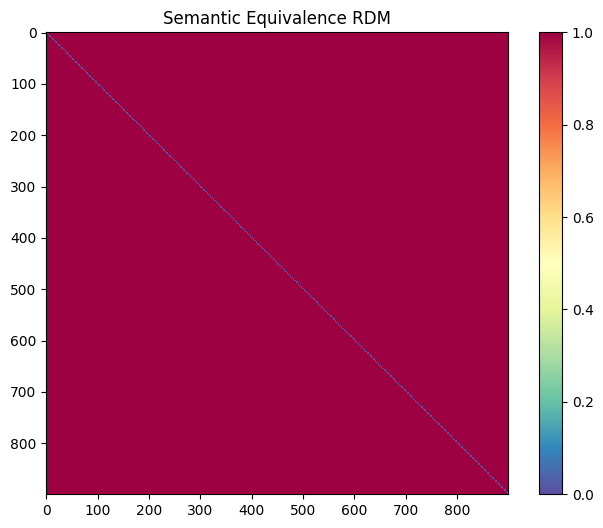

In [24]:
paraphrase_identity_rdm = np.ones((900, 900))
paraphrase_identity_rdm[np.arange(900), np.arange(900)] = 0

for x in range(0, 300):
    paraphrase_identity_rdm[x*3:x*3+3, x*3:x*3+3] = 0
    
rsa_utils.plot_mtx(paraphrase_identity_rdm, 'Semantic Equivalence RDM')

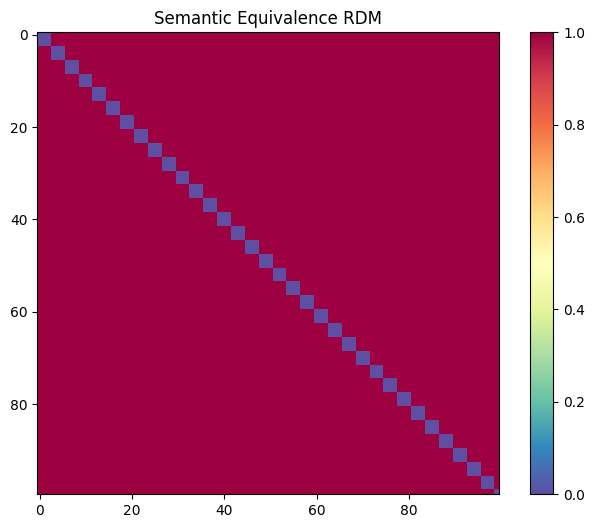

In [25]:
rsa_utils.plot_mtx(paraphrase_identity_rdm[:100, :100], 'Semantic Equivalence RDM')

## FastText RDM and correlation with Semantic Equivalence RDM

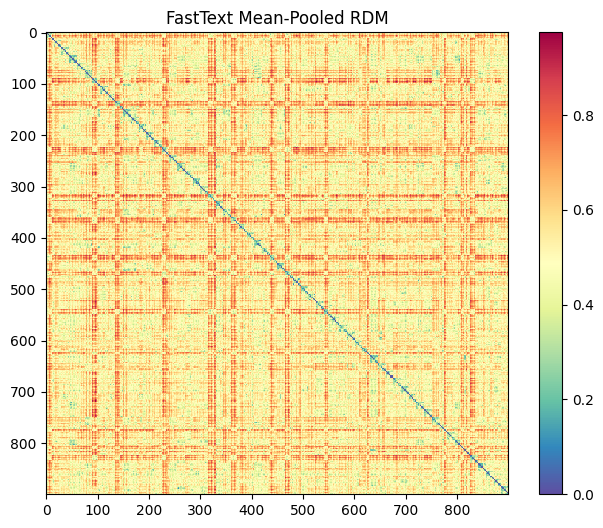

In [26]:
ordered_fasttext_mean_rdm = rsa_utils.get_rdm(ordered_fasttext_reps, 'cosine')
rsa_utils.plot_mtx(ordered_fasttext_mean_rdm, 'FastText Mean-Pooled RDM')

In [27]:
rsa_utils.correlate_rdms(paraphrase_identity_rdm, ordered_fasttext_mean_rdm, correlation=corr_metric)

SignificanceResult(statistic=0.06652617458246601, pvalue=0.0)

## Creating Textual Features RDMs

In [28]:
text_distance_features = [('Ratcliff-Obershelp similarity', textdistance.ratcliff_obershelp), ('Monge-Elkan', textdistance.monge_elkan), ('Levenshtein', textdistance.levenshtein),
                         ('Jaccard index', textdistance.jaccard)]

Ratcliff-Obershelp similarity


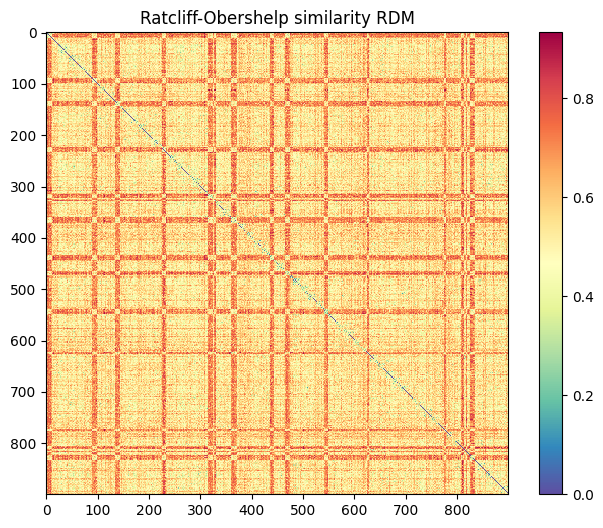

SignificanceResult(statistic=0.04904835721376136, pvalue=0.0)
Monge-Elkan


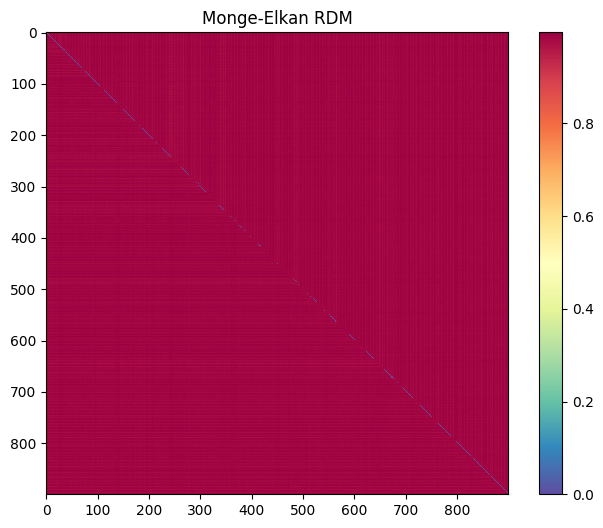

SignificanceResult(statistic=-0.006423717265369589, pvalue=5.870452992875178e-07)
Levenshtein


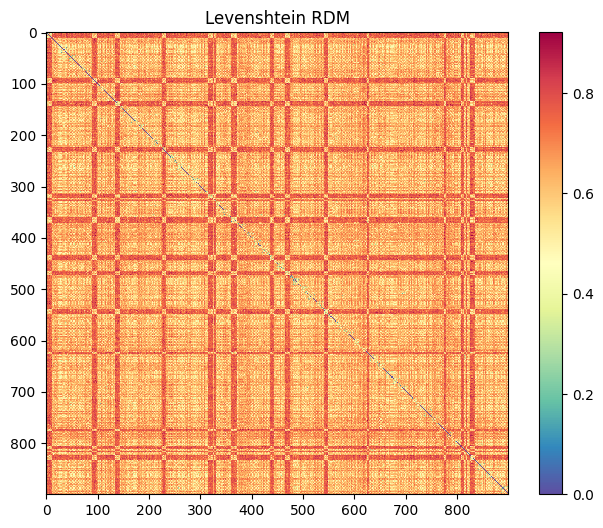

SignificanceResult(statistic=0.0322948664417737, pvalue=9.593246123222248e-139)
Jaccard index


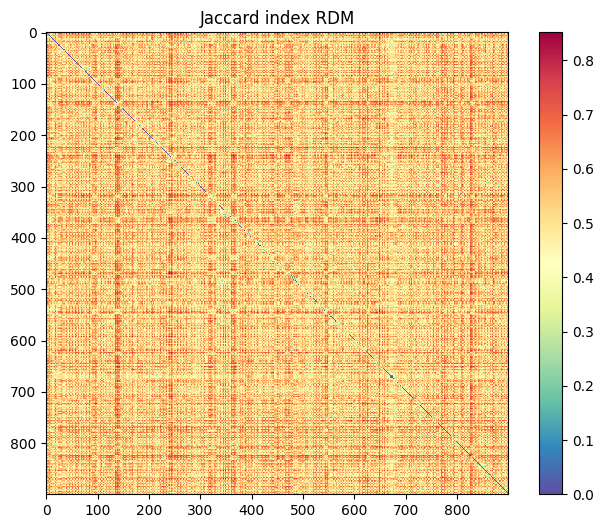

SignificanceResult(statistic=0.04511400881427962, pvalue=3.6824296941936564e-269)


In [29]:
load = True

rdm_dict = {}

for (distance_name, distance_func) in text_distance_features:
    print(distance_name)
    
    if not load:
        rdm = np.zeros((900, 900))
        for (i, j) in tqdm.tqdm([(i, j) for i in range(900) for j in range(900)]):
            if i >= j:
                dist = distance_func.normalized_distance(ordered_sentences[i], ordered_sentences[j])
                rdm[i, j] = dist
                rdm[j, i] = dist
    else:
        rdm = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/rdms/{}.npy'.format(distance_name))
    rsa_utils.plot_mtx(rdm, distance_name + ' RDM')
    plt.show()
    print(rsa_utils.correlate_rdms(paraphrase_identity_rdm, rdm, correlation=corr_metric))
    rdm_dict[distance_name] = rdm

In [30]:
jaccard_rdm = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/rdms/Jaccard index.npy')
monge_elkan_rdm = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/rdms/Monge-Elkan.npy')
ratcliff_obershelp_rdm = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/rdms/Ratcliff-Obershelp similarity.npy')
levenshtein_rdm = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/rdms/Levenshtein.npy')

## Transformer RDMS (whole sentence average)

Here I create RDMs from the Transformer token representations from each layer (averaging across all tokens in each sentence).

I then correlate these with the semantic equivalence RDM, the textual features RDMs and the FastText RDM.

In [31]:
model_names = list(model_utils.dev_model_configs.keys())

#model_names = ['bert-base-uncased', 'roberta-base', 'xlm-mlm-xnli15-1024', 'xlnet-base-cased', 'distilroberta', 'bert-base-japanese']
print(model_names)

['roberta-base', 'bert-base-uncased', 'distilroberta', 'xlnet-base-cased', 'xlm-mlm-xnli15-1024', 'bert-base-japanese']


In [32]:
compound_sentence_inds = np.arange(paraphrase_identity_rdm.shape[0]) % 3 == 0

def corr_within_compound_sentences(rdm_a, rdm_b):
    rdm_a_within_compound_sentences = rdm_a[compound_sentence_inds, :][:, compound_sentence_inds]
    rdm_b_within_compound_sentences = rdm_b[compound_sentence_inds, :][:, compound_sentence_inds]
    return corr(rdm_a_within_compound_sentences, rdm_b_within_compound_sentences)

In [33]:
rdms_to_correlate = [("paraphrase_identity_rdm", paraphrase_identity_rdm), ("jaccard_rdm", jaccard_rdm), ("monge_elkan_rdm", monge_elkan_rdm), 
                     ("ratcliff_obershelp_rdm", ratcliff_obershelp_rdm), ("levenshtein_rdm", levenshtein_rdm), ("fasttext_mean_rdm", ordered_fasttext_mean_rdm)]

In [34]:
def correlate_and_get_row_values(rdm_a, rdm_b, rdm_name, within_compound_sentences=True):
    row = {}
    
    corr_val, pvalue = corr(rdm_a, rdm_b)
    row['{}_corr'.format(rdm_name)] = corr_val
    row['{}_pvalue'.format(rdm_name)] = pvalue
    
    if within_compound_sentences:
        corr_val, pvalue = corr_within_compound_sentences(rdm_a, rdm_b)
        row['{}_corr_within_compound_sentences'.format(rdm_name)] = corr_val
        row['{}_pvalue_within_compound_sentences'.format(rdm_name)] = pvalue
        
    return row

In [ ]:
load = True

if load:
    results_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_whole_sentence_correlations.csv')
else:
    rows = []

    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue
            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds_mean_pooled/{}_layer_{}_noun_noun_compounds_mean_pooled.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            rdm = rsa_utils.get_rdm(reps[paraphrase_inds])

            row = {'model': model_name, 'layer': layer}
            
            for target_rdm_name, target_rdm in rdms_to_correlate:
                row = {**row, **correlate_and_get_row_values(rdm, target_rdm, target_rdm_name, within_compound_sentences=True)}
                
            rows.append(row)

    results_df = pd.DataFrame(rows)
    results_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_whole_sentence_correlations.csv')

roberta-base


100%|██████████| 16/16 [00:12<00:00,  1.32it/s]


bert-base-uncased


100%|██████████| 16/16 [00:10<00:00,  1.60it/s]


distilroberta


100%|██████████| 16/16 [00:04<00:00,  3.25it/s]


xlnet-base-cased


100%|██████████| 16/16 [00:10<00:00,  1.57it/s]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [00:11<00:00,  1.41it/s]


bert-base-japanese


100%|██████████| 16/16 [00:10<00:00,  1.57it/s]


## Correlation between Semantic Equivalence RDM and Transformer layer RDM (whole sentence avg.)

<Axes: xlabel='layer', ylabel='paraphrase_identity_rdm_corr'>

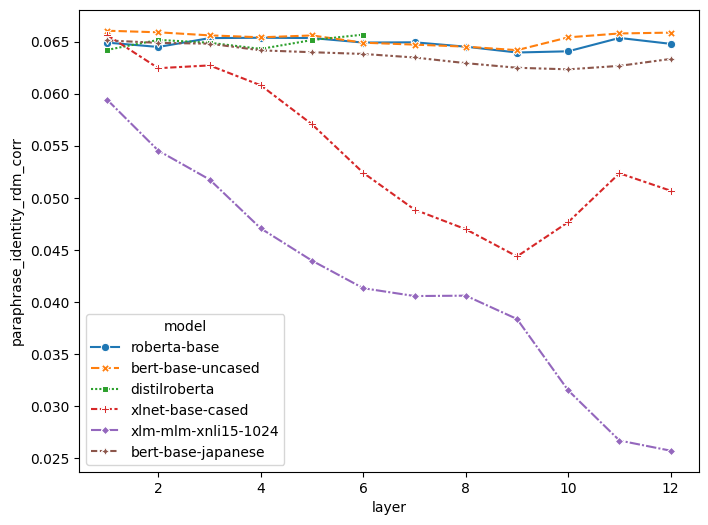

In [36]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='paraphrase_identity_rdm_corr', hue='model', style='model', markers=True, data=results_df)

In [ ]:
# plt.figure(figsize=(8,6))
# sns.lineplot(x='layer', y='paraphrase_identity_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=results_df)

## Correlation between Jaccard Sim. RDM and Transformer layer RDM (whole sentence avg.)

In [ ]:
plt.figure(figsize=(8,6))
g = sns.lineplot(x='layer', y='jaccard_rdm_corr', hue='model', style='model', markers=True, data=results_df)

In [ ]:
plt.figure(figsize=(8,6))
g = sns.lineplot(x='layer', y='jaccard_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=results_df)

## Correlation between Monge-Elkan RDM and Transformer layer RDM (whole sentence avg.)

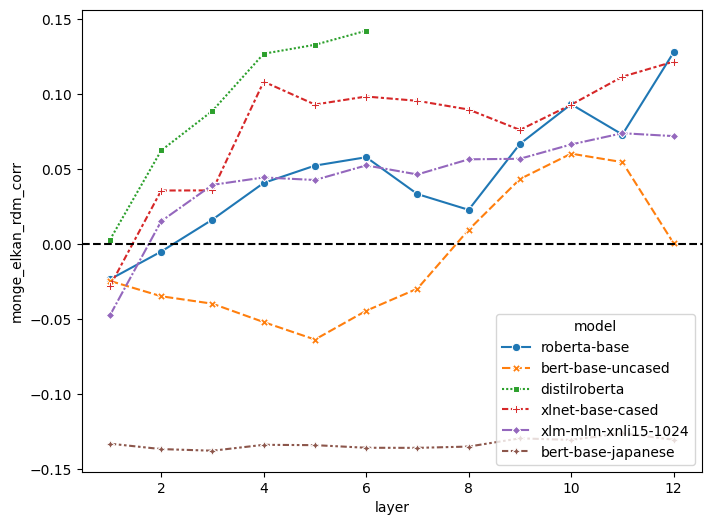

In [37]:
plt.figure(figsize=(8,6))
g = sns.lineplot(x='layer', y='monge_elkan_rdm_corr', hue='model', style='model', markers=True, data=results_df)
g.axhline(0, color='black', ls='--')

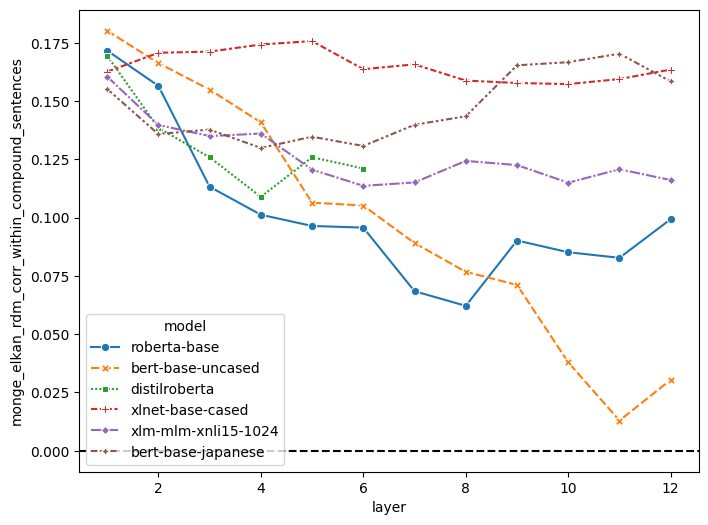

In [38]:
plt.figure(figsize=(8,6))
g = sns.lineplot(x='layer', y='monge_elkan_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=results_df)
g.axhline(0, color='black', ls='--')

## Correlation between Ratcliff Obershelp RDM and Transformer layer RDM (whole sentence avg.)

<Axes: xlabel='layer', ylabel='ratcliff_obershelp_rdm_corr'>

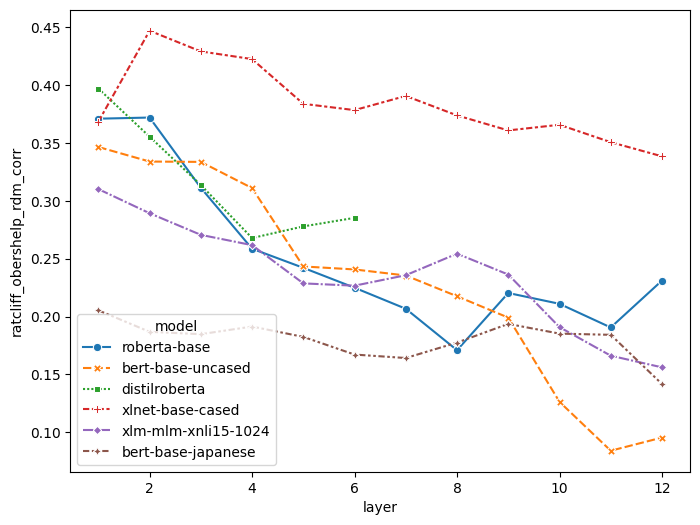

In [39]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='ratcliff_obershelp_rdm_corr', hue='model', style='model', markers=True, data=results_df)

<Axes: xlabel='layer', ylabel='ratcliff_obershelp_rdm_corr_within_compound_sentences'>

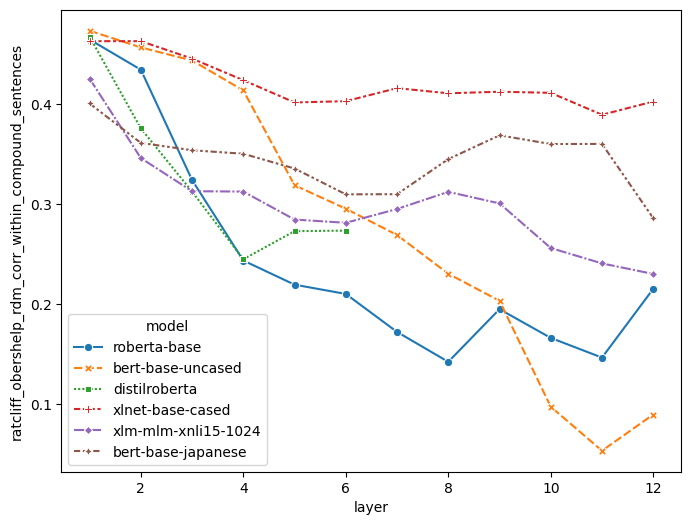

In [40]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='ratcliff_obershelp_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=results_df)

## Correlation between Levenshtein Distance RDM and Transformer layer RDM (whole sentence avg.)

<Axes: xlabel='layer', ylabel='levenshtein_rdm_corr'>

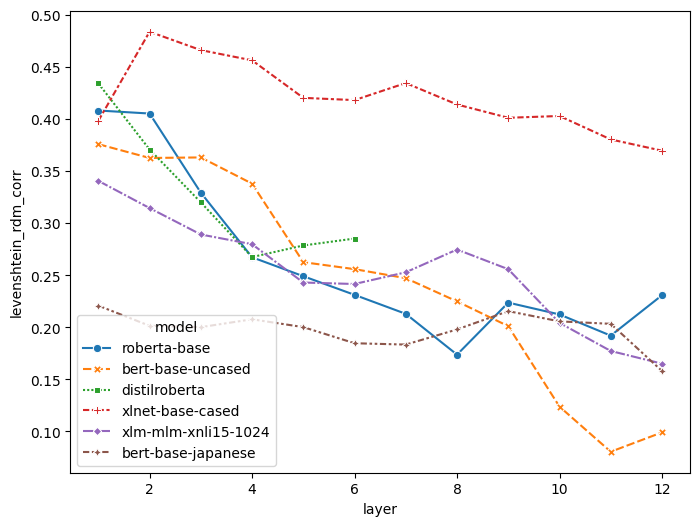

In [41]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='levenshtein_rdm_corr', hue='model', style='model', markers=True, data=results_df)

<Axes: xlabel='layer', ylabel='levenshtein_rdm_corr_within_compound_sentences'>

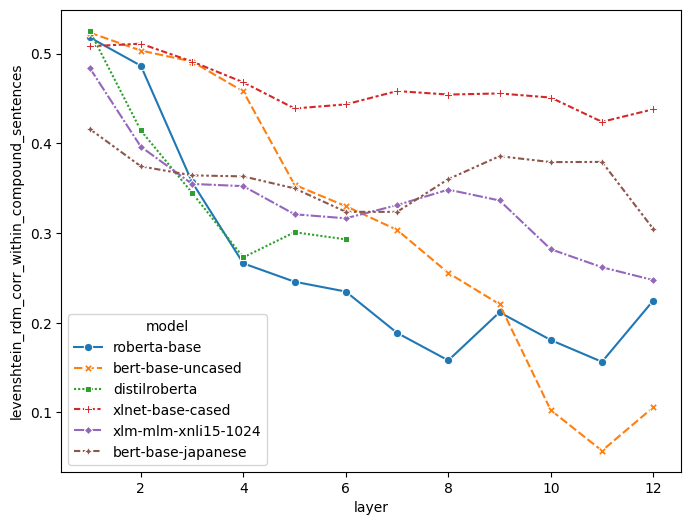

In [42]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='levenshtein_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=results_df)

## Correlation between FastText RDM and Transformer layer RDM (whole sentence avg.)

<Axes: xlabel='layer', ylabel='fasttext_mean_rdm_corr'>

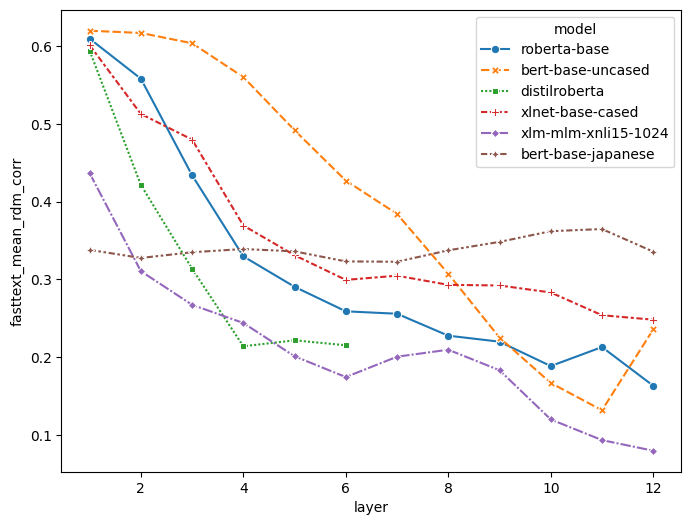

In [43]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='fasttext_mean_rdm_corr', hue='model', style='model', markers=True, data=results_df)

<Axes: xlabel='layer', ylabel='fasttext_mean_rdm_corr_within_compound_sentences'>

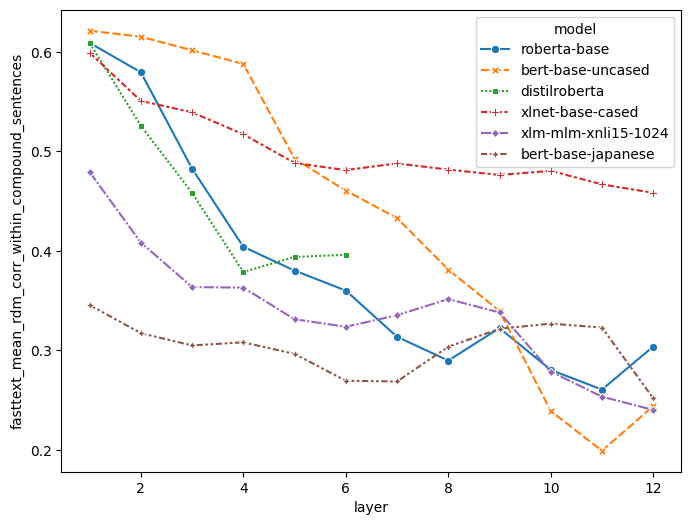

In [44]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='fasttext_mean_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=results_df)

# Correlations within Compound Groups

Here I only compare sentences within the same group of 15 sentences. I take the average correlation across the 60 tests. 

Note: Some references to pvalue will actually map to the stdev across these correlations, I haven't finished updating the labels.

#### Some tests to make sure the function to get the lower triangle of these matrices works as expected

In [45]:
a = np.array([[[1, 1], [2, 2], [3, 3]], 
              [[4, 4], [5, 5], [6, 6]], 
              [[7, 7], [8, 8], [9, 9]]])

### Getting the indices for each group

In [46]:
rdms_to_correlate

[('paraphrase_identity_rdm',
  array([[0., 0., 0., ..., 1., 1., 1.],
         [0., 0., 0., ..., 1., 1., 1.],
         [0., 0., 0., ..., 1., 1., 1.],
         ...,
         [1., 1., 1., ..., 0., 0., 0.],
         [1., 1., 1., ..., 0., 0., 0.],
         [1., 1., 1., ..., 0., 0., 0.]])),
 ('jaccard_rdm',
  array([[0.        , 0.43478261, 0.43478261, ..., 0.68571429, 0.65306122,
          0.62068966],
         [0.43478261, 0.        , 0.38596491, ..., 0.625     , 0.51724138,
          0.4375    ],
         [0.43478261, 0.38596491, 0.        , ..., 0.70588235, 0.51724138,
          0.46153846],
         ...,
         [0.68571429, 0.625     , 0.70588235, ..., 0.        , 0.5       ,
          0.62962963],
         [0.65306122, 0.51724138, 0.51724138, ..., 0.5       , 0.        ,
          0.37931034],
         [0.62068966, 0.4375    , 0.46153846, ..., 0.62962963, 0.37931034,
          0.        ]])),
 ('monge_elkan_rdm',
  array([[0.        , 0.9907845 , 0.98960302, ..., 0.9825    , 0.990937

In [47]:
load = False

if load:
    results_within_compound_groups_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_whole_sentence_correlations (within_compound_groups).csv')
else:    
    rows = []

    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue
            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds_mean_pooled/{}_layer_{}_noun_noun_compounds_mean_pooled.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            rdm = rsa_utils.get_rdm(reps[paraphrase_inds])

            row = {'model': model_name, 'layer': layer}

            for target_rdm_name, target_rdm in rdms_to_correlate:
                row = {**row, **rsa_utils.correlate_over_groups_and_get_row_values(rdm, target_rdm, target_rdm_name, corr_metric=corr_metric)}

            rows.append(row)


    results_within_compound_groups_df = pd.DataFrame(rows)
    results_within_compound_groups_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_whole_sentence_correlations (within_compound_groups).csv')

roberta-base


100%|██████████| 16/16 [01:47<00:00,  6.73s/it]


bert-base-uncased


100%|██████████| 16/16 [02:02<00:00,  7.63s/it]


distilroberta


100%|██████████| 16/16 [01:03<00:00,  3.95s/it]


xlnet-base-cased


100%|██████████| 16/16 [02:07<00:00,  7.94s/it]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [02:09<00:00,  8.09s/it]


bert-base-japanese


100%|██████████| 16/16 [02:10<00:00,  8.13s/it]


## Correlation between Semantic Equivalence RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

<Axes: xlabel='layer', ylabel='paraphrase_identity_rdm_corr'>

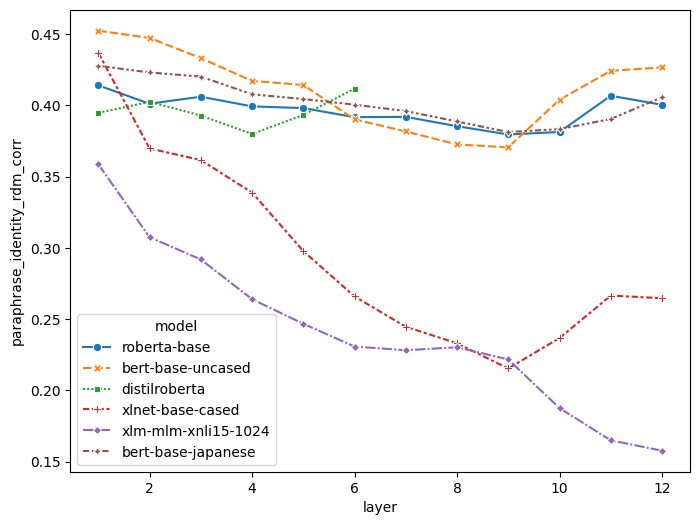

In [48]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='paraphrase_identity_rdm_corr', hue='model', style='model', markers=True, data=results_within_compound_groups_df)

In [49]:
results_df.columns

Index(['model', 'layer', 'paraphrase_identity_rdm_corr',
       'paraphrase_identity_rdm_pvalue',
       'paraphrase_identity_rdm_corr_within_compound_sentences',
       'paraphrase_identity_rdm_pvalue_within_compound_sentences',
       'jaccard_rdm_corr', 'jaccard_rdm_pvalue',
       'jaccard_rdm_corr_within_compound_sentences',
       'jaccard_rdm_pvalue_within_compound_sentences', 'monge_elkan_rdm_corr',
       'monge_elkan_rdm_pvalue',
       'monge_elkan_rdm_corr_within_compound_sentences',
       'monge_elkan_rdm_pvalue_within_compound_sentences',
       'ratcliff_obershelp_rdm_corr', 'ratcliff_obershelp_rdm_pvalue',
       'ratcliff_obershelp_rdm_corr_within_compound_sentences',
       'ratcliff_obershelp_rdm_pvalue_within_compound_sentences',
       'levenshtein_rdm_corr', 'levenshtein_rdm_pvalue',
       'levenshtein_rdm_corr_within_compound_sentences',
       'levenshtein_rdm_pvalue_within_compound_sentences',
       'fasttext_mean_rdm_corr', 'fasttext_mean_rdm_pvalue',
     

## Correlation between Monge-Elkan and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

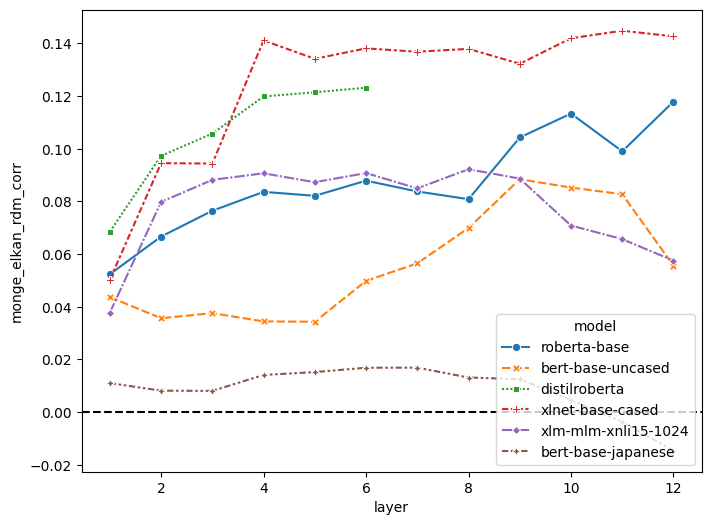

In [50]:
plt.figure(figsize=(8,6))
g = sns.lineplot(x='layer', y='monge_elkan_rdm_corr', hue='model', style='model', markers=True, data=results_within_compound_groups_df)
g.axhline(0, color='black', ls='--')

## Correlation between Ratcliff Obershelp RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

<Axes: xlabel='layer', ylabel='ratcliff_obershelp_rdm_corr'>

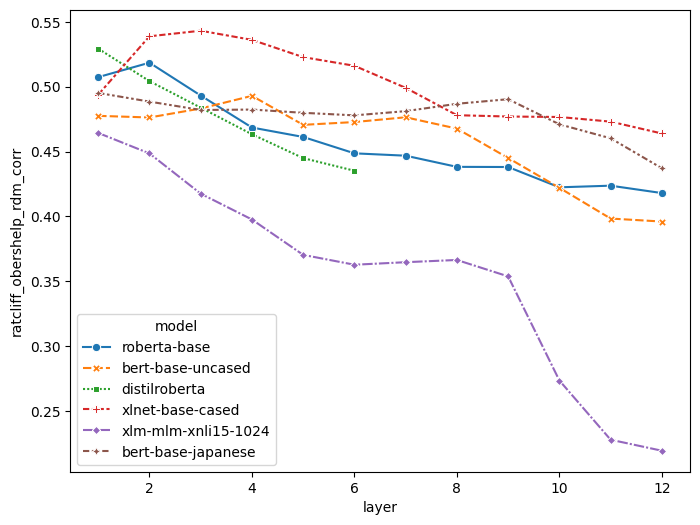

In [51]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='ratcliff_obershelp_rdm_corr', hue='model', style='model', markers=True, data=results_within_compound_groups_df)

## Correlation between Levenshtein RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

<Axes: xlabel='layer', ylabel='levenshtein_rdm_corr'>

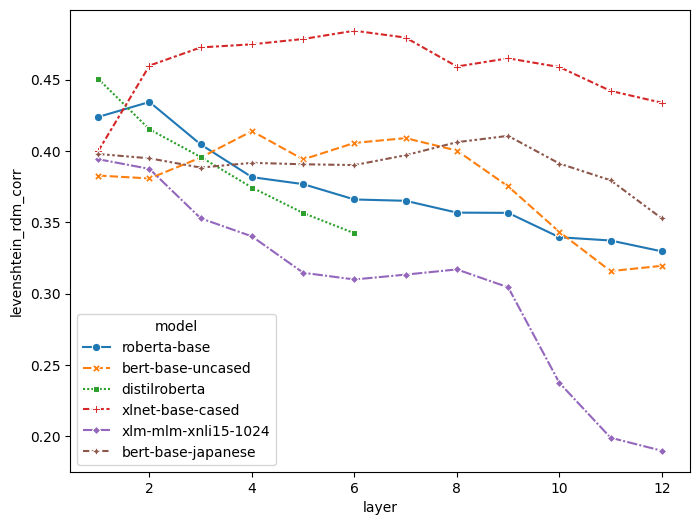

In [52]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='levenshtein_rdm_corr', hue='model', style='model', markers=True, data=results_within_compound_groups_df)

## Correlation between FastText RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

<Axes: xlabel='layer', ylabel='fasttext_mean_rdm_corr'>

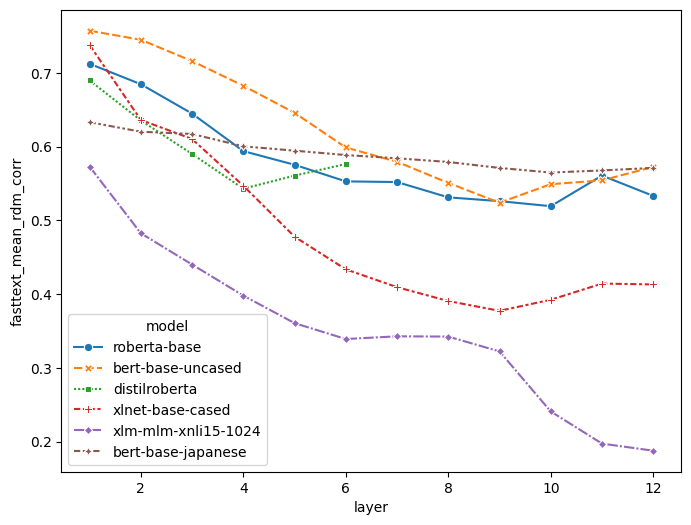

In [53]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='fasttext_mean_rdm_corr', hue='model', style='model', markers=True, data=results_within_compound_groups_df)

<Axes: xlabel='layer', ylabel='fasttext_mean_rdm_corr_within_compound_sentences'>

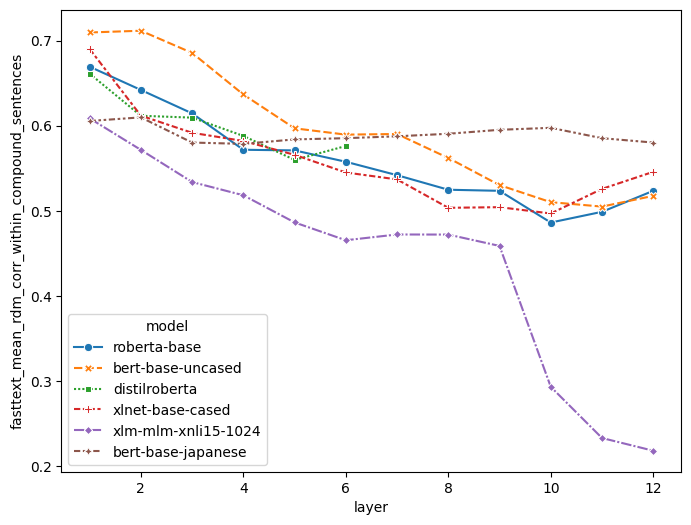

In [54]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='fasttext_mean_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=results_within_compound_groups_df)

## Decoding Experimental Conditions

### Thematic relation

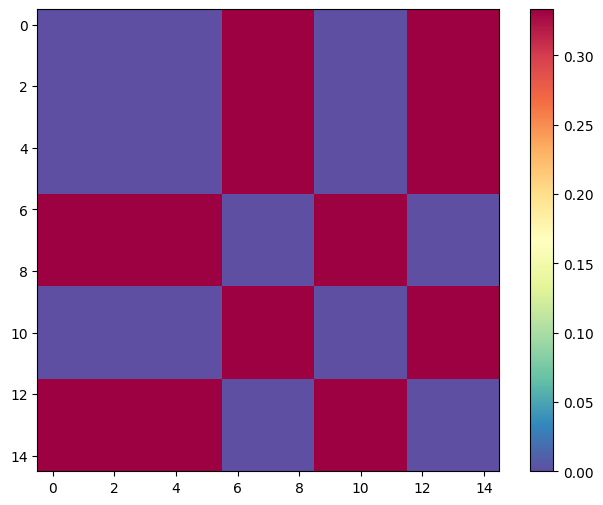

In [55]:
# Groups of five are compounds are: target, same thematic relation, different, same, different
labels_within_group = [1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0] # 1 for same relation, 0 for different
same_relation_group_rdm = rsa_utils.get_rdm(np.array(labels_within_group).reshape(-1, 1))
rsa_utils.plot_mtx(same_relation_group_rdm, "")

In [56]:
current_cmap = plt.get_cmap('Spectral_r')
current_cmap.set_bad(color='gray')


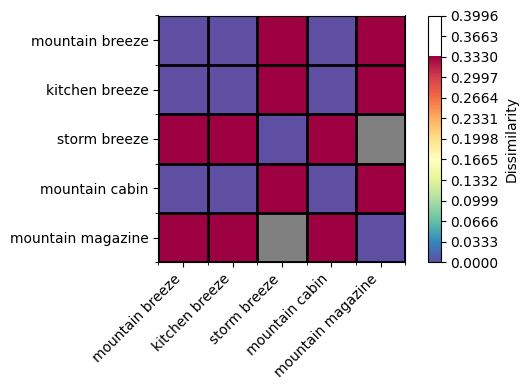

In [57]:
start = 33
sent_inds = np.arange(start * 5, start * 5 + 5)
rdm_inds = np.arange(0, 15, 3)

fig, ax = plt.subplots(figsize=(6, 4))

same_relation_group_rdm[6:9, 12:15] = np.nan
same_relation_group_rdm[12:15, 6:9] = np.nan

# plt.rcParams.update({'font.size': 12})

figure_rdm = same_relation_group_rdm[rdm_inds, :][:, rdm_inds]
plt.imshow(same_relation_group_rdm[rdm_inds, :][:, rdm_inds], interpolation='nearest', cmap=current_cmap)

cb = plt.colorbar(label='Dissimilarity')
labels = np.arange(0, 0.4, 0.0333)
cb.set_ticks(labels)
#cb.set_ticklabels(np.arange(11) / 10)

plt.xticks(ticks=np.arange(5), labels=['{}'.format(compounds[x], x) for x in sent_inds], rotation=45, ha='right');
plt.yticks(ticks=np.arange(5), labels=['{}'.format(compounds[x], x) for x in sent_inds], rotation=0, ha='right');

ax.set_xticks(np.arange(-.5, 5, 1), minor=True)
ax.set_yticks(np.arange(-.5, 5, 1), minor=True)

ax.grid(which='minor', color='black', linestyle='-', linewidth=2)
plt.tight_layout()
# plt.savefig('figures/thematic_relation_ground_truth_rdm.png', bbox_inches='tight')

# plt.savefig('figures/thematic_relation_ground_truth_rdm.eps', format='eps', bbox_inches='tight')

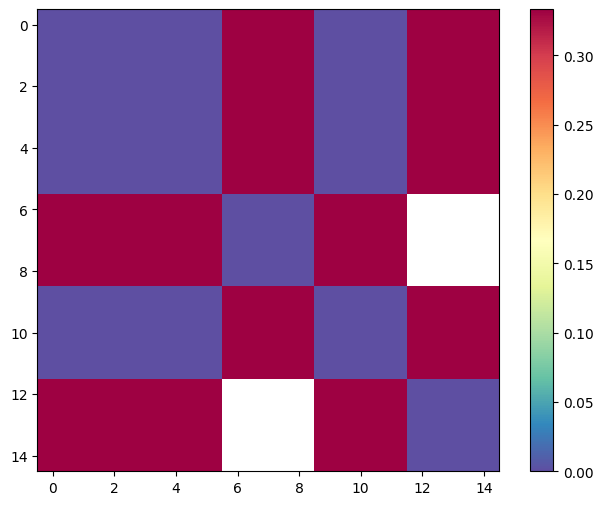

In [58]:

rsa_utils.plot_mtx(same_relation_group_rdm, "")

### Head noun

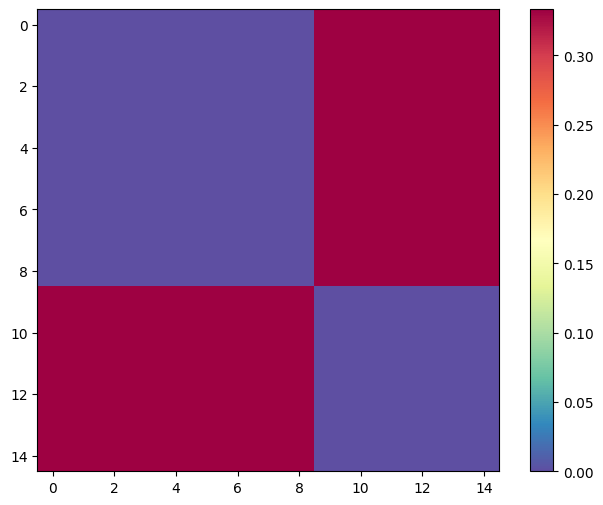

In [59]:
# Groups of five are compounds w.r.t head noun of the target are: target, same head noun, same, different, different
labels_within_group = [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0] # 1 for same relation, 0 for different
same_head_rdm = rsa_utils.get_rdm(np.array(labels_within_group).reshape(-1, 1))
rsa_utils.plot_mtx(same_head_rdm, "")

In [60]:
same_head_rdm = np.zeros((len(compounds), len(compounds)))

for i, compound_i in enumerate(compounds):
    for j, compound_j in enumerate(compounds):
        same_head_rdm[i, j] = compound_i.split(' ')[-1] != compound_j.split(' ')[-1]
        
same_head_rdm = same_head_rdm[paraphrase_inds, :][:, paraphrase_inds]

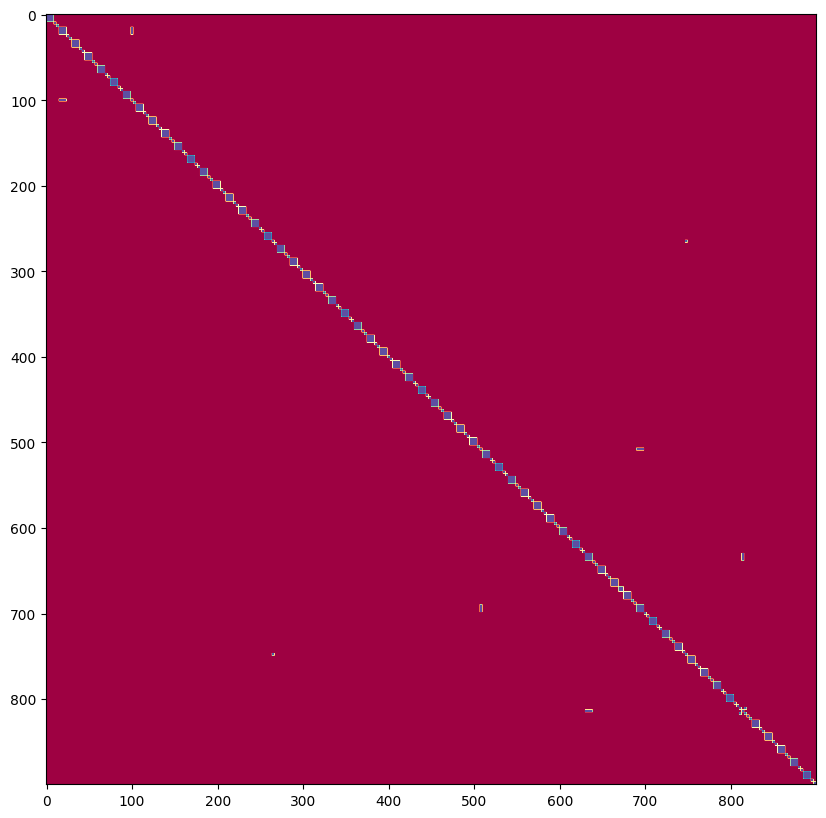

In [61]:
plt.figure(figsize=(10, 10))
plt.imshow(same_head_rdm, cmap='Spectral_r')

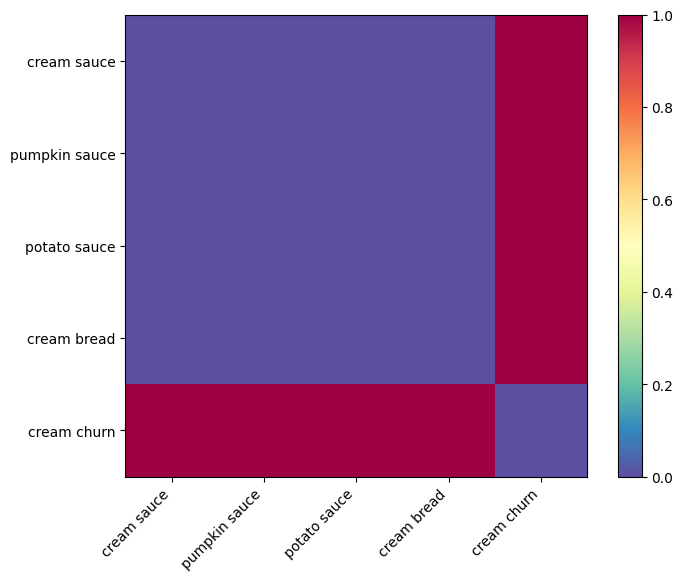

In [62]:
start = 10
sent_inds = np.arange(start * 5, start * 5 + 5)
# rdm_inds = np.arange(0, 15, 3)

fig, ax = plt.subplots(figsize=(8, 6))
plt.imshow(same_head_rdm[sent_inds, :][:, sent_inds], interpolation='nearest', cmap='Spectral_r')
plt.title('')
plt.colorbar();

plt.xticks(ticks=np.arange(5), labels=['{}'.format(compounds[x], x) for x in sent_inds], rotation=45, ha='right');
plt.yticks(ticks=np.arange(5), labels=['{}'.format(compounds[x], x) for x in sent_inds], rotation=0, ha='right');

### Same modifier

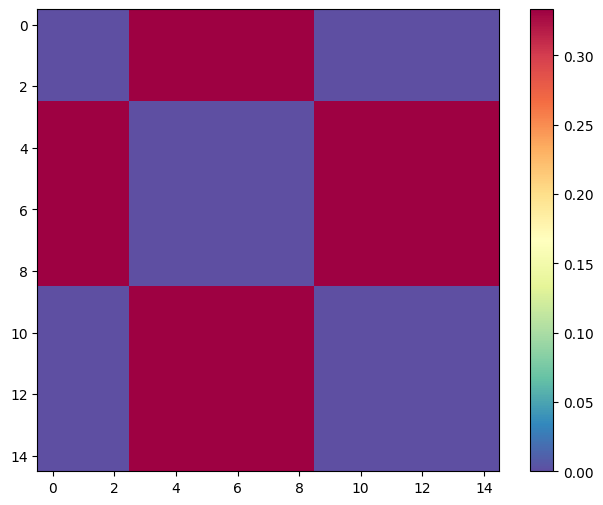

In [63]:
# Groups of five are compounds w.r.t modifier of the target are: target, different modifier, different, same, same
labels_within_group = [1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1] # 1 for same relation, 0 for different
same_modifier_rdm = rsa_utils.get_rdm(np.array(labels_within_group).reshape(-1, 1))
rsa_utils.plot_mtx(same_modifier_rdm[:, :15][:15, :], "")

In [64]:
same_modifier_rdm = np.zeros((len(compounds), len(compounds)))

for i, compound_i in enumerate(compounds):
    for j, compound_j in enumerate(compounds):
        same_modifier_rdm[i, j] = compound_i.split()[0] != compound_j.split()[0]
        
same_modifier_rdm = same_modifier_rdm[paraphrase_inds, :][:, paraphrase_inds]

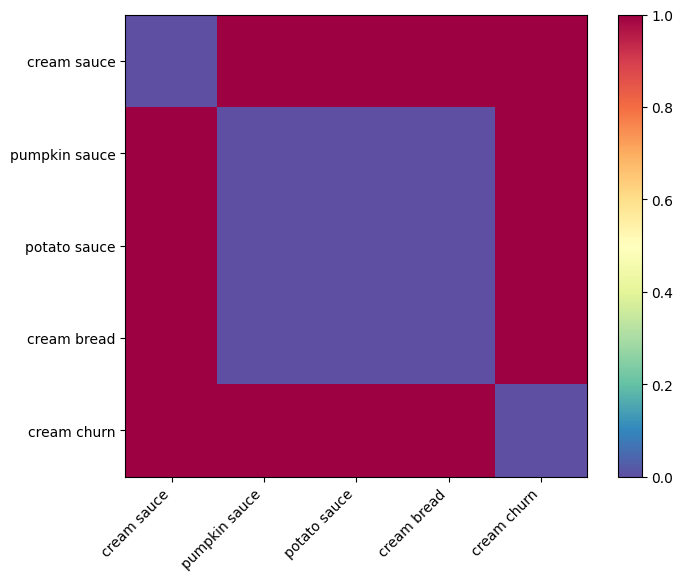

In [65]:
start = 10
sent_inds = np.arange(start * 5, start * 5 + 5)
# rdm_inds = np.arange(0, 15, 3)

fig, ax = plt.subplots(figsize=(8, 6))
plt.imshow(same_modifier_rdm[sent_inds, :][:, sent_inds], interpolation='nearest', cmap='Spectral_r')
plt.title('')
plt.colorbar();

plt.xticks(ticks=np.arange(5), labels=['{}'.format(compounds[x], x) for x in sent_inds], rotation=45, ha='right');
plt.yticks(ticks=np.arange(5), labels=['{}'.format(compounds[x], x) for x in sent_inds], rotation=0, ha='right');

### Transformer Correlations

In [66]:
group_rdms_to_correlate = [("same_relation_group_rdm", same_relation_group_rdm), ("same_head_rdm", same_head_rdm), ("same_modifier_rdm", same_modifier_rdm)]

In [56]:
same_relation_group_rdm.shape

(15, 15)

In [67]:
model_names

['roberta-base',
 'bert-base-uncased',
 'distilroberta',
 'xlnet-base-cased',
 'xlm-mlm-xnli15-1024',
 'bert-base-japanese']

In [69]:
load = False

if load:
    relation_results_within_compound_groups_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_experimental_conditions_.csv')
else:
    rows = []

    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue
            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds_mean_pooled/{}_layer_{}_noun_noun_compounds_mean_pooled.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            rdm = rsa_utils.get_rdm(reps[paraphrase_inds])

            row = {'model': model_name, 'layer': layer}

            for target_rdm_name, target_rdm in group_rdms_to_correlate:
                second_rdm_group_level_already = target_rdm_name == 'same_relation_group_rdm'
                row = {**row, **rsa_utils.correlate_over_groups_and_get_row_values(rdm, target_rdm, target_rdm_name, second_rdm_group_level_already=second_rdm_group_level_already, corr_metric=corr_metric)}
                np.savetxt('D:/NOUN-NOUN-COMPOUNDS-V1/data/test/experimental_{}.csv'.format(target_rdm_name), target_rdm)

            rows.append(row)
    
        np.savetxt('D:/NOUN-NOUN-COMPOUNDS-V1/data/test/900_rep_rdm.csv', rdm)
    
    relation_results_within_compound_groups_df = pd.DataFrame(rows)
    relation_results_within_compound_groups_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_experimental_conditions_.csv')

roberta-base


100%|██████████| 16/16 [01:46<00:00,  6.64s/it]


bert-base-uncased


100%|██████████| 16/16 [01:46<00:00,  6.68s/it]


distilroberta


100%|██████████| 16/16 [00:55<00:00,  3.46s/it]


xlnet-base-cased


100%|██████████| 16/16 [01:41<00:00,  6.32s/it]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [01:46<00:00,  6.68s/it]


bert-base-japanese


100%|██████████| 16/16 [01:49<00:00,  6.87s/it]


## Correlation between Same Thematic Relation RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

<Axes: xlabel='layer', ylabel='same_relation_group_rdm_corr'>

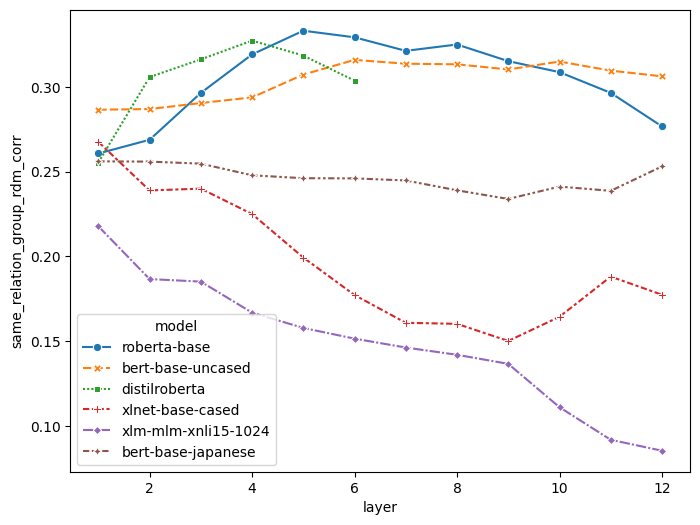

In [70]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_relation_group_rdm_corr', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

<Axes: xlabel='layer', ylabel='same_relation_group_rdm_corr_within_compound_sentences'>

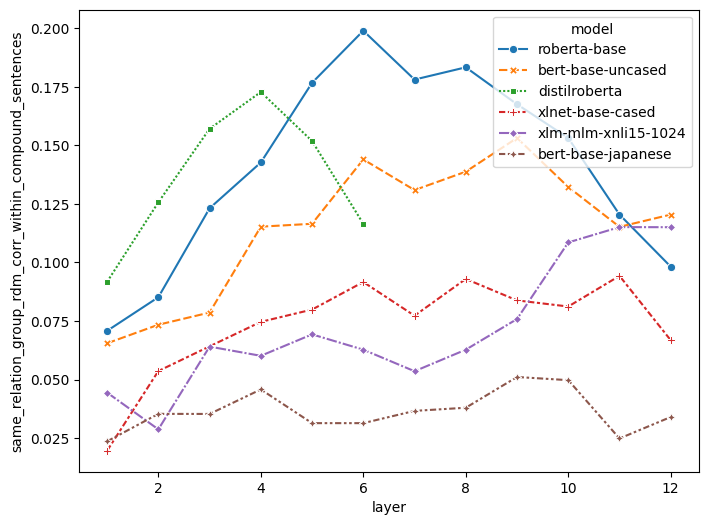

In [71]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_relation_group_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

## Correlation between Same Head Noun RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

In [72]:
relation_results_within_compound_groups_df.keys()

Index(['model', 'layer', 'same_relation_group_rdm_corr',
       'same_relation_group_rdm_std',
       'same_relation_group_rdm_corr_within_compound_sentences',
       'same_relation_group_rdm_std_within_compound_sentences',
       'same_head_rdm_corr', 'same_head_rdm_std',
       'same_head_rdm_corr_within_compound_sentences',
       'same_head_rdm_std_within_compound_sentences', 'same_modifier_rdm_corr',
       'same_modifier_rdm_std',
       'same_modifier_rdm_corr_within_compound_sentences',
       'same_modifier_rdm_std_within_compound_sentences'],
      dtype='object')

<Axes: xlabel='layer', ylabel='same_head_rdm_corr'>

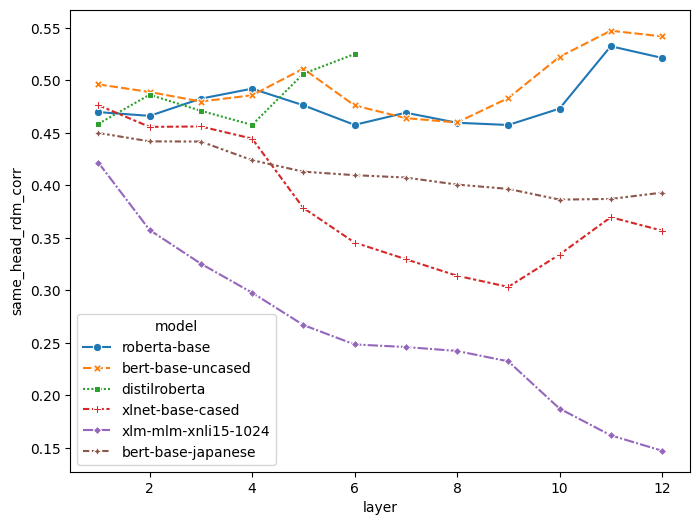

In [73]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_head_rdm_corr', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

<Axes: xlabel='layer', ylabel='same_head_rdm_corr_within_compound_sentences'>

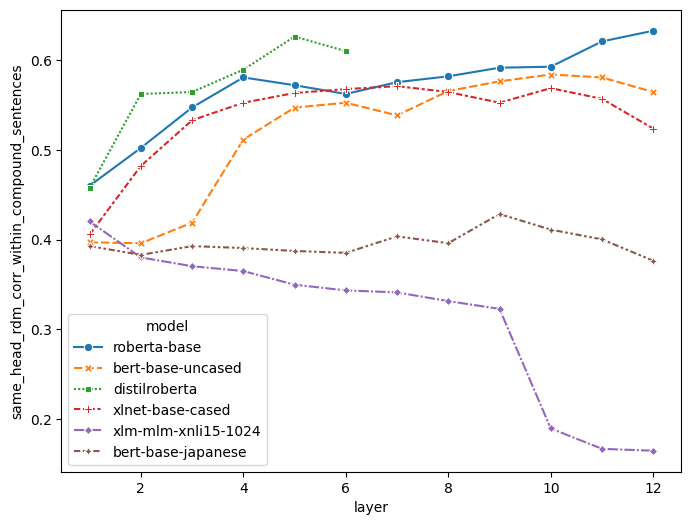

In [74]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_head_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

<Axes: xlabel='layer', ylabel='same_head_rdm_std_within_compound_sentences'>

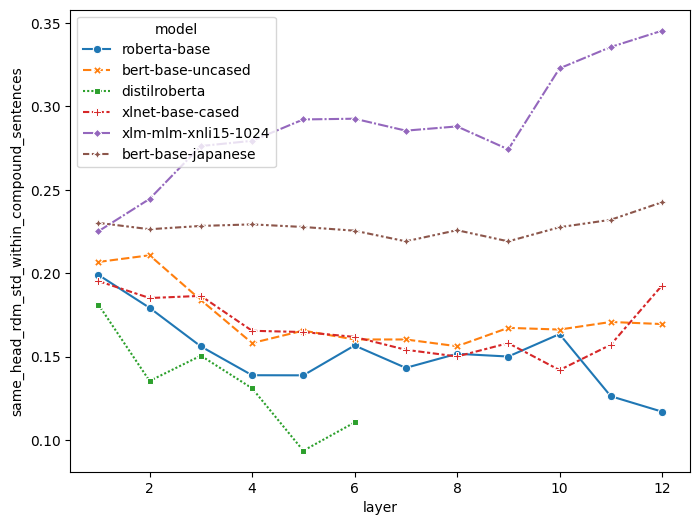

In [75]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_head_rdm_std_within_compound_sentences', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

### Here, I find a very significant negative correlation between the thematic relation representation and same head noun representation

In [76]:
spearmanr(relation_results_within_compound_groups_df.same_relation_group_rdm_corr_within_compound_sentences, relation_results_within_compound_groups_df.same_head_rdm_corr_within_compound_sentences)

SignificanceResult(statistic=0.7048275142599911, pvalue=3.9704371994942074e-11)

In [77]:
spearmanr(relation_results_within_compound_groups_df.same_relation_group_rdm_corr_within_compound_sentences, relation_results_within_compound_groups_df.same_modifier_rdm_corr_within_compound_sentences)

SignificanceResult(statistic=-0.7391159125709243, pvalue=1.3802852601514326e-12)

In [78]:
spearmanr(relation_results_within_compound_groups_df.same_head_rdm_corr_within_compound_sentences, relation_results_within_compound_groups_df.same_modifier_rdm_corr_within_compound_sentences)

SignificanceResult(statistic=-0.7547805937121623, pvalue=2.4852967385357727e-13)

## Correlation between Same Modifier Word RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

In [79]:
relation_results_within_compound_groups_df.keys()

Index(['model', 'layer', 'same_relation_group_rdm_corr',
       'same_relation_group_rdm_std',
       'same_relation_group_rdm_corr_within_compound_sentences',
       'same_relation_group_rdm_std_within_compound_sentences',
       'same_head_rdm_corr', 'same_head_rdm_std',
       'same_head_rdm_corr_within_compound_sentences',
       'same_head_rdm_std_within_compound_sentences', 'same_modifier_rdm_corr',
       'same_modifier_rdm_std',
       'same_modifier_rdm_corr_within_compound_sentences',
       'same_modifier_rdm_std_within_compound_sentences'],
      dtype='object')

<Axes: xlabel='layer', ylabel='same_modifier_rdm_corr'>

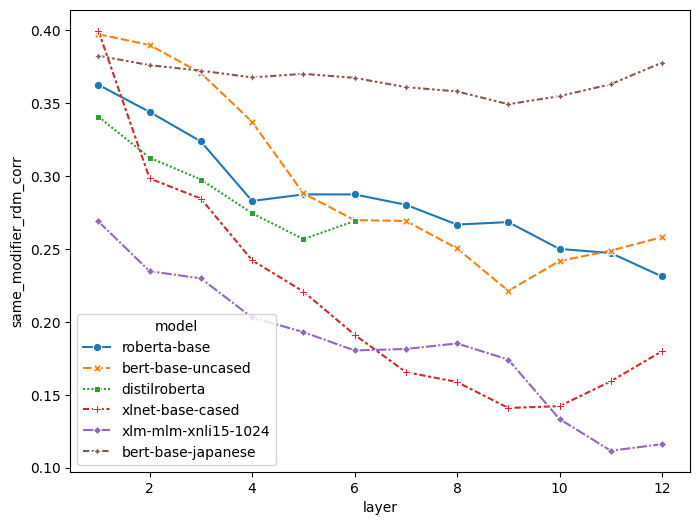

In [80]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_modifier_rdm_corr', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

<Axes: xlabel='layer', ylabel='same_modifier_rdm_corr_within_compound_sentences'>

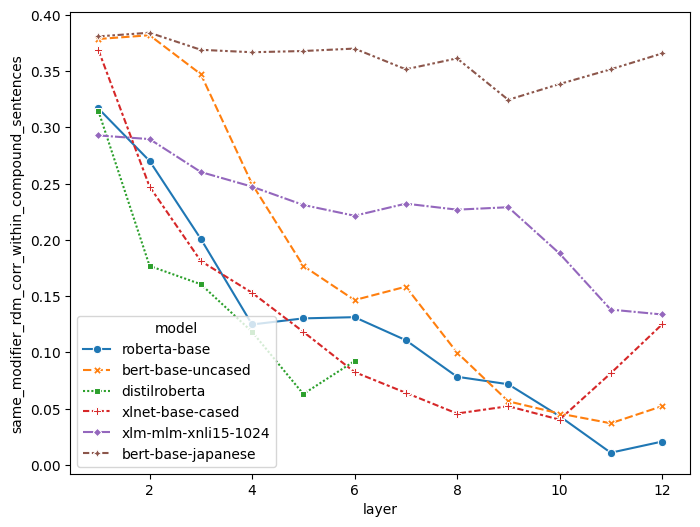

In [81]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_modifier_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

## Representations Per Word

Here I re-run previous experiments (looking within groups), but instead of just looking at correlations for the whole sentence mean RDM I consider RDMs based on:
- The average token representation across the compound (the solid line in the charts)
- The average token representation across the head noun (the dashed line in the charts)
- The average token representation across the modifier word (the dotted line in the charts)

In [82]:
def corr_within_group(rdm_a, rdm_b):
    return corr(data_utils.select_within_compound_groups(rdm_a.reshape(900, 900)), data_utils.select_within_compound_groups(rdm_b.reshape(900, 900)))

In [83]:
def run_correlations(rdm, model_name, layer):
    semantic_equivalence_rdm_corr, semantic_equivalence_rdm_pvalue = rsa_utils.correlate_over_groups(paraphrase_identity_rdm, rdm, corr_metric=corr_metric)
    jaccard_corr, jaccard_pvalue = rsa_utils.correlate_over_groups(jaccard_rdm, rdm, corr_metric=corr_metric)
    monge_elkan_corr, monge_elkan_pvalue = rsa_utils.correlate_over_groups(monge_elkan_rdm, rdm, corr_metric=corr_metric)
    ratcliff_obershelp_corr, ratcliff_obershelp_pvalue = rsa_utils.correlate_over_groups(ratcliff_obershelp_rdm, rdm, corr_metric=corr_metric)
    levenshtein_corr, levenshtein_pvalue = rsa_utils.correlate_over_groups(levenshtein_rdm, rdm, corr_metric=corr_metric)
    fasttext_corr, fasttext_pvalue = rsa_utils.correlate_over_groups(ordered_fasttext_mean_rdm, rdm, corr_metric=corr_metric)

    return {'model': model_name, 'layer': layer, "semantic_equivalence_rdm_corr":  semantic_equivalence_rdm_corr, 
                "semantic_equivalence_rdm_pvalue":  semantic_equivalence_rdm_pvalue, "jaccard_corr": jaccard_corr, "jaccard_pvalue": jaccard_pvalue,
                "monge_elkan_corr": monge_elkan_corr, "monge_elkan_pvalue": monge_elkan_pvalue, "ratcliff_obershelp_corr": ratcliff_obershelp_corr, 
                "ratcliff_obershelp_pvalue": ratcliff_obershelp_pvalue, "levenshtein_corr": levenshtein_corr, "levenshtein_pvalue": levenshtein_pvalue, 
                "fasttext_corr": fasttext_corr, "fasttext_pvalue": fasttext_pvalue}

In [84]:
load = False

if load:
    results_per_word_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_per_word_transformers.csv')
    noun_noun_compound_similarity_results = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/noun_noun_compound_similarity_results.csv')
else:
    noun_noun_compound_similarity_rows = []
    rows = []

    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue
            
            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            
            
            if 'llama' in model_name:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds].reshape(-1, 1))
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1].squeeze()[paraphrase_inds].reshape(-1, 1))
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0].squeeze()[paraphrase_inds].reshape(-1, 1))
            elif 'openai' in model_name:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds].reshape(-1, 1))
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1].squeeze()[paraphrase_inds].reshape(-1, 1))
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0].squeeze()[paraphrase_inds].reshape(-1, 1))
            else:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds])
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1, :].squeeze()[paraphrase_inds])
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0, :].squeeze()[paraphrase_inds])
            
            for rdm_name, rdm in [('compound_mean', compound_rdm), ('head_noun_mean', head_noun_rdm), ('mod_word_mean', mod_word_rdm)]:
                row = {'model': model_name, 'layer': layer, 'representation': rdm_name}

                for target_rdm_name, target_rdm in rdms_to_correlate:
                    row = {**row, **rsa_utils.correlate_over_groups_and_get_row_values(rdm, target_rdm, target_rdm_name, second_rdm_group_level_already=False, corr_metric=corr_metric)}

                rows.append(row)
            
            if 'llama' in model_name:   
                noun_noun_compound_similarity_rows.append({'model': model_name, 'layer': layer, 'avg_head_mod_dist': np.mean([cosine(reps[i, 1].flatten(), reps[i, 0].flatten()) for i in range(900)]),
                                                       'compound_correlation': corr(head_noun_rdm, mod_word_rdm).correlation})
            elif 'openai' in model_name:   
                noun_noun_compound_similarity_rows.append({'model': model_name, 'layer': layer, 'avg_head_mod_dist': np.mean([cosine(reps[i, 1].flatten(), reps[i, 0].flatten()) for i in range(900)]),
                                                       'compound_correlation': corr(head_noun_rdm, mod_word_rdm).correlation})
            else:
                noun_noun_compound_similarity_rows.append({'model': model_name, 'layer': layer, 'avg_head_mod_dist': np.mean([cosine(reps[i, 1, :].squeeze(), reps[i, 0, :].squeeze()) for i in range(900)]),
                                                       'compound_correlation': corr(head_noun_rdm, mod_word_rdm).correlation})

    results_per_word_df = pd.DataFrame(rows)
    results_per_word_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_per_word_transformers.csv')
    noun_noun_compound_similarity_results = pd.DataFrame(noun_noun_compound_similarity_rows)
    noun_noun_compound_similarity_results.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/noun_noun_compound_similarity_results.csv')

roberta-base


100%|██████████| 16/16 [06:20<00:00, 23.79s/it]


bert-base-uncased


100%|██████████| 16/16 [06:39<00:00, 24.98s/it]


distilroberta


100%|██████████| 16/16 [03:27<00:00, 12.96s/it]


xlnet-base-cased


100%|██████████| 16/16 [07:01<00:00, 26.36s/it]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [06:48<00:00, 25.53s/it]


bert-base-japanese


100%|██████████| 16/16 [06:41<00:00, 25.08s/it]


## Correlation between Semantic Equivalence RDM and Transformer layer RDM (average rep. across compound/head/modifier, only considering relations within compound groups)

<Axes: xlabel='layer', ylabel='paraphrase_identity_rdm_corr'>

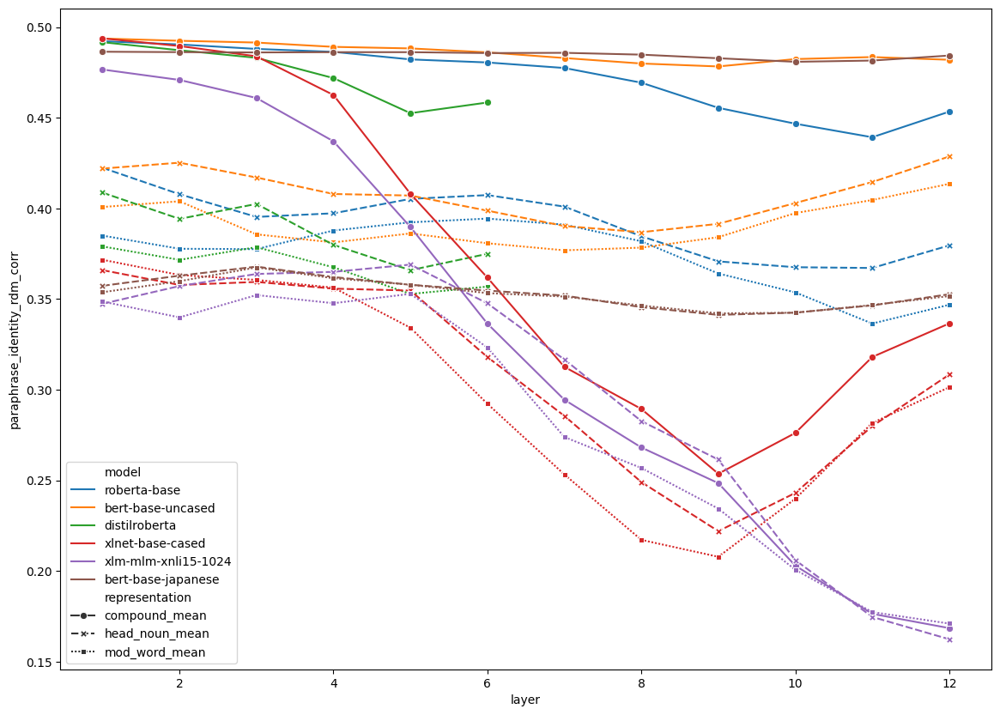

In [85]:
plt.figure(figsize=(14, 10))
sns.lineplot(x='layer', y='paraphrase_identity_rdm_corr', hue='model', style='representation', markers=True, data=results_per_word_df)

In [86]:
[x for x in results_per_word_df.columns if 'corr' in x]

['paraphrase_identity_rdm_corr',
 'paraphrase_identity_rdm_corr_within_compound_sentences',
 'jaccard_rdm_corr',
 'jaccard_rdm_corr_within_compound_sentences',
 'monge_elkan_rdm_corr',
 'monge_elkan_rdm_corr_within_compound_sentences',
 'ratcliff_obershelp_rdm_corr',
 'ratcliff_obershelp_rdm_corr_within_compound_sentences',
 'levenshtein_rdm_corr',
 'levenshtein_rdm_corr_within_compound_sentences',
 'fasttext_mean_rdm_corr',
 'fasttext_mean_rdm_corr_within_compound_sentences']

## Correlation between Textual Features RDMs and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

In [87]:
from IPython.display import display, Markdown, Latex
import time

In [88]:
results_per_word_df

,model,layer,representation,paraphrase_identity_rdm_corr,paraphrase_identity_rdm_std,paraphrase_identity_rdm_corr_within_compound_sentences,paraphrase_identity_rdm_std_within_compound_sentences,jaccard_rdm_corr,jaccard_rdm_std,jaccard_rdm_corr_within_compound_sentences,...,ratcliff_obershelp_rdm_corr_within_compound_sentences,ratcliff_obershelp_rdm_std_within_compound_sentences,levenshtein_rdm_corr,levenshtein_rdm_std,levenshtein_rdm_corr_within_compound_sentences,levenshtein_rdm_std_within_compound_sentences,fasttext_mean_rdm_corr,fasttext_mean_rdm_std,fasttext_mean_rdm_corr_within_compound_sentences,fasttext_mean_rdm_std_within_compound_sentences
0,roberta-base,1,compound_mean,0.492244,0.014135,NaN,NaN,0.368266,0.112035,0.520242,...,0.550038,0.154268,0.292973,0.110366,0.536450,0.167695,0.691722,0.062409,0.647831,0.128955
1,roberta-base,1,head_noun_mean,0.422412,0.043341,NaN,NaN,0.313428,0.104268,0.434062,...,0.467907,0.175444,0.271871,0.124463,0.448550,0.195135,0.525173,0.110819,0.431746,0.230449
2,roberta-base,1,mod_word_mean,0.385013,0.037807,NaN,NaN,0.326187,0.109271,0.359091,...,0.411395,0.175582,0.244140,0.080841,0.393448,0.165865,0.423127,0.100887,0.497884,0.184157
3,roberta-base,2,compound_mean,0.490452,0.016526,NaN,NaN,0.375933,0.104646,0.530687,...,0.565183,0.163550,0.309317,0.110273,0.557424,0.151846,0.691989,0.064073,0.635979,0.154525
4,roberta-base,2,head_noun_mean,0.407854,0.043367,NaN,NaN,0.297867,0.099067,0.412863,...,0.445866,0.183782,0.263974,0.122076,0.437965,0.200940,0.501115,0.113732,0.407302,0.219698
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
193,bert-base-japanese,11,head_noun_mean,0.346528,0.025078,NaN,NaN,0.339309,0.100284,0.426917,...,0.470603,0.184676,0.331344,0.121725,0.469676,0.177281,0.448145,0.107399,0.415397,0.207302
194,bert-base-japanese,11,mod_word_mean,0.346759,0.048521,NaN,NaN,0.280784,0.106128,0.350078,...,0.400579,0.146846,0.224944,0.076728,0.402579,0.160500,0.367051,0.105824,0.448836,0.207110
195,bert-base-japanese,12,compound_mean,0.484333,0.024155,NaN,NaN,0.374145,0.103033,0.554682,...,0.584900,0.125487,0.298484,0.106130,0.571421,0.136102,0.630224,0.061305,0.574974,0.146480
196,bert-base-japanese,12,head_noun_mean,0.352685,0.028233,NaN,NaN,0.306864,0.098581,0.393307,...,0.443867,0.172157,0.297022,0.118963,0.441412,0.178169,0.436204,0.113693,0.370212,0.228906


In [101]:
# corr_cols

In [89]:
results_per_word_df.columns

Index(['model', 'layer', 'representation', 'paraphrase_identity_rdm_corr',
       'paraphrase_identity_rdm_std',
       'paraphrase_identity_rdm_corr_within_compound_sentences',
       'paraphrase_identity_rdm_std_within_compound_sentences',
       'jaccard_rdm_corr', 'jaccard_rdm_std',
       'jaccard_rdm_corr_within_compound_sentences',
       'jaccard_rdm_std_within_compound_sentences', 'monge_elkan_rdm_corr',
       'monge_elkan_rdm_std', 'monge_elkan_rdm_corr_within_compound_sentences',
       'monge_elkan_rdm_std_within_compound_sentences',
       'ratcliff_obershelp_rdm_corr', 'ratcliff_obershelp_rdm_std',
       'ratcliff_obershelp_rdm_corr_within_compound_sentences',
       'ratcliff_obershelp_rdm_std_within_compound_sentences',
       'levenshtein_rdm_corr', 'levenshtein_rdm_std',
       'levenshtein_rdm_corr_within_compound_sentences',
       'levenshtein_rdm_std_within_compound_sentences',
       'fasttext_mean_rdm_corr', 'fasttext_mean_rdm_std',
       'fasttext_mean_rdm_c

In [90]:
corr_cols = [x for x in list(results_per_word_df.columns) if 'rdm_corr' in x and not (('paraphrase' in x) or ('within' in x))]
name_dict = {'jaccard_rdm_corr': 'Jaccard',
'monge_elkan_rdm_corr': 'Monge Elkan',
 'ratcliff_obershelp_rdm_corr': 'Ratcliff/Obershelp',
 'levenshtein_rdm_corr': 'Levenshtein',
 'fasttext_mean_rdm_corr': 'FastText'}

rows = []
for (model, rep), df in results_per_word_df.groupby(['model', 'representation']):
    for col in corr_cols:
        rows.append({'Model': model, 'Representation': rep[0].upper(), 'Target': name_dict[col], 'Correlation': df[col].mean()})
        
features_df = pd.DataFrame(rows)

In [91]:
features_df.pivot_table(index='Target', columns=['Model', 'Representation'])

Correlation                                        \
Model              bert-base-japanese                     bert-base-uncased   
Representation                      C         H         M                 C   
Target                                                                        
FastText                     0.642716  0.465374  0.379053          0.667789   
Jaccard                      0.394994  0.345936  0.310148          0.359750   
Levenshtein                  0.314070  0.322897  0.239001          0.298219   
Monge Elkan                  0.037799  0.019251  0.025172          0.028789   
Ratcliff/Obershelp           0.414638  0.363542  0.311604          0.394176   

                                                                          \
Model                                  distilroberta                       
Representation             H         M             C         H         M   
Target                                                                     
FastText            0.497983  0.424387      0.660985  0.472172  0.397589   
Jaccard             0.299360  0.287455      0.366534  0.285505  0.288026   
Levenshtein         0.278617  0.221531      0.310893  0.276384  0.228165   
Monge Elkan         0.034204  0.029114      0.046148  0.057877  0.048188   
Ratcliff/Obershelp  0.340567  0.302311      0.405700  0.337990  0.304991   

                                                                         \
Model              roberta-base                     xlm-mlm-xnli15-1024   
Representation                C         H         M                   C   
Target                                                                    
FastText               0.643015  0.471643  0.403006            0.440707   
Jaccard                0.366572  0.284868  0.290281            0.325632   
Levenshtein            0.302910  0.260112  0.227018            0.289314   
Monge Elkan            0.029154  0.045208  0.032361            0.062325   
Ratcliff/Obershelp     0.395266  0.324037  0.301715            0.358732   

                                                                             
Model                                  xlnet-base-cased                      
Representation             H         M                C         H         M  
Target                                                                       
FastText            0.391015  0.343331         0.556801  0.433380  0.371084  
Jaccard             0.311235  0.284035         0.435902  0.371999  0.343640  
Levenshtein         0.286243  0.249618         0.419188  0.404878  0.344957  
Monge Elkan         0.036185  0.047690         0.087172  0.094669  0.112814  
Ratcliff/Obershelp  0.333693  0.311345         0.483889  0.437964  0.403431

In [92]:
df[df.layer.isin([1,2,3,4])]

,model,layer,representation,paraphrase_identity_rdm_corr,paraphrase_identity_rdm_std,paraphrase_identity_rdm_corr_within_compound_sentences,paraphrase_identity_rdm_std_within_compound_sentences,jaccard_rdm_corr,jaccard_rdm_std,jaccard_rdm_corr_within_compound_sentences,...,ratcliff_obershelp_rdm_corr_within_compound_sentences,ratcliff_obershelp_rdm_std_within_compound_sentences,levenshtein_rdm_corr,levenshtein_rdm_std,levenshtein_rdm_corr_within_compound_sentences,levenshtein_rdm_std_within_compound_sentences,fasttext_mean_rdm_corr,fasttext_mean_rdm_std,fasttext_mean_rdm_corr_within_compound_sentences,fasttext_mean_rdm_std_within_compound_sentences
92,xlnet-base-cased,1,mod_word_mean,0.371684,0.037706,NaN,NaN,0.261795,0.116917,0.343910,...,0.388831,0.164409,0.222993,0.081821,0.374941,0.158518,0.377198,0.099866,0.469735,0.169769
95,xlnet-base-cased,2,mod_word_mean,0.363309,0.035698,NaN,NaN,0.297700,0.110117,0.397810,...,0.453157,0.161693,0.247118,0.079010,0.450507,0.160610,0.395610,0.089722,0.544656,0.167372
98,xlnet-base-cased,3,mod_word_mean,0.360591,0.035130,NaN,NaN,0.317240,0.109125,0.386750,...,0.463642,0.171728,0.264851,0.076973,0.470931,0.175823,0.402417,0.093747,0.556508,0.161728
101,xlnet-base-cased,4,mod_word_mean,0.356317,0.038576,NaN,NaN,0.305900,0.109036,0.403561,...,0.480794,0.151986,0.275603,0.080816,0.490033,0.175386,0.393683,0.095484,0.567090,0.173534


In [108]:
# [(x[0], {'H': 'Compound', 'C': 'Compound', 'M': 'Modifier'}[x[1]]) for x in paper_df.index]

In [93]:
corr_cols = [x for x in list(results_per_word_df.columns) if 'rdm_corr' in x and not (('paraphrase' in x) or ('within' in x))]
name_dict = {'jaccard_rdm_corr': 'Jaccard',
'monge_elkan_rdm_corr': 'Monge Elkan',
 'ratcliff_obershelp_rdm_corr': 'Ratcliff/Obershelp',
 'levenshtein_rdm_corr': 'Levenshtein',
 'fasttext_mean_rdm_corr': 'FastText'}

rows = []
for (model, rep), df in results_per_word_df.groupby(['model', 'representation']):
    layer_splits = [(1, 2), (3, 4), (5, 6)] if 'distil' in model else [(1, 4), (5, 8), (9, 12)] 
    for col in corr_cols:
        for layer_range_name, layer_range in zip(['Early', 'Middle', 'Late'], layer_splits):
            layers = range(*layer_range)
            rows.append({'Model': model, 'Representation': {'compound_mean': 'Compound', 'mod_word_mean': 'Modifier', 'head_noun_mean': 'Head'}[rep], 'Target': name_dict[col], 'Layer range': layer_range_name, 'Correlation': df[df.layer.isin(layer_range)][col].mean()})
        
features_df = pd.DataFrame(rows)

In [94]:
paper_df = features_df.pivot_table(index='Target', columns=['Model', 'Representation'], values='Correlation').T.round(2)

paper_df = paper_df.reindex(sorted(sorted(paper_df.index, key=lambda x: {'Modifier': 0, 'Head': 1, 'Compound': 2}[x[1]]), key=lambda x: x[0]))
# paper_df = paper_df.reindex = [(x[0], {'H': 'Compound', 'C': 'Compound', 'M': 'Modifier'}[x[1]]) for x in paper_df.index]
paper_df

Target                              FastText  Jaccard  Levenshtein  \
Model               Representation                                   
bert-base-japanese  Modifier            0.38     0.31         0.24   
                    Head                0.46     0.34         0.32   
                    Compound            0.64     0.39         0.31   
bert-base-uncased   Modifier            0.43     0.29         0.22   
                    Head                0.50     0.30         0.28   
                    Compound            0.67     0.36         0.30   
distilroberta       Modifier            0.40     0.29         0.23   
                    Head                0.47     0.29         0.28   
                    Compound            0.66     0.37         0.31   
roberta-base        Modifier            0.40     0.29         0.23   
                    Head                0.47     0.29         0.26   
                    Compound            0.64     0.37         0.30   
xlm-mlm-xnli15-1024 Modifier            0.35     0.28         0.25   
                    Head                0.40     0.32         0.29   
                    Compound            0.45     0.33         0.29   
xlnet-base-cased    Modifier            0.37     0.34         0.34   
                    Head                0.43     0.37         0.40   
                    Compound            0.55     0.43         0.41   

Target                              Monge Elkan  Ratcliff/Obershelp  
Model               Representation                                   
bert-base-japanese  Modifier               0.02                0.31  
                    Head                   0.02                0.36  
                    Compound               0.04                0.41  
bert-base-uncased   Modifier               0.03                0.31  
                    Head                   0.03                0.34  
                    Compound               0.03                0.39  
distilroberta       Modifier               0.05                0.30  
                    Head                   0.06                0.34  
                    Compound               0.05                0.41  
roberta-base        Modifier               0.04                0.30  
                    Head                   0.04                0.33  
                    Compound               0.03                0.39  
xlm-mlm-xnli15-1024 Modifier               0.04                0.31  
                    Head                   0.04                0.34  
                    Compound               0.06                0.36  
xlnet-base-cased    Modifier               0.12                0.40  
                    Head                   0.09                0.43  
                    Compound               0.09                0.48

In [95]:
pd.MultiIndex.from_frame(features_df.set_index('Target'))

MultiIndex([('bert-base-japanese', 'Compound',  'Early',  0.39675788628429737),
            ('bert-base-japanese', 'Compound', 'Middle',  0.39585400022420597),
            ('bert-base-japanese', 'Compound',   'Late',   0.3867837301852657),
            ('bert-base-japanese', 'Compound',  'Early',  0.03347152605525114),
            ('bert-base-japanese', 'Compound', 'Middle', 0.043989852453966465),
            ('bert-base-japanese', 'Compound',   'Late', 0.036472367810418176),
            ('bert-base-japanese', 'Compound',  'Early',  0.40655979483610283),
            ('bert-base-japanese', 'Compound', 'Middle',   0.4155118750372411),
            ('bert-base-japanese', 'Compound',   'Late',   0.4167058191462817),
            ('bert-base-japanese', 'Compound',  'Early',  0.30543134181295395),
            ...
            (  'xlnet-base-cased', 'Modifier',   'Late',  0.16138616708821127),
            (  'xlnet-base-cased', 'Modifier',  'Early',  0.33069759853503305),
            (  'xlnet-ba

In [96]:
pivot_table = features_df.pivot_table(index=['Target', 'Layer range'], columns=['Model', 'Representation'], values='Correlation')
pivot_table = pivot_table.reindex(sorted(sorted(pivot_table.index.tolist(), key=lambda x: {'Early': 0, 'Middle': 1, 'Late': 2}[x[-1]]), key=lambda x: x[0], reverse=True),
                   columns=sorted(sorted(pivot_table.columns, key=lambda x: {'Modifier': 0, 'Head': 1, 'Compound': 2}[x[-1]]), key=lambda x: x[0]))
pivot_table.round(2)

Model                          bert-base-japanese                 \
Representation                           Modifier  Head Compound   
Target             Layer range                                     
Ratcliff/Obershelp Early                     0.32  0.36     0.41   
                   Middle                    0.32  0.36     0.42   
                   Late                      0.29  0.36     0.42   
Monge Elkan        Early                     0.02  0.01     0.03   
                   Middle                    0.03  0.01     0.04   
                   Late                      0.03  0.04     0.04   
Levenshtein        Early                     0.25  0.32     0.31   
                   Middle                    0.25  0.32     0.32   
                   Late                      0.22  0.32     0.32   
Jaccard            Early                     0.33  0.35     0.40   
                   Middle                    0.32  0.35     0.40   
                   Late                      0.28  0.33     0.39   
FastText           Early                     0.39  0.48     0.64   
                   Middle                    0.38  0.47     0.64   
                   Late                      0.36  0.44     0.64   

Model                          bert-base-uncased                distilroberta  \
Representation                          Modifier  Head Compound      Modifier   
Target             Layer range                                                  
Ratcliff/Obershelp Early                    0.31  0.35     0.39          0.31   
                   Middle                   0.31  0.34     0.41          0.30   
                   Late                     0.30  0.34     0.38          0.30   
Monge Elkan        Early                    0.03  0.02     0.03          0.03   
                   Middle                   0.03  0.03     0.02          0.05   
                   Late                     0.04  0.05     0.03          0.06   
Levenshtein        Early                    0.23  0.29     0.29          0.24   
                   Middle                   0.23  0.28     0.32          0.23   
                   Late                     0.21  0.27     0.29          0.22   
Jaccard            Early                    0.30  0.31     0.36          0.30   
                   Middle                   0.30  0.30     0.38          0.28   
                   Late                     0.28  0.29     0.35          0.28   
FastText           Early                    0.44  0.52     0.69          0.41   
                   Middle                   0.42  0.48     0.67          0.39   
                   Late                     0.42  0.49     0.64          0.39   

Model                                         roberta-base                 \
Representation                  Head Compound     Modifier  Head Compound   
Target             Layer range                                              
Ratcliff/Obershelp Early        0.34     0.41         0.31  0.34     0.40   
                   Middle       0.34     0.42         0.30  0.32     0.40   
                   Late         0.33     0.40         0.30  0.32     0.39   
Monge Elkan        Early        0.03     0.04         0.02  0.03     0.03   
                   Middle       0.07     0.05         0.03  0.05     0.02   
                   Late         0.07     0.05         0.05  0.06     0.04   
Levenshtein        Early        0.28     0.30         0.23  0.27     0.30   
                   Middle       0.28     0.32         0.22  0.26     0.31   
                   Late         0.28     0.31         0.23  0.26     0.30   
Jaccard            Early        0.30     0.37         0.30  0.30     0.37   
                   Middle       0.28     0.37         0.28  0.28     0.37   
                   Late         0.28     0.36         0.28  0.28     0.36   
FastText           Early        0.49     0.69         0.42  0.50     0.68   
                   Middle       0.46     0.66         0.41  0.47     0.65   
       

In [67]:
print(pivot_table.round(2).to_latex())

\begin{tabular}{llrrrrrrrrrrrrrrrrrr}
\toprule
 & Model & \multicolumn{3}{r}{bert-base-japanese} & \multicolumn{3}{r}{bert-base-uncased} & \multicolumn{3}{r}{meta-llama/Llama-3.2-1B} & \multicolumn{3}{r}{openai-community/gpt2} & \multicolumn{3}{r}{roberta-base} & \multicolumn{3}{r}{xlnet-base-cased} \\
 & Representation & Modifier & Head & Compound & Modifier & Head & Compound & Modifier & Head & Compound & Modifier & Head & Compound & Modifier & Head & Compound & Modifier & Head & Compound \\
Target & Layer range &  &  &  &  &  &  &  &  &  &  &  &  &  &  &  &  &  &  \\
\midrule
\multirow[t]{3}{*}{Ratcliff/Obershelp} & Early & 0.320000 & 0.360000 & 0.410000 & 0.310000 & 0.350000 & 0.390000 & 0.140000 & 0.150000 & 0.120000 & 0.200000 & 0.140000 & 0.190000 & 0.310000 & 0.340000 & 0.400000 & 0.330000 & 0.380000 & 0.430000 \\
 & Middle & 0.320000 & 0.360000 & 0.420000 & 0.310000 & 0.340000 & 0.410000 & 0.110000 & 0.130000 & 0.160000 & 0.160000 & 0.130000 & 0.210000 & 0.300000 & 0.320000 & 

In [97]:
sorted(sorted(pivot_table.index.tolist(), key=lambda x: {'Early': 0, 'Middle': 1, 'Late': 2}[x[-1]]), key=lambda x: x[0], reverse=True)

[('Ratcliff/Obershelp', 'Early'),
 ('Ratcliff/Obershelp', 'Middle'),
 ('Ratcliff/Obershelp', 'Late'),
 ('Monge Elkan', 'Early'),
 ('Monge Elkan', 'Middle'),
 ('Monge Elkan', 'Late'),
 ('Levenshtein', 'Early'),
 ('Levenshtein', 'Middle'),
 ('Levenshtein', 'Late'),
 ('Jaccard', 'Early'),
 ('Jaccard', 'Middle'),
 ('Jaccard', 'Late'),
 ('FastText', 'Early'),
 ('FastText', 'Middle'),
 ('FastText', 'Late')]

In [ ]:
sorted(sorted(pivot_table.columns, key=lambda x: {'Head': 0, 'Modifier': 1, 'Compound': 2}[x[-1]]), key=lambda x: x[0])

In [98]:
features_df.Target.unique()

array(['Jaccard', 'Monge Elkan', 'Ratcliff/Obershelp', 'Levenshtein',
       'FastText'], dtype=object)

**Average number of letters in head word:**

In [99]:
np.mean([len(x.split()[1]) for x in compounds])

6.043333333333333

**Average number of letters in modifier word:**

In [100]:
np.mean([len(x.split()[0]) for x in compounds])

5.95

**Modifier sensitivity to Monge Elkan:**

In [70]:
pivot_table = features_df[features_df.Target=='Monge Elkan'].pivot_table(index=['Layer range'], columns=['Model', 'Representation'], values='Correlation')
pivot_table_two = pivot_table.reindex(sorted(pivot_table.index.tolist(), key=lambda x: {'Early': 0, 'Middle': 1, 'Late': 2}[x]),
                   columns=sorted(sorted(pivot_table.columns, key=lambda x: {'Head': 0, 'Modifier': 1, 'Compound': 2}[x[-1]]), key=lambda x: x[0]))
pivot_table_two.round(2).T

Layer range                         Early  Middle  Late
Model               Representation                     
bert-base-japanese  Head             0.01    0.01  0.04
                    Modifier         0.02    0.03  0.03
                    Compound         0.03    0.04  0.04
bert-base-uncased   Head             0.02    0.03  0.05
                    Modifier         0.03    0.03  0.04
                    Compound         0.03    0.02  0.03
distilroberta       Head             0.03    0.07  0.07
                    Modifier         0.03    0.05  0.06
                    Compound         0.04    0.05  0.05
roberta-base        Head             0.03    0.05  0.06
                    Modifier         0.02    0.03  0.05
                    Compound         0.03    0.02  0.04
xlm-mlm-xnli15-1024 Head             0.01    0.05  0.05
                    Modifier         0.02    0.07  0.04
                    Compound         0.04    0.08  0.06
xlnet-base-cased    Head             0.05    0.10  0.12
                    Modifier         0.08    0.11  0.16
                    Compound         0.06    0.10  0.11

In [74]:
print(pivot_table_two.round(2).T.to_latex())

\begin{tabular}{llrrr}
\toprule
 & Layer range & Early & Middle & Late \\
Model & Representation &  &  &  \\
\midrule
\multirow[t]{3}{*}{bert-base-japanese} & Head & 0.010000 & 0.010000 & 0.040000 \\
 & Modifier & 0.020000 & 0.030000 & 0.030000 \\
 & Compound & 0.030000 & 0.040000 & 0.040000 \\
\cline{1-5}
\multirow[t]{3}{*}{bert-base-uncased} & Head & 0.020000 & 0.030000 & 0.050000 \\
 & Modifier & 0.030000 & 0.030000 & 0.040000 \\
 & Compound & 0.030000 & 0.020000 & 0.030000 \\
\cline{1-5}
\multirow[t]{3}{*}{meta-llama/Llama-3.2-1B} & Head & 0.070000 & 0.020000 & 0.000000 \\
 & Modifier & 0.050000 & 0.020000 & 0.000000 \\
 & Compound & 0.040000 & 0.040000 & 0.010000 \\
\cline{1-5}
\multirow[t]{3}{*}{openai-community/gpt2} & Head & 0.030000 & 0.040000 & 0.040000 \\
 & Modifier & 0.090000 & 0.040000 & 0.020000 \\
 & Compound & 0.030000 & -0.030000 & -0.000000 \\
\cline{1-5}
\multirow[t]{3}{*}{roberta-base} & Head & 0.030000 & 0.050000 & 0.060000 \\
 & Modifier & 0.020000 & 0.030000 & 0

**Head sensitivity to Jaccard:**

In [75]:
pivot_table = features_df[features_df.Target=='Jaccard'].pivot_table(index=['Layer range'], columns=['Model', 'Representation'], values='Correlation')
pivot_table_two = pivot_table.reindex(sorted(pivot_table.index.tolist(), key=lambda x: {'Early': 0, 'Middle': 1, 'Late': 2}[x]),
                   columns=sorted(sorted(pivot_table.columns, key=lambda x: {'Modifier': 0, 'Head': 1, 'Compound': 2}[x[-1]]), key=lambda x: x[0]))
pivot_table_two.round(2).T

Layer range                             Early  Middle  Late
Model                   Representation                     
bert-base-japanese      Modifier         0.33    0.32  0.28
                        Head             0.35    0.35  0.33
                        Compound         0.40    0.40  0.39
bert-base-uncased       Modifier         0.30    0.30  0.28
                        Head             0.31    0.30  0.29
                        Compound         0.36    0.38  0.35
meta-llama/Llama-3.2-1B Modifier         0.14    0.11  0.10
                        Head             0.14    0.15  0.10
                        Compound         0.12    0.18  0.13
openai-community/gpt2   Modifier         0.20    0.16  0.14
                        Head             0.13    0.13  0.17
                        Compound         0.19    0.22  0.23
roberta-base            Modifier         0.30    0.28  0.28
                        Head             0.30    0.28  0.28
                        Compound         0.37    0.37  0.36
xlnet-base-cased        Modifier         0.28    0.38  0.35
                        Head             0.35    0.38  0.38
                        Compound         0.39    0.46  0.44

**Head sensitivity to FastText:**

In [183]:
pivot_table = features_df[features_df.Target=='FastText'].pivot_table(index=['Layer range'], columns=['Model', 'Representation'], values='Correlation')
pivot_table_two = pivot_table.reindex(sorted(pivot_table.index.tolist(), key=lambda x: {'Early': 0, 'Middle': 1, 'Late': 2}[x]),
                   columns=sorted(sorted(pivot_table.columns, key=lambda x: {'Head': 0, 'Modifier': 1, 'Compound': 2}[x[-1]]), key=lambda x: x[0]))
pivot_table_two.round(2)

Model          bert-base-japanese                   bert-base-uncased  \
Representation               Head Modifier Compound              Head   
Layer range                                                             
Early                        0.48     0.39     0.64              0.52   
Middle                       0.47     0.38     0.64              0.48   
Late                         0.44     0.36     0.64              0.49   

Model                            distilroberta                   roberta-base  \
Representation Modifier Compound          Head Modifier Compound         Head   
Layer range                                                                     
Early              0.44     0.69          0.49     0.41     0.69         0.50   
Middle             0.42     0.67          0.46     0.39     0.66         0.47   
Late               0.42     0.64          0.46     0.39     0.63         0.46   

Model                            xlm-mlm-xnli15-1024                    \
Representation Modifier Compound                Head Modifier Compound   
Layer range                                                              
Early              0.42     0.68                0.47     0.40     0.62   
Middle             0.41     0.65                0.45     0.38     0.45   
Late               0.38     0.60                0.28     0.27     0.28   

Model          xlnet-base-cased                    
Representation             Head Modifier Compound  
Layer range                                        
Early                      0.47     0.39     0.67  
Middle                     0.43     0.37     0.53  
Late                       0.40     0.35     0.46

In [101]:
format_name = lambda x: x.replace('_', ' ').title().replace('Rdm', 'RDM').replace('Corr', 'Correlation').replace('Within Compound Sentences', '(Within Compound Sentences)')

def plot(y, df=results_per_word_df):
    display(Markdown('### {}'.format(format_name(y))))
    plt.figure(figsize=(14, 10))
    sns.lineplot(x='layer', y=y, hue='model', style='representation', markers=True, data=df)
    plt.show()

### Jaccard RDM Correlation

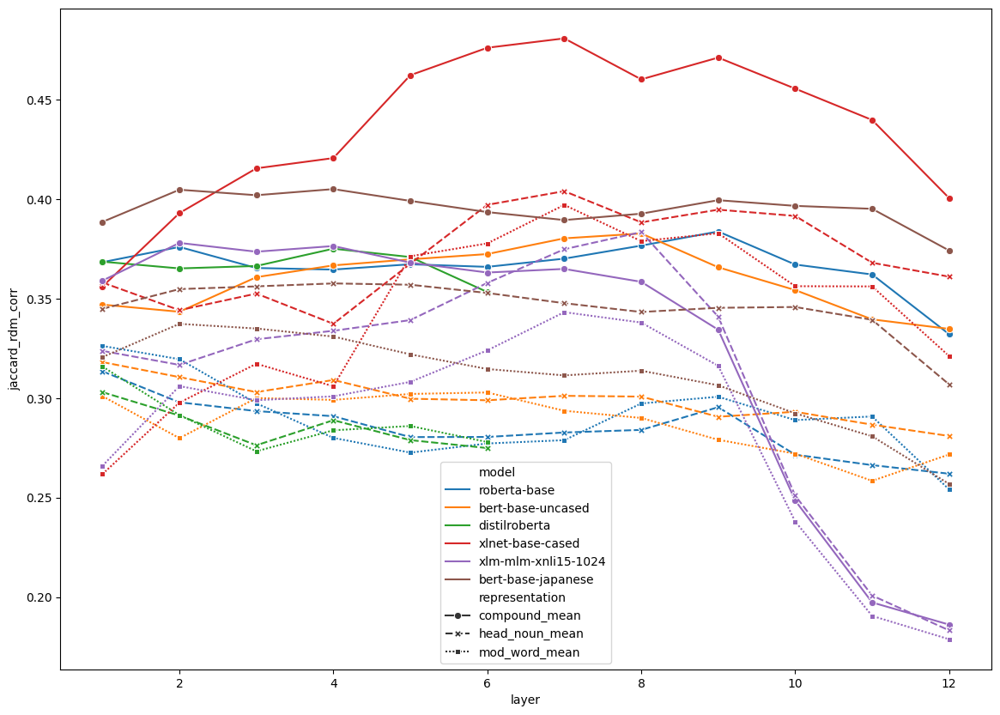

### Jaccard RDM Correlation (Within Compound Sentences)

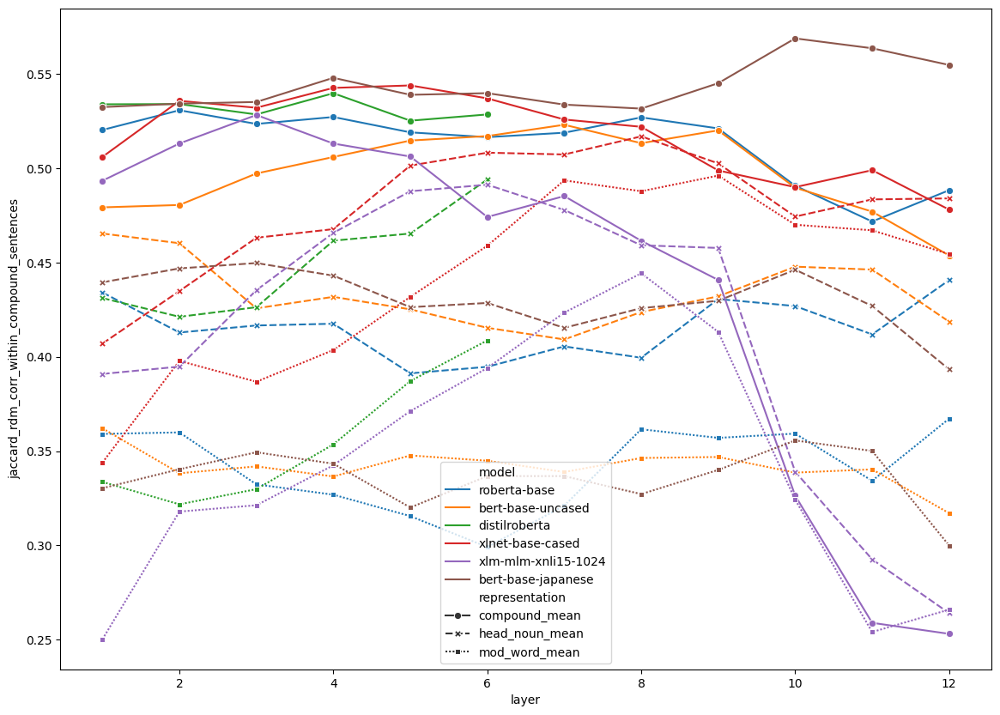

### Monge Elkan RDM Correlation

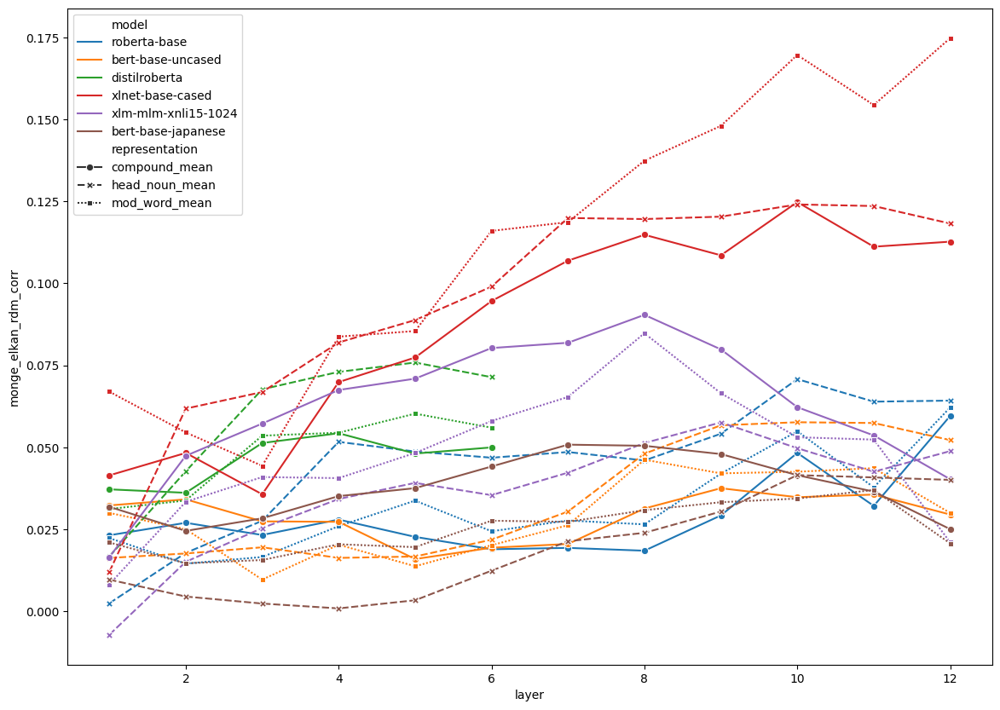

### Monge Elkan RDM Correlation (Within Compound Sentences)

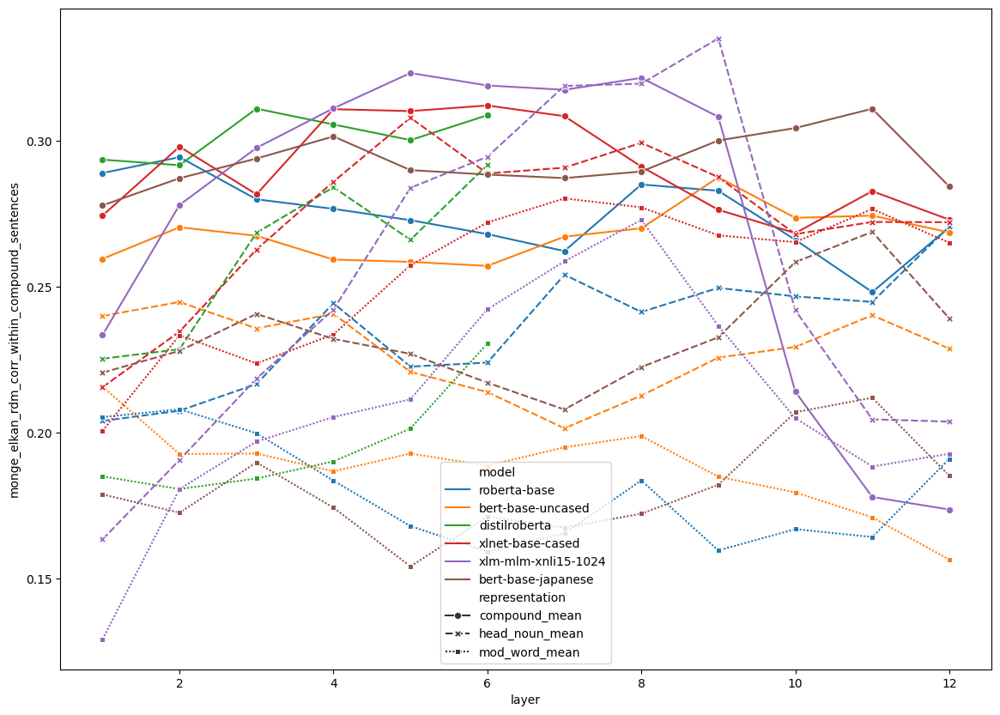

### Ratcliff Obershelp RDM Correlation

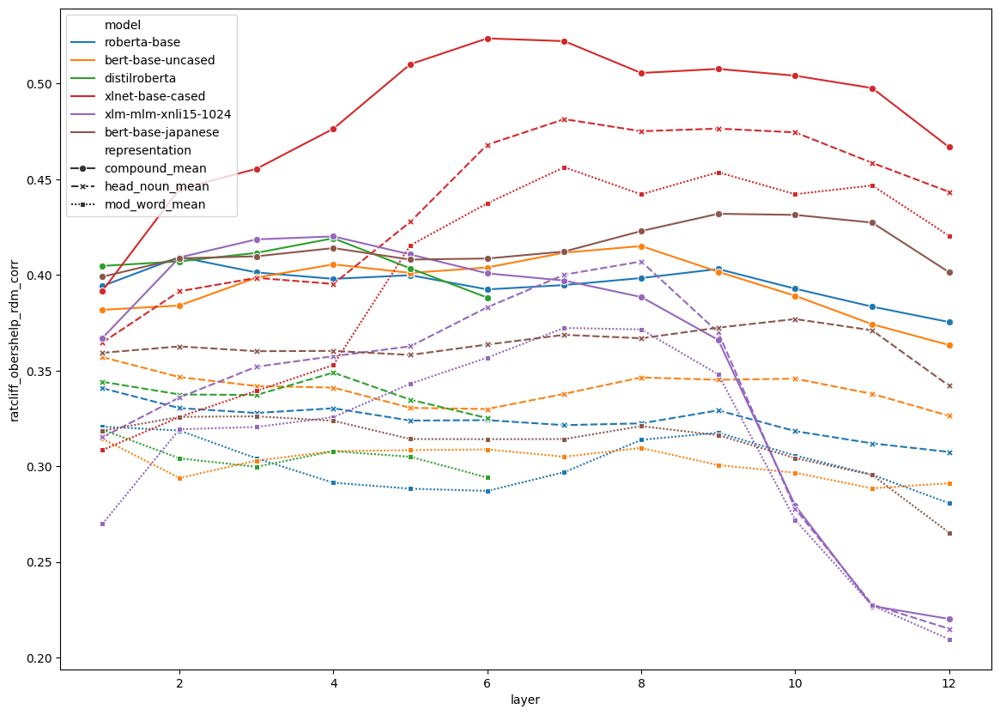

### Ratcliff Obershelp RDM Correlation (Within Compound Sentences)

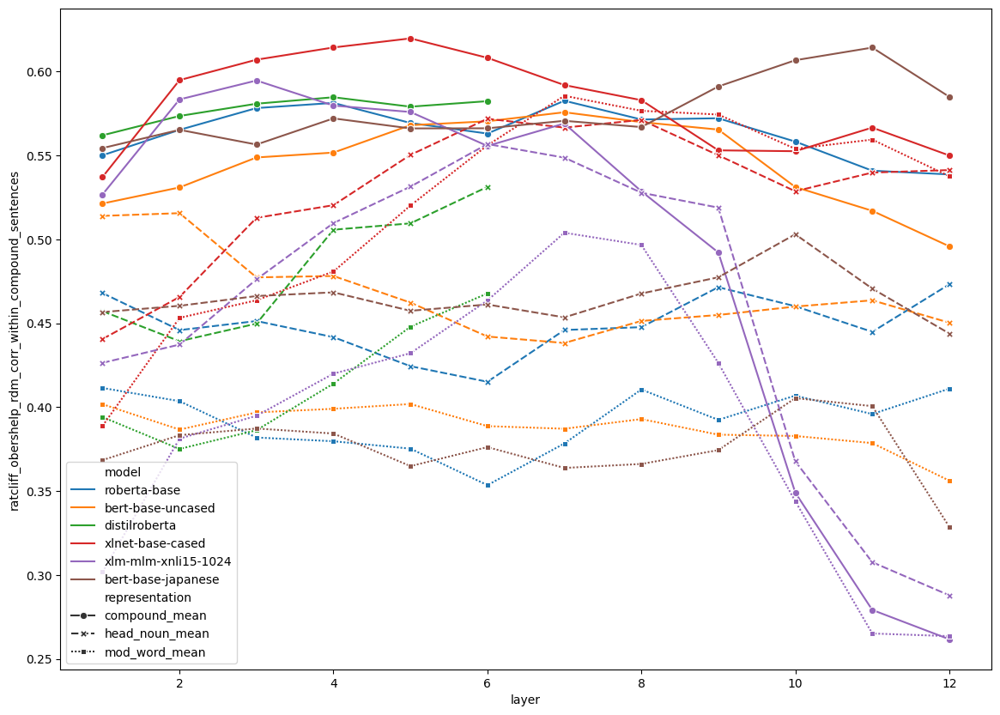

### Levenshtein RDM Correlation

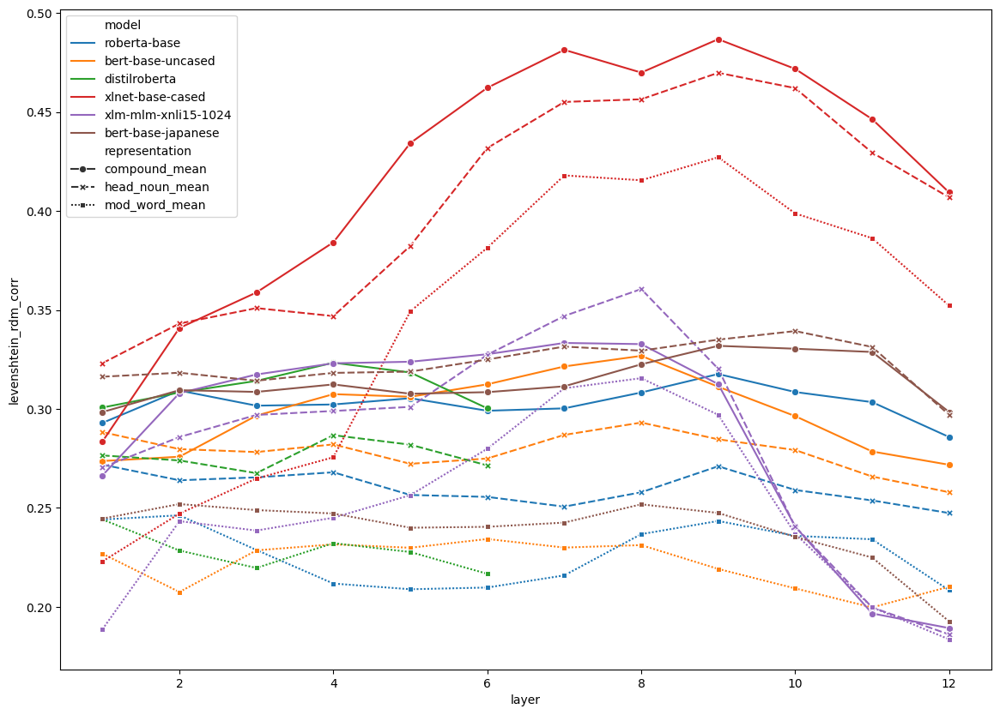

### Levenshtein RDM Correlation (Within Compound Sentences)

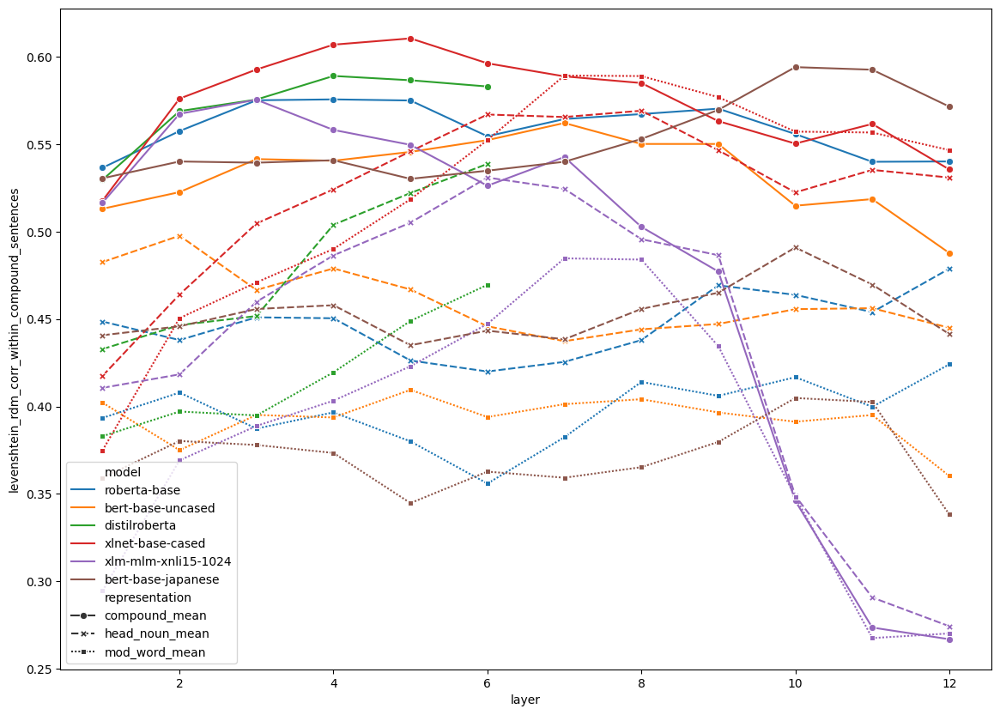

In [102]:
for text_feature in [x[0] for x in rdms_to_correlate][1:-1]:
    plot(text_feature + '_corr')
    plot(text_feature + '_corr_within_compound_sentences')

**Average number of letters in head word:**

## Correlation between FastText RDM and Transformer layer RDM (whole sentence avg., only considering relations within compound groups)

In [103]:
results_per_word_df.keys()

Index(['model', 'layer', 'representation', 'paraphrase_identity_rdm_corr',
       'paraphrase_identity_rdm_std',
       'paraphrase_identity_rdm_corr_within_compound_sentences',
       'paraphrase_identity_rdm_std_within_compound_sentences',
       'jaccard_rdm_corr', 'jaccard_rdm_std',
       'jaccard_rdm_corr_within_compound_sentences',
       'jaccard_rdm_std_within_compound_sentences', 'monge_elkan_rdm_corr',
       'monge_elkan_rdm_std', 'monge_elkan_rdm_corr_within_compound_sentences',
       'monge_elkan_rdm_std_within_compound_sentences',
       'ratcliff_obershelp_rdm_corr', 'ratcliff_obershelp_rdm_std',
       'ratcliff_obershelp_rdm_corr_within_compound_sentences',
       'ratcliff_obershelp_rdm_std_within_compound_sentences',
       'levenshtein_rdm_corr', 'levenshtein_rdm_std',
       'levenshtein_rdm_corr_within_compound_sentences',
       'levenshtein_rdm_std_within_compound_sentences',
       'fasttext_mean_rdm_corr', 'fasttext_mean_rdm_std',
       'fasttext_mean_rdm_c

### Fasttext Mean RDM Correlation

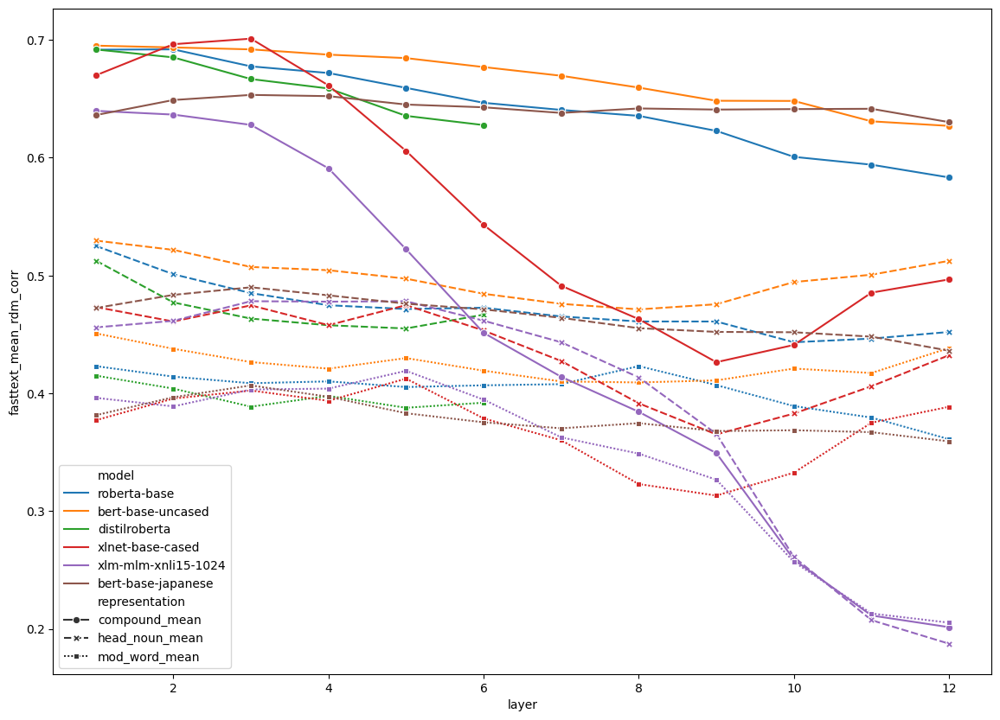

### Fasttext Mean RDM Correlation (Within Compound Sentences)

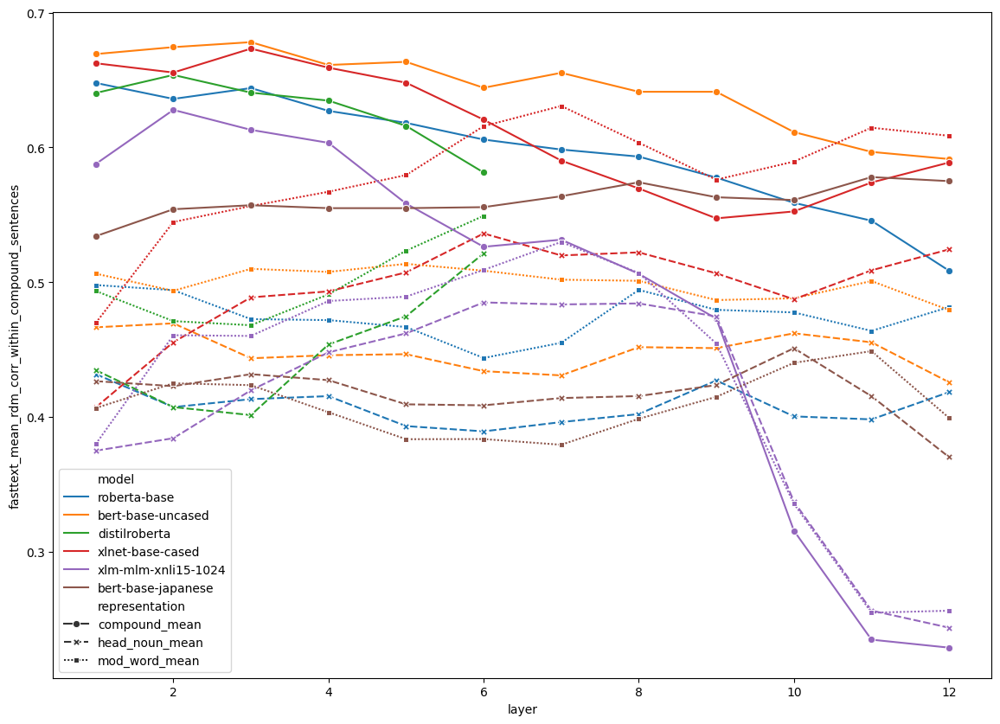

In [104]:
plot('fasttext_mean_rdm_corr')
plot('fasttext_mean_rdm_corr_within_compound_sentences')

## Distance between head noun and modifier word over layers

Here I investigate the relationship between the average head noun representation and average modifier word representation.

The first graph shows the correlation between the head noun RDM and the modifier word RDM.

The second graph shows the cosine distance between head noun token (mean-pooled) token representations and modifier word token representations, averaged across the sentences in the dataset.

In [105]:
noun_noun_compound_similarity_results

,model,layer,avg_head_mod_dist,compound_correlation
0,roberta-base,1,0.527124,0.099480
1,roberta-base,2,0.310811,0.116602
2,roberta-base,3,0.248188,0.105540
3,roberta-base,4,0.219394,0.109070
4,roberta-base,5,0.209725,0.103072
...,...,...,...,...
61,bert-base-japanese,8,0.477257,0.067555
62,bert-base-japanese,9,0.448098,0.078723
63,bert-base-japanese,10,0.345016,0.086011
64,bert-base-japanese,11,0.220795,0.096974


In [128]:
 # noun_noun_compound_similarity_results.append({'model': model_name, 'layer': layer, 'avg_head_mod_dist': np.mean([cosine(reps[i, 1, :].squeeze(), reps[i, 0, :].squeeze()) for i in range(900)]),
#                                                        'compound_correlation': corr(head_noun_rdm, mod_word_rdm).correlation}, ignore_index=True)
# noun_noun_compound_similarity_results

### Correlation between the head noun RDM and modifier word RDM

<Axes: xlabel='layer', ylabel='compound_correlation'>

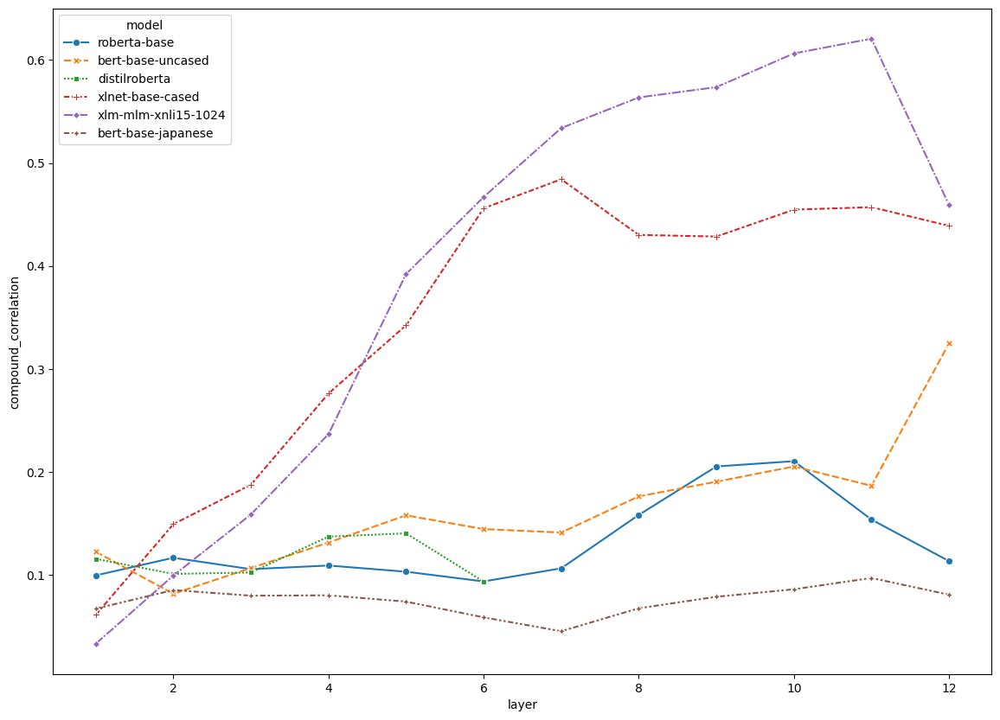

In [106]:
plt.figure(figsize=(14, 10))
sns.lineplot(x='layer', y='compound_correlation', hue='model', style='model', markers=True, data=noun_noun_compound_similarity_results)

### Average cosine distance between head noun and modifier word representations

<Axes: xlabel='layer', ylabel='avg_head_mod_dist'>

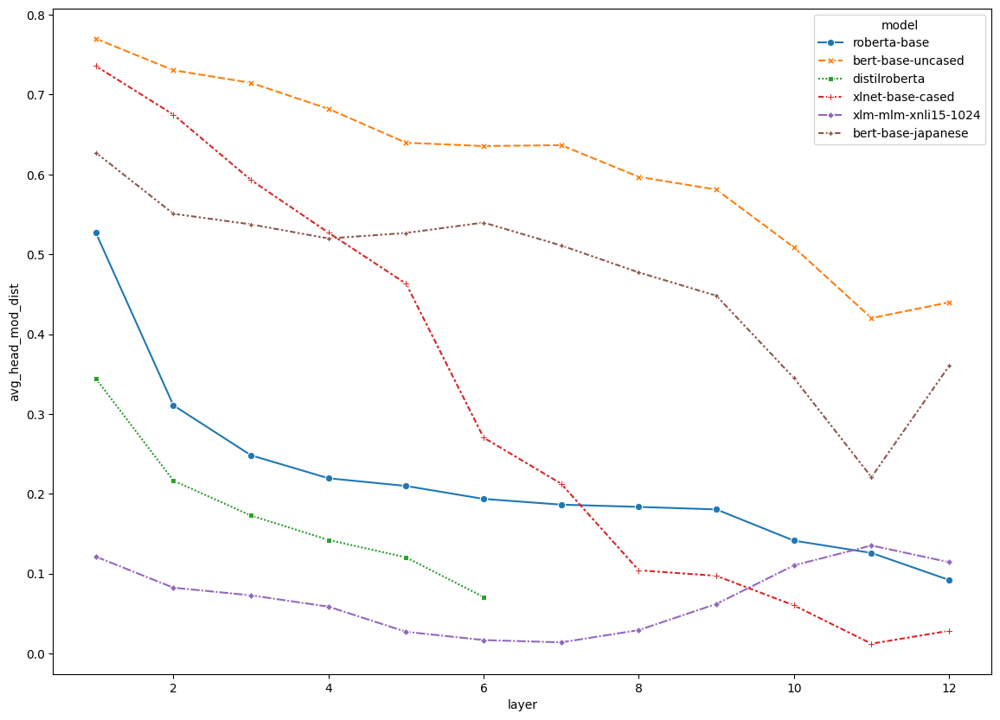

In [107]:

plt.figure(figsize=(14, 10))
sns.lineplot(x='layer', y='avg_head_mod_dist', hue='model', style='model', markers=True, data=noun_noun_compound_similarity_results)

## Experimental Conditions RSA (on a compound/head noun/modifier word level)

In [108]:
def get_results(rdm, model_name, layer):
    same_relation_within_groups_corr, same_relation_within_groups_pvalue = rsa_utils.correlate_over_groups(rdm, rsa_utils.get_lower_triangle(same_relation_group_rdm), second_rdm_group_level_already=True, corr_metric=corr_metric)
    same_head_within_groups_corr, same_head_within_groups_pvalue = rsa_utils.correlate_over_groups(rdm, rsa_utils.get_lower_triangle(same_head_rdm), second_rdm_group_level_already=True, corr_metric=corr_metric)
    same_modifier_within_groups_corr, same_modifier_within_groups_pvalue = rsa_utils.correlate_over_groups(rdm, rsa_utils.get_lower_triangle(same_modifier_rdm), second_rdm_group_level_already=True, corr_metric=corr_metric)

    return {'model': model_name, 'layer': layer, 
             "same_relation_within_groups_corr": same_relation_within_groups_corr, "same_relation_within_groups_pvalue": same_relation_within_groups_pvalue,
             "same_head_within_groups_corr": same_head_within_groups_corr, "same_head_within_groups_pvalue": same_head_within_groups_pvalue,
             "same_modifier_within_groups_corr": same_modifier_within_groups_corr, "same_modifier_within_groups_pvalue": same_modifier_within_groups_pvalue}

In [109]:
row = {'model': 'random', 'layer': 'none', 'representation': 'random'}

random_rdm = rsa_utils.get_rdm(np.random.randn(900, 1000)[paraphrase_inds])
row = {**row, **rsa_utils.correlate_over_groups_and_get_row_values(random_rdm, group_rdms_to_correlate[0][-1], 'same_relation_group_rdm', second_rdm_group_level_already=True)}


In [110]:
load = False

if load:
    relation_results_within_compound_groups_per_word_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_transformer_relations_per_word.csv')
else:
    rows = []

    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue
            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))


            if 'llama' in model_name:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds].reshape(-1, 1))
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1].squeeze()[paraphrase_inds].reshape(-1, 1))
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0].squeeze()[paraphrase_inds].reshape(-1, 1))
            elif 'openai' in model_name:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds].reshape(-1, 1))
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1].squeeze()[paraphrase_inds].reshape(-1, 1))
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0].squeeze()[paraphrase_inds].reshape(-1, 1))
            else:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds])
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1, :].squeeze()[paraphrase_inds])
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0, :].squeeze()[paraphrase_inds])
            
            for rdm_name, rdm in [('compound_mean', compound_rdm), ('head_noun_mean', head_noun_rdm), ('mod_word_mean', mod_word_rdm)]:
                row = {'model': model_name, 'layer': layer, 'representation': rdm_name}

                
            

                for target_rdm_name, target_rdm in group_rdms_to_correlate:
                    second_rdm_group_level_already = target_rdm_name == 'same_relation_group_rdm'
                    row = {**row, **rsa_utils.correlate_over_groups_and_get_row_values(rdm, target_rdm, target_rdm_name, second_rdm_group_level_already=second_rdm_group_level_already)}

                rows.append(row)


    relation_results_within_compound_groups_per_word_df = pd.DataFrame(rows)
    relation_results_within_compound_groups_per_word_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_transformer_relations_per_word.csv')

roberta-base


100%|██████████| 16/16 [02:35<00:00,  9.70s/it]


bert-base-uncased


100%|██████████| 16/16 [02:52<00:00, 10.76s/it]


distilroberta


100%|██████████| 16/16 [01:25<00:00,  5.32s/it]


xlnet-base-cased


100%|██████████| 16/16 [03:39<00:00, 13.73s/it]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [03:22<00:00, 12.67s/it]


bert-base-japanese


100%|██████████| 16/16 [03:16<00:00, 12.27s/it]


## Correlations for Experiment 1A

In [135]:
# Experiment A random correlations

In [111]:
all_reps = np.random.randn(900, 768)
random_rdm = rsa_utils.get_rdm(all_reps)

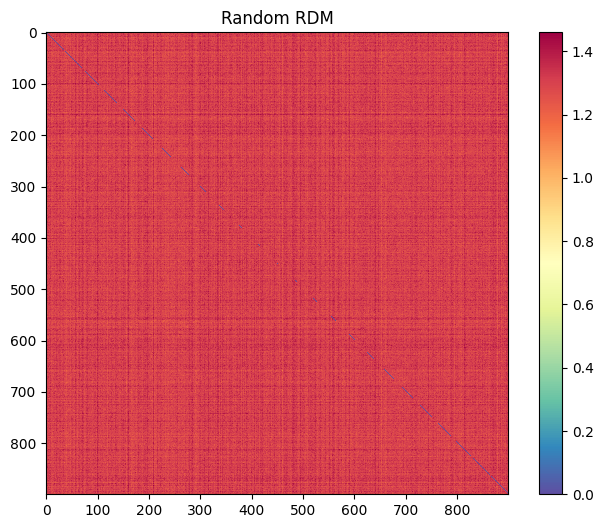

In [112]:
rsa_utils.plot_mtx(random_rdm, 'Random RDM')

In [138]:
# len(random_corrs)

In [139]:
# target_rdm.shape

In [140]:
# target_rdm = dict(group_rdms_to_correlate)['same_relation_group_rdm']
# target_rdm_name = 'same_relation_group_rdm'

# random_corrs = rsa_utils.correlate_over_groups(random_rdm, target_rdm, second_rdm_group_level_already=True, within_compound_sentence_corrs=True)


In [141]:
# load = False

# if load:
#     relation_results_within_compound_groups_per_word_df = pd.read_csv('../data/results/nn_compound_transformer_relations_per_word.csv')
# else:
#     rows = []

#     corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

#     for model_name in model_names:
#         print(model_name)
#         for layer in tqdm.tqdm(range(1, 13)):
#             if layer > 6 and 'distil' in model_name:
#                 continue
#             reps = np.load('../data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))

#             compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds])
#             head_noun_rdm = rsa_utils.get_rdm(reps[:, 1, :].squeeze()[paraphrase_inds])
#             mod_word_rdm = rsa_utils.get_rdm(reps[:, 0, :].squeeze()[paraphrase_inds])

#             for rdm_name, rdm in [('compound_mean', compound_rdm), ('head_noun_mean', head_noun_rdm), ('mod_word_mean', mod_word_rdm)]:
#                 row = {'model': model_name, 'layer': layer, 'representation': rdm_name}
    
#                 corrs = rsa_utils.correlate_over_groups(rdm, target_rdm, target_rdm_name, second_rdm_group_level_already=True)
                    
#                 rows.append(row)


#     relation_results_within_compound_groups_per_word_df = pd.DataFrame(rows)
#     relation_results_within_compound_groups_per_word_df.to_csv('../data/results/nn_compound_transformer_relations_per_word.csv')

## Experiment 1B: Compositional RSA Test

In [142]:
# len(compound_correlation_dict['xlnet-base-cased_1'])

In [113]:
[x[0] for x in group_rdms_to_correlate]

['same_relation_group_rdm', 'same_head_rdm', 'same_modifier_rdm']

In [114]:
load = False

if load:
    relation_results_within_compound_groups_per_word_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_transformer_relations_per_word.csv')
    
    with open('D:/NOUN-NOUN-COMPOUNDS-V1/files/compound_correlation_dict.pkl', 'rb') as f:
        compound_correlation_dict = pickle.load(f)
    
else:
    rows = []
    i = 0
    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)
    
    compound_correlation_dict = {}
    
    for model_name in model_names:

        for layer in tqdm.tqdm(range(1, 17)):
            
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue

            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))

            if 'llama' in model_name:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds].reshape(-1, 1))
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1].squeeze()[paraphrase_inds].reshape(-1, 1))
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0].squeeze()[paraphrase_inds].reshape(-1, 1))
            elif 'openai' in model_name:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds].reshape(-1, 1))
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1].squeeze()[paraphrase_inds].reshape(-1, 1))
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0].squeeze()[paraphrase_inds].reshape(-1, 1))
            else:
                compound_rdm = rsa_utils.get_rdm(reps.mean(axis=1)[paraphrase_inds])
                head_noun_rdm = rsa_utils.get_rdm(reps[:, 1, :].squeeze()[paraphrase_inds])
                mod_word_rdm = rsa_utils.get_rdm(reps[:, 0, :].squeeze()[paraphrase_inds])

            for rdm_name, rdm in [('compound_mean', compound_rdm), ('head_noun_mean', head_noun_rdm), ('mod_word_mean', mod_word_rdm)]:

                row = {'model': model_name, 'layer': layer, 'representation': rdm_name}

                for target_rdm_name, target_rdm in group_rdms_to_correlate:
                    second_rdm_group_level_already = target_rdm_name == 'same_relation_group_rdm'
                    res, corrs = rsa_utils.correlate_over_groups_and_get_row_values(rdm, target_rdm, target_rdm_name, second_rdm_group_level_already=second_rdm_group_level_already,
                                                                                          keep_corrs=True)
                    row = {**row, **res}
                    
                    if target_rdm_name == 'same_relation_group_rdm' and 'compound' in rdm_name:
                        compound_correlation_dict['{}_{}'.format(model_name, layer)] = corrs 
                    
                    rows.append(row)

    with open('D:/NOUN-NOUN-COMPOUNDS-V1/files/compound_correlation_dict.pkl', 'wb') as f:
        pickle.dump(compound_correlation_dict, f, pickle.HIGHEST_PROTOCOL)
        
    relation_results_within_compound_groups_per_word_df = pd.DataFrame(rows)
    relation_results_within_compound_groups_per_word_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/nn_compound_transformer_relations_per_word.csv')

100%|██████████| 16/16 [03:01<00:00, 11.37s/it]


In [200]:
[i // 3 for i in range(20)]

[0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3, 4, 4, 4, 5, 5, 5, 6, 6]

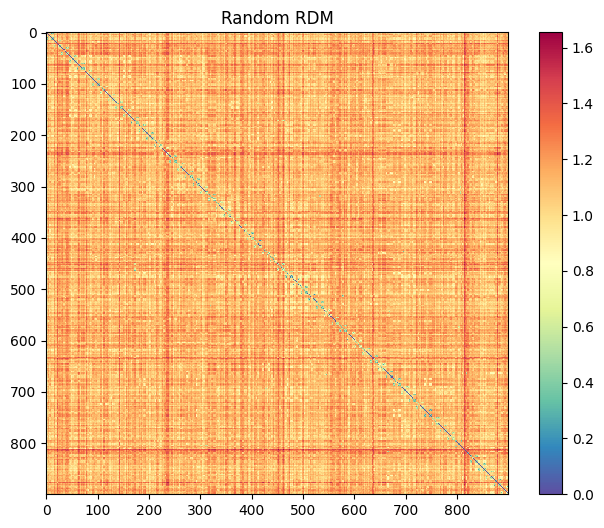

In [115]:
rsa_utils.plot_mtx(rdm, 'Random RDM')

In [117]:
load = True

if not load:
    nrand = 100
    random_rows = []

    for n in tqdm.tqdm(range(nrand)):
        all_reps = np.random.randn(900, 768)
        rdm = rsa_utils.get_rdm(all_reps)

        random_row = {'n': n}
        for target_rdm_name, target_rdm in group_rdms_to_correlate:
            second_rdm_group_level_already = target_rdm_name == 'same_relation_group_rdm'
            random_row = {**random_row, **rsa_utils.correlate_over_groups_and_get_row_values(rdm, target_rdm, target_rdm_name, second_rdm_group_level_already=second_rdm_group_level_already)}

        random_rows.append(random_row)

    random_df = pd.DataFrame(random_rows)
    random_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/random_df.csv')
else:
    random_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/random_df.csv')

In [118]:
random_df

,Unnamed: 0,n,same_relation_group_rdm_corr,same_relation_group_rdm_std,same_relation_group_rdm_corr_within_compound_sentences,same_relation_group_rdm_std_within_compound_sentences,same_head_rdm_corr,same_head_rdm_std,same_head_rdm_corr_within_compound_sentences,same_head_rdm_std_within_compound_sentences,same_modifier_rdm_corr,same_modifier_rdm_std,same_modifier_rdm_corr_within_compound_sentences,same_modifier_rdm_std_within_compound_sentences
0,0,0,0.014097,0.100921,0.037974,0.305469,-0.002036,0.098754,0.008338,0.290666,0.009331,0.103252,-0.040120,0.322051
1,1,1,-0.009111,0.093416,-0.039284,0.307151,0.017536,0.112344,0.008881,0.296898,-0.017715,0.094099,-0.047711,0.317700
2,2,2,-0.013164,0.094536,-0.032736,0.272653,-0.006486,0.122266,0.028007,0.341884,-0.014575,0.121437,-0.028193,0.317589
3,3,3,0.002902,0.098459,0.030118,0.286921,0.005661,0.123628,-0.017643,0.299505,-0.010331,0.109132,-0.042289,0.339898
4,4,4,-0.007152,0.102894,0.024880,0.308151,0.005975,0.114686,-0.011241,0.324884,-0.000114,0.111782,-0.002169,0.343951
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95,95,0.004436,0.093518,0.018332,0.301016,0.017107,0.109101,0.033558,0.315906,-0.007419,0.097566,-0.053132,0.311223
96,96,96,0.012407,0.109816,-0.020951,0.347793,-0.008097,0.103507,0.036973,0.318312,0.014707,0.104356,0.022771,0.270038
97,97,97,-0.011713,0.108502,-0.036665,0.350328,0.002485,0.118160,0.017455,0.274656,0.013198,0.114478,-0.039036,0.312401
98,98,98,0.000145,0.092198,-0.026189,0.311199,-0.000786,0.091397,0.026352,0.332935,-0.011585,0.113064,-0.073735,0.314262


In [120]:
load = False

if load:
    experiment_1b_results_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/experiment_1b_results.csv')    
    
    with open('D:/NOUN-NOUN-COMPOUNDS-V1/files/experiment_1b_compound_correlation_dict.pkl', 'rb') as f:
        experiment_1b_compound_correlation_dict = pickle.load(f)
else:
    rows = []
    
    experiment_1b_compound_correlation_dict = {}

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue
            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/compositional_analysis/{}_layer_{}_compositional_analysis.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            reps = np.mean(np.dstack([reps[np.where(np.arange(reps.shape[0]) % 2 == 0)], reps[np.where(np.arange(reps.shape[0]) % 2 == 1)]]), axis=-1)                                             
            
            all_reps = np.zeros((900, reps.shape[-1]))

            for i in range(900):
                all_reps[i, :] = reps[i // 3, :]
                
            rdm = rsa_utils.get_rdm(all_reps)
            
            row = {'model': model_name, 'layer': layer, 'representation': 'not_processed_together'}

            for target_rdm_name, target_rdm in [group_rdms_to_correlate[0]]:
                second_rdm_group_level_already = target_rdm_name == 'same_relation_group_rdm'
                
                res, corrs = rsa_utils.correlate_over_groups_and_get_row_values(rdm, target_rdm, target_rdm_name, second_rdm_group_level_already=second_rdm_group_level_already, keep_corrs=True)
                row = {**row, **res}
                
                if target_rdm_name == 'same_relation_group_rdm':
                    experiment_1b_compound_correlation_dict['{}_{}'.format(model_name, layer)] = corrs 
            rows.append(row)
            
    with open('D:/NOUN-NOUN-COMPOUNDS-V1/files/experiment_1b_compound_correlation_dict.pkl', 'wb') as f:
        pickle.dump(experiment_1b_compound_correlation_dict, f, pickle.HIGHEST_PROTOCOL)
        
    experiment_1b_results_df = pd.DataFrame(rows)
    experiment_1b_results_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/experiment_1b_results.csv')

roberta-base


100%|██████████| 16/16 [00:12<00:00,  1.27it/s]


bert-base-uncased


100%|██████████| 16/16 [00:12<00:00,  1.26it/s]


distilroberta


100%|██████████| 16/16 [00:06<00:00,  2.56it/s]


xlnet-base-cased


100%|██████████| 16/16 [00:12<00:00,  1.27it/s]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [00:12<00:00,  1.24it/s]


bert-base-japanese


100%|██████████| 16/16 [00:12<00:00,  1.29it/s]


In [121]:
experiment_1b_results_df

,model,layer,representation,same_relation_group_rdm_corr,same_relation_group_rdm_std,same_relation_group_rdm_corr_within_compound_sentences,same_relation_group_rdm_std_within_compound_sentences
0,roberta-base,1,not_processed_together,0.248088,0.123312,-0.023646,0.182236
1,roberta-base,2,not_processed_together,0.250701,0.124159,-0.019756,0.183063
2,roberta-base,3,not_processed_together,0.274517,0.123983,0.015600,0.182620
3,roberta-base,4,not_processed_together,0.281607,0.123630,0.026113,0.182463
4,roberta-base,5,not_processed_together,0.298367,0.128589,0.050993,0.189748
...,...,...,...,...,...,...,...
61,bert-base-japanese,8,not_processed_together,0.250768,0.156529,-0.019680,0.232028
62,bert-base-japanese,9,not_processed_together,0.259622,0.155946,-0.006547,0.231426
63,bert-base-japanese,10,not_processed_together,0.263184,0.135295,-0.001271,0.201088
64,bert-base-japanese,11,not_processed_together,0.267595,0.131596,0.005276,0.195576


## Correlation between Same Thematic Relation RDM and RDMs constructed from mean-pooled compound word/head noun/modifier word representations (only within compound group comparisons)

In [122]:
relation_results_within_compound_groups_per_word_df.keys()

Index(['model', 'layer', 'representation', 'same_relation_group_rdm_corr',
       'same_relation_group_rdm_std',
       'same_relation_group_rdm_corr_within_compound_sentences',
       'same_relation_group_rdm_std_within_compound_sentences',
       'same_head_rdm_corr', 'same_head_rdm_std',
       'same_head_rdm_corr_within_compound_sentences',
       'same_head_rdm_std_within_compound_sentences', 'same_modifier_rdm_corr',
       'same_modifier_rdm_std',
       'same_modifier_rdm_corr_within_compound_sentences',
       'same_modifier_rdm_std_within_compound_sentences'],
      dtype='object')

### Same Relation Group RDM Correlation

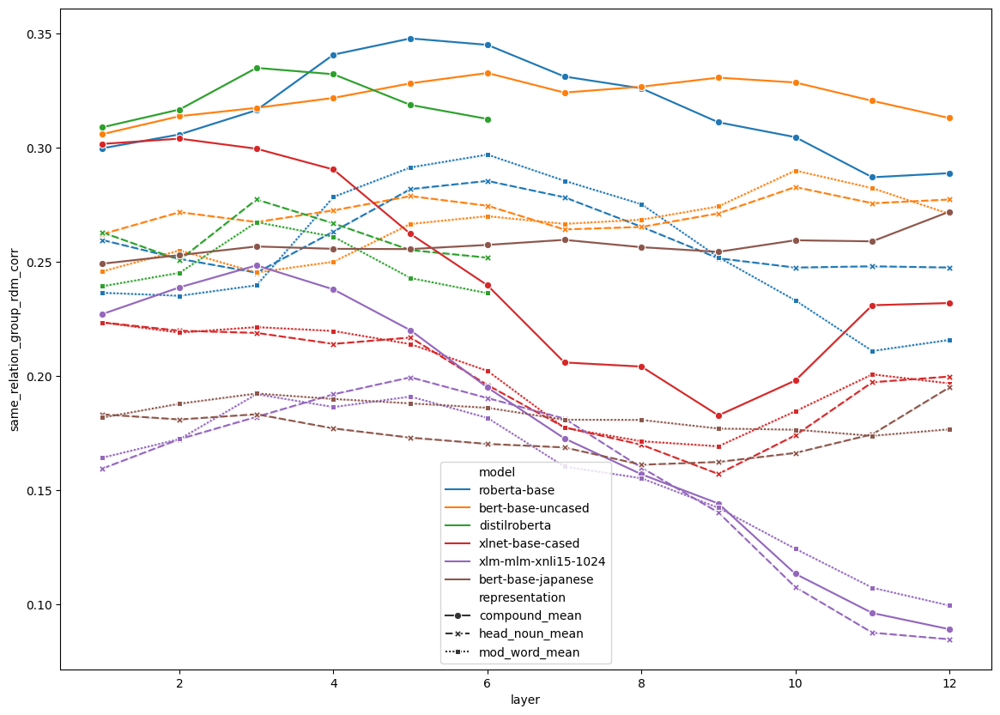

### Same Relation Group RDM Correlation (Within Compound Sentences)

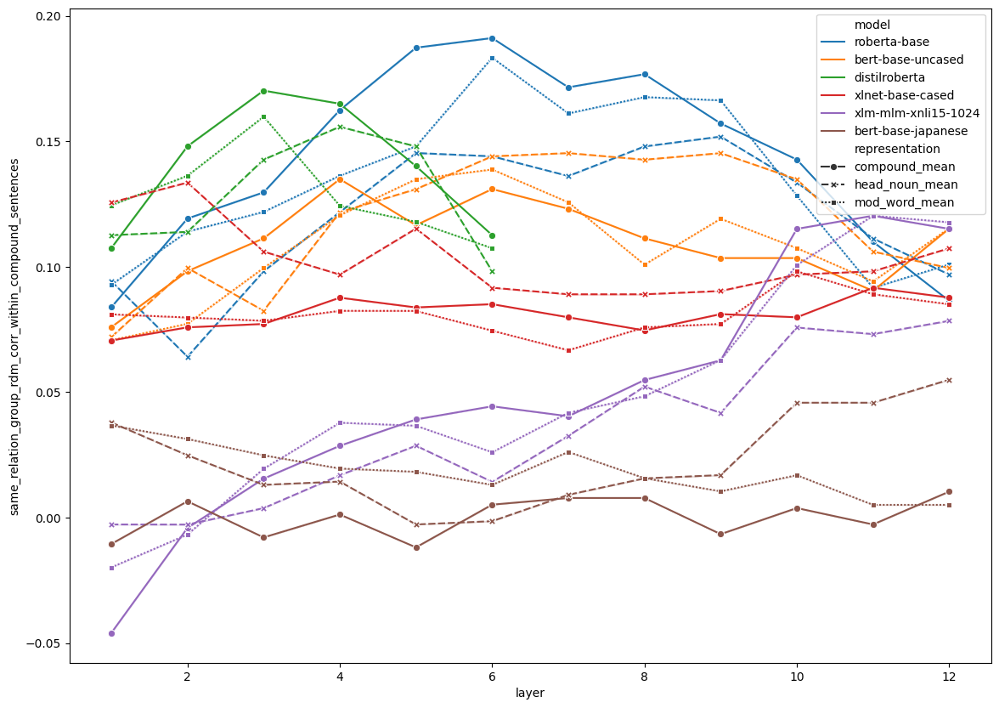

In [123]:
plot('same_relation_group_rdm_corr', df=relation_results_within_compound_groups_per_word_df)
plot('same_relation_group_rdm_corr_within_compound_sentences', df=relation_results_within_compound_groups_per_word_df)

In [124]:
relation_results_within_compound_groups_per_word_df

,model,layer,representation,same_relation_group_rdm_corr,same_relation_group_rdm_std,same_relation_group_rdm_corr_within_compound_sentences,same_relation_group_rdm_std_within_compound_sentences,same_head_rdm_corr,same_head_rdm_std,same_head_rdm_corr_within_compound_sentences,same_head_rdm_std_within_compound_sentences,same_modifier_rdm_corr,same_modifier_rdm_std,same_modifier_rdm_corr_within_compound_sentences,same_modifier_rdm_std_within_compound_sentences
0,roberta-base,1,compound_mean,0.299743,0.082528,0.083881,0.174461,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,roberta-base,1,compound_mean,0.299743,0.082528,0.083881,0.174461,0.511858,0.096528,0.367177,0.185296,NaN,NaN,NaN,NaN
2,roberta-base,1,compound_mean,0.299743,0.082528,0.083881,0.174461,0.511858,0.096528,0.367177,0.185296,0.490407,0.106850,0.415623,0.191814
3,roberta-base,1,head_noun_mean,0.259523,0.111292,0.094281,0.202251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,roberta-base,1,head_noun_mean,0.259523,0.111292,0.094281,0.202251,0.695200,0.013155,0.680411,0.031758,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
589,bert-base-japanese,12,head_noun_mean,0.194962,0.093115,0.054997,0.177604,0.695165,0.013141,0.680411,0.031758,NaN,NaN,NaN,NaN
590,bert-base-japanese,12,head_noun_mean,0.194962,0.093115,0.054997,0.177604,0.695165,0.013141,0.680411,0.031758,-0.022108,0.080421,-0.148382,0.181771
591,bert-base-japanese,12,mod_word_mean,0.176653,0.100866,0.005124,0.190914,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
592,bert-base-japanese,12,mod_word_mean,0.176653,0.100866,0.005124,0.190914,-0.018336,0.084269,-0.145123,0.160734,NaN,NaN,NaN,NaN


In [125]:
fig_shape = (1, 6)
fig_df = relation_results_within_compound_groups_per_word_df


In [126]:
paper_df.columns.difference(['layer'])

Index(['FastText', 'Jaccard', 'Levenshtein', 'Monge Elkan',
       'Ratcliff/Obershelp'],
      dtype='object', name='Target')

In [ ]:
# Table 2

paper_df = relation_results_within_compound_groups_per_word_df.copy()
# del paper_df[paper_df.columns[0]]
paper_df = paper_df.groupby(['model', 'representation']).mean().reset_index().pivot('model', 'representation', 'same_relation_group_rdm_corr_within_compound_sentences')
paper_df.columns.name = None
paper_df = paper_df.reset_index()
paper_df.columns = ['Model', 'C', 'H', 'M']
paper_df = paper_df[['Model', 'M', 'H', 'C']]
paper_df.round(2)

In [150]:
print(paper_df.round(2).to_latex(index=False))

\begin{tabular}{lrlrrrrrrrrrrrr}
\toprule
model & layer & representation & same_relation_group_rdm_corr & same_relation_group_rdm_std & same_relation_group_rdm_corr_within_compound_sentences & same_relation_group_rdm_std_within_compound_sentences & same_head_rdm_corr & same_head_rdm_std & same_head_rdm_corr_within_compound_sentences & same_head_rdm_std_within_compound_sentences & same_modifier_rdm_corr & same_modifier_rdm_std & same_modifier_rdm_corr_within_compound_sentences & same_modifier_rdm_std_within_compound_sentences \\
\midrule
roberta-base & 1 & compound_mean & 0.300000 & 0.080000 & 0.080000 & 0.170000 & NaN & NaN & NaN & NaN & NaN & NaN & NaN & NaN \\
roberta-base & 1 & compound_mean & 0.300000 & 0.080000 & 0.080000 & 0.170000 & 0.510000 & 0.100000 & 0.370000 & 0.190000 & NaN & NaN & NaN & NaN \\
roberta-base & 1 & compound_mean & 0.300000 & 0.080000 & 0.080000 & 0.170000 & 0.510000 & 0.100000 & 0.370000 & 0.190000 & 0.490000 & 0.110000 & 0.420000 & 0.190000 \\
roberta-base 

In [127]:

relation_results_within_compound_groups_per_word_df.columns

Index(['model', 'layer', 'representation', 'same_relation_group_rdm_corr',
       'same_relation_group_rdm_std',
       'same_relation_group_rdm_corr_within_compound_sentences',
       'same_relation_group_rdm_std_within_compound_sentences',
       'same_head_rdm_corr', 'same_head_rdm_std',
       'same_head_rdm_corr_within_compound_sentences',
       'same_head_rdm_std_within_compound_sentences', 'same_modifier_rdm_corr',
       'same_modifier_rdm_std',
       'same_modifier_rdm_corr_within_compound_sentences',
       'same_modifier_rdm_std_within_compound_sentences'],
      dtype='object')

same_relation_group_rdm_corr_within_compound_sentences


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\3507133146.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\3507133146.py:46: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\3507133146.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


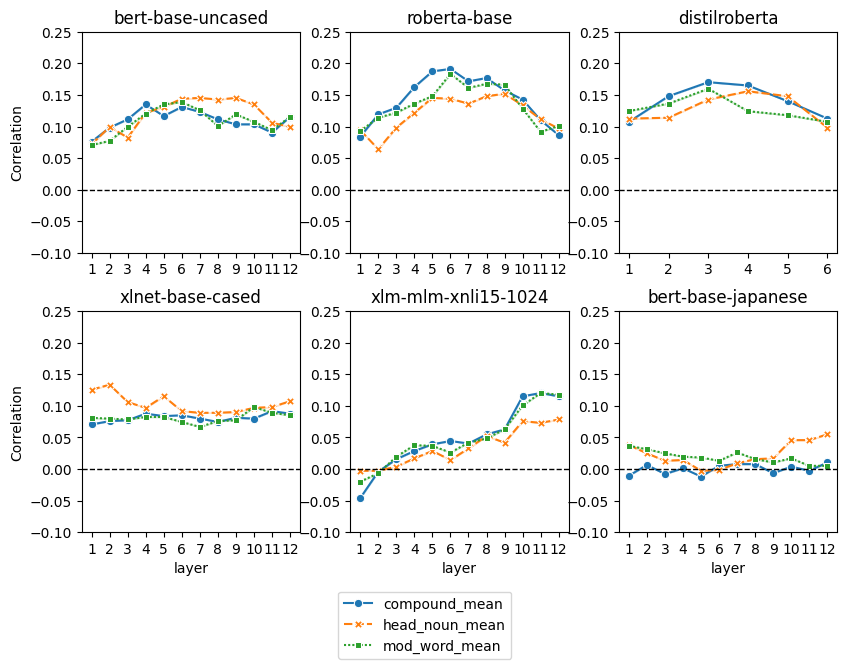

In [128]:
# Figure 4

# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

for y, ylim in zip(['same_relation_group_rdm_corr_within_compound_sentences'], [(-0.1, 0.25)]):
    fig_shape = (2, 3)
    fig_df = relation_results_within_compound_groups_per_word_df
    fig_df = sort_df_by_model_order(fig_df)
    
    print(y)
    single_fig_size = 4
    fig = plt.figure(figsize=(fig_shape[1] * 3.25, fig_shape[0] * 3.25, ))

    grid_height = fig_shape[0] * single_fig_size
    grid_width = fig_shape[1] * single_fig_size
    grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

    for (i, model_df), (fig_y, fig_x) in zip(fig_df.groupby('model_order'), product(range(fig_shape[0]), range(fig_shape[1]))):
        model_df = sort_df_by_model_order(model_df)
        # print(model, fig_coords)
        model = model_df.iloc[0].model
        line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
        g = sns.lineplot(data=model_df, hue='representation', y=y, x='layer', style='representation', markers=True, ax=line_plot_ax);
        line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
        g.set(ylim=ylim);

        if fig_x == 0:
            g.set_ylabel('Correlation');
        else:
            g.set_ylabel('');
            
        if fig_y == 0:
            g.set_xlabel('');

        if fig_x == 0 and fig_y == 0:
            g.legend(loc='best', bbox_to_anchor=(1.5, -2, 0.5, 0.5), ncol=1);
        else:
            g.legend().remove();
            
        g.axhline(0, color='black', linestyle='--', linewidth=1)

        g.set_title(model);
    plt.tight_layout()
    fig.show()
    
plt.tight_layout()

# plt.savefig('../figures/coarse_grained_rsa_results.png', bbox_inches='tight')
# plt.savefig('../figures/coarse_grained_rsa_results.eps', format='eps', bbox_inches='tight')

In [129]:
[print(col, '\t', round(x, 2)) for x, col in zip(random_df.mean(), random_df.columns) if 'corr' in col]

same_relation_group_rdm_corr 	 -0.0
same_relation_group_rdm_corr_within_compound_sentences 	 -0.0
same_head_rdm_corr 	 0.0
same_head_rdm_corr_within_compound_sentences 	 0.0
same_modifier_rdm_corr 	 -0.0
same_modifier_rdm_corr_within_compound_sentences 	 -0.01


[None, None, None, None, None, None]

In [420]:
def format_p_val(p):
    
    if hasattr(p, 'pvalue'):
        p = p.pvalue  # If it's a BinomTestResult, get the pvalue
    p = round(p, 2)
    
    if p == -1:
        p = '-'
    elif p < 0.0001:
        p = 'p<0.0001'  
    elif p < 0.001:
        p = 'p<0.001'
    elif p < 0.01:
        p = 'p<0.01'
    elif p < 0.05:
        p = 'p<0.05'
    else:
        p = 'p={}'.format(p)
    
    return p 

In [423]:
def bonferonni_correction(df):
    # p == -1 for distilroberta layers 7-12 (i.e. non-existent layers)
    fdr_method = 'indep' # 'indep' or 'negcorr
    num_tests = paired_t_test_df[paired_t_test_df.p != -1].shape[0]
    
    df.loc[df.p != -1, 'corrected_p'] =  paired_t_test_df[paired_t_test_df.p != -1].p * num_tests
    df.loc[df.p == -1, 'corrected_p'] = -1

    df['formatted_corrected_p']  = list(map(format_p_val, df.corrected_p))
    
    return df

In [ ]:
def fdr_correction(df):
    # p == -1 for distilroberta layers 7-12 (i.e. non-existent layers)
    fdr_error_rate = 0.05 # default = 0.05
    fdr_method = 'negcorr' # 'indep' or 'negcorr
    df.loc[df.p > -1, 'corrected_p'] = fdrcorrection(df[df.p > -1].p.tolist(), method=fdr_method, alpha=fdr_error_rate)[-1]
    df.loc[df.p == -1, 'corrected_p'] = -1
    df['formatted_corrected_p']  = list(map(format_p_val, df.corrected_p))
    
    return df

In [133]:
list(range(1, 13))

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

In [134]:
print(model_names)

['roberta-base', 'bert-base-uncased', 'distilroberta', 'xlnet-base-cased', 'xlm-mlm-xnli15-1024', 'bert-base-japanese']


In [136]:
rows = []


for model in model_names:
    for layer in list(range(1, 13)):
        row = {'model': model, 'layer': layer}
        if 'distil' in model and layer > 6:
            row['p'] = -1

        else:
            group_correlations_processed_together = compound_correlation_dict['{}_{}'.format(model, layer)]
            group_correlations_processed_apart = experiment_1b_compound_correlation_dict['{}_{}'.format(model, layer)]
            row['p'] =  ttest_rel(group_correlations_processed_together, group_correlations_processed_apart, alternative='greater').pvalue
            
        rows.append(row)
        
paired_t_test_df = pd.DataFrame(rows)

In [137]:
paired_t_test_df = fdr_correction(paired_t_test_df)

In [138]:
model_df['same_relation_group_rdm_corr_within_compound_sentences']

486   -0.010476
487   -0.010476
488   -0.010476
495    0.006547
496    0.006547
         ...   
583    0.005124
584    0.005124
591    0.005124
592    0.005124
593    0.005124
Name: same_relation_group_rdm_corr_within_compound_sentences, Length: 108, dtype: float64

In [139]:
paired_t_test_df[paired_t_test_df.model.str.contains('xlm')]

,model,layer,p,corrected_p,formatted_corrected_p
48,xlm-mlm-xnli15-1024,1,0.938486,1.000000,p=1.0
49,xlm-mlm-xnli15-1024,2,0.706285,1.000000,p=1.0
50,xlm-mlm-xnli15-1024,3,0.723291,1.000000,p=1.0
51,xlm-mlm-xnli15-1024,4,0.808785,1.000000,p=1.0
52,xlm-mlm-xnli15-1024,5,0.550216,1.000000,p=1.0
53,xlm-mlm-xnli15-1024,6,0.456611,1.000000,p=1.0
54,xlm-mlm-xnli15-1024,7,0.822462,1.000000,p=1.0
55,xlm-mlm-xnli15-1024,8,0.725320,1.000000,p=1.0
56,xlm-mlm-xnli15-1024,9,0.665845,1.000000,p=1.0
57,xlm-mlm-xnli15-1024,10,0.053576,0.527575,p=0.53


In [110]:
model_df

,model,layer,representation,same_relation_group_rdm_corr,same_relation_group_rdm_std,same_relation_group_rdm_corr_within_compound_sentences,same_relation_group_rdm_std_within_compound_sentences,same_head_rdm_corr,same_head_rdm_std,same_head_rdm_corr_within_compound_sentences,same_head_rdm_std_within_compound_sentences,same_modifier_rdm_corr,same_modifier_rdm_std,same_modifier_rdm_corr_within_compound_sentences,same_modifier_rdm_std_within_compound_sentences,model_order,model_name,representation_name
576,bert-base-japanese,1,compound_mean,0.249194,0.118888,-0.010476,0.220580,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,BERT-Japanese,compound_mean
577,bert-base-japanese,1,compound_mean,0.249194,0.118888,-0.010476,0.220580,0.538078,0.094555,0.401885,0.175664,NaN,NaN,NaN,NaN,5,BERT-Japanese,compound_mean
578,bert-base-japanese,1,compound_mean,0.249194,0.118888,-0.010476,0.220580,0.538078,0.094555,0.401885,0.175664,0.454960,0.118818,0.382085,0.182764,5,BERT-Japanese,compound_mean
585,bert-base-japanese,2,compound_mean,0.252924,0.117701,0.006547,0.218624,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,BERT-Japanese,compound_mean
586,bert-base-japanese,2,compound_mean,0.252924,0.117701,0.006547,0.218624,0.539738,0.094094,0.421975,0.175541,NaN,NaN,NaN,NaN,5,BERT-Japanese,compound_mean
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
673,bert-base-japanese,11,mod_word_mean,0.173784,0.098469,0.005124,0.188200,-0.010993,0.086193,-0.088668,0.134402,NaN,NaN,NaN,NaN,5,BERT-Japanese,mod_word_mean
674,bert-base-japanese,11,mod_word_mean,0.173784,0.098469,0.005124,0.188200,-0.010993,0.086193,-0.088668,0.134402,0.673242,0.083585,0.683530,0.003069,5,BERT-Japanese,mod_word_mean
681,bert-base-japanese,12,mod_word_mean,0.176653,0.100866,0.005124,0.190914,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,BERT-Japanese,mod_word_mean
682,bert-base-japanese,12,mod_word_mean,0.176653,0.100866,0.005124,0.190914,-0.018336,0.084269,-0.145123,0.160734,NaN,NaN,NaN,NaN,5,BERT-Japanese,mod_word_mean


same_relation_group_rdm_corr_within_compound_sentences


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\2843451321.py:64: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


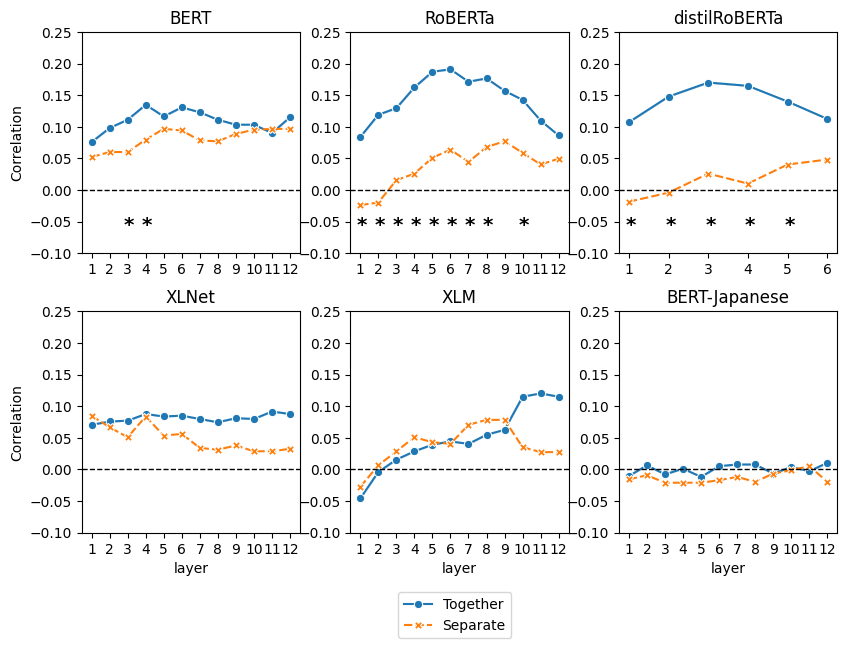

In [140]:
# Figure 5
# Experiment 1b

# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

for y, ylim in zip(['same_relation_group_rdm_corr_within_compound_sentences'], [(-0.1, 0.25)]):
    fig_shape = (2, 3)
    
    rows = relation_results_within_compound_groups_per_word_df[relation_results_within_compound_groups_per_word_df.representation == 'compound_mean'].copy()
    rows['Processing condition'] = 'Together'
    experiment_1b_results_df['Processing condition'] = 'Separate'

    fig_df = pd.concat([rows, experiment_1b_results_df])   
    fig_df = sort_df_by_model_order(fig_df)
    
    print(y)
    single_fig_size = 4
    fig = plt.figure(figsize=(fig_shape[1] * 3.25, fig_shape[0] * 3.25, ))

    grid_height = fig_shape[0] * single_fig_size
    grid_width = fig_shape[1] * single_fig_size
    grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)
    

    for (i, model_df), (fig_y, fig_x) in zip(fig_df.groupby('model_order'), product(range(fig_shape[0]), range(fig_shape[1]))):
        model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
        model = model_df.iloc[0].model
        model_name = model_df.iloc[0].model_name
    
        line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
        g = sns.lineplot(data=model_df, hue='Processing condition', y=y, x='layer', style='Processing condition', markers=True, ax=line_plot_ax);
        line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
        g.set(ylim=ylim);

        if fig_x == 0:
            g.set_ylabel('Correlation');
        else:
            g.set_ylabel('');
            
        if fig_y == 0:
            g.set_xlabel('');

        if fig_x == 0 and fig_y == 0:
            g.legend(loc='best', bbox_to_anchor=(1.5, -2, 0.5, 0.5), ncol=1);
        else:
            g.legend().remove();
            
        g.axhline(0, color='black', linestyle='--', linewidth=1)
        
        g.set_title(model_name);
        
        for layer in model_df.layer.unique():
            pval = paired_t_test_df[(paired_t_test_df.model == model) & (paired_t_test_df.layer == layer)]['corrected_p'].iloc[0]
            x_offset =  0.075 if 'distil' in model else 0.2
            y_offset = 0.1 - 0.035

            if pval <= 0.05:
                y_val = model_df[(model_df.layer==layer)]['same_relation_group_rdm_corr_within_compound_sentences'].min()
                plt.text(layer - x_offset, 0 - y_offset, '*', weight='bold', size='x-large', color='black')
        
    fig.show()
    
# plt.savefig('../figures/coarse_grained_rsa_results_1b.png', bbox_inches='tight')
# plt.savefig('../figures/coarse_grained_rsa_results_1b.eps', format='eps', bbox_inches='tight')

In [175]:
# for rep in ['compound', 'head', 'modifier']:
#     rows = []
#     for (cond, num_relations), rsa_df in finegrained_results_df[(finegrained_results_df.representation == rep)].groupby(['condition', 'num_top_relations_considered']):
#         c = lambda model, x: spearmanr(x, rsa_df.sort_values(['model', 'layer'])[rsa_df.sort_values(['model', 'layer']).model==model].relation_vector_corr.tolist())
#         rows += [{'model': m, 'condition': cond, 'num_relations': num_relations, 'correlation': c(m, df.percentage_increase)[0], 'p': c(m, df.percentage_increase)[1]} for m, df in flat_res.groupby('model')]
#     full_df = pd.DataFrame(rows)
    
#     full_df = sort_df_by_model_order(full_df)
#     full_df['model_order'] = [order_dict[x.model] for x in full_df.iloc]
    
#     fig = plt.figure(figsize=(13, 11))
#     grid = fig.add_gridspec(15, 1)

#     corr_dots_ax = fig.add_subplot(grid[0, 0])
#     corr_dots_ax.axis('off')

#     line_plot_ax = fig.add_subplot(grid[1:, 0])
#     g = sns.lineplot(data=full_df[full_df.condition=='_consider_magnitude'], hue='model', y='correlation', x='num_relations', style='condition', markers=True, ax=line_plot_ax)
#     line_plot_ax.axhline(0, c='black', lw=1)
#     [line_plot_ax.axvline(x, c='black', linestyle='--', lw=0.5) for x in full_df.num_relations.unique()];
#     line_plot_ax.set_xticks(full_df.num_relations.unique());

#     sns.scatterplot(y='model_order', x='num_relations', hue='model', data=full_df[(full_df.condition=='_consider_magnitude') & (full_df.p < 0.05)], ax=corr_dots_ax)
#     corr_dots_ax.get_legend().remove()
#     corr_dots_ax.text(-0.25, 0.6, 'p < 0.05', rotation=45, weight='bold')
    
#     line_plot_ax.set_ylabel('Correlation between compositional test\n percentage increase and RSA\n correlation (mean-pooled {}\n vectors)'.format(rep), rotation=0, ha='right')
#     line_plot_ax.set_ylabel('Correlation')

## Correlation between Same Head Noun RDM and RDMs constructed from mean-pooled compound word/head noun/modifier word representations (only within compound group comparisons)

### Same Head RDM Correlation

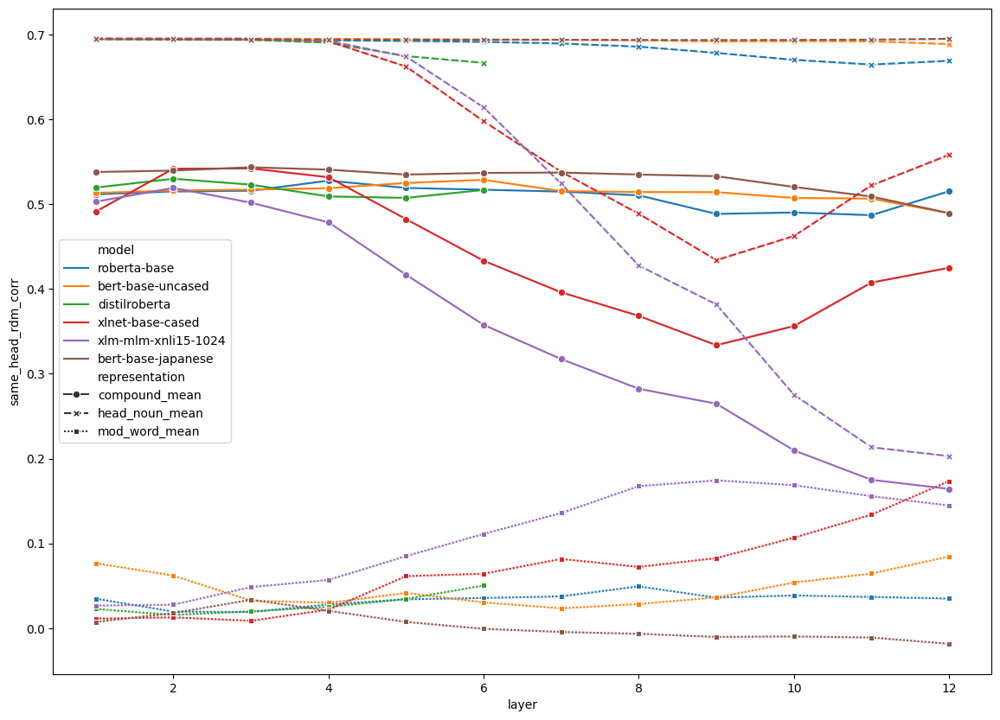

### Same Head RDM Correlation (Within Compound Sentences)

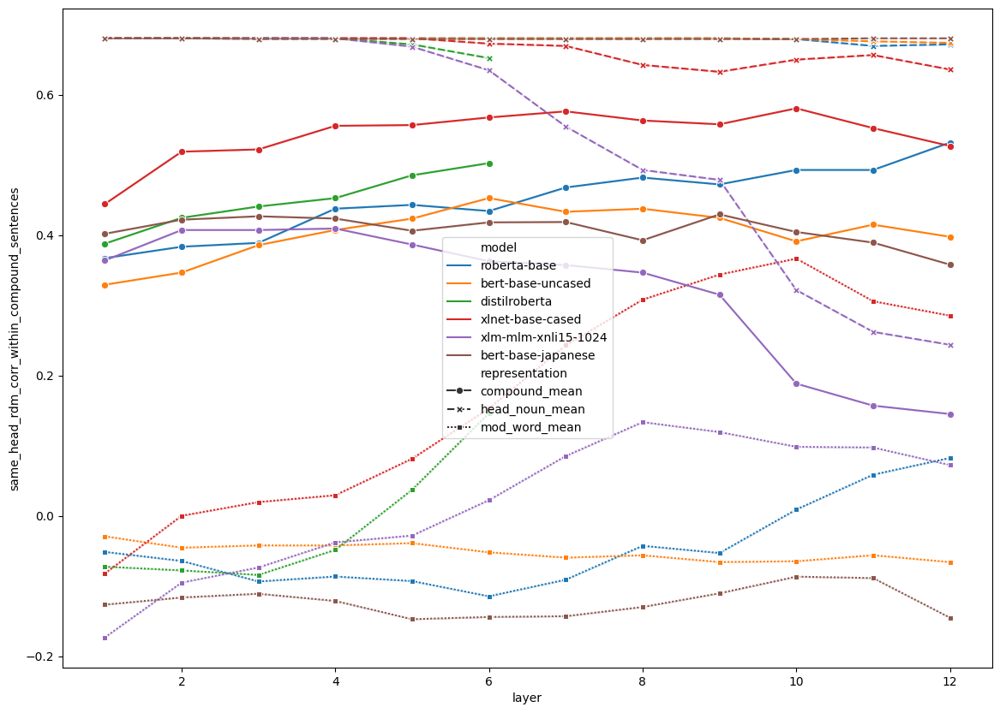

In [141]:
plot('same_head_rdm_corr', df=relation_results_within_compound_groups_per_word_df)
plot('same_head_rdm_corr_within_compound_sentences', df=relation_results_within_compound_groups_per_word_df)

## Correlation between Same Modifier Word RDM and RDMs constructed from mean-pooled compound word/head noun/modifier word representations (only within compound group comparisons)

### Same Modifier RDM Correlation

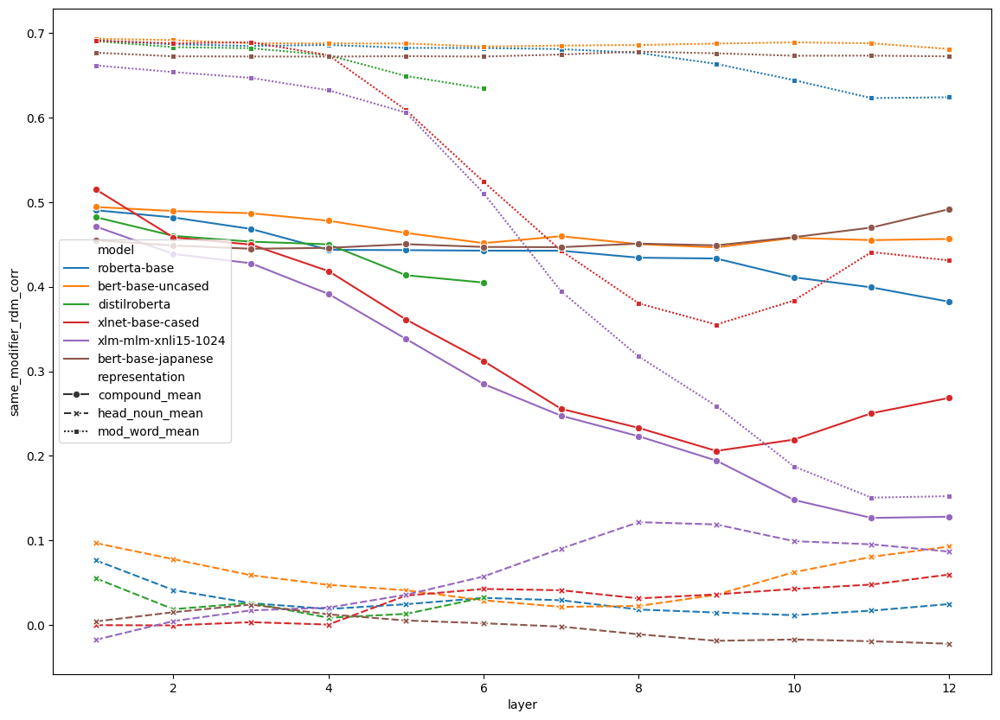

### Same Modifier RDM Correlation (Within Compound Sentences)

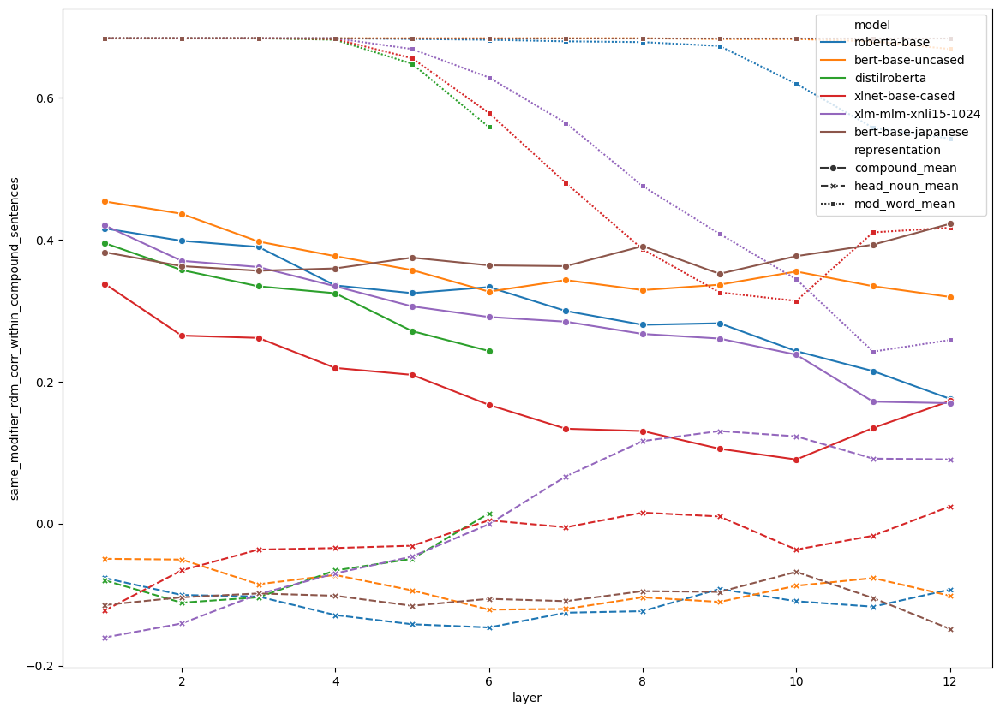

In [142]:
plot('same_modifier_rdm_corr', df=relation_results_within_compound_groups_per_word_df)
plot('same_modifier_rdm_corr_within_compound_sentences', df=relation_results_within_compound_groups_per_word_df)

## Same Relation Correlation within each model

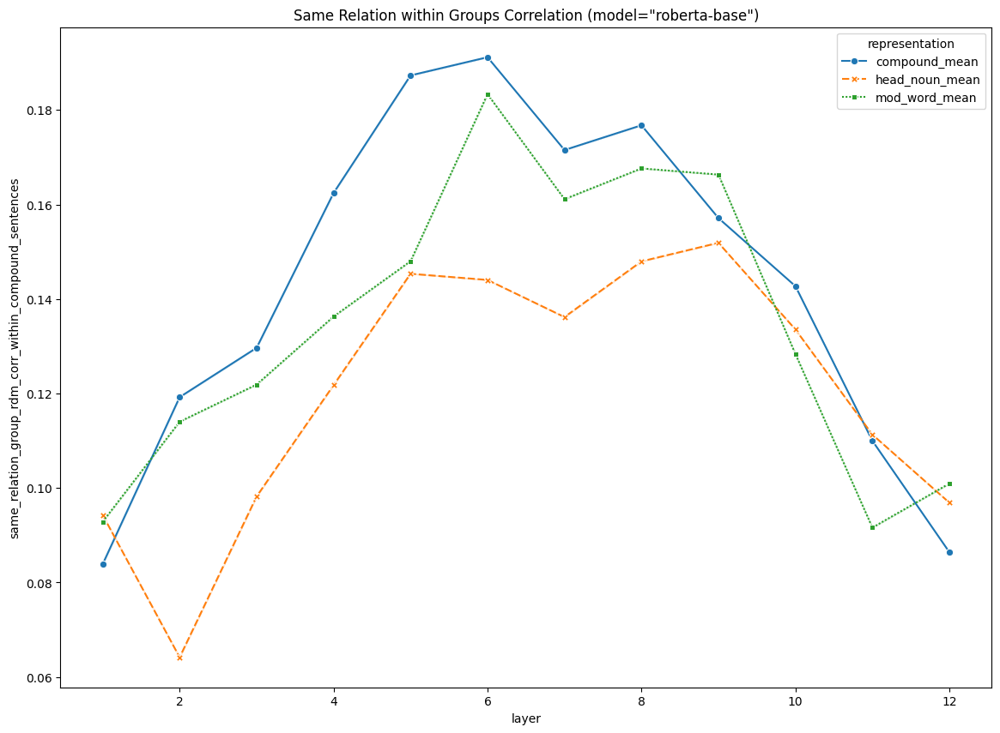

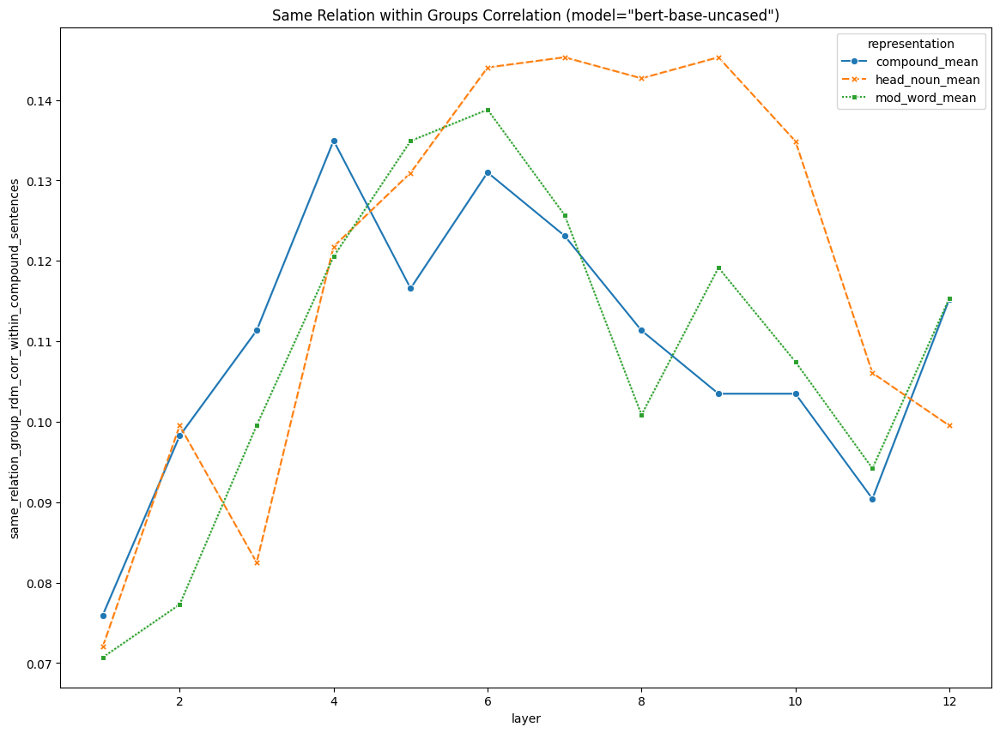

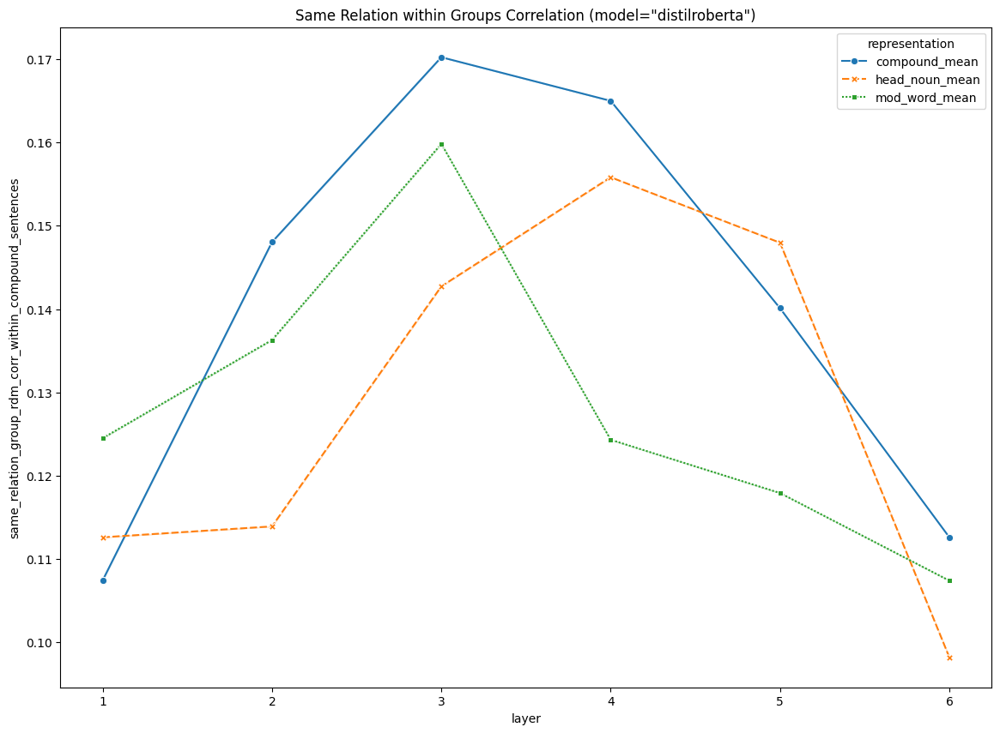

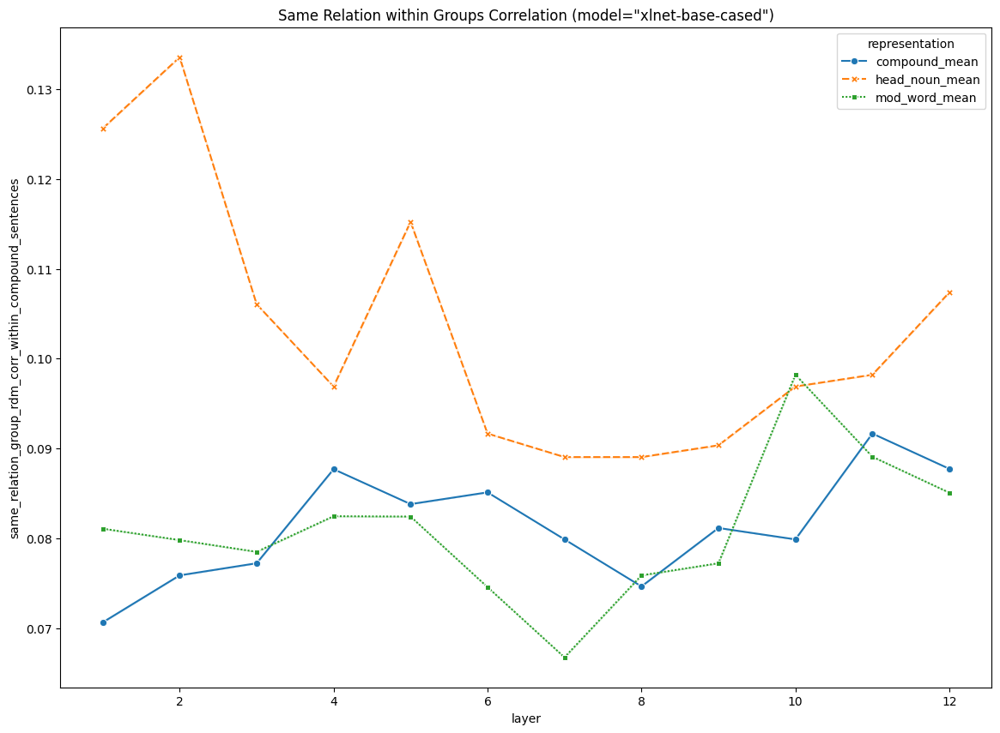

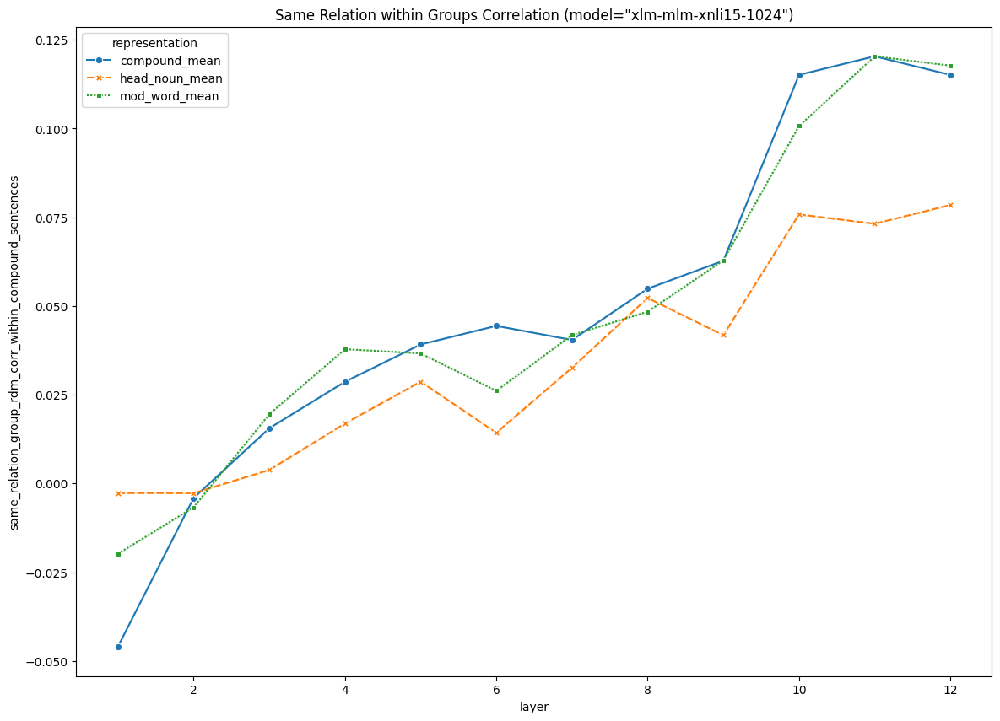

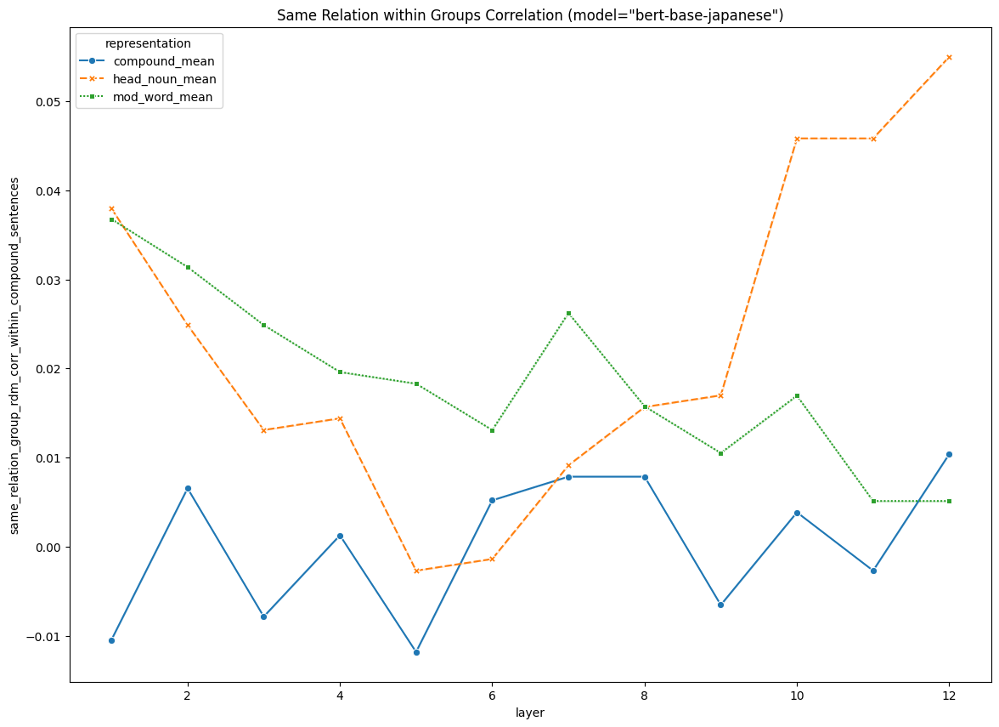

In [143]:
for model in model_names:
    plt.figure(figsize=(14,10))
    sns.lineplot(x='layer', y='same_relation_group_rdm_corr_within_compound_sentences', style='representation',  hue='representation', markers=True, data=relation_results_within_compound_groups_per_word_df[relation_results_within_compound_groups_per_word_df.model==model]).set_title('Same Relation within Groups Correlation (model="{}")'.format(model))

# Fine-grained analysis of 60 compounds and their relation vectors

### Load data, store relation vectors, compounds and glosses

In [144]:
df = pd.read_excel('D:/NOUN-NOUN-COMPOUNDS-V1/data/noun_noun_compounds/nn_tax_data.xlsx', skiprows=9)

relation_vectors = []
compounds = []
glosses = []
original_inds = []
finegrained_sentences = []

relation_names = ['{} {} {}'.format(x[0], x[1:-1], x[-1]) for x in df['relation name'][:18].tolist()]
relation_names

for x in df.groupby('itemnr'):
    relation_vectors.append((x[1]['count vector'].tolist()))
    compounds.append('{} {}'.format(x[1]['modifier'].tolist()[0], x[1]['headnoun'].tolist()[0]))
    glosses.append(x[1]['gloss'].tolist()[0])
    original_inds.append(x[1]['Orig nr'].tolist()[0])
    
relation_vectors = np.array(relation_vectors)
compounds = np.array(compounds)
glosses = np.array(glosses)
original_inds = np.array(original_inds)

ind_dict = {}

for gloss_i, gloss in enumerate(glosses):
    for i, sentence in enumerate(sentences):
        if gloss.strip() in sentence:
            ind_dict[gloss_i] = i
            break

In [145]:
use_gloss_inds = False

original_inds = np.array(list(ind_dict.values()))

if not use_gloss_inds:
    original_inds = original_inds % 300

In [146]:
finegrained_nn_sentences = sentences[original_inds]

### Calculate RDMs

In [147]:
print(relation_vectors[0])

[ 0  2 13  0  3  2  0  1 10  0  1 16  0  0  5  0  3  2]


In [183]:
# relation_vectors[0][]

In [148]:
get_relation_names = lambda i: ', '.join([relation_names[x] for x in np.argsort(relation_vectors[i])[::-1][:3]])
top_three_relations_per_compound = np.array(['{} ({})'.format(x, get_relation_names(i)) for i, x in enumerate(compounds)])

top_three_relations_per_compound[:10]

array(['murder film (H ABOUT M, H HAS M, H USES M)',
       'song magazine (H ABOUT M, H HAS M, H FOR M)',
       'war riots (H ABOUT M, M CAUSES H, H DURING M)',
       'job anxiety (M CAUSES H, H ABOUT M, H DERIVED FROM M)',
       'mountain magazine (H ABOUT M, H FOR M, H USES M)',
       'sewing magazine (H ABOUT M, H FOR M, H USES M)',
       'breakfast sugar (H FOR M, H DURING M, H USED BY M)',
       'Christmas wreath (H FOR M, H DURING M, M HAS H)',
       'horse stables (H USED BY M, H FOR M, M LOCATION IS H)',
       'cream churn (H MAKES M, H FOR M, H USES M)'], dtype='<U61')

In [185]:
# reordered_compound_indices['18_consider_magnitude']


In [149]:
get_relation_names = lambda i: ', '.join([relation_names[x] for x in np.argsort(relation_vectors[i])[::-1][1:4]])
top_three_other_relations_per_compound = np.array(['{}'.format(get_relation_names(i)) for i, x in enumerate(compounds)])

top_three_other_relations_per_compound[:10]

array(['H HAS M, H USES M, H DERIVED FROM M',
       'H HAS M, H FOR M, H USES M',
       'M CAUSES H, H DURING M, H DERIVED FROM M',
       'H ABOUT M, H DERIVED FROM M, H DURING M',
       'H FOR M, H USES M, H DERIVED FROM M',
       'H FOR M, H USES M, H DERIVED FROM M',
       'H DURING M, H USED BY M, M HAS H',
       'H DURING M, M HAS H, H ABOUT M',
       'H FOR M, M LOCATION IS H, H HAS M', 'H FOR M, H USES M, H HAS M'],
      dtype='<U40')

In [150]:
rows = []

for i, compound_i in enumerate(compounds):
    for j, compound_j in enumerate(compounds):
        if i < j:
            top_relation_i = relation_names[np.argmax(relation_vectors[i])]
            top_relation_j = relation_names[np.argmax(relation_vectors[j])]
            shares_top_relation = top_relation_i == top_relation_j
            
            relation_vector_distance = cosine(relation_vectors[i], relation_vectors[j])

            rows.append({'i': i, 'compound_i': compound_i, 'j': j, 'compound_j': compound_j, 'top_relation_i': top_relation_i, 'top_relation_j': top_relation_j,
                         'shares_top_relation': shares_top_relation, 'relation_vector_cosine_distance': relation_vector_distance, 'other_top_3_relations_i': top_three_other_relations_per_compound[i], 
                         'other_top_3_relations_j': top_three_other_relations_per_compound[j]})
            
compound_result_df = pd.DataFrame(rows)

In [151]:
compound_result_df.to_csv('relation_analysis.csv', index=False)

C:\Users\40455223\AppData\Local\Temp\ipykernel_416\3664838363.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  res = sns.distplot(compound_result_df[compound_result_df.shares_top_relation==True].relation_vector_cosine_distance)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\3664838363.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974

Text(0.5, 1.0, 'Cosine distance between all pairs of 60 compounds')

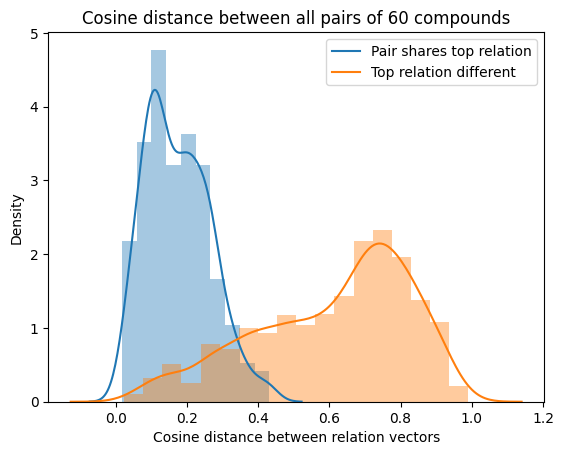

In [152]:
res = sns.distplot(compound_result_df[compound_result_df.shares_top_relation==True].relation_vector_cosine_distance)
res = sns.distplot(compound_result_df[compound_result_df.shares_top_relation==False].relation_vector_cosine_distance)
res.legend(['Pair shares top relation', 'Top relation different'])
res.set_ylabel('Density')
res.set_xlabel('Cosine distance between relation vectors')
res.set_title('Cosine distance between all pairs of 60 compounds')

In [153]:
compound_result_df[compound_result_df.shares_top_relation == False].sort_values('relation_vector_cosine_distance')[:15]

,i,compound_i,j,compound_j,top_relation_i,top_relation_j,shares_top_relation,relation_vector_cosine_distance,other_top_3_relations_i,other_top_3_relations_j
117,2,war riots,3,job anxiety,H ABOUT M,M CAUSES H,False,0.023368,"M CAUSES H, H DURING M, H DERIVED FROM M","H ABOUT M, H DERIVED FROM M, H DURING M"
689,13,drum sound,14,nose sound,M CAUSES H,M MAKES H,False,0.038209,"M MAKES H, H BY M, H DERIVED FROM M","H BY M, M CAUSES H, H DERIVED FROM M"
781,15,alcohol headache,17,coffee tension,M CAUSES H,H DERIVED FROM M,False,0.052325,"H DERIVED FROM M, H BY M, M MAKES H","M MAKES H, M CAUSES H, H BY M"
1704,48,floral perfume,49,pumpkin sauce,H DERIVED FROM M,H MADE OF M,False,0.061812,"H USES M, H MADE OF M, H IS M","H DERIVED FROM M, H USES M, H HAS M"
1707,48,floral perfume,52,steel equipment,H DERIVED FROM M,H MADE OF M,False,0.063847,"H USES M, H MADE OF M, H IS M","H DERIVED FROM M, H IS M, H HAS M"
1393,32,traffic law,34,grain law,H FOR M,H ABOUT M,False,0.069974,"H ABOUT M, M HAS H, H USED BY M","H FOR M, M HAS H, H USES M"
692,13,drum sound,17,coffee tension,M CAUSES H,H DERIVED FROM M,False,0.074290,"M MAKES H, H BY M, H DERIVED FROM M","M MAKES H, M CAUSES H, H BY M"
807,15,alcohol headache,43,tax wealth,M CAUSES H,H DERIVED FROM M,False,0.074506,"H DERIVED FROM M, H BY M, M MAKES H","M CAUSES H, M MAKES H, H BY M"
1722,49,pumpkin sauce,57,oil treatment,H MADE OF M,H USES M,False,0.076240,"H DERIVED FROM M, H USES M, H HAS M","H MADE OF M, H DERIVED FROM M, H HAS M"
1635,43,tax wealth,45,allergy rash,H DERIVED FROM M,M CAUSES H,False,0.078755,"M CAUSES H, M MAKES H, H BY M","M MAKES H, H DERIVED FROM M, H BY M"


In [154]:
compound_result_df[(compound_result_df.shares_top_relation == False) & (compound_result_df.relation_vector_cosine_distance < compound_result_df.relation_vector_cosine_distance[compound_result_df.shares_top_relation == True].mean())].sort_values('relation_vector_cosine_distance')

,i,compound_i,j,compound_j,top_relation_i,top_relation_j,shares_top_relation,relation_vector_cosine_distance,other_top_3_relations_i,other_top_3_relations_j
117,2,war riots,3,job anxiety,H ABOUT M,M CAUSES H,False,0.023368,"M CAUSES H, H DURING M, H DERIVED FROM M","H ABOUT M, H DERIVED FROM M, H DURING M"
689,13,drum sound,14,nose sound,M CAUSES H,M MAKES H,False,0.038209,"M MAKES H, H BY M, H DERIVED FROM M","H BY M, M CAUSES H, H DERIVED FROM M"
781,15,alcohol headache,17,coffee tension,M CAUSES H,H DERIVED FROM M,False,0.052325,"H DERIVED FROM M, H BY M, M MAKES H","M MAKES H, M CAUSES H, H BY M"
1704,48,floral perfume,49,pumpkin sauce,H DERIVED FROM M,H MADE OF M,False,0.061812,"H USES M, H MADE OF M, H IS M","H DERIVED FROM M, H USES M, H HAS M"
1707,48,floral perfume,52,steel equipment,H DERIVED FROM M,H MADE OF M,False,0.063847,"H USES M, H MADE OF M, H IS M","H DERIVED FROM M, H IS M, H HAS M"
...,...,...,...,...,...,...,...,...,...,...
182,3,job anxiety,12,birth cramp,M CAUSES H,H DURING M,False,0.168366,"H ABOUT M, H DERIVED FROM M, H DURING M","M CAUSES H, H DERIVED FROM M, M MAKES H"
1449,34,grain law,39,financial remedy,H ABOUT M,H FOR M,False,0.168483,"H FOR M, M HAS H, H USES M","H ABOUT M, H USED BY M, M HAS H"
767,14,nose sound,47,tax pressure,M MAKES H,M CAUSES H,False,0.169988,"H BY M, M CAUSES H, H DERIVED FROM M","H DERIVED FROM M, H ABOUT M, M HAS H"
145,2,war riots,31,plastic shortage,H ABOUT M,M HAS H,False,0.170351,"M CAUSES H, H DURING M, H DERIVED FROM M","H ABOUT M, M CAUSES H, H DERIVED FROM M"


In [155]:
compound_result_df[compound_result_df.shares_top_relation == True].sort_values('relation_vector_cosine_distance', ascending=False)[:15]

,i,compound_i,j,compound_j,top_relation_i,top_relation_j,shares_top_relation,relation_vector_cosine_distance,other_top_3_relations_i,other_top_3_relations_j
897,17,coffee tension,48,floral perfume,H DERIVED FROM M,H DERIVED FROM M,True,0.431533,"M MAKES H, M CAUSES H, H BY M","H USES M, H MADE OF M, H IS M"
1,0,murder film,2,war riots,H ABOUT M,H ABOUT M,True,0.429015,"H HAS M, H USES M, H DERIVED FROM M","M CAUSES H, H DURING M, H DERIVED FROM M"
475,8,horse stables,40,flu therapy,H FOR M,H FOR M,True,0.424419,"H FOR M, M LOCATION IS H, H HAS M","H DURING M, M HAS H, M CAUSES H"
1540,38,industrial lock,40,flu therapy,H FOR M,H FOR M,True,0.406737,"H IS M, H USED BY M, H LOCATION IS M","H DURING M, M HAS H, M CAUSES H"
1397,32,traffic law,38,industrial lock,H FOR M,H FOR M,True,0.382331,"H ABOUT M, M HAS H, H USED BY M","H IS M, H USED BY M, H LOCATION IS M"
59,1,song magazine,2,war riots,H ABOUT M,H ABOUT M,True,0.368899,"H HAS M, H FOR M, H USES M","M CAUSES H, H DURING M, H DERIVED FROM M"
33,0,murder film,34,grain law,H ABOUT M,H ABOUT M,True,0.367936,"H HAS M, H USES M, H DERIVED FROM M","H FOR M, M HAS H, H USES M"
392,7,Christmas wreath,8,horse stables,H FOR M,H FOR M,True,0.359312,"H DURING M, M HAS H, H ABOUT M","H FOR M, M LOCATION IS H, H HAS M"
364,6,breakfast sugar,32,traffic law,H FOR M,H FOR M,True,0.352194,"H DURING M, H USED BY M, M HAS H","H ABOUT M, M HAS H, H USED BY M"
467,8,horse stables,32,traffic law,H FOR M,H FOR M,True,0.339284,"H FOR M, M LOCATION IS H, H HAS M","H ABOUT M, M HAS H, H USED BY M"


In [193]:
# print(compound_result_df.relation_vector_distance.mean().round(2), compound_result_df.relation_vector_distance[compound_result_df.shares_top_relation == True].mean().round(2), 
#       compound_result_df[compound_result_df.shares_top_relation == False].relation_vector_distance.mean().round(2))

True
True


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\598895913.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(5, 4))


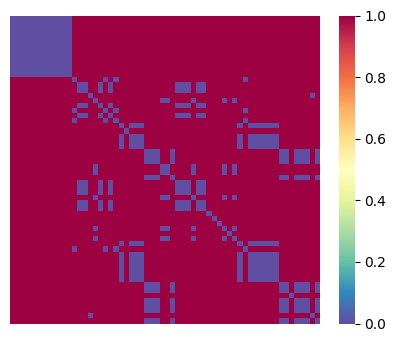

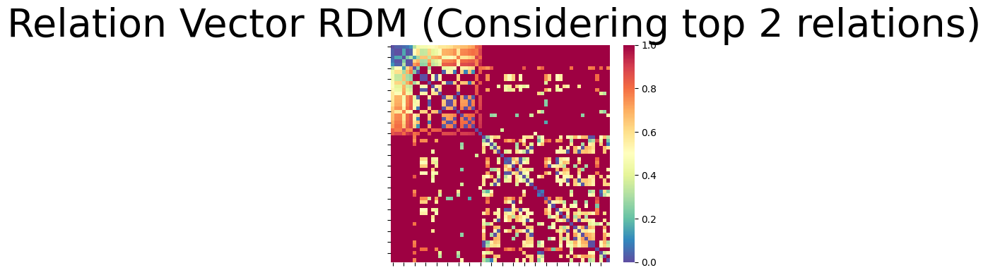

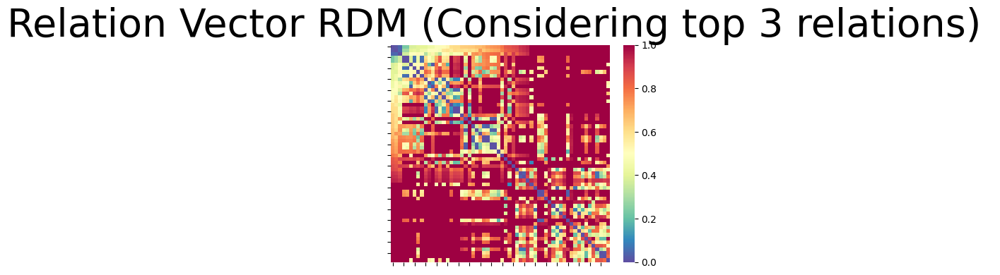

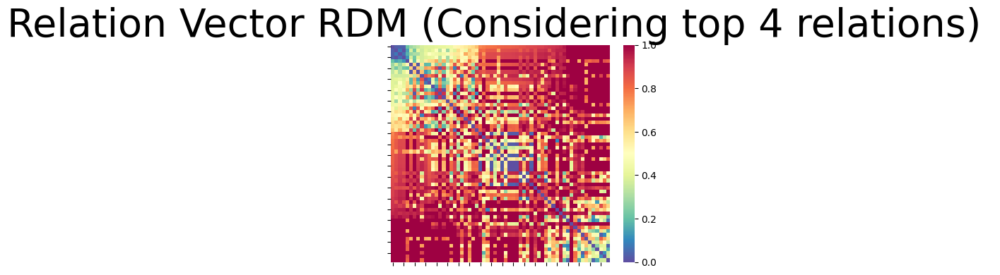

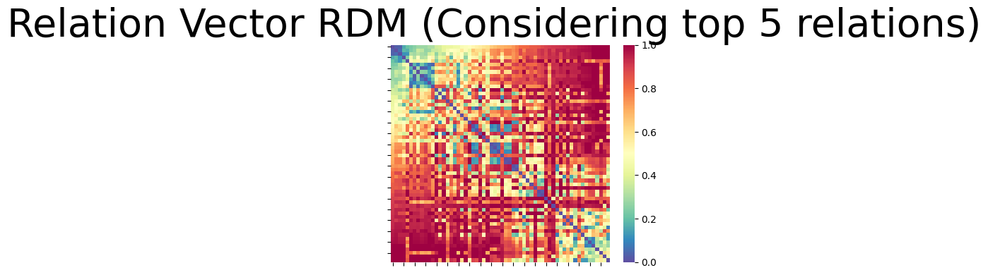

...

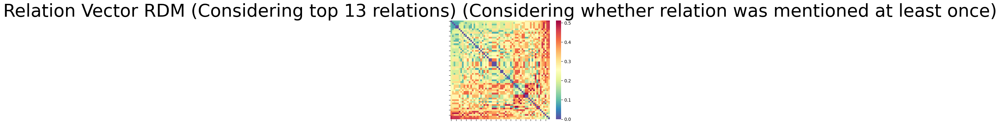

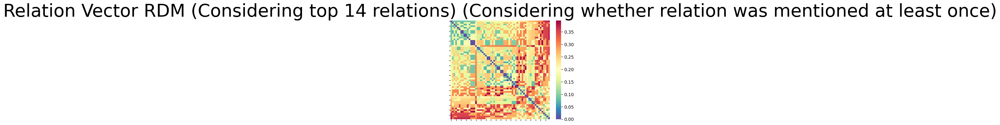

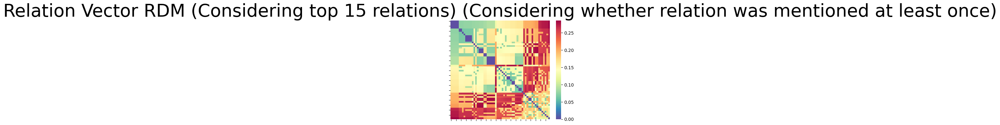

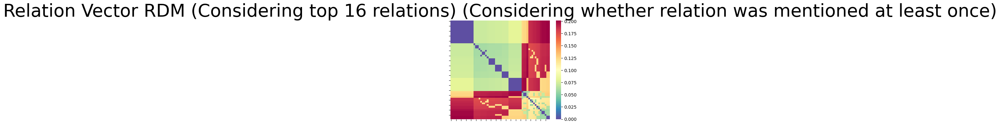

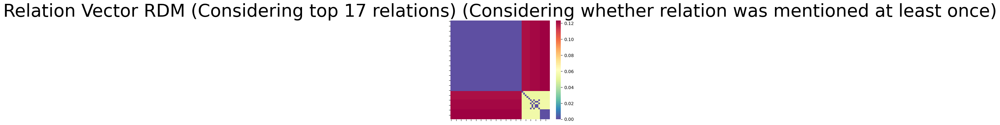

In [157]:
top_relations_to_print = range(1, 19)

reordered_relation_vectors_dict = {}
rdms_per_num_top_relations = {}
reordered_orig_indices_per_top_relations = {}
reordered_compound_indices = {}
filtered_reordered_orig_indices_per_top_relations = {}
conditions = ['_consider_magnitude', '_maximally_dissimilar']

for condition in conditions:
    for num_top_relations in range(1, 19):
        top_relations = relation_vectors.argsort(axis=1)[:, ::-1][:, :num_top_relations]
        new_relation_vectors = np.zeros_like(relation_vectors)

        for i, inds in enumerate(top_relations):
            for ind in inds:
                if condition == '_consider_magnitude':
                    new_relation_vectors[i, ind] = relation_vectors[i, ind]
                else:
                    new_relation_vectors[i, ind] = 1

        relation_vector_rdm = rsa_utils.get_rdm(new_relation_vectors, distance_metric='cosine')

        # Reorder
        least_dist_ind = np.argsort(relation_vector_rdm.sum(axis=0))[0]
        distance_from_least_dist = np.argsort([x[least_dist_ind] for x in relation_vector_rdm])
#         distance_from_least_dist = reordered_compound_indices['18_consider_magnitude']
        reordered_relation_vector_rdm = relation_vector_rdm[distance_from_least_dist, :][:, distance_from_least_dist]
        reordered_orig_indices = original_inds[distance_from_least_dist]
        filtered_reordered_orig_indices = original_inds[distance_from_least_dist]

        rdms_per_num_top_relations['{}{}'.format(num_top_relations, condition)] = reordered_relation_vector_rdm
        reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] = reordered_orig_indices
        filtered_reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] = reordered_orig_indices
        reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)] = relation_vectors[distance_from_least_dist]
        reordered_compound_indices['{}{}'.format(num_top_relations, condition)] = distance_from_least_dist
        
        # Plot
        if num_top_relations in top_relations_to_print and not (condition=='_maximally_dissimilar' and num_top_relations==18):
            fig, ax = plt.subplots(figsize=(5, 4))
            g = sns.heatmap(reordered_relation_vector_rdm, cmap="Spectral_r", ax=ax)
#             res = g.set_yticklabels(compounds[distance_from_least_dist], rotation=0)
#             res = g.set_xticklabels(compounds[distance_from_least_dist], rotation=75)
            g.set(xticklabels=[])
            g.set(yticklabels=[])
            extra_parentheses = '(Considering whether relation was mentioned at least once)' if condition == '_maximally_dissimilar' else ''
#             ax.set_title('Relation Vector RDM (Considering top {} relation{}) {}'.format(num_top_relations, "" if num_top_relations == 1 else "s",  extra_parentheses))
            ax.set_title('Relation Vector RDM (Considering top {} relation{}) {}'.format(num_top_relations, "" if num_top_relations == 1 else "s",  extra_parentheses), fontsize=40)
            
        if (num_top_relations == 18 or num_top_relations == 1) and condition=='_consider_magnitude':
            print('True')
            ax.set_title('')
            fig_name = 'D:/NOUN-NOUN-COMPOUNDS-V1/figures/thematic_relation_ground_truth_rdm_top_{}_relations'.format(num_top_relations)
            plt.axis('off')
            plt.savefig('{}.png'.format(fig_name), dpi=300)
            plt.savefig('{}.eps'.format(fig_name), format='eps')
plt.show()

True
True


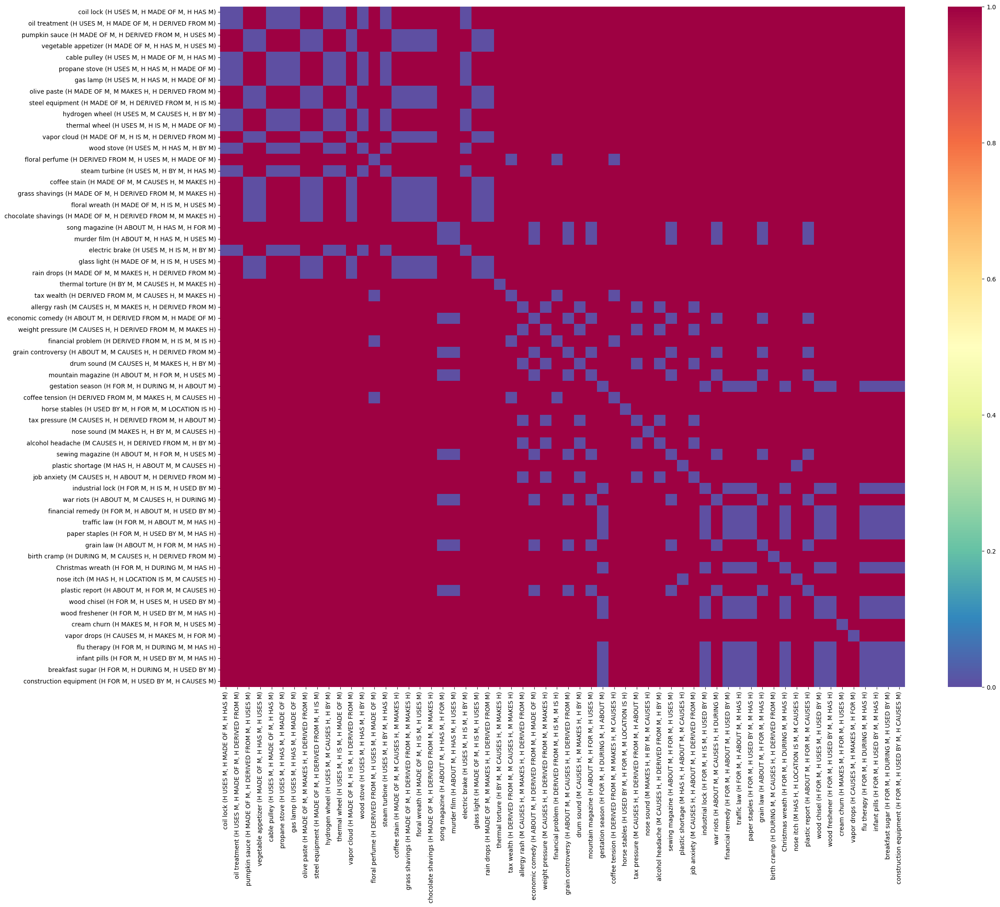

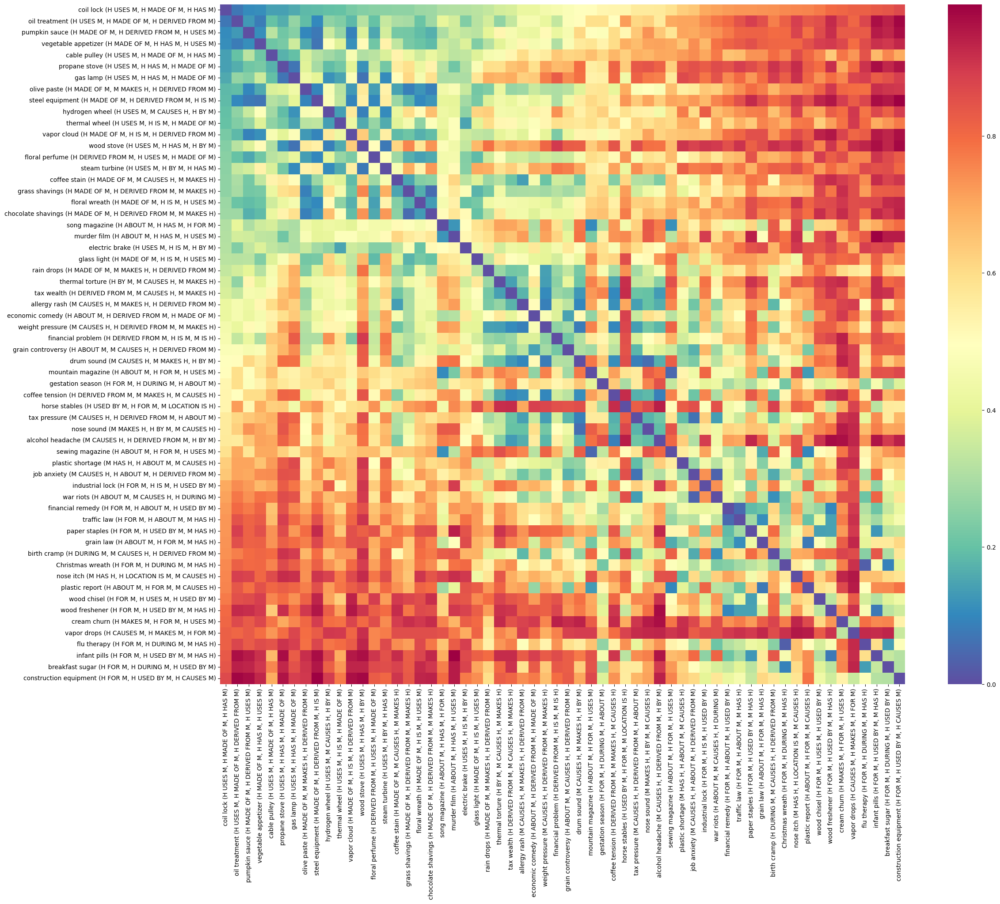

In [158]:
top_relations_to_print = range(1, 19)

condition = '_consider_magnitude'

for num_top_relations in [1, 18]:
    top_relations = relation_vectors.argsort(axis=1)[:, ::-1][:, :num_top_relations]
    new_relation_vectors = np.zeros_like(relation_vectors)

    for i, inds in enumerate(top_relations):
        for ind in inds:
            if condition == '_consider_magnitude':
                new_relation_vectors[i, ind] = relation_vectors[i, ind]
            else:
                new_relation_vectors[i, ind] = 1

    relation_vector_rdm = rsa_utils.get_rdm(new_relation_vectors, distance_metric='cosine')

    # Reorder
    least_dist_ind = np.argsort(relation_vector_rdm.sum(axis=0))[0]
    distance_from_least_dist = np.argsort([x[least_dist_ind] for x in relation_vector_rdm])
    distance_from_least_dist = reordered_compound_indices['18_consider_magnitude']
    
    
    reordered_relation_vector_rdm = relation_vector_rdm[distance_from_least_dist, :][:, distance_from_least_dist]
    reordered_orig_indices = original_inds[distance_from_least_dist]

    # Plot
    if num_top_relations in top_relations_to_print and not (condition=='_maximally_dissimilar' and num_top_relations==18):
        fig, ax = plt.subplots(figsize=(25, 20))
        g = sns.heatmap(reordered_relation_vector_rdm, cmap="Spectral_r", ax=ax)
        res = g.set_yticklabels(top_three_relations_per_compound[distance_from_least_dist], rotation=0)
        res = g.set_xticklabels(top_three_relations_per_compound[distance_from_least_dist], rotation=90)
#         g.set(xticklabels=[])
#         g.set(yticklabels=[])
        extra_parentheses = '(Considering whether relation was mentioned at least once)' if condition == '_maximally_dissimilar' else ''
#             ax.set_title('Relation Vector RDM (Considering top {} relation{}) {}'.format(num_top_relations, "" if num_top_relations == 1 else "s",  extra_parentheses))
        ax.set_title('Relation Vector RDM (Considering top {} relation{}) {}'.format(num_top_relations, "" if num_top_relations == 1 else "s",  extra_parentheses), fontsize=40)

    if (num_top_relations == 18 or num_top_relations == 1) and condition=='_consider_magnitude':
        print('True')
        ax.set_title('')
        fig_name = 'D:/NOUN-NOUN-COMPOUNDS-V1/figures/thematic_relation_ground_truth_rdm_top_{}_relations'.format(num_top_relations)
#         plt.axis('off')
        plt.savefig('{}.png'.format(fig_name), dpi=300)
        plt.savefig('{}.eps'.format(fig_name), format='eps')
plt.show()

In [159]:
reordered_compound_indices

{'1_consider_magnitude': array([32, 41, 40, 11, 10, 39,  7, 38, 37, 36, 56,  6, 43, 35, 34, 42, 44,
         0, 46, 33, 48, 49, 50, 51, 52, 53, 54, 55, 57, 45, 47, 29, 30,  1,
         2,  3,  4,  5,  8,  9, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
        23, 24, 25, 26, 27, 28, 58, 31, 59], dtype=int64),
 '2_consider_magnitude': array([32,  5, 34, 39, 35,  4, 11, 10,  2, 30, 37, 33,  3,  1, 56,  7, 40,
        36,  0, 38, 41,  6,  8, 31,  9, 57, 55, 54, 53, 52, 42, 43, 44, 45,
        46, 47, 48, 49, 51, 50, 29, 28, 12, 13, 14, 15, 16, 17, 18, 58, 19,
        21, 22, 23, 24, 25, 26, 27, 20, 59], dtype=int64),
 '3_consider_magnitude': array([49, 48, 57, 21, 18, 52, 23, 33, 19, 25, 51, 53, 24, 59, 20, 22, 29,
        28, 27, 55, 43, 58, 47, 17, 16, 30,  3, 44, 45, 15, 54, 12,  0, 46,
        11,  4,  5,  9,  1, 56, 14, 13,  2, 50,  6, 10,  7,  8, 26, 42, 41,
        40, 39, 31, 37, 36, 35, 34, 32, 38], dtype=int64),
 '4_consider_magnitude': array([49, 57, 20, 25, 24, 52, 28, 53,  0,

True
True


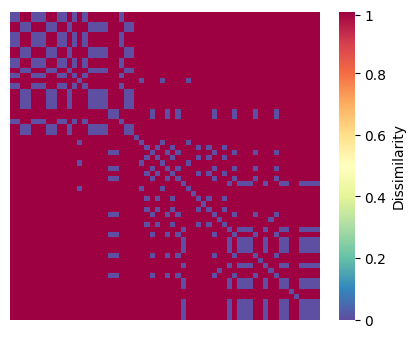

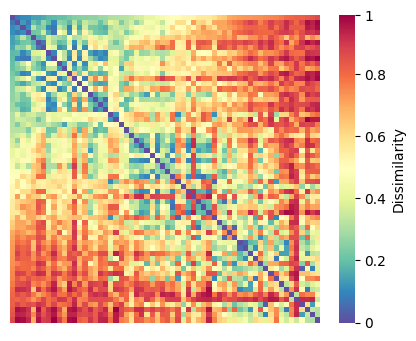

In [160]:
top_relations_to_print = [1, 18]

reordered_relation_vectors_dict = {}
rdms_per_num_top_relations = {}
reordered_orig_indices_per_top_relations = {}

conditions = ['_consider_magnitude']

for condition in conditions:
    for num_top_relations in range(1, 19):
        top_relations = relation_vectors.argsort(axis=1)[:, ::-1][:, :num_top_relations]
        new_relation_vectors = np.zeros_like(relation_vectors)

        for i, inds in enumerate(top_relations):
            for ind in inds:
                if condition == '_consider_magnitude':
                    new_relation_vectors[i, ind] = relation_vectors[i, ind]
                else:
                    new_relation_vectors[i, ind] = 1

        relation_vector_rdm = rsa_utils.get_rdm(new_relation_vectors, distance_metric='cosine')

        # Reorder
        least_dist_ind = np.argsort(relation_vector_rdm.sum(axis=0))[0]
        distance_from_least_dist = np.argsort([x[least_dist_ind] for x in relation_vector_rdm])
        distance_from_least_dist = reordered_compound_indices['18_consider_magnitude']
        reordered_relation_vector_rdm = relation_vector_rdm[distance_from_least_dist, :][:, distance_from_least_dist]
        reordered_orig_indices = original_inds[distance_from_least_dist]

        rdms_per_num_top_relations['{}{}'.format(num_top_relations, condition)] = reordered_relation_vector_rdm
        reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] = reordered_orig_indices
        reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)] = relation_vectors[distance_from_least_dist]
        reordered_compound_indices['{}{}'.format(num_top_relations, condition)] = distance_from_least_dist
        
        # Plot
        if num_top_relations in top_relations_to_print and not (condition=='_maximally_dissimilar' and num_top_relations==18):
            fig, ax = plt.subplots(figsize=(5, 4))
            g = sns.heatmap(reordered_relation_vector_rdm, cmap="Spectral_r", ax=ax, cbar_kws={'label': "Dissimilarity"})
#             res = g.set_yticklabels(compounds[distance_from_least_dist], rotation=0)
#             res = g.set_xticklabels(compounds[distance_from_least_dist], rotation=75)
            cbar = g.collections[0].colorbar
            cbar.set_ticks([0, .2, 0.4, .6, 0.8,  0.99])
            cbar.set_ticklabels([0, .2, 0.4, .6, 0.8,  1])
            g.set(xticklabels=[])
            g.set(yticklabels=[])
            extra_parentheses = '(Considering whether relation was mentioned at least once)' if condition == '_maximally_dissimilar' else ''
#             ax.set_title('Relation Vector RDM (Considering top {} relation{}) {}'.format(num_top_relations, "" if num_top_relations == 1 else "s",  extra_parentheses))
            ax.set_title('Relation Vector RDM (Considering top {} relation{}) {}'.format(num_top_relations, "" if num_top_relations == 1 else "s",  extra_parentheses), fontsize=40)
            
        if (num_top_relations == 18 or num_top_relations == 1) and condition=='_consider_magnitude':
            print('True')
            ax.set_title('')
            fig_name = 'D:/NOUN-NOUN-COMPOUNDS-V1/figures/thematic_relation_ground_truth_rdm_top_{}_relations'.format(num_top_relations)
            plt.axis('off')
            plt.savefig('{}.png'.format(fig_name), dpi=600, bbox_inches='tight')
            plt.savefig('{}.eps'.format(fig_name), format='eps',  bbox_inches='tight')
plt.show()

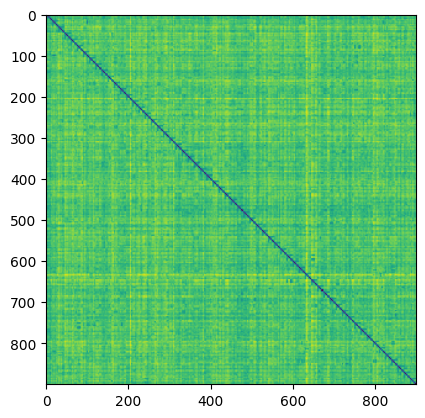

In [161]:
plt.imshow(rdm)

In [201]:
# reps = np.load('../data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))


In [162]:
sentences[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]]

array(['It is a coil lock.', 'It is an oil treatment.',
       'It is pumpkin sauce.', 'It is a vegetable appetizer.',
       'It is a cable pulley.', 'It is a propane stove.',
       'It is a gas lamp.', 'It is an olive paste.',
       'It is steel equipment.', 'It is a hydrogen wheel.',
       'It is a thermal wheel.', 'It is a vapor cloud.',
       'It is a wood stove.', 'It is a floral perfume.',
       'It is a steam turbine.', 'It is a coffee stain.',
       'They are grass shavings.', 'It is a floral wreath.',
       'They are chocolate shavings.', 'It is a song magazine.',
       'It is a murder film.', 'It is an electric brake.',
       'It is a glass light.', 'They are rain drops.',
       'It is thermal torture.', 'It is tax wealth.',
       'It is an allergy rash.', 'It is an economic comedy.',
       'It is weight pressure.', 'It is a financial problem.',
       'It is a grain controversy.', 'It is a drum sound.',
       'It is a mountain magazine.', 'It is a gestation sea

In [163]:
reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]

array([241, 195,  51, 284,  18, 296,  85, 204, 207, 266, 265, 278, 295,
        73, 243,  43,  31,  70,  30, 230, 175,  16, 112, 276, 268, 263,
        11, 226, 261,  63,  93, 186, 169, 201,  40, 123, 260, 185,  61,
       231, 223, 129, 242, 272,  64,  91, 208,  90,  13,  72, 188, 220,
       299, 298,  54, 275,  78,  76,  27, 206], dtype=int32)

Got here, remember to add layers up to 16!

In [324]:
load = False

if load:
    finegrained_results_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_rsa_results.csv')
else:
    representations = ['compound', 'head', 'modifier'] # Also whole_sentence

    rows = []

    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 13)):
            if layer > 6 and 'distil' in model_name:
                continue  

            for num_top_relations in range(1, 19):

                for condition in conditions:
                    for representation in representations:
                        if representation == 'whole_sentence':
                            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds_mean_pooled/{}_layer_{}_noun_noun_compounds_mean_pooled.npy'.format(model_name.split('-')[0], layer, model_name, layer))
                        else:
                            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))

                        if representation == 'whole_sentence':
                            rdm = rsa_utils.get_rdm(reps[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])
                        elif representation == 'compound':
                            rdm = rsa_utils.get_rdm(reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])
                        elif representation == 'head':
                            rdm = rsa_utils.get_rdm(reps[:, 1, :][reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])
                        elif representation == 'modifier':
                            rdm = rsa_utils.get_rdm(reps[:, 0, :][reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])

                        reordered_relation_vector_rdm = rdms_per_num_top_relations['{}{}'.format(num_top_relations, condition)] 
                        relation_vector_corr = corr(rdm, reordered_relation_vector_rdm)[0]

                        rows.append({'model': model_name, 'representation': representation, 'layer': layer, 'relation_vector_corr': relation_vector_corr, 'num_top_relations_considered': num_top_relations, "condition": condition})


    finegrained_results_df = pd.DataFrame(rows)
    finegrained_results_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_rsa_results.csv')

roberta-base


100%|██████████| 12/12 [00:04<00:00,  2.74it/s]


bert-base-uncased


100%|██████████| 12/12 [00:04<00:00,  2.92it/s]


distilroberta


100%|██████████| 12/12 [00:02<00:00,  5.64it/s]


xlnet-base-cased


100%|██████████| 12/12 [00:04<00:00,  2.90it/s]


xlm-mlm-xnli15-1024


100%|██████████| 12/12 [00:05<00:00,  2.17it/s]


bert-base-japanese


100%|██████████| 12/12 [00:04<00:00,  2.87it/s]


In [325]:
finegrained_results_df

,model,representation,layer,relation_vector_corr,num_top_relations_considered,condition
0,roberta-base,compound,1,0.117363,1,_consider_magnitude
1,roberta-base,head,1,0.113908,1,_consider_magnitude
2,roberta-base,modifier,1,0.077410,1,_consider_magnitude
3,roberta-base,compound,1,0.128896,2,_consider_magnitude
4,roberta-base,head,1,0.108389,2,_consider_magnitude
...,...,...,...,...,...,...
3559,bert-base-japanese,head,12,-0.023569,17,_consider_magnitude
3560,bert-base-japanese,modifier,12,0.000504,17,_consider_magnitude
3561,bert-base-japanese,compound,12,0.016339,18,_consider_magnitude
3562,bert-base-japanese,head,12,-0.023298,18,_consider_magnitude


In [326]:
finegrained_results_df.relation_vector_corr

0       0.117363
1       0.113908
2       0.077410
3       0.128896
4       0.108389
          ...   
3559   -0.023569
3560    0.000504
3561    0.016339
3562   -0.023298
3563   -0.000002
Name: relation_vector_corr, Length: 3564, dtype: float64

In [327]:
def plot_relation_vector_corrs(df, num_relations=[1, 3, 18], figsize=(25, 7), condition='_consider_magnitude', ylim=[-0.05, 0.07], style='model', title=True):
    fig, axs = plt.subplots(ncols=len(num_relations), figsize=figsize)
    
    for i in range(len(num_relations)):
        g = sns.lineplot(x='layer', y='relation_vector_corr', hue='model', style=style, markers=True, ax=axs[i], data=df[(df.num_top_relations_considered==num_relations[i]) 
                                                                                                                           & (df.condition==condition)])
        plt.legend(loc=1)
        
        if title:
            axs[i].set_title('Considering {}{} top relation{}'.format('all ' if num_relations[i] == 18 else '', num_relations[i], 's' if num_relations[i] > 1 else ''), fontsize=16)
    
        axs[i].set_ylim(*ylim)
        g.axhline(0, color='black')
        plt.legend(loc=1)

C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:14: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:14: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with

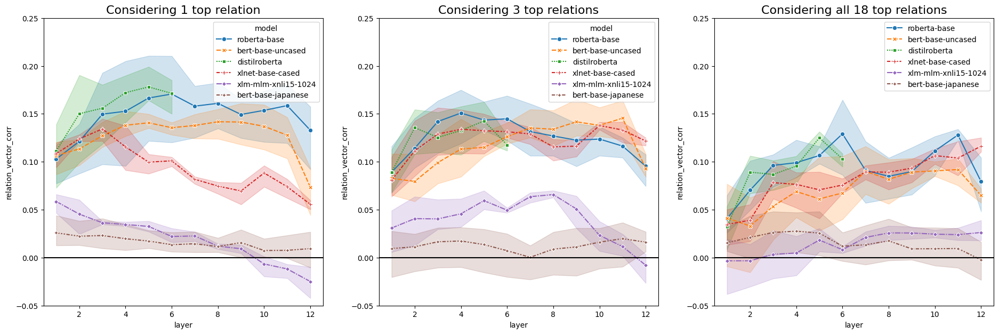

In [328]:
plot_relation_vector_corrs(finegrained_results_df, num_relations=[1, 3, 18], ylim=[-0.05, 0.25], figsize=(23, 7))

C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:14: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)


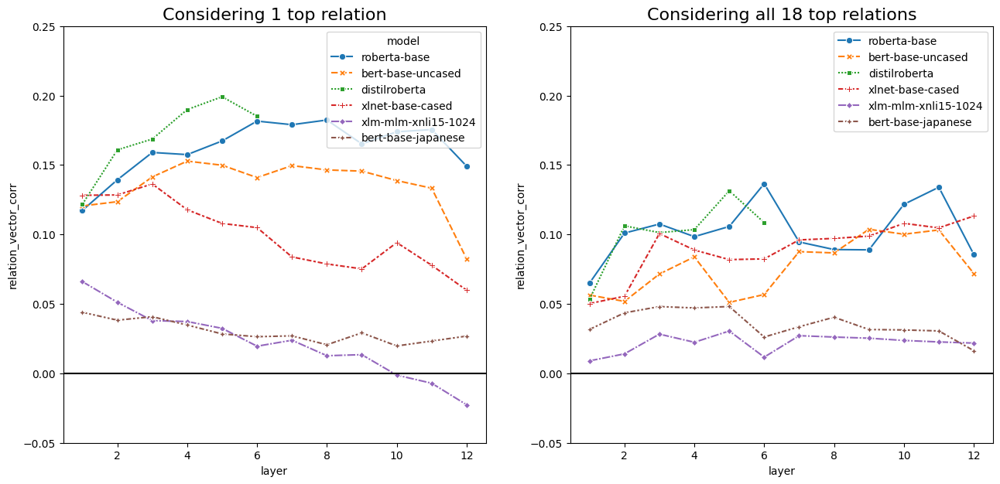

In [329]:
plot_relation_vector_corrs(finegrained_results_df[finegrained_results_df.representation=='compound'], num_relations=[1,18], ylim=[-0.05, 0.25], figsize=(15.5, 7))


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:14: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)


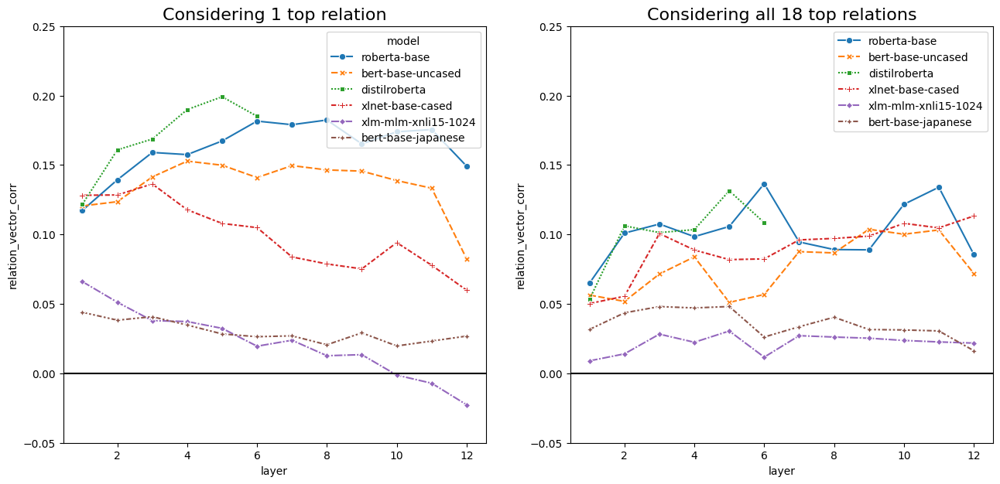

In [170]:
plot_relation_vector_corrs(finegrained_results_df[finegrained_results_df.representation=='compound'], num_relations=[1,18], ylim=[-0.05, 0.25], figsize=(15.5, 7))


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1263905493.py:14: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc=1)


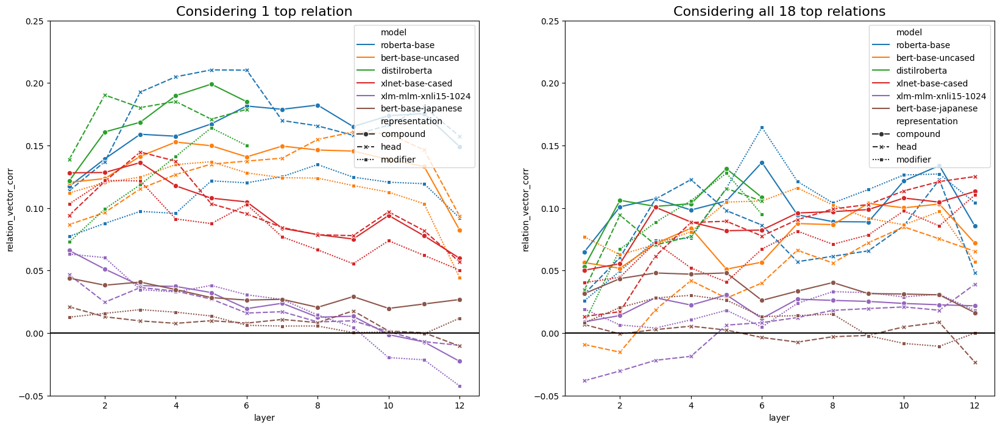

In [171]:
plot_relation_vector_corrs(finegrained_results_df, num_relations=[1,18], ylim=[-0.05, 0.25], figsize=(20, 8), style='representation', title=True)

In [330]:
finegrained_results_df

,model,representation,layer,relation_vector_corr,num_top_relations_considered,condition
0,roberta-base,compound,1,0.117363,1,_consider_magnitude
1,roberta-base,head,1,0.113908,1,_consider_magnitude
2,roberta-base,modifier,1,0.077410,1,_consider_magnitude
3,roberta-base,compound,1,0.128896,2,_consider_magnitude
4,roberta-base,head,1,0.108389,2,_consider_magnitude
...,...,...,...,...,...,...
3559,bert-base-japanese,head,12,-0.023569,17,_consider_magnitude
3560,bert-base-japanese,modifier,12,0.000504,17,_consider_magnitude
3561,bert-base-japanese,compound,12,0.016339,18,_consider_magnitude
3562,bert-base-japanese,head,12,-0.023298,18,_consider_magnitude


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\2844262002.py:39: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


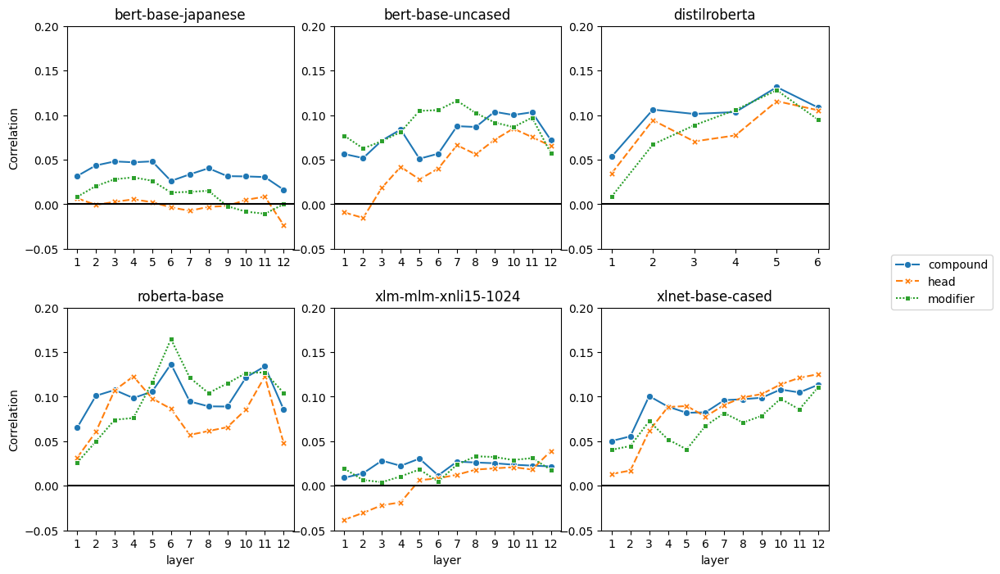

In [173]:
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * single_fig_size, fig_shape[0] * single_fig_size, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=1.5)

for (model, model_df), (fig_y, fig_x) in zip(finegrained_results_df[(finegrained_results_df.condition=='_consider_magnitude') 
                                                                    & (finegrained_results_df.num_top_relations_considered==18)].groupby('model'), 
                                             product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    g = sns.lineplot(data=model_df, hue='representation', y='relation_vector_corr', x='layer', style='representation', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
    g.set(ylim=(-0.05, 0.2));

    if fig_x == 0:
        g.set_ylabel('Correlation');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(3.6, -.5, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
    g.axhline(0, color='black')

    g.set_title(model);
fig.show()

same_relation_group_rdm_corr_within_compound_sentences


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\4201038889.py:40: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


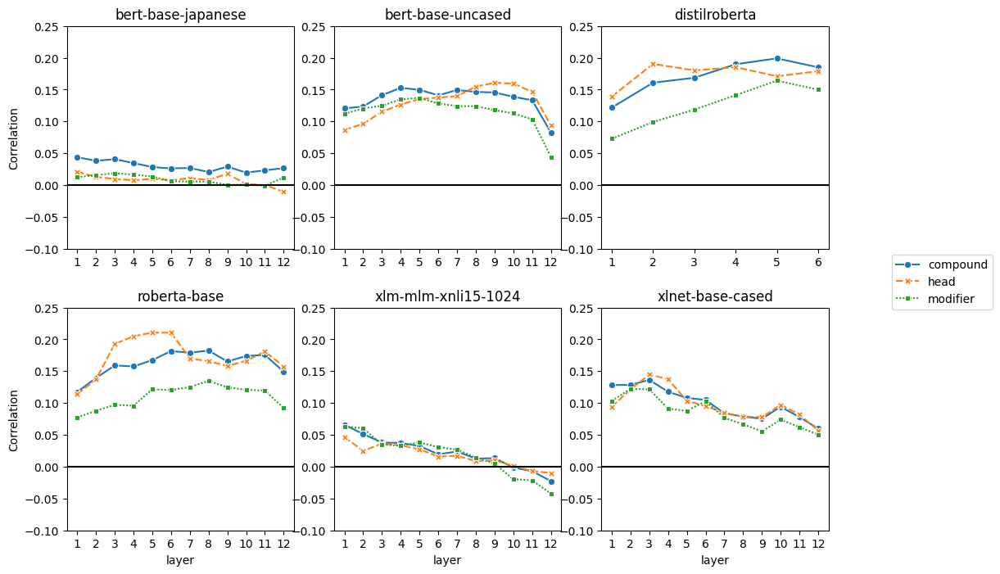

In [174]:
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

print(y)
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * single_fig_size, fig_shape[0] * single_fig_size, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=1.5)

for (model, model_df), (fig_y, fig_x) in zip(finegrained_results_df[(finegrained_results_df.condition=='_consider_magnitude') 
                                                                    & (finegrained_results_df.num_top_relations_considered==1)].groupby('model'), 
                                             product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    g = sns.lineplot(data=model_df, hue='representation', y='relation_vector_corr', x='layer', style='representation', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
    g.set(ylim=(-0.1, 0.25));

    if fig_x == 0:
        g.set_ylabel('Correlation');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(3.6, -.5, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
    g.axhline(0, color='black')

    g.set_title(model);
fig.show()

In [175]:
model_df.rename(columns={'num_top_relations_considered': '# Top Relations'}).sort_values('# Top Relations', ascending=False)


,model,representation,layer,relation_vector_corr,# Top Relations,condition
1620,xlnet-base-cased,compound,1,0.128190,1,_consider_magnitude
1621,xlnet-base-cased,head,1,0.094180,1,_consider_magnitude
1946,xlnet-base-cased,modifier,7,0.076926,1,_consider_magnitude
1998,xlnet-base-cased,compound,8,0.078757,1,_consider_magnitude
1999,xlnet-base-cased,head,8,0.078648,1,_consider_magnitude
2000,xlnet-base-cased,modifier,8,0.066591,1,_consider_magnitude
2052,xlnet-base-cased,compound,9,0.075220,1,_consider_magnitude
2053,xlnet-base-cased,head,9,0.077918,1,_consider_magnitude
2054,xlnet-base-cased,modifier,9,0.055501,1,_consider_magnitude
2106,xlnet-base-cased,compound,10,0.094133,1,_consider_magnitude


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\2683566590.py:49: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


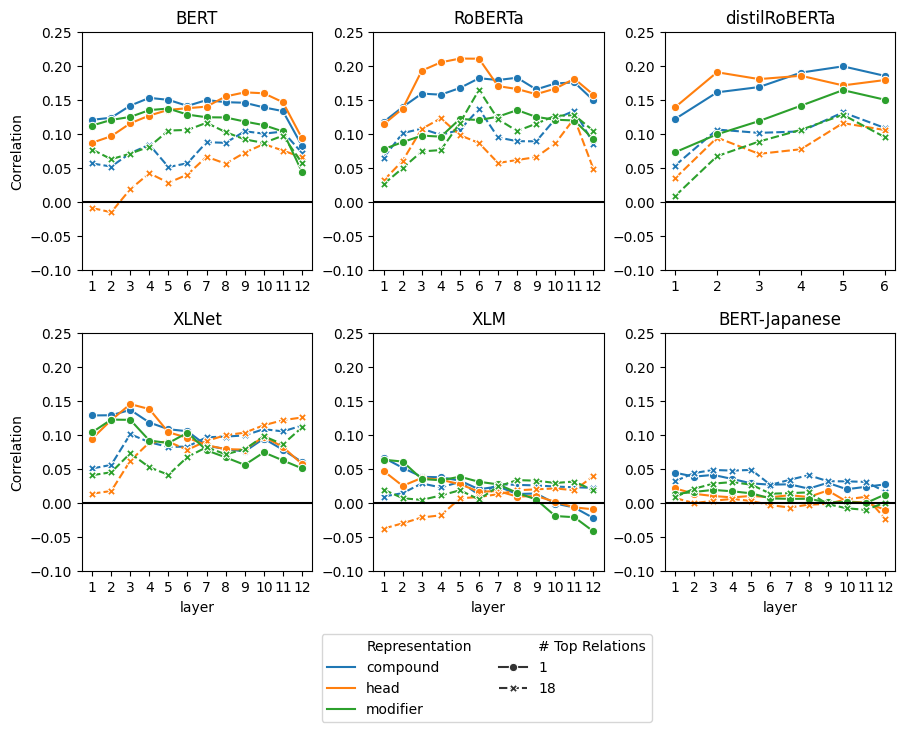

In [176]:
# Figure 6
# Experiment 2

# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

fig_df = finegrained_results_df.copy()

fig_df = sort_df_by_model_order(fig_df)
fig_df['Representation'] = fig_df['representation_name']
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * 3.5, fig_shape[0] * 3.5, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=5)

for (i, model_df), (fig_y, fig_x) in zip(fig_df[(fig_df.condition=='_consider_magnitude') 
                                                                    & ((fig_df.num_top_relations_considered==1) | (fig_df.num_top_relations_considered==18))].groupby('model_order'), 
                                             product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    model = model_df.iloc[0].model_name
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    
    model_df = model_df.rename(columns={'num_top_relations_considered': '# Top Relations'})
    g = sns.lineplot(data=model_df, hue='Representation', y='relation_vector_corr', x='layer', style='# Top Relations', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
    g.set(ylim=(-0.1, 0.25));

    if fig_x == 0:
        g.set_ylabel('Correlation');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(2, -2, 0.5, 0.5), ncol=2);
    else:
        g.legend().remove();
    g.axhline(0, color='black')

    g.set_title(model);
fig.show()

# plt.savefig('/Volumes/Expansion/noun-compound-transformers-main/noun-compound-transformers/figures/fine_grained_rsa_results.png', bbox_inches='tight')
# plt.savefig('/Volumes/Expansion/noun-compound-transformers-main/noun-compound-transformers/figures/fine_grained_rsa_results.eps', format='eps', bbox_inches='tight')

In [177]:
new_df = fig_df[(~(fig_df.model.str.contains('xlm')) & ~(fig_df.model.str.contains('japan')) & (fig_df.condition=='_consider_magnitude') & (fig_df['num_top_relations_considered']==18))]
new_rows = []
for (model, layer), model_layer_df in new_df.groupby(['model', 'layer']):
    head_greater = model_layer_df[model_layer_df.representation=='head'].relation_vector_corr.tolist()[0] > model_layer_df[model_layer_df.representation=='modifier'].relation_vector_corr.tolist()[0]
    new_rows.append({'model': model, 'layer': layer, 'head_greater': head_greater})

head_greater_df = pd.DataFrame(new_rows)

In [178]:
head_greater_df.pivot_table(index='model', columns='layer', values='head_greater')

layer,1,2,3,4,5,6,7,8,9,10,11,12
model,,,,,,,,,,,,
bert-base-uncased,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
distilroberta,1.0,1.0,0.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
roberta-base,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
xlnet-base-cased,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [179]:
model_layer_df[model_layer_df.representation=='head'].relation_vector_corr.tolist()[0]

0.1251848374229112

In [180]:
model_layer_df[model_layer_df.representation=='head'].relation_vector_corr.tolist()[0] > model_layer_df[model_layer_df.representation=='modifier'].relation_vector_corr.tolist()[0]

True

In [181]:
model_layer_df

,model,representation,layer,relation_vector_corr,num_top_relations_considered,condition,model_order,model_name,representation_name,Representation
2265,xlnet-base-cased,compound,12,0.113261,18,_consider_magnitude,3,XLNet,compound,compound
2266,xlnet-base-cased,head,12,0.125185,18,_consider_magnitude,3,XLNet,head,head
2267,xlnet-base-cased,modifier,12,0.110451,18,_consider_magnitude,3,XLNet,modifier,modifier


## Experiment 2b

In [331]:
load = False

if load:
    finegrained_results_df_2b = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_rsa_results_2b.csv')
else:
#     processing_conditions = ['Separate']
    processing_conditions = ['As a compound', 'In separate sentences']
    rows = []

    corr = lambda x, y: rsa_utils.correlate_rdms(x, y, correlation=corr_metric)

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
            
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue

            for num_top_relations in [1, 18]:

                for processing_condition in processing_conditions:
                    if processing_condition == 'As a compound':
                        reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))
                        
                        if 'openai' in model_name:
                            rdm = rsa_utils.get_rdm(reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, "_consider_magnitude")] ].reshape(-1, 1))    
                        elif 'llama' in model_name:
                            rdm = rsa_utils.get_rdm(reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, "_consider_magnitude")] ].reshape(-1, 1))   
                        else:
                            rdm = rsa_utils.get_rdm(reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, "_consider_magnitude")] , :])
                    else:
                        raw_reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/compositional_analysis/{}_layer_{}_compositional_analysis.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            
                        order = reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]
                        head_reps = raw_reps[[x for x in range(600) if x % 2 == 0], :][order]
                        mod_reps = raw_reps[[x for x in range(600) if x % 2 == 1], :][order]
                        reps = np.dstack((head_reps, mod_reps)).mean(axis=-1)
        
                        rdm = rsa_utils.get_rdm(reps)

                    reordered_relation_vector_rdm = rdms_per_num_top_relations['{}{}'.format(num_top_relations, condition)] 
                    relation_vector_corr = corr(rdm, reordered_relation_vector_rdm)[0]

                    rows.append({'model': model_name, 'Word representations processed . . .': processing_condition, 'layer': layer, 'relation_vector_corr': relation_vector_corr, 'num_top_relations_considered': num_top_relations})

    finegrained_results_df_2b = pd.DataFrame(rows)
    finegrained_results_df_2b.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_rsa_results_2b.csv')

roberta-base


100%|██████████| 16/16 [00:00<00:00, 48.60it/s]


bert-base-uncased


100%|██████████| 16/16 [00:00<00:00, 50.59it/s]


distilroberta


100%|██████████| 16/16 [00:00<00:00, 95.77it/s]


xlnet-base-cased


100%|██████████| 16/16 [00:00<00:00, 48.05it/s]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [00:00<00:00, 40.03it/s]


bert-base-japanese


100%|██████████| 16/16 [00:00<00:00, 49.93it/s]


In [332]:
finegrained_results_df_2b[finegrained_results_df_2b.layer==10]

,model,Word representations processed . . .,layer,relation_vector_corr,num_top_relations_considered
36,roberta-base,As a compound,10,0.173890,1
37,roberta-base,In separate sentences,10,0.095345,1
38,roberta-base,As a compound,10,0.121676,18
39,roberta-base,In separate sentences,10,-0.003414,18
84,bert-base-uncased,As a compound,10,0.138785,1
85,bert-base-uncased,In separate sentences,10,0.106479,1
86,bert-base-uncased,As a compound,10,0.100159,18
87,bert-base-uncased,In separate sentences,10,0.065852,18
156,xlnet-base-cased,As a compound,10,0.094133,1
157,xlnet-base-cased,In separate sentences,10,0.071945,1


In [333]:
ttest_rel(group_correlations_processed_together, group_correlations_processed_apart, alternative='greater').pvalue

0.09946593735276645

In [334]:
finegrained_results_df_2b

,model,Word representations processed . . .,layer,relation_vector_corr,num_top_relations_considered
0,roberta-base,As a compound,1,0.117363,1
1,roberta-base,In separate sentences,1,0.027825,1
2,roberta-base,As a compound,1,0.065020,18
3,roberta-base,In separate sentences,1,-0.010355,18
4,roberta-base,As a compound,2,0.139329,1
...,...,...,...,...,...
259,bert-base-japanese,In separate sentences,11,0.021115,18
260,bert-base-japanese,As a compound,12,0.026823,1
261,bert-base-japanese,In separate sentences,12,0.006155,1
262,bert-base-japanese,As a compound,12,0.016339,18


same_relation_group_rdm_corr_within_compound_sentences


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\343018959.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['model_order'] = [order_dict[x.model] for x in df.iloc]
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\832442626.py:68: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


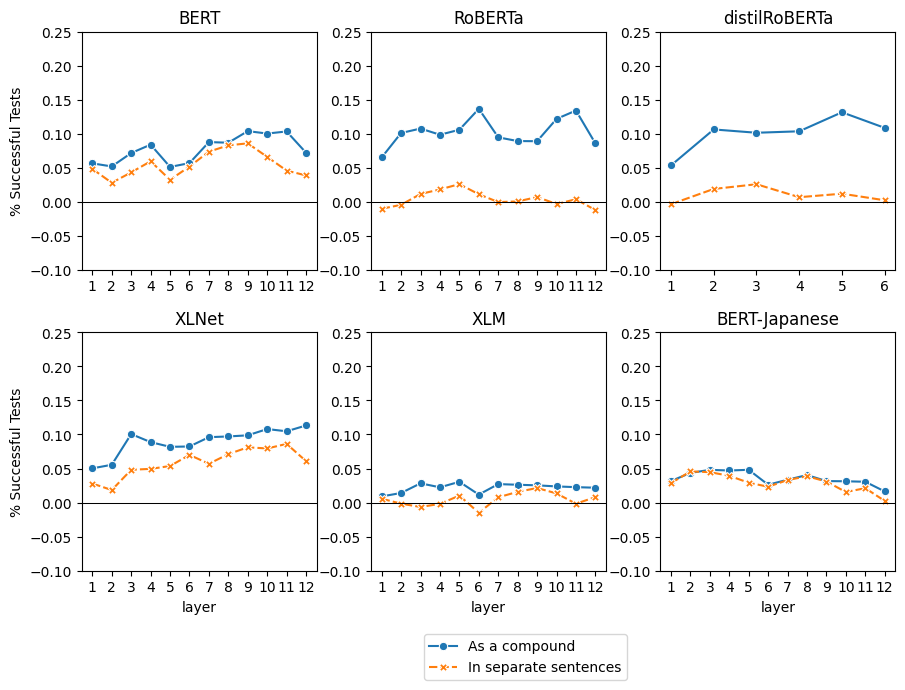

In [335]:
# Figure for Experiment 2b
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

print(y)
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * 3.5, fig_shape[0] * 3.5, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

figure_df = finegrained_results_df_2b[finegrained_results_df_2b.num_top_relations_considered==18]
# figure_df = finegrained_results_df
figure_df = sort_df_by_model_order(figure_df)

for (i, model_df), (fig_y, fig_x) in zip(figure_df.groupby('model_order'),product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    model = model_df.iloc[0].model
    model_name = model_df.iloc[0].model_name
    
#     y_label = 'num_success'
    y_label = 'relation_vector_corr'
    
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    g = sns.lineplot(data=model_df, hue='Word representations processed . . .', y=y_label, x='layer', style='Word representations processed . . .', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)


    g.set(ylim=(-0.1, 0.25))
    
    if fig_x == 0:
#         g.set_ylabel('Number of successes');
        g.set_ylabel('% Successful Tests');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(1.85, -2, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
#     line_plot_ax.axhline(num_tests, c='black', lw=0.75, linestyle='--')
#     line_plot_ax.axhline(num_tests/2, c='black', lw=0.75, linestyle='--')
    line_plot_ax.axhline(0, c='black', lw=0.75, linestyle='-')
#     line_plot_ax.axhline(0.5, c='black', lw=0.75, linestyle='--')
    
    g.set_title(model_name);
    
#     for layer in model_df.layer.unique():
#         pval = binom_diff_test_df[(binom_diff_test_df.model == model) & (binom_diff_test_df.layer == layer)]['corrected_p'].iloc[0]
#         x_offset =  0.075 if 'distil' in model else 0.2
#         y_offset = 0.1 - 0.035
        
#         if pval <= 0.05:
#             y = model_df[(model_df.layer==layer)]['% Successful Tests'].min()
#             plt.text(layer - x_offset, 0 - y_offset + 0.33, '*', weight='bold', size='x-large', color='black')
            
            
#             plt.text(layer - x_offset, 0 - y_offset + 0.585, '*', weight='bold', size='x-large', color='black')
    
fig.show()

# fig_name = 'figures/2_vs_2_compositional_test_alt'

# if without_lexical_confound:
#     fig_name += '_without_lexical_confound'

# print(y)
# if y_label == '% Successful Tests':
#     fig_name += '_percentage'

# print(fig_name)

# plt.savefig(fig_name + '.png', bbox_inches='tight')
# plt.savefig(fig_name + '.eps', format='eps', bbox_inches='tight')

same_relation_group_rdm_corr_within_compound_sentences


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\343018959.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['model_order'] = [order_dict[x.model] for x in df.iloc]
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1020666781.py:68: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


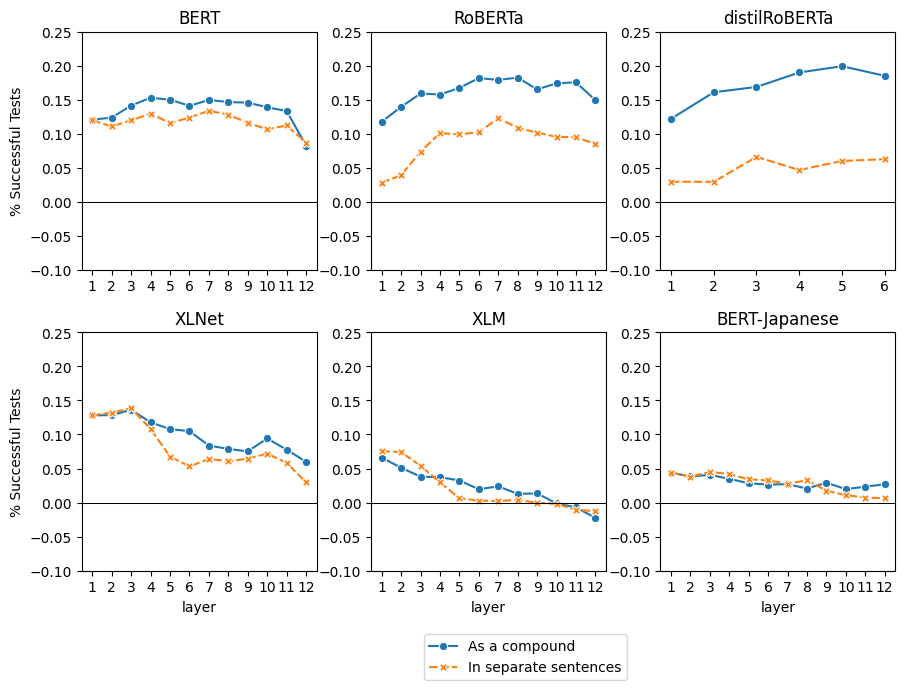

In [336]:
# Figure for Experiment 2b
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

print(y)
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * 3.5, fig_shape[0] * 3.5, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

figure_df = finegrained_results_df_2b[finegrained_results_df_2b.num_top_relations_considered==1]
# figure_df = finegrained_results_df
figure_df = sort_df_by_model_order(figure_df)

for (i, model_df), (fig_y, fig_x) in zip(figure_df.groupby('model_order'),product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    model = model_df.iloc[0].model
    model_name = model_df.iloc[0].model_name
    
#     y_label = 'num_success'
    y_label = 'relation_vector_corr'
    
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    g = sns.lineplot(data=model_df, hue='Word representations processed . . .', y=y_label, x='layer', style='Word representations processed . . .', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)


    g.set(ylim=(-0.1, 0.25))
    
    if fig_x == 0:
#         g.set_ylabel('Number of successes');
        g.set_ylabel('% Successful Tests');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(1.85, -2, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
#     line_plot_ax.axhline(num_tests, c='black', lw=0.75, linestyle='--')
#     line_plot_ax.axhline(num_tests/2, c='black', lw=0.75, linestyle='--')
    line_plot_ax.axhline(0, c='black', lw=0.75, linestyle='-')
#     line_plot_ax.axhline(0.5, c='black', lw=0.75, linestyle='--')
    
    g.set_title(model_name);
    
#     for layer in model_df.layer.unique():
#         pval = binom_diff_test_df[(binom_diff_test_df.model == model) & (binom_diff_test_df.layer == layer)]['corrected_p'].iloc[0]
#         x_offset =  0.075 if 'distil' in model else 0.2
#         y_offset = 0.1 - 0.035
        
#         if pval <= 0.05:
#             y = model_df[(model_df.layer==layer)]['% Successful Tests'].min()
#             plt.text(layer - x_offset, 0 - y_offset + 0.33, '*', weight='bold', size='x-large', color='black')
            
            
#             plt.text(layer - x_offset, 0 - y_offset + 0.585, '*', weight='bold', size='x-large', color='black')
    
fig.show()

# fig_name = 'figures/2_vs_2_compositional_test_alt'

# if without_lexical_confound:
#     fig_name += '_without_lexical_confound'

# print(y)
# if y_label == '% Successful Tests':
#     fig_name += '_percentage'

# print(fig_name)

# plt.savefig(fig_name + '.png', bbox_inches='tight')
# plt.savefig(fig_name + '.eps', format='eps', bbox_inches='tight')

### Correlation between RSA and layer

In [337]:
# Table 3
new_df = fig_df[(~(fig_df.model.str.contains('xlm')) & ~(fig_df.model.str.contains('japan')) & (fig_df.condition=='_consider_magnitude') & (fig_df['num_top_relations_considered']==18))]
new_rows = []
for (model, layer), model_layer_df in new_df.groupby(['model', 'layer']):
    head_greater = model_layer_df[model_layer_df.representation=='head'].relation_vector_corr.tolist()[0] > model_layer_df[model_layer_df.representation=='modifier'].relation_vector_corr.tolist()[0]
    new_rows.append({'model': model, 'layer': layer, 'head_greater': head_greater})

head_greater_df = pd.DataFrame(new_rows)

In [338]:
results_df = pd.DataFrame([{**{'model': x[0]}, **x[-1].groupby('representation').relation_vector_corr.mean().to_dict()} for x in finegrained_results_df[(finegrained_results_df.num_top_relations_considered==18) & (finegrained_results_df.condition=='_consider_magnitude')].groupby('model')])
results_df

,model,compound,head,modifier
0,bert-base-japanese,0.035690,-0.000714,0.011216
1,bert-base-uncased,0.077067,0.043698,0.087766
2,distilroberta,0.100713,0.082976,0.082151
3,roberta-base,0.102343,0.078921,0.100370
4,xlm-mlm-xnli15-1024,0.021876,0.002851,0.019208
5,xlnet-base-cased,0.089786,0.083365,0.070218


In [ ]:
results_df = pd.DataFrame([{**{'model': x[0]}, **x[-1].groupby('representation').relation_vector_corr.mean().to_dict()} for x in finegrained_results_df[(finegrained_results_df.num_top_relations_considered==18) & (finegrained_results_df.condition=='_consider_magnitude')].groupby('model')])

print(results_df.round(2).to_latex(index=False))

In [ ]:
print(pd.DataFrame(data=results_df, columns=['model', 'modifier', 'head', 'compound']).round(2).to_latex(index=False))

In [ ]:
plot_relation_vector_corrs(finegrained_results_df, num_relations=[1, 3, 17], condition="_maximally_dissimilar", ylim=[-0.05, 0.2], figsize=(30, 7))

### Looking at effect of shared word on similarity

In [190]:

compounds.shape

(60,)

In [191]:
shares_word = lambda x, y: (x.split(' ')[0] == y.split(' ')[0]) or (x.split(' ')[0] == y.split(' ')[1]) or (x.split(' ')[1] == y.split(' ')[1])

In [192]:
result = [[shares_word(x, y) for y in compounds] for x in compounds]

In [193]:
pairs_with_shared_word = [(compounds[x[0]], compounds[x[1]]) for x in np.argwhere(np.array(result)) if x[0] > x[1]]

In [194]:
def word_cos_dist(reordered_reps, model, layer, plot=True):
    rows = []

    for i, compound_i in enumerate(compounds):
        for j, compound_j in enumerate(compounds):
            if i < j:
                compounds_share_word = shares_word(compound_i, compound_j)

                relation_vector_distance = cosine(reordered_reps[i], reordered_reps[j])

                rows.append({'model': model, 'layer': layer, 'i': i, 'compound_i': compound_i, 'j': j, 'compound_j': compound_j, 'shares_word': compounds_share_word,
                             'relation_vector_cosine_distance': relation_vector_distance})

    if plot:
        res = sns.distplot(compound_result_df[compound_result_df.shares_word==True].relation_vector_cosine_distance)
        res = sns.distplot(compound_result_df[compound_result_df.shares_word==False].relation_vector_cosine_distance)
        res.legend(['Pair shares a word', 'Pair does not share word'])
        res.set_ylabel('Density')
        res.set_xlabel('Cosine distance between relation vectors')
        res.set_title('Cosine distance between all pairs of 60 compounds')
                
    return pd.DataFrame(rows)
    

In [195]:
rows = []

for i, compound_i in enumerate(compounds):
    for j, compound_j in enumerate(compounds):
        if i < j:
            compounds_share_word = shares_word(compound_i, compound_j)
            
            relation_vector_distance = cosine(relation_vectors[i], relation_vectors[j])

            rows.append({'i': i, 'compound_i': compound_i, 'j': j, 'compound_j': compound_j, 'shares_word': compounds_share_word,
                         'relation_vector_cosine_distance': relation_vector_distance})
            
compound_result_df = pd.DataFrame(rows)

In [196]:
from scipy.special import kl_div

In [197]:
kl_div(compound_result_df[compound_result_df.shares_word==True].relation_vector_cosine_distance, compound_result_df[compound_result_df.shares_word==False].relation_vector_cosine_distance)

0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
        ..
1765   NaN
1766   NaN
1767   NaN
1768   NaN
1769   NaN
Name: relation_vector_cosine_distance, Length: 1770, dtype: float64

C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1251763133.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  res = sns.distplot(compound_result_df[compound_result_df.shares_word==True].relation_vector_cosine_distance)
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\1251763133.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad637

Text(0.5, 1.0, 'Cosine distance between all pairs of 60 compounds')

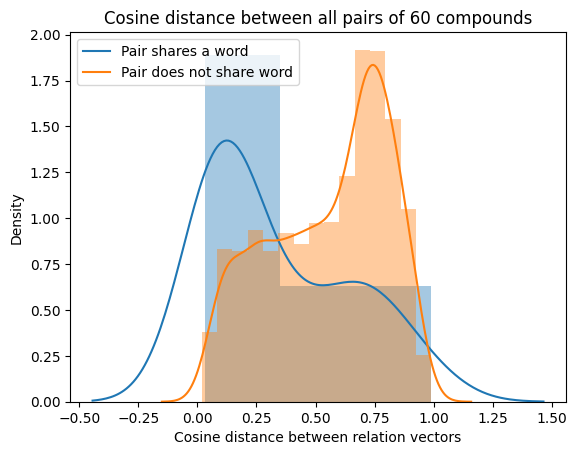

In [198]:
res = sns.distplot(compound_result_df[compound_result_df.shares_word==True].relation_vector_cosine_distance)
res = sns.distplot(compound_result_df[compound_result_df.shares_word==False].relation_vector_cosine_distance)
res.legend(['Pair shares a word', 'Pair does not share word'])
res.set_ylabel('Density')
res.set_xlabel('Cosine distance between relation vectors')
res.set_title('Cosine distance between all pairs of 60 compounds')

In [199]:
[(compounds[x[0]], compounds[x[1]]) for x in np.argwhere(np.array(result)) if x[0] > x[1]]

[('mountain magazine', 'song magazine'),
 ('sewing magazine', 'song magazine'),
 ('sewing magazine', 'mountain magazine'),
 ('nose sound', 'drum sound'),
 ('coffee tension', 'coffee stain'),
 ('chocolate shavings', 'grass shavings'),
 ('floral wreath', 'Christmas wreath'),
 ('wood stove', 'wood chisel'),
 ('wood stove', 'propane stove'),
 ('grain law', 'grain controversy'),
 ('grain law', 'traffic law'),
 ('plastic report', 'plastic shortage'),
 ('industrial lock', 'coil lock'),
 ('nose itch', 'nose sound'),
 ('financial problem', 'financial remedy'),
 ('tax pressure', 'tax wealth'),
 ('tax pressure', 'weight pressure'),
 ('floral perfume', 'floral wreath'),
 ('vapor drops', 'rain drops'),
 ('steel equipment', 'construction equipment'),
 ('vapor cloud', 'vapor drops'),
 ('wood freshener', 'wood chisel'),
 ('wood freshener', 'wood stove'),
 ('thermal wheel', 'thermal torture'),
 ('thermal wheel', 'hydrogen wheel')]

In [200]:
(60*60 - 60)/2

1770.0

In [201]:
compounds

array(['murder film', 'song magazine', 'war riots', 'job anxiety',
       'mountain magazine', 'sewing magazine', 'breakfast sugar',
       'Christmas wreath', 'horse stables', 'cream churn',
       'paper staples', 'wood chisel', 'birth cramp', 'drum sound',
       'nose sound', 'alcohol headache', 'coffee stain', 'coffee tension',
       'grass shavings', 'rain drops', 'vegetable appetizer',
       'chocolate shavings', 'floral wreath', 'olive paste',
       'cable pulley', 'coil lock', 'thermal torture', 'gas lamp',
       'propane stove', 'wood stove', 'grain controversy',
       'plastic shortage', 'traffic law', 'economic comedy', 'grain law',
       'plastic report', 'construction equipment', 'gestation season',
       'industrial lock', 'financial remedy', 'flu therapy',
       'infant pills', 'nose itch', 'tax wealth', 'weight pressure',
       'allergy rash', 'financial problem', 'tax pressure',
       'floral perfume', 'pumpkin sauce', 'vapor drops', 'glass light',
       's

### Calculating if any compound shares both it's head and modifier noun with other compounds

In [202]:
reduced_compounds = compounds

loop = True
while loop:
    rows = []

    for i, compound_i in enumerate(reduced_compounds):
        i_shares_head = 0
        i_shares_mod = 0
        for j, compound_j in enumerate(reduced_compounds):
            if i < j:
                compounds_share_word = shares_word(compound_i, compound_j)
                if compounds_share_word:
                    for num_word_i, word_i in enumerate(compound_i.split()):
                        for num_word_j, word_j in enumerate(compound_j.split()):
                            if word_i == word_j:
                                shared_word = word_i
                                if num_word_i == 0:
                                    i_shares_mod += 1
                                if num_word_i == 1:
                                    i_shares_head += 1

        rows.append({'i': i, 'compound': compound_i, 'num_mod_share': i_shares_mod, 'num_head_share': i_shares_head})

    compound_overlap_df = pd.DataFrame(rows)
    compound_overlap_df['total_overlap'] = compound_overlap_df['num_mod_share'] + compound_overlap_df['num_head_share']
    
    if compound_overlap_df[compound_overlap_df.total_overlap > 0].shape[0] > 0:
        compound_to_remove = compound_overlap_df[compound_overlap_df.total_overlap > 0].sort_values('total_overlap', ascending=False).iloc[0]['i']

        reduced_compounds = [x for (i, x) in enumerate(reduced_compounds) if i != compound_to_remove]
    else:
        loop = False

In [203]:
len(reduced_compounds)

37

In [ ]:
compound_overlap_df.sort_values('total_overlap', ascending=False)

In [ ]:

# rows = []

# for i, compound_i in enumerate(compounds):
#     for j, compound_j in enumerate(compounds):
#         if i < j:
#             compounds_share_word = shares_word(compound_i, compound_j)
#             if compounds_share_word:
#                 for word_i in compound_i.split():
#                     for word_j in compound_j.split():
#                         if word_i == word_j:
#                             shared_word = word_i

#                 rows.append({'i': i, 'compound_i': compound_i, 'j': j, 'compound_j': compound_j, 'shared_word': shared_word})

# shared_word_df = pd.DataFrame(rows)

# words_to_keep_two = []
# for (word, word_df) in shared_word_df.groupby('shared_word'):
#     words_to_keep += [word_df.i.tolist()[0]]

# words_to_skip_two = [x for x in list(set(shared_word_df.i.tolist() + shared_word_df.j.tolist())) if x not in words_to_keep_two]

# compounds_to_keep_two = [x for i, x in enumerate(compounds) if i not in words_to_skip_two]

In [205]:
def filter_compounds(compounds):
    rows = []

    for i, compound_i in enumerate(compounds):
        for j, compound_j in enumerate(compounds):
            if i < j:
                compounds_share_word = shares_word(compound_i, compound_j)
                if compounds_share_word:
                    for word_i in compound_i.split():
                        for word_j in compound_j.split():
                            if word_i == word_j:
                                shared_word = word_i

                    rows.append({'i': i, 'compound_i': compound_i, 'j': j, 'compound_j': compound_j, 'shared_word': shared_word})

    shared_word_df = pd.DataFrame(rows)
    
    words_to_keep = []
    for (word, word_df) in shared_word_df.groupby('shared_word'):
        words_to_keep += [word_df.i.tolist()[0]]
    
    words_to_skip = [x for x in list(set(shared_word_df.i.tolist() + shared_word_df.j.tolist())) if x not in words_to_keep]
    
    compounds_to_keep = [x for i, x in enumerate(compounds) if i not in words_to_skip]
    
    return words_to_skip, compounds_to_keep, shared_word_df

In [206]:
words_to_skip, compounds_to_keep, shared_word_df = filter_compounds(compounds)

In [207]:
words_to_skip_two, compounds_to_keep_two, shared_word_df = filter_compounds(compounds_to_keep)

In [212]:
words_to_keep = np.array([np.argwhere(compounds == x)[0][0] for x in compounds_to_keep_two])
words_to_skip = np.array([x for x in range(60) if x not in words_to_keep])

In [208]:
words_to_skip_two

[38, 12, 18]

In [ ]:
#  cosine_similarity(vec_i.reshape(1, -1), vec_j.reshape(1, -1))[0][0]

In [ ]:
# cos_sims = np.zeros((60, 60))

# for i, vec_i in enumerate(relation_vectors):
#     for j, vec_j in enumerate(relation_vectors):
#         cos_sims[i, j] =  cosine_similarity(vec_i.reshape(1, -1), vec_j.reshape(1, -1))[0][0]

In [ ]:
# indices = []

# for i, c_i in enumerate(compounds):
#     for j, c_j in enumerate(compounds):
#         if i < j and shares_word(c_i, c_j):
#             indices.append([i, j])
# indices = np.array(indices)

In [ ]:
# len(indices)

In [ ]:
# cos_sims.shape

In [ ]:
# rsa_utils.get_lower_triangle(cos_sims).mean()

In [209]:
from scipy.stats import ttest_ind

In [210]:
original_inds

array([175, 230, 272, 129, 169, 231,  27,  72, 123,  54, 208, 299,  13,
       186, 185,  61,  43,  40,  31, 276, 284,  30,  70, 204,  18, 241,
       268,  85, 296, 295,  93, 223,  91, 226,  90, 220, 206, 201, 242,
        64,  78,  76, 188, 263, 261,  11,  63, 260,  73,  51, 275, 112,
       207, 278,  16, 266, 298, 195, 243, 265], dtype=int32)

In [213]:
filtered_original_inds_and_order = [x for i, x in enumerate(zip(original_inds, distance_from_least_dist)) if i in words_to_keep]

## 2 vs. 2 Test

In [214]:
from itertools import permutations, product, combinations
from scipy.stats import binomtest
from sklearn.linear_model import LinearRegression
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize

In [215]:
def two_vs_two_test(rdm_x, rdm_y):
    ind_pairs = [x for x in permutations(range(len(rdm_x)), 2) if x[ 0] >= x[1]]
    
    outcomes = []
    for ind_pair in ind_pairs:
        outcomes.append(spearmanr(rdm_x[ind_pair[0]], rdm_y[ind_pair[0]])[0] + spearmanr(rdm_x[ind_pair[1]], rdm_y[ind_pair[1]])[0] > spearmanr(rdm_x[ind_pair[0]], rdm_y[ind_pair[1]])[0] + spearmanr(rdm_x[ind_pair[1]], rdm_y[ind_pair[0]])[0])

    return binomtest(sum(outcomes), len(ind_pairs)), sum(outcomes)

In [216]:
ind_pairs = [x for x in permutations(range(60), 2) if x[0] >= x[1]]
len(ind_pairs)

1770

In [217]:
def two_vs_two_lin_reg_test(X, Y, save_predictions=False):
    ind_pairs = [x for x in permutations(range(len(X)), 2) if x[0] >= x[1]]
    
    if save_predictions:
        predictions_per_sample = np.zeros_like(Y, dtype=float)
    
    outcomes = []
    
    for ind_pair in ind_pairs:
        model = LinearRegression()

        train_inds = [x for x in range(60) if x not in ind_pair]
        
        
        if 'llama' in model_name:
            X = np.array(X).reshape(-1, 1)
            
        if 'gpt' in model_name:
            X = np.array(X).reshape(-1, 1)
         
        elif 'microsoft' in model_name:
            X = np.array(X).reshape(-1, 1)
         
        else:
            continue
        
        
        model.fit(X[train_inds], Y[train_inds])

        preds = model.predict(X[ind_pair, :])
        
        if save_predictions:
            predictions_per_sample[ind_pair, :] += preds
        
        outcomes.append((cosine_similarity(preds[0].reshape(1, -1), Y[ind_pair[0]].reshape(1, -1)) 
                        + cosine_similarity(preds[1].reshape(1, -1), Y[ind_pair[1]].reshape(1, -1))
                        > cosine_similarity(preds[0].reshape(1, -1), Y[ind_pair[1]].reshape(1, -1))
                       + cosine_similarity(preds[1].reshape(1, -1), Y[ind_pair[0]].reshape(1, -1)))[0][0])
    
    if save_predictions:
        return binomtest(sum(outcomes), len(ind_pairs)), sum(outcomes), predictions_per_sample / (X.shape[0] - 1)
    else:
        return binomtest(sum(outcomes), len(ind_pairs)), sum(outcomes)

ind_pairs = [x for x in permutations(range(60), 2) if x[0] >= x[1]]
len(ind_pairs)

1770

In [ ]:
load = True

if load:
    finegrained_binom_results_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_binom.csv')
else:
    whole_sentence = True

    rows = []

    num_top_relations = 18
    condition = '_consider_magnitude'

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 13)):
          
            if layer > 6 and 'distil' in model_name:
                continue
           

            if whole_sentence:
                reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds_mean_pooled/{}_layer_{}_noun_noun_compounds_mean_pooled.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            else:
                reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))

            if whole_sentence:
                rdm = rsa_utils.get_rdm(reps[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])
            else:
                rdm = rsa_utils.get_rdm(reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])

            reordered_relation_vector_rdm = rdms_per_num_top_relations['{}{}'.format(num_top_relations, condition)] 


            binom_p_val, num_success = two_vs_two_test(rdm, reordered_relation_vector_rdm)

            rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})


    finegrained_binom_results_df = pd.DataFrame(rows)
    finegrained_binom_results_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_binom.csv')

roberta-base


100%|██████████| 12/12 [01:00<00:00,  5.02s/it]


bert-base-uncased


100%|██████████| 12/12 [00:59<00:00,  4.97s/it]


distilroberta


100%|██████████| 12/12 [00:29<00:00,  2.50s/it]


xlnet-base-cased


100%|██████████| 12/12 [01:03<00:00,  5.29s/it]


xlm-mlm-xnli15-1024


100%|██████████| 12/12 [00:46<00:00,  3.85s/it]


bert-base-japanese


100%|██████████| 12/12 [00:49<00:00,  4.09s/it]


In [269]:
spearmanr(finegrained_binom_results_df.layer.tolist(), finegrained_binom_results_df.num_success.tolist(), )

SignificanceResult(statistic=-0.2677938137732322, pvalue=0.029714689731995054)

<Axes: xlabel='layer', ylabel='num_success'>

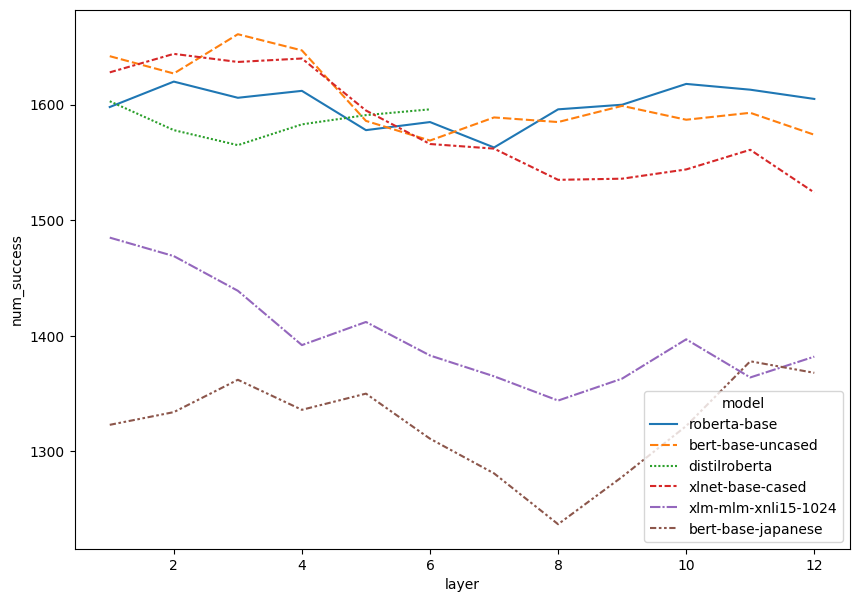

In [270]:
fig, ax = plt.subplots(figsize=(10, 7))
sns.lineplot(x='layer', y='num_success', style='model', hue='model', data=finegrained_binom_results_df, ax=ax)

In [271]:
finegrained_binom_results_df.sort_values

<bound method DataFrame.sort_values of                  model  layer  \
0         roberta-base      1   
1         roberta-base      2   
2         roberta-base      3   
3         roberta-base      4   
4         roberta-base      5   
..                 ...    ...   
61  bert-base-japanese      8   
62  bert-base-japanese      9   
63  bert-base-japanese     10   
64  bert-base-japanese     11   
65  bert-base-japanese     12   

                                          binom_p_val  num_success  
0   BinomTestResult(k=1598, n=1770, alternative='t...         1598  
1   BinomTestResult(k=1620, n=1770, alternative='t...         1620  
2   BinomTestResult(k=1606, n=1770, alternative='t...         1606  
3   BinomTestResult(k=1612, n=1770, alternative='t...         1612  
4   BinomTestResult(k=1578, n=1770, alternative='t...         1578  
..                                                ...          ...  
61  BinomTestResult(k=1237, n=1770, alternative='t...         1237  
62  BinomTes

In [272]:
[x[-1].sort_values('num_success').iloc[-1].layer for x in finegrained_binom_results_df.groupby(['model'])]

[11, 3, 1, 2, 1, 2]

In [ ]:
finegrained_binom_results_df.pivot('model', 'layer', 'num_success')

In [274]:
finegrained_binom_results_df.sort_values('num_success')

,model,layer,binom_p_val,num_success
61,bert-base-japanese,8,"BinomTestResult(k=1237, n=1770, alternative='t...",1237
62,bert-base-japanese,9,"BinomTestResult(k=1278, n=1770, alternative='t...",1278
60,bert-base-japanese,7,"BinomTestResult(k=1281, n=1770, alternative='t...",1281
59,bert-base-japanese,6,"BinomTestResult(k=1311, n=1770, alternative='t...",1311
63,bert-base-japanese,10,"BinomTestResult(k=1322, n=1770, alternative='t...",1322
...,...,...,...,...
33,xlnet-base-cased,4,"BinomTestResult(k=1640, n=1770, alternative='t...",1640
12,bert-base-uncased,1,"BinomTestResult(k=1642, n=1770, alternative='t...",1642
31,xlnet-base-cased,2,"BinomTestResult(k=1644, n=1770, alternative='t...",1644
15,bert-base-uncased,4,"BinomTestResult(k=1647, n=1770, alternative='t...",1647


In [ ]:
# from sklearn.model_selection import LeaveOneOut

# loo = LeaveOneOut()
# loo.get_n_splits(X)

# pred_matrix = np.zeros_like(Y)

# for i, (train_index, test_index) in enumerate(loo.split(X)):
#     X_train, X_test = X[train_index], X[test_index]
#     y_train, y_test = Y[train_index], Y[test_index]
    
#     model = LinearRegression()

#     model.fit(X_train, y_train)

#     pred_matrix[i] = model.predict(X_test)

In [ ]:
# from sklearn.metrics import mean_squared_error

# mean_squared_error(Y, pred_matrix)

In [ ]:
# def linear_regression(X, Y):

#     for ind_pair in ind_pairs:
#         model = LinearRegression()

#         train_inds = [x for x in range(60) if x not in ind_pair]
#         model.fit(X[train_inds], Y[train_inds])

#         preds = model.predict(X[ind_pair, :])
        

## 2 v 2 Test

In [ ]:
# word_cos_dist(reordered_reps, model, layer, plot=True)

In [ ]:
# res_df

In [ ]:
# res_df = word_cos_dist(reordered_reps, model_name, layer)
# average_word_cos = res_df.relation_vector_cosine_distance.mean()
# does_not_share_word_cos = res_df[res_df.shares_word == False].relation_vector_cosine_distance.mean()
# shares_word_cos = res_df[res_df.shares_word == True].relation_vector_cosine_distance.mean()

# cos_row = {'model': model_name, 'layer': layer, "average_word_cos": average_word_cos, "does_not_share_word_cos": does_not_share_word_cos, 
#            "shares_word_cos": shares_word_cos}

In [ ]:
# cos_rows.append({'model': model_name, 'layer': layer, "Condition": "All compounds", "Average distance": average_word_cos})
# cos_rows.append({'model': model_name, 'layer': layer, "Condition": "Compounds that share words", "Average distance": shares_word_cos})
# cos_rows.append({'model': model_name, 'layer': layer, "Condition": "Compounds that do not share words", "Average distance": does_not_share_word_cos})

In [ ]:
# # Figure 5
# # Experiment 1b

# # for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
# #          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

# for y, ylim in zip(['Average distance'], [(-0.1, 0.9)]):
#     fig_shape = (2, 3)
    
#     fig_df = cos_rows_df
#     fig_df = sort_df_by_model_order(fig_df)
    
#     print(y)
#     single_fig_size = 4
#     fig = plt.figure(figsize=(fig_shape[1] * 3.25, fig_shape[0] * 3.25, ))

#     grid_height = fig_shape[0] * single_fig_size
#     grid_width = fig_shape[1] * single_fig_size
#     grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)
    

#     for (i, model_df), (fig_y, fig_x) in zip(fig_df.groupby('model_order'), product(range(fig_shape[0]), range(fig_shape[1]))):
# #         model_df = sort_df_by_model_order(model_df)
# #         print(model, fig_coords)
#         model = model_df.iloc[0].model
    
#         line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
#         g = sns.lineplot(data=model_df, hue='Condition', y=y, x='layer', style='Condition', markers=True, ax=line_plot_ax);
#         line_plot_ax.set_xticks(model_df.layer.unique());
# #         g.set(ylim=)
#         g.set(ylim=ylim);

#         if fig_x == 0:
#             g.set_ylabel('Cosine distance');
#         else:
#             g.set_ylabel('');
            
#         if fig_y == 0:
#             g.set_xlabel('');

#         if fig_x == 0 and fig_y == 0:
#             g.legend(loc='best', bbox_to_anchor=(1.5, -2, 0.5, 0.5), ncol=1);
#         else:
#             g.legend().remove();
            
#         g.axhline(0, color='black', linestyle='--', linewidth=1)
        
#         g.set_title(model);
        
#     fig.show()
    
# plt.savefig('figures/coarse_grained_rsa_results_1b.png', bbox_inches='tight')
# plt.savefig('figures/coarse_grained_rsa_results_1b.eps', format='eps', bbox_inches='tight')

In [ ]:

load = True

if load:
    finegrained_binom_results_lin_reg_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_binom_lin_reg.csv')
else:
    whole_sentence = False

    rows = []
    cos_rows = []
    num_top_relations = 18
    condition = '_consider_magnitude'
    
    prediction_dict = {}
    
    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 17)):
          
            if layer > 6 and 'distil' in model_name:
                continue
            elif layer > 12 and 'bert' in model_name:
                continue
            elif layer > 12 and 'xlm' in model_name:
                continue
            elif layer > 12 and 'xlnet' in model_name:
                continue
            elif layer > 12 and 'gpt' in model_name:
                continue
            
            if whole_sentence:
                reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds_mean_pooled/{}_layer_{}_noun_noun_compounds_mean_pooled.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            else:
#               reps = np.load('../data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))
                reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))

#                 word_reps = reps.mean(axis=1)

#             reordered_reps = word_reps[reordered_compound_indices['{}{}'.format(num_top_relations, condition)]]

#             reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]
            if whole_sentence:
                reordered_reps = reps[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]] 
            else:
                reordered_reps = reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]] 

            reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

            # binom_p_val, num_success, predictions = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=True)
           
            # prediction_dict['{}_{}'.format(model_name, layer)] = predictions

            # rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})
            
            res_df = word_cos_dist(reordered_reps, model_name, layer, False)
            average_word_cos = res_df.relation_vector_cosine_distance.mean()
            does_not_share_word_cos = res_df[res_df.shares_word == False].relation_vector_cosine_distance.mean()
            shares_word_cos = res_df[res_df.shares_word == True].relation_vector_cosine_distance.mean()

            cos_rows.append({'model': model_name, 'layer': layer, "Condition": "All compounds", "Average distance": average_word_cos})
            cos_rows.append({'model': model_name, 'layer': layer, "Condition": "Compounds that share words", "Average distance": shares_word_cos})
            cos_rows.append({'model': model_name, 'layer': layer, "Condition": "Compounds that do not share words", "Average distance": does_not_share_word_cos})
    finegrained_binom_results_lin_reg_df = pd.DataFrame(rows)
    cos_rows_df = pd.DataFrame(cos_rows)
    finegrained_binom_results_lin_reg_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/relation_vector_binom_lin_reg.csv')

roberta-base


100%|██████████| 16/16 [00:00<00:00, 58.08it/s]


bert-base-uncased


100%|██████████| 16/16 [00:00<00:00, 67.51it/s]


distilroberta


100%|██████████| 16/16 [00:00<00:00, 118.79it/s]


xlnet-base-cased


100%|██████████| 16/16 [00:00<00:00, 56.56it/s]


xlm-mlm-xnli15-1024


100%|██████████| 16/16 [00:00<00:00, 54.07it/s]


bert-base-japanese


100%|██████████| 16/16 [00:00<00:00, 62.27it/s]


In [490]:
finegrained_binom_results_lin_reg_df

,model,layer,binom_p_val,num_success
0,roberta-base,1,"BinomTestResult(k=0, n=1770, alternative='two-...",0
1,roberta-base,2,"BinomTestResult(k=0, n=1770, alternative='two-...",0
2,roberta-base,3,"BinomTestResult(k=0, n=1770, alternative='two-...",0
3,roberta-base,4,"BinomTestResult(k=0, n=1770, alternative='two-...",0
4,roberta-base,5,"BinomTestResult(k=0, n=1770, alternative='two-...",0
...,...,...,...,...
61,bert-base-japanese,8,"BinomTestResult(k=0, n=1770, alternative='two-...",0
62,bert-base-japanese,9,"BinomTestResult(k=0, n=1770, alternative='two-...",0
63,bert-base-japanese,10,"BinomTestResult(k=0, n=1770, alternative='two-...",0
64,bert-base-japanese,11,"BinomTestResult(k=0, n=1770, alternative='two-...",0


## 2 vs. 2 test: lexical adjustment

In [234]:
def two_vs_two_lin_reg_test_filter(X, Y, inds_to_keep, save_predictions=False):
    ind_pairs = [x for x in permutations([y for y in range(len(X)) if y in inds_to_keep], 2) if x[0] >= x[1]]
     
    if save_predictions:
        predictions_per_sample = np.zeros_like(Y, dtype=float)
    
    outcomes = []
    
    for ind_pair in ind_pairs:
        model = LinearRegression()

        train_inds = [x for x in [y for y in range(len(X)) if y in inds_to_keep] if x not in ind_pair]
        

        
        model.fit(X[train_inds], Y[train_inds])

        preds = model.predict(X[ind_pair, :])
        
        if save_predictions:
            predictions_per_sample[ind_pair, :] += preds
        
        outcomes.append((cosine_similarity(preds[0].reshape(1, -1), Y[ind_pair[0]].reshape(1, -1)) 
                        + cosine_similarity(preds[1].reshape(1, -1), Y[ind_pair[1]].reshape(1, -1))
                        > cosine_similarity(preds[0].reshape(1, -1), Y[ind_pair[1]].reshape(1, -1))
                       + cosine_similarity(preds[1].reshape(1, -1), Y[ind_pair[0]].reshape(1, -1)))[0][0])
    
    if save_predictions:
        return binomtest(sum(outcomes), len(ind_pairs)), sum(outcomes), predictions_per_sample / (X.shape[0] - 1)
    else:
        return binomtest(sum(outcomes), len(ind_pairs)), sum(outcomes)

original_ind_to_reordered_ind_map = {x: i for i, x in enumerate(reordered_compound_indices['{}{}'.format(num_top_relations, condition)])}
reordered_words_to_keep = [original_ind_to_reordered_ind_map[i] for i in words_to_keep]


In [221]:
original_ind_to_reordered_ind_map = {x: i for i, x in enumerate(reordered_compound_indices['{}{}'.format(num_top_relations, condition)])}

In [223]:
reordered_words_to_keep = [original_ind_to_reordered_ind_map[i] for i in words_to_keep]

In [ ]:
# reordered_compounds[reordered_words_to_keep]

In [225]:
len(reordered_words_to_keep)

41

In [ ]:
# LEXICAL CONFOUND ADJUSTMENT
load = True

if load:
    finegrained_binom_results_without_lexical_confound_lin_reg_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_binom_results_without_lexical_confound_lin_reg_df.csv')
else:
    whole_sentence = False

    rows = []

    num_top_relations = 18
    condition = '_consider_magnitude'
    
    prediction_dict = {}
    
    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 13)):
          
            if layer > 6 and 'distil' in model_name:
                continue
           
            if whole_sentence:
                reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds_mean_pooled/{}_layer_{}_noun_noun_compounds_mean_pooled.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            else:
#               reps = np.load('../data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))
                reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))

#                 word_reps = reps.mean(axis=1)

#             reordered_reps = word_reps[reordered_compound_indices['{}{}'.format(num_top_relations, condition)]]

#             reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

            reordered_reps = reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]] 
            

            reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

            binom_p_val, num_success, predictions = two_vs_two_lin_reg_test_filter(reordered_reps, reordered_relation_vectors, inds_to_keep=reordered_words_to_keep, 
                                                                                   save_predictions=True)
           
            prediction_dict['{}_{}'.format(model_name, layer)] = predictions

            rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})


    finegrained_binom_results_without_lexical_confound_lin_reg_df = pd.DataFrame(rows)
    finegrained_binom_results_without_lexical_confound_lin_reg_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_binom_results_without_lexical_confound_lin_reg_df.csv')

roberta-base


100%|██████████| 12/12 [00:38<00:00,  3.17s/it]


bert-base-uncased


100%|██████████| 12/12 [00:36<00:00,  3.03s/it]


distilroberta


100%|██████████| 12/12 [00:17<00:00,  1.43s/it]


xlnet-base-cased


100%|██████████| 12/12 [00:37<00:00,  3.11s/it]


xlm-mlm-xnli15-1024


100%|██████████| 12/12 [00:44<00:00,  3.69s/it]


bert-base-japanese


100%|██████████| 12/12 [00:39<00:00,  3.29s/it]


In [236]:
finegrained_binom_results_without_lexical_confound_lin_reg_df

,model,layer,binom_p_val,num_success
0,roberta-base,1,"BinomTestResult(k=648, n=820, alternative='two...",648
1,roberta-base,2,"BinomTestResult(k=681, n=820, alternative='two...",681
2,roberta-base,3,"BinomTestResult(k=698, n=820, alternative='two...",698
3,roberta-base,4,"BinomTestResult(k=700, n=820, alternative='two...",700
4,roberta-base,5,"BinomTestResult(k=715, n=820, alternative='two...",715
...,...,...,...,...
61,bert-base-japanese,8,"BinomTestResult(k=333, n=820, alternative='two...",333
62,bert-base-japanese,9,"BinomTestResult(k=314, n=820, alternative='two...",314
63,bert-base-japanese,10,"BinomTestResult(k=352, n=820, alternative='two...",352
64,bert-base-japanese,11,"BinomTestResult(k=352, n=820, alternative='two...",352


In [237]:
words_to_skip

array([ 4,  5, 14, 17, 21, 22, 29, 34, 35, 38, 42, 46, 47, 48, 50, 52, 53,
       56, 59])

In [180]:
len(words_to_skip)

19

In [ ]:
((42*42 - 42) / 2)

In [ ]:
((42*42 - 42) / 2) / 2

<Axes: xlabel='layer', ylabel='num_success'>

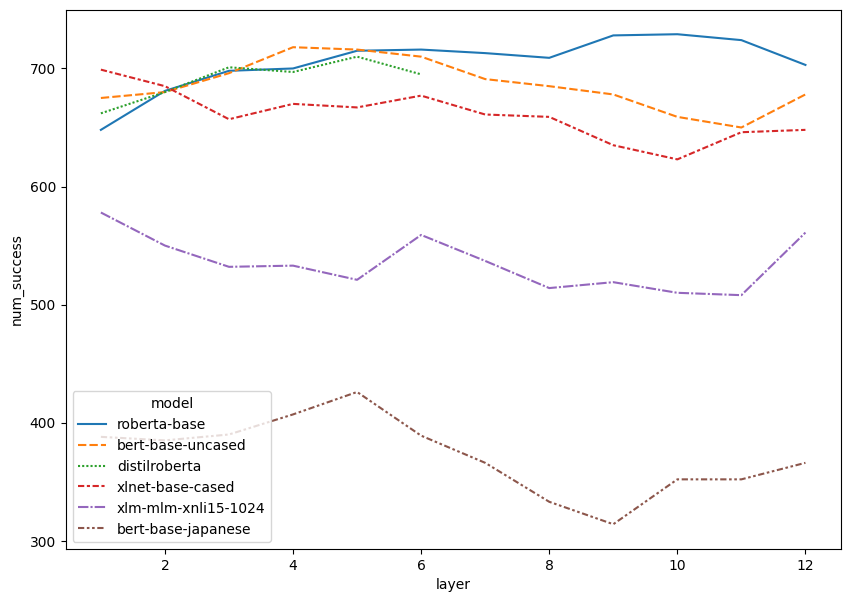

In [238]:
fig, ax = plt.subplots(figsize=(10, 7))
sns.lineplot(ax=ax, x='layer', y='num_success', style='model', hue='model', data=finegrained_binom_results_without_lexical_confound_lin_reg_df)

In [ ]:
# spearmanr(finegrained_binom_results_lin_reg_df.layer, finegrained_binom_results_lin_reg_df.num_success)

In [ ]:
# finegrained_binom_results_lin_reg_df.sort_values('num_success')

## Compositional Test

In [239]:
np.arange(a.shape[0])

array([0, 1, 2])

In [240]:
a = np.zeros((6, 20))
np.mean(np.dstack([a[np.where(np.arange(a.shape[0]) % 2 == 0)], a[np.where(np.arange(a.shape[0]) % 2 == 1)]]), axis=-1).shape                                             

(3, 20)

In [430]:
load = True

if load:
    finegrained_binom_results_lin_reg_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/compositional_probe_2_v_2_test_results.csv')    
    finegrained_binom_results_without_lexical_confound_lin_reg_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_binom_results_without_lexical_confound_lin_reg_df.csv')    
else:
    rows = []
    rows_without_lexical_confound = []
    num_top_relations = 18
    condition = '_consider_magnitude'

#     prediction_dict = {}

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 13)):
            if layer > 6 and 'distil' in model_name:
                continue
#             reps = np.load('../data/representations/{}/layer_{}/compositional_analysis/{}_layer_{}_compositional_analysis.npy'.format(model_name.split('-')[0], layer, model_name, layer))
#             reps = np.mean(np.dstack([reps[np.where(np.arange(reps.shape[0]) % 2 == 0)], reps[np.where(np.arange(reps.shape[0]) % 2 == 1)]]), axis=-1)                                             
#             reordered_reps = reps[reordered_compound_indices['{}{}'.format(num_top_relations, condition)]]

#             reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            reordered_reps = reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]] 

            reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]


            binom_p_val, num_success, predictions = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=True)

            #             prediction_dict['{}_{}'.format(model_name, layer)] = predictions

            rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})

            binom_p_val, num_success = two_vs_two_lin_reg_test_filter(reordered_reps, reordered_relation_vectors, inds_to_keep=reordered_words_to_keep, 
                                                                      save_predictions=False)
            rows_without_lexical_confound.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})
                                                                      
    finegrained_binom_results_lin_reg_df = pd.DataFrame(rows)
    finegrained_binom_results_lin_reg_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/compositional_probe_2_v_2_test_results.csv')

    finegrained_binom_results_without_lexical_confound_lin_reg_df = pd.DataFrame(rows_without_lexical_confound)
    finegrained_binom_results_without_lexical_confound_lin_reg_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_binom_results_without_lexical_confound_lin_reg_df.csv')

In [242]:
reps.shape

(900, 2, 768)

In [429]:
load = True

if load:
    finegrained_compositional_binom_results_lin_reg_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_compositional_binom_results_lin_reg_df.csv')    
    finegrained_compositional_binom_results_lin_reg_with_filter_df = pd.read_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_compositional_binom_results_lin_reg_with_filter.csv')    
else:
    rows = []
    rows_without_lexical_compound = []

    num_top_relations = 18
    condition = '_consider_magnitude'

    prediction_dict = {}

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 13)):
            if layer > 6 and 'distil' in model_name:
                continue
            reps = np.load('D:/NOUN-NOUN-COMPOUNDS-V1/data/representations/{}/layer_{}/compositional_analysis/{}_layer_{}_compositional_analysis.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            
            order = reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]
            head_reps = reps[[x for x in range(600) if x % 2 == 0], :][order]
            mod_reps = reps[[x for x in range(600) if x % 2 == 1], :][order]
            compound_reps = np.dstack((head_reps, mod_reps)).mean(axis=-1)
            
            reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

#             binom_p_val, num_success, predictions = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=True)
            # mod is where i == 0, head where i == 1
            reordered_reps = compound_reps
                    
            binom_p_val, num_success, predictions = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=True)

#           prediction_dict_head_mod['{}_{}_{}'.format(model_name, layer, rep)] = predictions

            rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})

            binom_p_val, num_success = two_vs_two_lin_reg_test_filter(reordered_reps, reordered_relation_vectors, inds_to_keep=reordered_words_to_keep, 
                                                                           save_predictions=False)
            rows_without_lexical_compound.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})
    
    finegrained_compositional_binom_results_lin_reg_df = pd.DataFrame(rows)
    finegrained_compositional_binom_results_lin_reg_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_compositional_binom_results_lin_reg_df.csv') 
    
    finegrained_compositional_binom_results_lin_reg_with_filter_df = pd.DataFrame(rows_without_lexical_compound)
    finegrained_compositional_binom_results_lin_reg_with_filter_df.to_csv('D:/NOUN-NOUN-COMPOUNDS-V1/data/results/finegrained_compositional_binom_results_lin_reg_with_filter.csv') 

In [286]:
finegrained_binom_results_lin_reg_df['Word representations processed . . .'] = 'As a compound'
finegrained_compositional_binom_results_lin_reg_df['Word representations processed . . .'] = 'In separate sentences'

finegrained_binom_results_without_lexical_confound_lin_reg_df['Word representations processed . . .'] = 'As a compound'
finegrained_compositional_binom_results_lin_reg_with_filter_df['Word representations processed . . .'] = 'In separate sentences'


In [245]:
without_lexical_confound = True

In [287]:
finegrained_compositional_binom_results_lin_reg_with_filter_df

,model,layer,binom_p_val,num_success,Word representations processed . . .
0,roberta-base,1,"BinomTestResult(k=540, n=820, alternative='two...",540,In separate sentences
1,roberta-base,2,"BinomTestResult(k=588, n=820, alternative='two...",588,In separate sentences
2,roberta-base,3,"BinomTestResult(k=638, n=820, alternative='two...",638,In separate sentences
3,roberta-base,4,"BinomTestResult(k=646, n=820, alternative='two...",646,In separate sentences
4,roberta-base,5,"BinomTestResult(k=619, n=820, alternative='two...",619,In separate sentences
...,...,...,...,...,...
61,bert-base-japanese,8,"BinomTestResult(k=376, n=820, alternative='two...",376,In separate sentences
62,bert-base-japanese,9,"BinomTestResult(k=309, n=820, alternative='two...",309,In separate sentences
63,bert-base-japanese,10,"BinomTestResult(k=301, n=820, alternative='two...",301,In separate sentences
64,bert-base-japanese,11,"BinomTestResult(k=317, n=820, alternative='two...",317,In separate sentences


In [247]:
finegrained_binom_results_without_lexical_confound_lin_reg_df

,model,layer,binom_p_val,num_success,Word representations processed . . .
0,roberta-base,1,"BinomTestResult(k=648, n=820, alternative='two...",648,As a compound
1,roberta-base,2,"BinomTestResult(k=681, n=820, alternative='two...",681,As a compound
2,roberta-base,3,"BinomTestResult(k=698, n=820, alternative='two...",698,As a compound
3,roberta-base,4,"BinomTestResult(k=700, n=820, alternative='two...",700,As a compound
4,roberta-base,5,"BinomTestResult(k=715, n=820, alternative='two...",715,As a compound
...,...,...,...,...,...
61,bert-base-japanese,8,"BinomTestResult(k=333, n=820, alternative='two...",333,As a compound
62,bert-base-japanese,9,"BinomTestResult(k=314, n=820, alternative='two...",314,As a compound
63,bert-base-japanese,10,"BinomTestResult(k=352, n=820, alternative='two...",352,As a compound
64,bert-base-japanese,11,"BinomTestResult(k=352, n=820, alternative='two...",352,As a compound


In [248]:
if without_lexical_confound:
    df_two = pd.concat([finegrained_binom_results_without_lexical_confound_lin_reg_df, finegrained_compositional_binom_results_lin_reg_with_filter_df])
    num_tests = 820.0
    random_baseline = 410
else:
    df_two = pd.concat([finegrained_compositional_binom_results_lin_reg_df, finegrained_binom_results_lin_reg_df])
    num_tests = 1770
    random_baseline = 1770 / 2
    
df_two = sort_df_by_model_order(df_two)


In [249]:
df_two

,model,layer,binom_p_val,num_success,Word representations processed . . .,model_order,model_name
12,bert-base-uncased,1,"BinomTestResult(k=675, n=820, alternative='two...",675,As a compound,0,BERT
13,bert-base-uncased,2,"BinomTestResult(k=680, n=820, alternative='two...",680,As a compound,0,BERT
14,bert-base-uncased,3,"BinomTestResult(k=696, n=820, alternative='two...",696,As a compound,0,BERT
15,bert-base-uncased,4,"BinomTestResult(k=718, n=820, alternative='two...",718,As a compound,0,BERT
16,bert-base-uncased,5,"BinomTestResult(k=716, n=820, alternative='two...",716,As a compound,0,BERT
...,...,...,...,...,...,...,...
61,bert-base-japanese,8,"BinomTestResult(k=376, n=820, alternative='two...",376,In separate sentences,5,BERT-Japanese
62,bert-base-japanese,9,"BinomTestResult(k=309, n=820, alternative='two...",309,In separate sentences,5,BERT-Japanese
63,bert-base-japanese,10,"BinomTestResult(k=301, n=820, alternative='two...",301,In separate sentences,5,BERT-Japanese
64,bert-base-japanese,11,"BinomTestResult(k=317, n=820, alternative='two...",317,In separate sentences,5,BERT-Japanese


In [200]:
df_two.columns

Index(['model', 'layer', 'binom_p_val', 'num_success',
       'Word representations processed . . .', 'model_order', 'model_name'],
      dtype='object')

In [ ]:
(42*42-42)/2

In [ ]:
(42*42-42)/4

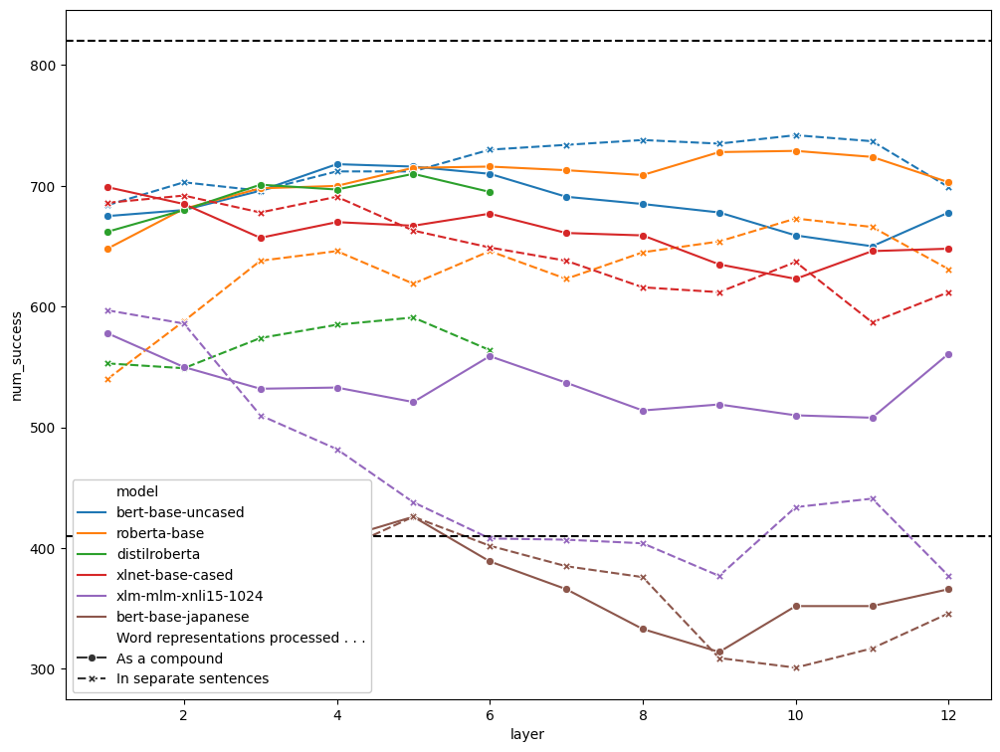

In [250]:
fig, ax = plt.subplots(figsize=(12, 9))
# sns.lineplot(ax=ax, x='layer', markers=True, y='num_success', style='Word representations processed . . .', hue='model', data=df_two.sort_values(['model_order', 'Word representations processed . . .'])).set_title('Number of successes in 2 vs. 2 test for predicting relation vectors given compound representations \n(head/modifier words processed together & head/modifier words processed in separate sentences)')
sns.lineplot(ax=ax, x='layer', markers=True, y='num_success', style='Word representations processed . . .', hue='model', data=df_two.sort_values(['model_order', 'Word representations processed . . .']))
leg = plt.legend(facecolor='white', framealpha=1)
ax.axhline(num_tests, color='black', linestyle='--', linewidth=1.5)
ax.axhline(random_baseline, color='black', linestyle='--', linewidth=1.5)

In [251]:
df_two.groupby('model').num_success.max()

model
bert-base-japanese     426
bert-base-uncased      742
distilroberta          710
roberta-base           729
xlm-mlm-xnli15-1024    597
xlnet-base-cased       699
Name: num_success, dtype: int32

In [252]:
# together (iloc[1]) - separate (iloc[0])
res = [(x[0], np.mean([(y[-1].iloc[1].num_success - y[-1].iloc[0].num_success) / (y[-1].iloc[0].num_success) * 100 for y in x[-1].groupby('layer')])) for x in df_two.groupby('model')]
res 

[('bert-base-japanese', 0.8305305955665476),
 ('bert-base-uncased', 4.79852053248799),
 ('distilroberta', -17.58754820724597),
 ('roberta-base', -10.632118251331566),
 ('xlm-mlm-xnli15-1024', -15.056146256837232),
 ('xlnet-base-cased', -2.1092477809100143)]

In [ ]:
spearmanr(df_two.groupby('model').num_success.max().tolist(), [x[-1] for x in res])

In [253]:
# Tuples of percentage increase from processing together and max(num_successes_together, num_success_separate), for each layer of each model
nested_list = [[(y[-1].iloc[0].model, y[-1].iloc[0].layer, ((y[-1].iloc[1].num_success - y[-1].iloc[0].num_success) / (y[-1].iloc[0].num_success) * 100), max(y[-1].iloc[0].num_success, y[-1].iloc[1].num_success)) for y in x[-1].groupby('layer')] for x in df_two.groupby('model')]
flat_res = [y for x in nested_list for y in x]

In [256]:
model_map = {'bert-base-japanese': 'test',
             'bert-base-uncased': 'none',
             'distilroberta': 'test',
             'roberta-base': 'dev',
             'xlm-mlm-xnli15-1024': 'dev',
             'xlnet-base-cased': 'dev'}

In [257]:
flat_res = pd.DataFrame(flat_res, columns=['model', 'layer', 'percentage_increase', 'max_num_success'])

flat_res['model_type'] = [model_map[x.model] for x in flat_res.iloc]
flat_res['rdm_corr'] = relation_results_within_compound_groups_df.sort_values(['model', 'layer']).same_relation_group_rdm_corr_within_compound_sentences.tolist()

In [258]:
flat_res

,model,layer,percentage_increase,max_num_success,model_type,rdm_corr
0,bert-base-japanese,1,6.185567,412,test,0.023570
1,bert-base-japanese,2,9.870130,423,test,0.035317
2,bert-base-japanese,3,6.410256,415,test,0.035279
3,bert-base-japanese,4,-2.457002,407,test,0.045755
4,bert-base-japanese,5,0.000000,426,test,0.031351
...,...,...,...,...,...,...
61,xlnet-base-cased,8,-6.525038,659,dev,0.092971
62,xlnet-base-cased,9,-3.622047,635,dev,0.083805
63,xlnet-base-cased,10,2.247191,637,dev,0.081186
64,xlnet-base-cased,11,-9.133127,646,dev,0.094281


## Compositional Gain Correlations

In [275]:
spearmanr(flat_res.percentage_increase, flat_res.max_num_success)

SignificanceResult(statistic=0.1009978707406132, pvalue=0.41972430716759446)

In [276]:
spearmanr(flat_res[flat_res.model_type == 'dev'].percentage_increase, flat_res[flat_res.model_type == 'dev'].max_num_success)

SignificanceResult(statistic=0.2548426544951476, pvalue=0.13361847290004053)

In [277]:
spearmanr(flat_res[flat_res.model_type == 'test'].percentage_increase, flat_res[flat_res.model_type == 'test'].max_num_success)

SignificanceResult(statistic=-0.4976768861465699, pvalue=0.03558464563852915)

<Axes: xlabel='layer', ylabel='same_relation_group_rdm_corr_within_compound_sentences'>

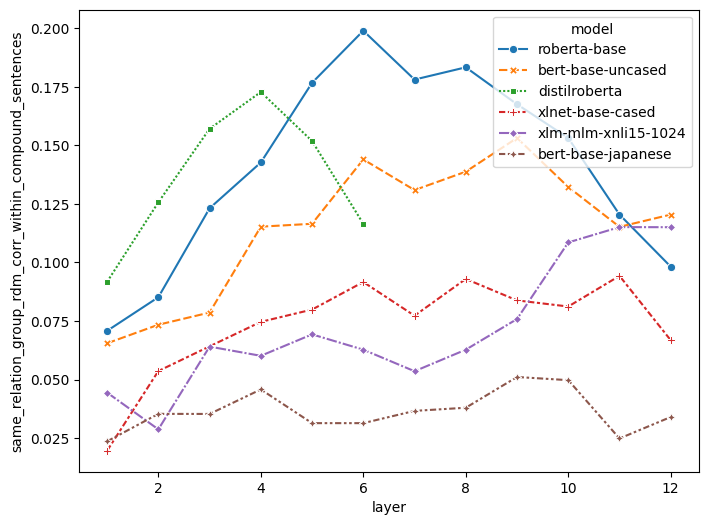

In [278]:
plt.figure(figsize=(8,6))
sns.lineplot(x='layer', y='same_relation_group_rdm_corr_within_compound_sentences', hue='model', style='model', markers=True, data=relation_results_within_compound_groups_df)

# Correlation between increase in signal when processed together and Fine-grained RDM corr

In [339]:
finegrained_results_df

,model,representation,layer,relation_vector_corr,num_top_relations_considered,condition
0,roberta-base,compound,1,0.117363,1,_consider_magnitude
1,roberta-base,head,1,0.113908,1,_consider_magnitude
2,roberta-base,modifier,1,0.077410,1,_consider_magnitude
3,roberta-base,compound,1,0.128896,2,_consider_magnitude
4,roberta-base,head,1,0.108389,2,_consider_magnitude
...,...,...,...,...,...,...
3559,bert-base-japanese,head,12,-0.023569,17,_consider_magnitude
3560,bert-base-japanese,modifier,12,0.000504,17,_consider_magnitude
3561,bert-base-japanese,compound,12,0.016339,18,_consider_magnitude
3562,bert-base-japanese,head,12,-0.023298,18,_consider_magnitude


In [340]:
finegrained_rsa_res = finegrained_results_df[(finegrained_results_df.condition == '_consider_magnitude') & (finegrained_results_df.num_top_relations_considered == 18) & (finegrained_results_df.representation == 'compound')]

flat_res['finegrained_rdm_corr'] = finegrained_rsa_res.sort_values(['model', 'layer']).relation_vector_corr.tolist()

In [341]:
spearmanr(flat_res.percentage_increase, flat_res.finegrained_rdm_corr)

SignificanceResult(statistic=-0.01644939410792144, pvalue=0.8957033104905294)

## (Per Model)

In [342]:
for model, df in flat_res.groupby('model'):
    print(model, spearmanr(df.percentage_increase, df.finegrained_rdm_corr))

bert-base-japanese SignificanceResult(statistic=0.5034965034965035, pvalue=0.09515736659412469)
bert-base-uncased SignificanceResult(statistic=0.7342657342657343, pvalue=0.006543490146837885)
distilroberta SignificanceResult(statistic=-0.3714285714285715, pvalue=0.46847813411078715)
roberta-base SignificanceResult(statistic=0.5104895104895105, pvalue=0.08991373630263913)
xlm-mlm-xnli15-1024 SignificanceResult(statistic=-0.17482517482517487, pvalue=0.5868236643627043)
xlnet-base-cased SignificanceResult(statistic=-0.23076923076923078, pvalue=0.470531995381542)


In [343]:
flat_res.head()

,model,layer,percentage_increase,max_num_success,model_type,rdm_corr,finegrained_rdm_corr
0,bert-base-japanese,1,6.185567,412,test,0.023570,0.031631
1,bert-base-japanese,2,9.870130,423,test,0.035317,0.043568
2,bert-base-japanese,3,6.410256,415,test,0.035279,0.048059
3,bert-base-japanese,4,-2.457002,407,test,0.045755,0.047102
4,bert-base-japanese,5,0.000000,426,test,0.031351,0.048111


In [344]:
for model, df in flat_res.groupby('model'):
    print(model, spearmanr(df.percentage_increase, df.finegrained_rdm_corr))

bert-base-japanese SignificanceResult(statistic=0.5034965034965035, pvalue=0.09515736659412469)
bert-base-uncased SignificanceResult(statistic=0.7342657342657343, pvalue=0.006543490146837885)
distilroberta SignificanceResult(statistic=-0.3714285714285715, pvalue=0.46847813411078715)
roberta-base SignificanceResult(statistic=0.5104895104895105, pvalue=0.08991373630263913)
xlm-mlm-xnli15-1024 SignificanceResult(statistic=-0.17482517482517487, pvalue=0.5868236643627043)
xlnet-base-cased SignificanceResult(statistic=-0.23076923076923078, pvalue=0.470531995381542)


In [345]:
df = pd.DataFrame([{'model': m, 'correlation': spearmanr(df.percentage_increase, df.finegrained_rdm_corr)[0], 'p': spearmanr(df.percentage_increase, df.finegrained_rdm_corr)[1]} for m, df in flat_res.groupby('model')])
df.sort_values('correlation')

,model,correlation,p
2,distilroberta,-0.371429,0.468478
5,xlnet-base-cased,-0.230769,0.470532
4,xlm-mlm-xnli15-1024,-0.174825,0.586824
0,bert-base-japanese,0.503497,0.095157
3,roberta-base,0.510490,0.089914
1,bert-base-uncased,0.734266,0.006543


In [309]:
spearmanr(flat_res[(flat_res.model=='bert-base-uncased') | (flat_res.model=='roberta-base')].percentage_increase, flat_res[(flat_res.model=='bert-base-uncased') | (flat_res.model=='roberta-base')].finegrained_rdm_corr)

SignificanceResult(statistic=-0.19304347826086957, pvalue=0.36611583497113964)

## For all numbers of relations considered

In [ ]:
# len(rsa_df.sort_values(['model', 'layer'])[rsa_df.sort_values(['model', 'layer']).model==model].relation_vector_corr.tolist())()

In [346]:
np.tile([1, 2, 3], 3)

array([1, 2, 3, 1, 2, 3, 1, 2, 3])

In [347]:
for (x, s) in flat_res.groupby('model'):
    pass

In [312]:
s

,model,layer,percentage_increase,max_num_success,model_type,rdm_corr,finegrained_rdm_corr
54,xlnet-base-cased,1,-1.859800,699,dev,0.019566,0.050251
55,xlnet-base-cased,2,1.021898,692,dev,0.053612,0.055504
56,xlnet-base-cased,3,3.196347,678,dev,0.064163,0.100637
57,xlnet-base-cased,4,3.134328,691,dev,0.074639,0.088789
58,xlnet-base-cased,5,-0.599700,667,dev,0.079877,0.081877
59,xlnet-base-cased,6,-4.135894,677,dev,0.091662,0.082403
60,xlnet-base-cased,7,-3.479576,661,dev,0.077258,0.096066
61,xlnet-base-cased,8,-6.525038,659,dev,0.092971,0.097139
62,xlnet-base-cased,9,-3.622047,635,dev,0.083805,0.098784
63,xlnet-base-cased,10,2.247191,637,dev,0.081186,0.108011


In [ ]:
# cond

In [313]:
df

,model,correlation,p
0,bert-base-japanese,0.503497,0.095157
1,bert-base-uncased,0.734266,0.006543
2,distilroberta,-0.371429,0.468478
3,roberta-base,0.510490,0.089914
4,xlm-mlm-xnli15-1024,-0.174825,0.586824
5,xlnet-base-cased,-0.230769,0.470532


In [314]:
np.repeat(x, 18)

array(['xlnet-base-cased', 'xlnet-base-cased', 'xlnet-base-cased',
       'xlnet-base-cased', 'xlnet-base-cased', 'xlnet-base-cased',
       'xlnet-base-cased', 'xlnet-base-cased', 'xlnet-base-cased',
       'xlnet-base-cased', 'xlnet-base-cased', 'xlnet-base-cased',
       'xlnet-base-cased', 'xlnet-base-cased', 'xlnet-base-cased',
       'xlnet-base-cased', 'xlnet-base-cased', 'xlnet-base-cased'],
      dtype='<U16')

In [349]:
rows = []

for rep in ['compound', 'head', 'modifier']:
    rsa_df = finegrained_results_df[(finegrained_results_df.representation == rep) & (finegrained_results_df.condition=='_consider_magnitude')]
    c = lambda model, x: spearmanr(np.repeat(x, 18), rsa_df.sort_values(['model', 'layer'])[rsa_df.sort_values(['model', 'layer']).model==model].relation_vector_corr.tolist())
    rows += [{'model': m, 'representation': rep, 'correlation': c(m, df.percentage_increase)[0], 'p': c(m, df.percentage_increase)[1]} for m, df in flat_res.groupby('model')]

all_relations_corr_df = pd.DataFrame(rows)
# print(all_relations_corr_df.pivot('model', 'representation', 'correlation').round(2))

print(all_relations_corr_df.pivot(index='model', columns='representation', values='correlation').round(2))


representation       compound  head  modifier
model                                        
bert-base-japanese       0.30 -0.01      0.26
bert-base-uncased        0.47  0.50      0.37
distilroberta           -0.18 -0.39      0.17
roberta-base             0.33  0.45      0.28
xlm-mlm-xnli15-1024      0.01 -0.60     -0.11
xlnet-base-cased        -0.02 -0.36     -0.27


In [350]:
all_relations_corr_df

,model,representation,correlation,p
0,bert-base-japanese,compound,0.299463,7.504049e-06
1,bert-base-uncased,compound,0.469262,3.160465e-13
2,distilroberta,compound,-0.184864,5.544816e-02
3,roberta-base,compound,0.330306,6.819946e-07
4,xlm-mlm-xnli15-1024,compound,0.009077,8.944885e-01
5,xlnet-base-cased,compound,-0.019745,7.729390e-01
6,bert-base-japanese,head,-0.007055,9.178967e-01
7,bert-base-uncased,head,0.495857,8.344084e-15
8,distilroberta,head,-0.390075,3.004010e-05
9,roberta-base,head,0.450152,3.568718e-12


In [351]:
for rep in ['compound', 'head', 'modifier']:
    rows = []
    for cond, rsa_df in finegrained_results_df[(finegrained_results_df.representation == rep)].groupby(['condition']):
        c = lambda model, x: spearmanr(np.repeat(x, 18), rsa_df.sort_values(['model', 'layer'])[rsa_df.sort_values(['model', 'layer']).model==model].relation_vector_corr.tolist())
        rows += [{'model': m, 'condition': cond, 'correlation': c(m, df.percentage_increase)[0], 'p': c(m, df.percentage_increase)[1]} for m, df in flat_res.groupby('model')]
all_relations_corr_df = pd.DataFrame(rows)

In [352]:
# Results table
res_table = all_relations_corr_df[all_relations_corr_df.condition==('_consider_magnitude')]
del res_table['condition']
res_table.round(3)

,model,correlation,p


In [353]:
rows[0]

{'model': 'bert-base-japanese',
 'condition': ('_consider_magnitude',),
 'correlation': 0.2562739282564327,
 'p': 0.00013987785130160847}

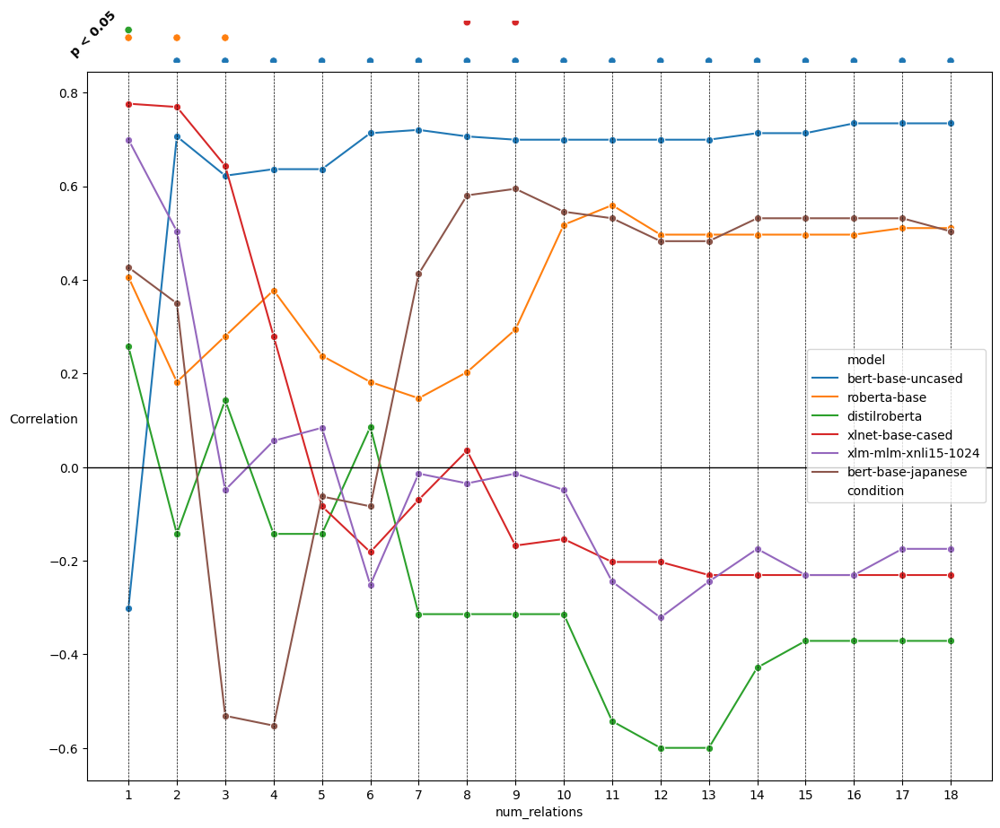

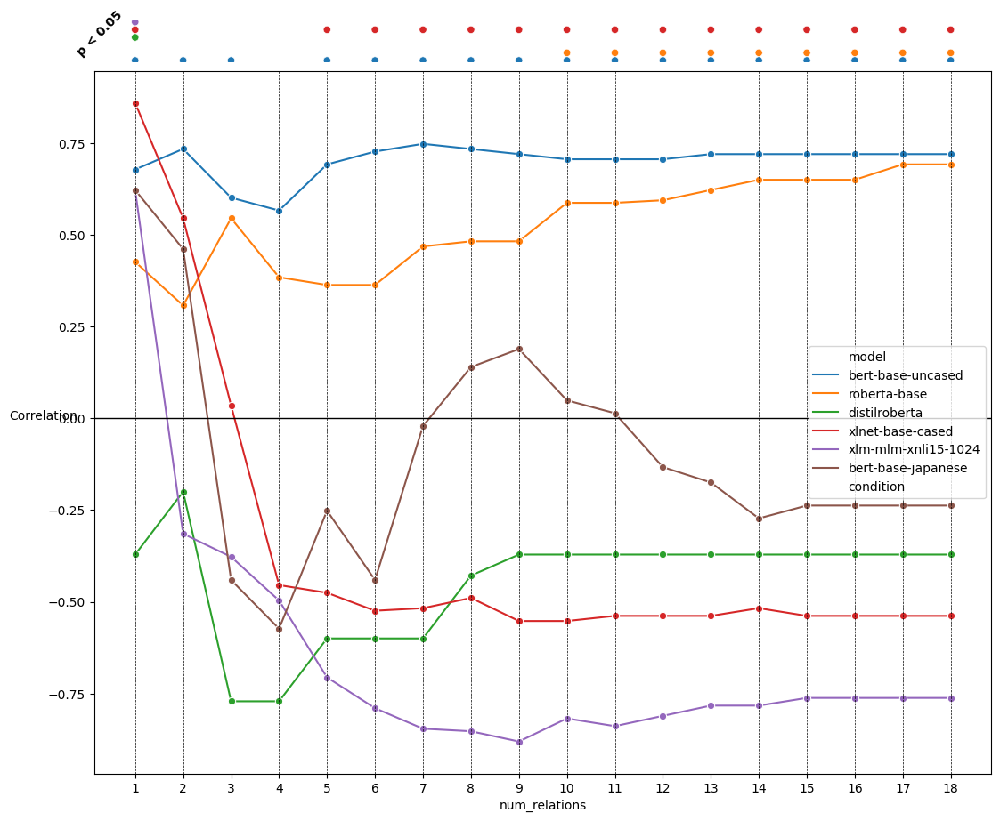

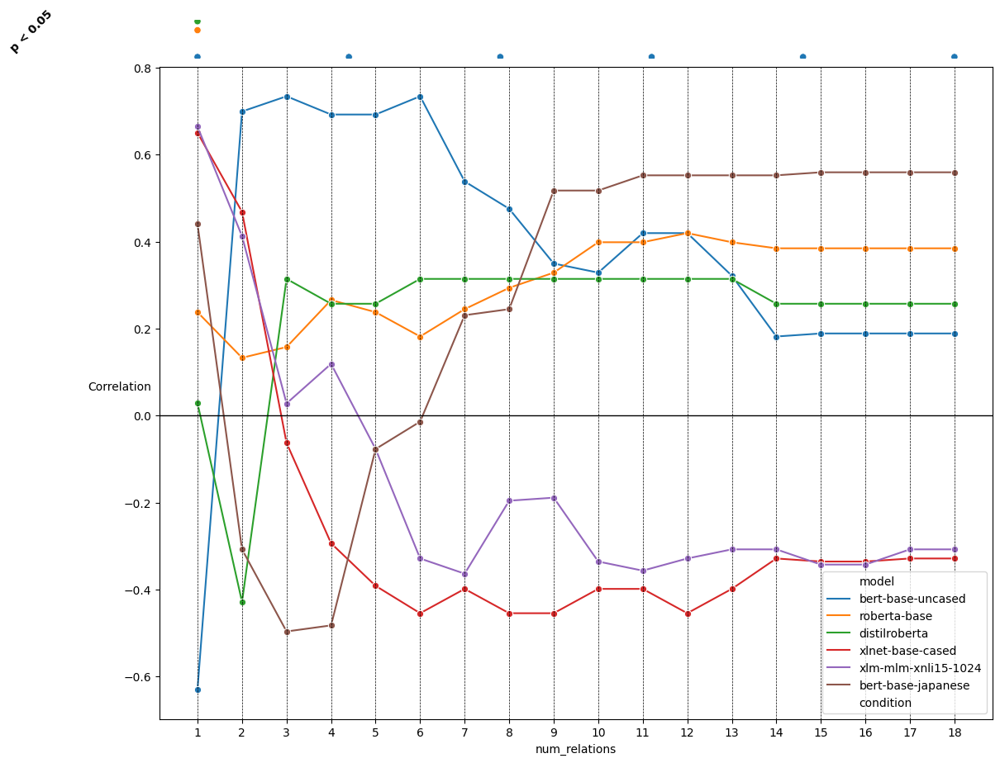

In [354]:
for rep in ['compound', 'head', 'modifier']:
    rows = []
    for (cond, num_relations), rsa_df in finegrained_results_df[(finegrained_results_df.representation == rep)].groupby(['condition', 'num_top_relations_considered']):
        c = lambda model, x: spearmanr(x, rsa_df.sort_values(['model', 'layer'])[rsa_df.sort_values(['model', 'layer']).model==model].relation_vector_corr.tolist())
        rows += [{'model': m, 'condition': cond, 'num_relations': num_relations, 'correlation': c(m, df.percentage_increase)[0], 'p': c(m, df.percentage_increase)[1]} for m, df in flat_res.groupby('model')]
    full_df = pd.DataFrame(rows)
    
    full_df = sort_df_by_model_order(full_df)
    full_df['model_order'] = [order_dict[x.model] for x in full_df.iloc]
    
    fig = plt.figure(figsize=(13, 11))
    grid = fig.add_gridspec(15, 1)

    corr_dots_ax = fig.add_subplot(grid[0, 0])
    corr_dots_ax.axis('off')

    line_plot_ax = fig.add_subplot(grid[1:, 0])
    g = sns.lineplot(data=full_df[full_df.condition=='_consider_magnitude'], hue='model', y='correlation', x='num_relations', style='condition', markers=True, ax=line_plot_ax)
    line_plot_ax.axhline(0, c='black', lw=1)
    [line_plot_ax.axvline(x, c='black', linestyle='--', lw=0.5) for x in full_df.num_relations.unique()];
    line_plot_ax.set_xticks(full_df.num_relations.unique());

    sns.scatterplot(y='model_order', x='num_relations', hue='model', data=full_df[(full_df.condition=='_consider_magnitude') & (full_df.p < 0.05)], ax=corr_dots_ax)
    corr_dots_ax.get_legend().remove()
    corr_dots_ax.text(-0.25, 0.6, 'p < 0.05', rotation=45, weight='bold')
    
    line_plot_ax.set_ylabel('Correlation between compositional test\n percentage increase and RSA\n correlation (mean-pooled {}\n vectors)'.format(rep), rotation=0, ha='right')
    line_plot_ax.set_ylabel('Correlation')

# Correlation between increase in signal when processed together and Coarse-grained RDM corr

In [355]:
spearmanr(flat_res.percentage_increase, flat_res.rdm_corr)

SignificanceResult(statistic=-0.2596052480649101, pvalue=0.03529282461958122)

In [356]:
spearmanr(flat_res[flat_res.model_type=='dev'].percentage_increase, flat_res[flat_res.model_type=='dev'].rdm_corr)

SignificanceResult(statistic=-0.26591157787220954, pvalue=0.11698987933504307)

In [357]:
spearmanr(flat_res[flat_res.model_type=='test'].percentage_increase, flat_res[flat_res.model_type=='test'].rdm_corr)

SignificanceResult(statistic=-0.6862745098039216, pvalue=0.0016609135348996636)

In [358]:
for layer, df in flat_res.groupby('layer'):
    print(layer, spearmanr(df.percentage_increase, df.rdm_corr))

1 SignificanceResult(statistic=-0.6, pvalue=0.20799999999999985)
2 SignificanceResult(statistic=-0.8857142857142858, pvalue=0.01884548104956266)
3 SignificanceResult(statistic=-0.8285714285714287, pvalue=0.04156268221574334)
4 SignificanceResult(statistic=-0.3714285714285715, pvalue=0.46847813411078715)
5 SignificanceResult(statistic=-0.48571428571428577, pvalue=0.32872303206997094)
6 SignificanceResult(statistic=-0.14285714285714288, pvalue=0.7871720116618075)
7 SignificanceResult(statistic=0.0, pvalue=1.0)
8 SignificanceResult(statistic=-0.3, pvalue=0.6238376647810728)
9 SignificanceResult(statistic=0.0, pvalue=1.0)
10 SignificanceResult(statistic=0.3, pvalue=0.6238376647810728)
11 SignificanceResult(statistic=0.6, pvalue=0.28475697986529375)
12 SignificanceResult(statistic=0.0, pvalue=1.0)


In [359]:
for model, df in flat_res.groupby('model'):
    print(model, spearmanr(df.percentage_increase, df.rdm_corr))

bert-base-japanese SignificanceResult(statistic=-0.0979020979020979, pvalue=0.762121655996299)
bert-base-uncased SignificanceResult(statistic=0.3846153846153847, pvalue=0.21702022575997748)
distilroberta SignificanceResult(statistic=0.3142857142857143, pvalue=0.5440932944606414)
roberta-base SignificanceResult(statistic=0.2447552447552448, pvalue=0.4432619364501832)
xlm-mlm-xnli15-1024 SignificanceResult(statistic=-0.4763579984700754, pvalue=0.11744175687902239)
xlnet-base-cased SignificanceResult(statistic=-0.6153846153846154, pvalue=0.03316990109010588)


# Correlation between increase in signal when processed together and layer/performance

In [360]:
spearmanr(flat_res.layer, flat_res.percentage_increase)

SignificanceResult(statistic=-0.11267466005855219, pvalue=0.3677177812759388)

In [361]:
spearmanr(flat_res.layer, flat_res.max_num_success)

SignificanceResult(statistic=-0.0012254587889076575, pvalue=0.9922084183486815)

In [362]:
for model, df in flat_res.groupby('model'):
    print(model, spearmanr(df.layer, df.max_num_success))

bert-base-japanese SignificanceResult(statistic=-0.8441343943477072, pvalue=0.0005542616819347138)
bert-base-uncased SignificanceResult(statistic=0.6293706293706295, pvalue=0.02831967129576002)
distilroberta SignificanceResult(statistic=0.6, pvalue=0.20799999999999985)
roberta-base SignificanceResult(statistic=0.7202797202797203, pvalue=0.008239768712338441)
xlm-mlm-xnli15-1024 SignificanceResult(statistic=-0.5664335664335665, pvalue=0.05484211977540786)
xlnet-base-cased SignificanceResult(statistic=-0.9160839160839163, pvalue=2.8428045348547105e-05)


## Biomial tests for significance (one-sided)

In [ ]:
(42*42-42) / 2

In [363]:
df_two[df_two.layer==1]

,model,layer,binom_p_val,num_success,Word representations processed . . .,model_order,model_name
12,bert-base-uncased,1,"BinomTestResult(k=675, n=820, alternative='two...",675,As a compound,0,BERT
12,bert-base-uncased,1,"BinomTestResult(k=684, n=820, alternative='two...",684,In separate sentences,0,BERT
0,roberta-base,1,"BinomTestResult(k=648, n=820, alternative='two...",648,As a compound,1,RoBERTa
0,roberta-base,1,"BinomTestResult(k=540, n=820, alternative='two...",540,In separate sentences,1,RoBERTa
24,distilroberta,1,"BinomTestResult(k=662, n=820, alternative='two...",662,As a compound,2,distilRoBERTa
24,distilroberta,1,"BinomTestResult(k=553, n=820, alternative='two...",553,In separate sentences,2,distilRoBERTa
30,xlnet-base-cased,1,"BinomTestResult(k=699, n=820, alternative='two...",699,As a compound,3,XLNet
30,xlnet-base-cased,1,"BinomTestResult(k=686, n=820, alternative='two...",686,In separate sentences,3,XLNet
42,xlm-mlm-xnli15-1024,1,"BinomTestResult(k=578, n=820, alternative='two...",578,As a compound,4,XLM
42,xlm-mlm-xnli15-1024,1,"BinomTestResult(k=597, n=820, alternative='two...",597,In separate sentences,4,XLM


In [368]:
df_rows = []

for (model, layer), rows in df_two.groupby(['model', 'layer']):
    processed_separately_num_success = rows.iloc[1].num_success
    processed_together_num_success = rows.iloc[0].num_success
    
    p = binomtest(processed_together_num_success, int(num_tests), processed_separately_num_success / num_tests, alternative='greater')
    
    df_rows.append({'model': model, 'layer': layer, 'p': p})

for i in range(7,13):
    df_rows.append({'model': 'distilroberta', 'layer': i, 'p': -1})


binom_diff_test_df = pd.DataFrame(df_rows)

In [415]:
binom_diff_test_df

,model,layer,p
0,bert-base-japanese,1,"BinomTestResult(k=388, n=820, alternative='gre..."
1,bert-base-japanese,2,"BinomTestResult(k=385, n=820, alternative='gre..."
2,bert-base-japanese,3,"BinomTestResult(k=390, n=820, alternative='gre..."
3,bert-base-japanese,4,"BinomTestResult(k=407, n=820, alternative='gre..."
4,bert-base-japanese,5,"BinomTestResult(k=426, n=820, alternative='gre..."
...,...,...,...
67,distilroberta,8,-1
68,distilroberta,9,-1
69,distilroberta,10,-1
70,distilroberta,11,-1


In [416]:
def extract_p_value(binom_result):
    if binom_result == -1:  # Handle cases where the value is -1
        return -1
    else:
        return binom_result.pvalue  # Extract p-value from BinomTestResult object

# Apply the function to the 'binom_p_val' column and create a new column 'pvalue'
binom_diff_test_df['pvalue'] = binom_diff_test_df['p'].apply(extract_p_value)

In [417]:
binom_diff_test_df

,model,layer,p,pvalue
0,bert-base-japanese,1,"BinomTestResult(k=388, n=820, alternative='gre...",0.956496
1,bert-base-japanese,2,"BinomTestResult(k=385, n=820, alternative='gre...",0.996424
2,bert-base-japanese,3,"BinomTestResult(k=390, n=820, alternative='gre...",0.962561
3,bert-base-japanese,4,"BinomTestResult(k=407, n=820, alternative='gre...",0.253341
4,bert-base-japanese,5,"BinomTestResult(k=426, n=820, alternative='gre...",0.514119
...,...,...,...,...
67,distilroberta,8,-1,-1.000000
68,distilroberta,9,-1,-1.000000
69,distilroberta,10,-1,-1.000000
70,distilroberta,11,-1,-1.000000


In [421]:
binom_diff_test_df['formatted_p'] = list(map(format_p_val, binom_diff_test_df.p))

In [422]:
binom_diff_test_df.pivot(index='model', columns='layer', values='formatted_p')

layer,1,2,3,4,5,6,7,8,9,10,11,12
model,,,,,,,,,,,,
bert-base-japanese,p=0.96,p=1.0,p=0.96,p=0.25,p=0.51,p=0.83,p=0.91,p=1.0,p=0.37,p<0.0001,p<0.05,p=0.08
bert-base-uncased,p=0.81,p=0.99,p=0.52,p=0.29,p=0.36,p=0.99,p=1.0,p=1.0,p=1.0,p=1.0,p=1.0,p=0.98
distilroberta,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,-,-,-,-,-,-
roberta-base,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001
xlm-mlm-xnli15-1024,p=0.94,p=1.0,p=0.06,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001
xlnet-base-cased,p=0.12,p=0.77,p=0.97,p=0.98,p=0.38,p<0.05,p<0.05,p<0.0001,p<0.05,p=0.89,p<0.0001,p<0.0001


In [425]:
finegrained_binom_results_lin_reg_df_formatted

,model,layer,binom_p_val,num_success,Word representations processed . . .,formatted_num_success
0,roberta-base,1,"BinomTestResult(k=648, n=820, alternative='two...",648,As a compound,648
1,roberta-base,2,"BinomTestResult(k=681, n=820, alternative='two...",681,As a compound,681
2,roberta-base,3,"BinomTestResult(k=698, n=820, alternative='two...",698,As a compound,698
3,roberta-base,4,"BinomTestResult(k=700, n=820, alternative='two...",700,As a compound,700
4,roberta-base,5,"BinomTestResult(k=715, n=820, alternative='two...",715,As a compound,715
...,...,...,...,...,...,...
61,bert-base-japanese,8,"BinomTestResult(k=333, n=820, alternative='two...",333,As a compound,333
62,bert-base-japanese,9,"BinomTestResult(k=314, n=820, alternative='two...",314,As a compound,314
63,bert-base-japanese,10,"BinomTestResult(k=352, n=820, alternative='two...",352,As a compound,352
64,bert-base-japanese,11,"BinomTestResult(k=352, n=820, alternative='two...",352,As a compound,352


In [439]:
if without_lexical_confound:
    finegrained_binom_results_lin_reg_df_formatted = finegrained_binom_results_without_lexical_confound_lin_reg_df.copy()
else:
    finegrained_binom_results_lin_reg_df_formatted = finegrained_binom_results_lin_reg_df.copy()

# Initialize an empty list to collect new rows
rows_to_add = []

# Loop over layers 7 to 12
for i in range(7, 13):
    rows_to_add.append({'model': 'distilroberta', 'layer': i, 'num_success': -1})

# Create a new DataFrame from the rows list
new_rows_df = pd.DataFrame(rows_to_add)

# Concatenate the new rows with the original DataFrame
finegrained_binom_results_lin_reg_df_formatted = pd.concat([finegrained_binom_results_lin_reg_df_formatted, new_rows_df], ignore_index=True)



# for i in range(7,13):
#     finegrained_binom_results_lin_reg_df_formatted = finegrained_binom_results_lin_reg_df_formatted.append({'model': 'distilroberta', 'layer': i, 'num_success': -1}, ignore_index=True)
    

In [440]:
finegrained_binom_results_lin_reg_df_formatted

,Unnamed: 0,model,layer,binom_p_val,num_success
0,0.0,roberta-base,1,"BinomTestResult(k=648, n=820, alternative='two...",648
1,1.0,roberta-base,2,"BinomTestResult(k=681, n=820, alternative='two...",681
2,2.0,roberta-base,3,"BinomTestResult(k=698, n=820, alternative='two...",698
3,3.0,roberta-base,4,"BinomTestResult(k=700, n=820, alternative='two...",700
4,4.0,roberta-base,5,"BinomTestResult(k=715, n=820, alternative='two...",715
...,...,...,...,...,...
67,NaN,distilroberta,8,NaN,-1
68,NaN,distilroberta,9,NaN,-1
69,NaN,distilroberta,10,NaN,-1
70,NaN,distilroberta,11,NaN,-1


In [441]:
finegrained_binom_results_lin_reg_df_formatted['formatted_num_success'] = [str(int(x)) if x > 0 else '-' for x in finegrained_binom_results_lin_reg_df_formatted.num_success]
finegrained_binom_results_lin_reg_df_formatted.pivot(index='model', columns='layer', values='formatted_num_success')

layer,1,2,3,4,5,6,7,8,9,10,11,12
model,,,,,,,,,,,,
bert-base-japanese,388,385,390,407,426,389,366,333,314,352,352,366
bert-base-uncased,675,680,696,718,716,710,691,685,678,659,650,678
distilroberta,662,680,701,697,710,695,-,-,-,-,-,-
roberta-base,648,681,698,700,715,716,713,709,728,729,724,703
xlm-mlm-xnli15-1024,578,550,532,533,521,559,537,514,519,510,508,561
xlnet-base-cased,699,685,657,670,667,677,661,659,635,623,646,648


In [ ]:
# https://www.statsmodels.org/dev/generated/statsmodels.stats.multitest.fdrcorrection.html

In [446]:
binom_diff_test_df

,model,layer,p,pvalue,formatted_p
0,bert-base-japanese,1,"BinomTestResult(k=388, n=820, alternative='gre...",0.956496,p=0.96
1,bert-base-japanese,2,"BinomTestResult(k=385, n=820, alternative='gre...",0.996424,p=1.0
2,bert-base-japanese,3,"BinomTestResult(k=390, n=820, alternative='gre...",0.962561,p=0.96
3,bert-base-japanese,4,"BinomTestResult(k=407, n=820, alternative='gre...",0.253341,p=0.25
4,bert-base-japanese,5,"BinomTestResult(k=426, n=820, alternative='gre...",0.514119,p=0.51
...,...,...,...,...,...
67,distilroberta,8,-1,-1.000000,-
68,distilroberta,9,-1,-1.000000,-
69,distilroberta,10,-1,-1.000000,-
70,distilroberta,11,-1,-1.000000,-


In [448]:
# p == -1 for distilroberta layers 7-12 (i.e. non-existent layers)
fdr_error_rate = 0.05 # default = 0.05
fdr_method = 'indep' # 'indep' or 'negcorr
binom_diff_test_df.loc[binom_diff_test_df.pvalue > -1, 'corrected_p'] = fdrcorrection(binom_diff_test_df[binom_diff_test_df.pvalue > -1].pvalue.tolist(), method=fdr_method, alpha=fdr_error_rate)[-1]
binom_diff_test_df.loc[binom_diff_test_df.pvalue == -1, 'corrected_p'] = -1
binom_diff_test_df['formatted_corrected_p']  = list(map(format_p_val, binom_diff_test_df.corrected_p))

In [449]:
binom_diff_test_df.pivot(index='model', columns='layer', values='formatted_corrected_p')

layer,1,2,3,4,5,6,7,8,9,10,11,12
model,,,,,,,,,,,,
bert-base-japanese,p=1.0,p=1.0,p=1.0,p=0.43,p=0.77,p=1.0,p=1.0,p=1.0,p=0.58,p<0.0001,p<0.05,p=0.15
bert-base-uncased,p=1.0,p=1.0,p=0.77,p=0.48,p=0.58,p=1.0,p=1.0,p=1.0,p=1.0,p=1.0,p=1.0,p=1.0
distilroberta,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,-,-,-,-,-,-
roberta-base,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001
xlm-mlm-xnli15-1024,p=1.0,p=1.0,p=0.11,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001,p<0.0001
xlnet-base-cased,p=0.2,p=1.0,p=1.0,p=1.0,p=0.59,p<0.05,p=0.05,p<0.0001,p=0.06,p=1.0,p<0.0001,p<0.0001


In [450]:
len([x for x in binom_diff_test_df.formatted_p.tolist() if '<' in x])

35

In [451]:
len([x for x in binom_diff_test_df.formatted_corrected_p.tolist() if '<' in x])

33

### Compositional Plot with Corrected P-values marked

In [452]:
df_two[(df_two.model=='bert-base-uncased') & (df_two.layer==10)]

,model,layer,binom_p_val,num_success,Word representations processed . . .,model_order,model_name
21,bert-base-uncased,10,"BinomTestResult(k=659, n=820, alternative='two...",659,As a compound,0,BERT
21,bert-base-uncased,10,"BinomTestResult(k=742, n=820, alternative='two...",742,In separate sentences,0,BERT


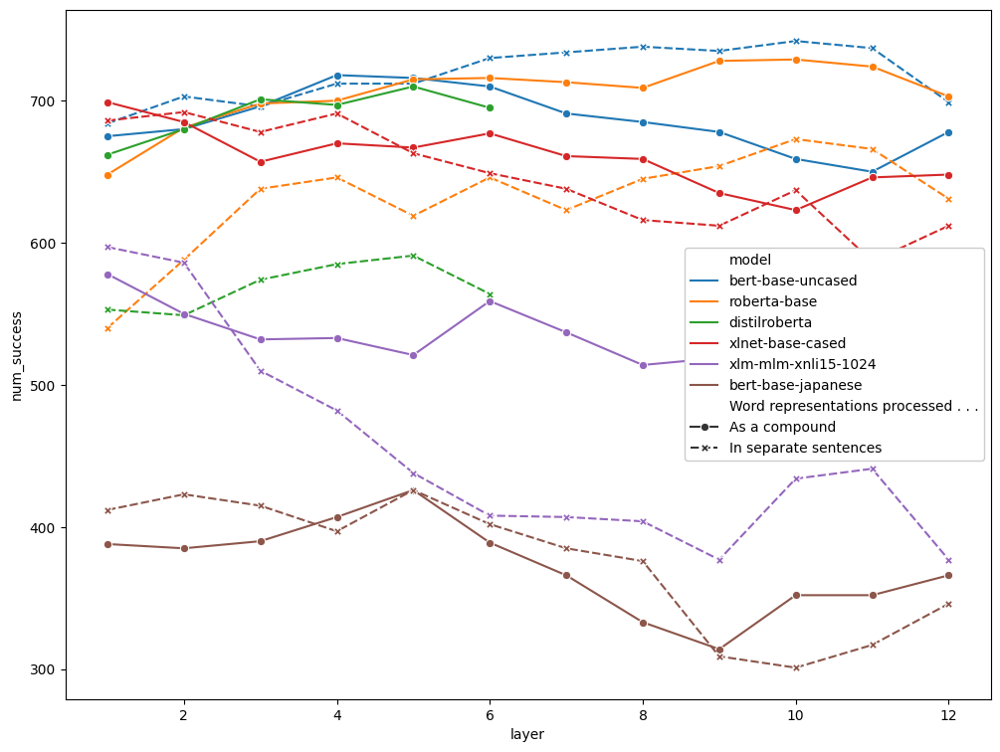

In [453]:
fig, ax = plt.subplots(figsize=(12, 9))
sns.lineplot(ax=ax, x='layer', markers=True, y='num_success', style='Word representations processed . . .', hue='model', data=df_two.sort_values(['model_order', 'Word representations processed . . .']))
leg = plt.legend(facecolor='white', framealpha=1)

In [ ]:
binom_diff_test_df

In [455]:
binom_diff_test_df = sort_df_by_model_order(binom_diff_test_df)

In [ ]:
1770 / 2

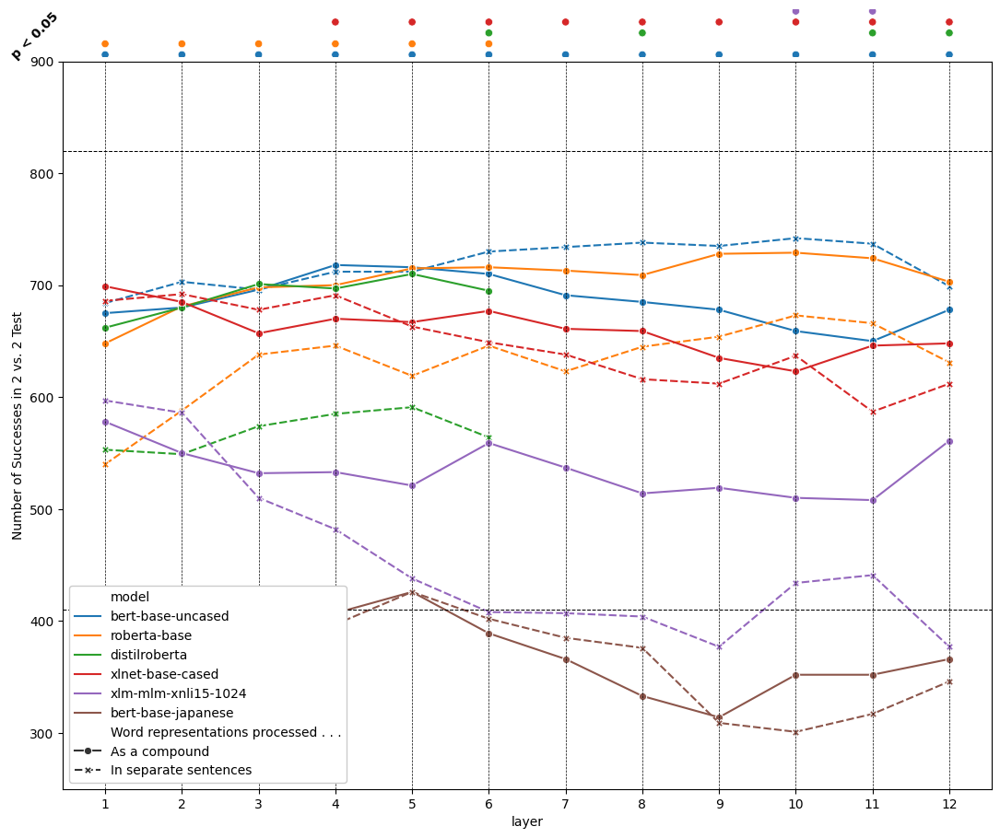

In [457]:
y_lim = (250, 900) if without_lexical_confound else (850, 1800)

fig = plt.figure(figsize=(13, 11))
grid = fig.add_gridspec(30, 1)

corr_dots_ax = fig.add_subplot(grid[:2, 0])
corr_dots_ax.axis('off')

line_plot_ax = fig.add_subplot(grid[2:, 0])

g = sns.lineplot(x='layer', markers=True, y='num_success', style='Word representations processed . . .', hue='model', data=df_two.sort_values(['model_order', 'Word representations processed . . .']), ax=line_plot_ax)
leg = line_plot_ax.legend(facecolor='white', framealpha=1, loc='lower left', bbox_to_anchor=(0, 0, 0, 0))

line_plot_ax.set_ylim(y_lim)
line_plot_ax.axhline(0, c='black', lw=1)
line_plot_ax.set_xticks(binom_diff_test_df.layer.unique());
[line_plot_ax.axvline(x, c='black', linestyle='--', lw=0.5) for x in binom_diff_test_df.layer.unique()];

p_value_data = binom_diff_test_df[(binom_diff_test_df.corrected_p < 0.05) & ~((binom_diff_test_df.model.str.contains('distil')) & (binom_diff_test_df.layer > 6))]
sns.scatterplot(y='model_order', x='layer', hue='model', data=p_value_data, ax=corr_dots_ax)
corr_dots_ax.get_legend().remove()
corr_dots_ax.text(-0.25, 0.6, 'p < 0.05', rotation=45, weight='bold')

line_plot_ax.set_ylabel('Number of Successes in 2 vs. 2 Test', rotation=90)
line_plot_ax.axhline(num_tests, c='black', lw=0.75, linestyle='--')
line_plot_ax.axhline(num_tests/2, c='black', lw=0.75, linestyle='--')

locs, labels = plt.yticks()

fig_name = 'figures/2_vs_2_compositional_test'

if without_lexical_confound:
    fig_name += 'without_lexical_confound'

# plt.savefig(fig_name + '.png', bbox_inches='tight')
# plt.savefig(fig_name + '.eps', format='eps', bbox_inches='tight')

In [ ]:
# Figure 6 alternative

In [458]:
df_two.columns

Index(['model', 'layer', 'binom_p_val', 'num_success',
       'Word representations processed . . .', 'model_order', 'model_name'],
      dtype='object')

In [460]:
df_two['% Successful Tests'] = df_two['num_success'] / num_tests

In [461]:
y_lim

(250, 900)

In [ ]:
df_two

In [ ]:
layer

In [ ]:
type(p_value_data.iloc[0].layer)

In [462]:
p_value_data[(p_value_data.model == model)]

,model,layer,p,pvalue,formatted_p,corrected_p,formatted_corrected_p,model_order,model_name
59,xlnet-base-cased,6,"BinomTestResult(k=677, n=820, alternative='gre...",0.008070,p<0.05,0.016141,p<0.05,3,XLNet
61,xlnet-base-cased,8,"BinomTestResult(k=659, n=820, alternative='gre...",0.000220,p<0.0001,0.000483,p<0.0001,3,XLNet
64,xlnet-base-cased,11,"BinomTestResult(k=646, n=820, alternative='gre...",0.000002,p<0.0001,0.000004,p<0.0001,3,XLNet
65,xlnet-base-cased,12,"BinomTestResult(k=648, n=820, alternative='gre...",0.001860,p<0.0001,0.003959,p<0.0001,3,XLNet


In [463]:
binom_diff_test_df[(binom_diff_test_df.model == model) & (binom_diff_test_df.layer == layer)]

,model,layer,p,pvalue,formatted_p,corrected_p,formatted_corrected_p,model_order,model_name
65,xlnet-base-cased,12,"BinomTestResult(k=648, n=820, alternative='gre...",0.00186,p<0.0001,0.003959,p<0.0001,3,XLNet


In [493]:
df_two

,model,layer,binom_p_val,num_success,Word representations processed . . .,model_order,model_name,% Successful Tests
12,bert-base-uncased,1,"BinomTestResult(k=675, n=820, alternative='two...",675,As a compound,0,BERT,0.823171
13,bert-base-uncased,2,"BinomTestResult(k=680, n=820, alternative='two...",680,As a compound,0,BERT,0.829268
14,bert-base-uncased,3,"BinomTestResult(k=696, n=820, alternative='two...",696,As a compound,0,BERT,0.848780
15,bert-base-uncased,4,"BinomTestResult(k=718, n=820, alternative='two...",718,As a compound,0,BERT,0.875610
16,bert-base-uncased,5,"BinomTestResult(k=716, n=820, alternative='two...",716,As a compound,0,BERT,0.873171
...,...,...,...,...,...,...,...,...
61,bert-base-japanese,8,"BinomTestResult(k=376, n=820, alternative='two...",376,In separate sentences,5,BERT-Japanese,0.458537
62,bert-base-japanese,9,"BinomTestResult(k=309, n=820, alternative='two...",309,In separate sentences,5,BERT-Japanese,0.376829
63,bert-base-japanese,10,"BinomTestResult(k=301, n=820, alternative='two...",301,In separate sentences,5,BERT-Japanese,0.367073
64,bert-base-japanese,11,"BinomTestResult(k=317, n=820, alternative='two...",317,In separate sentences,5,BERT-Japanese,0.386585


same_relation_group_rdm_corr_within_compound_sentences


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\637382351.py:67: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


0.38658536585365855
figures/2_vs_2_compositional_test_alt_without_lexical_confound_percentage


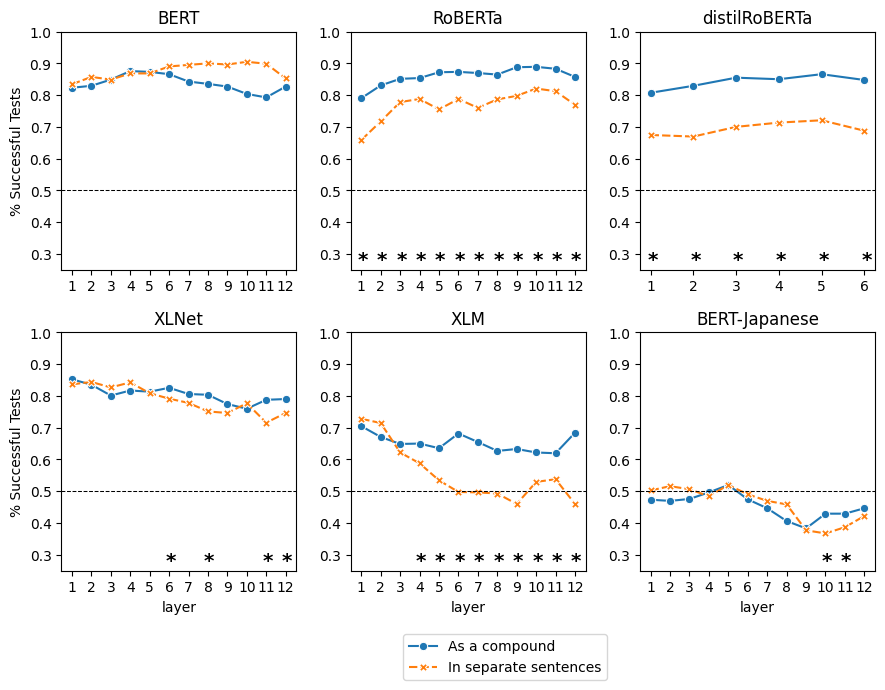

In [492]:
# Figure 7
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

print(y)
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * 3.5, fig_shape[0] * 3.5, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

df_two = sort_df_by_model_order(df_two)

for (i, model_df), (fig_y, fig_x) in zip(df_two.groupby('model_order'),product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    model = model_df.iloc[0].model
    model_name = model_df.iloc[0].model_name
    
#     y_label = 'num_success'
    y_label = '% Successful Tests'
    
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    g = sns.lineplot(data=model_df, hue='Word representations processed . . .', y=y_label, x='layer', style='Word representations processed . . .', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)

    if y_label == 'num_success':
        g.set(ylim=(y_lim))
    else:
#         g.set(ylim=(0, 1))
        g.set(ylim=(0.25, 1))
#         g.set(ylim=(0.5, 1))
    if fig_x == 0:
#         g.set_ylabel('Number of successes');
        g.set_ylabel('% Successful Tests');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(1.85, -2, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
    line_plot_ax.axhline(num_tests, c='black', lw=0.75, linestyle='--')
    line_plot_ax.axhline(num_tests/2, c='black', lw=0.75, linestyle='--')
    line_plot_ax.axhline(0, c='black', lw=0.75, linestyle='-')
    line_plot_ax.axhline(0.5, c='black', lw=0.75, linestyle='--')
    
    g.set_title(model_name);
    
    for layer in model_df.layer.unique():
        pval = binom_diff_test_df[(binom_diff_test_df.model == model) & (binom_diff_test_df.layer == layer)]['corrected_p'].iloc[0]
        x_offset =  0.075 if 'distil' in model else 0.2
        y_offset = 0.1 - 0.035
        
        if pval <= 0.05:
            y = model_df[(model_df.layer==layer)]['% Successful Tests'].min()
            plt.text(layer - x_offset, 0 - y_offset + 0.33, '*', weight='bold', size='x-large', color='black')
#             plt.text(layer - x_offset, 0 - y_offset + 0.585, '*', weight='bold', size='x-large', color='black')
    
fig.show()

fig_name = 'figures/2_vs_2_compositional_test_alt'

if without_lexical_confound:
    fig_name += '_without_lexical_confound'

print(y)
if y_label == '% Successful Tests':
    fig_name += '_percentage'

print(fig_name)

# plt.savefig(fig_name + '.png', bbox_inches='tight')
# plt.savefig(fig_name + '.eps', format='eps', bbox_inches='tight')

**Average number of letters in head word:**

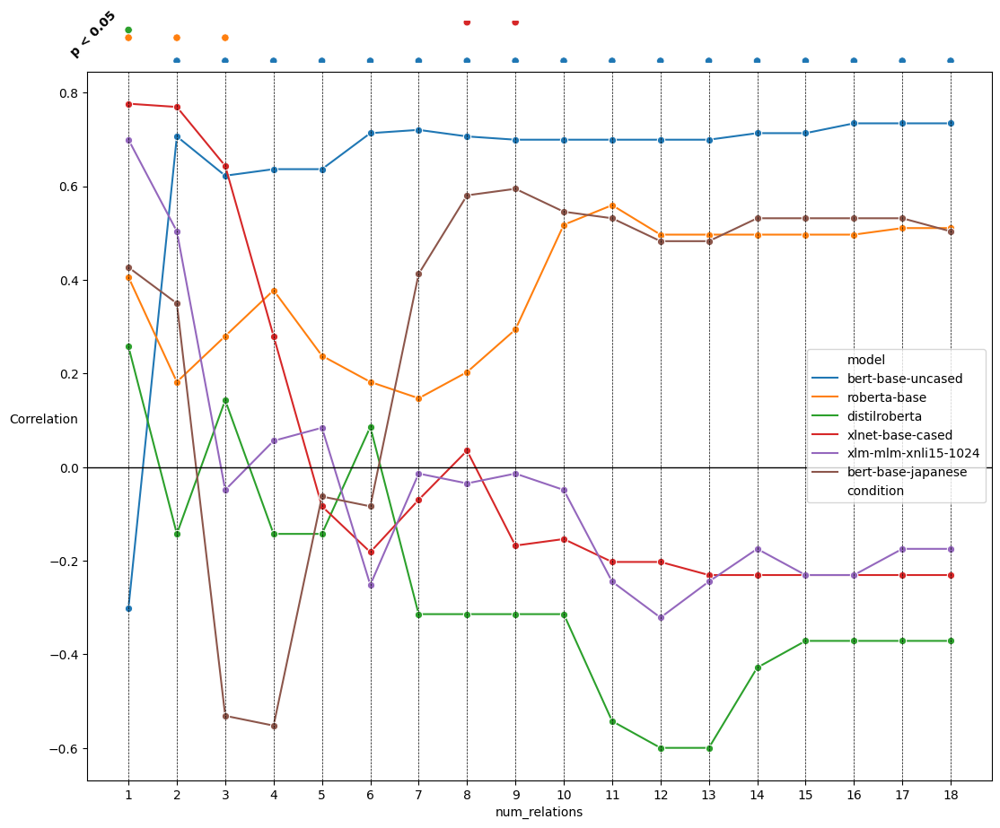

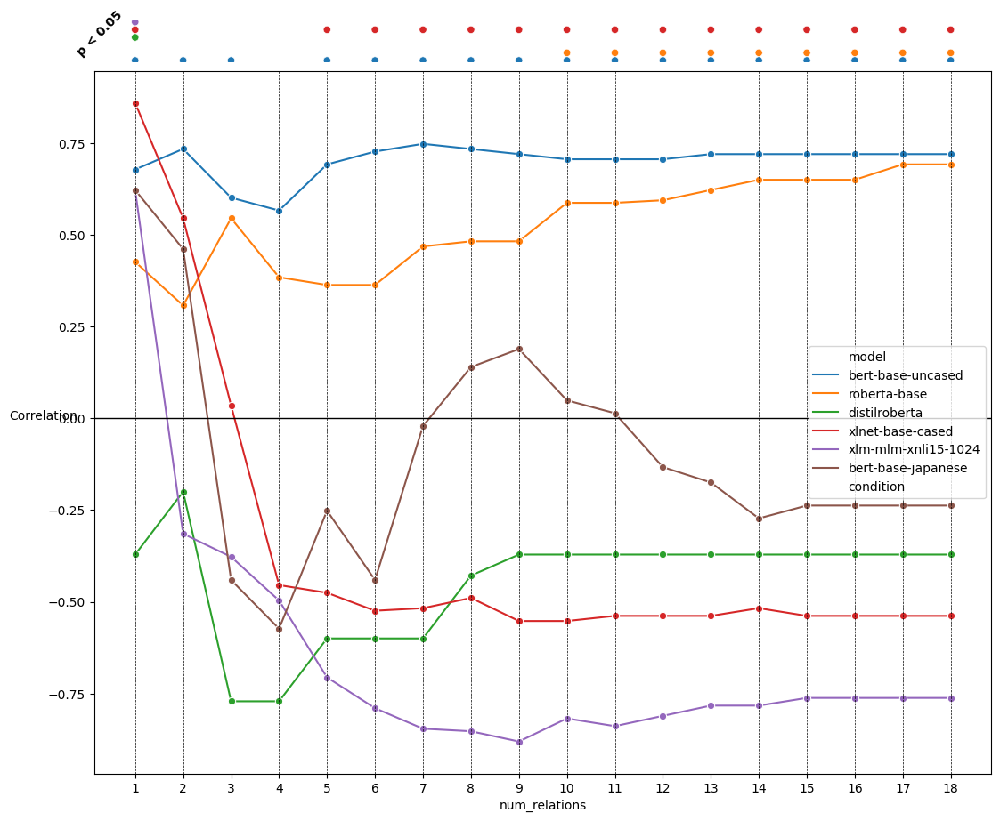

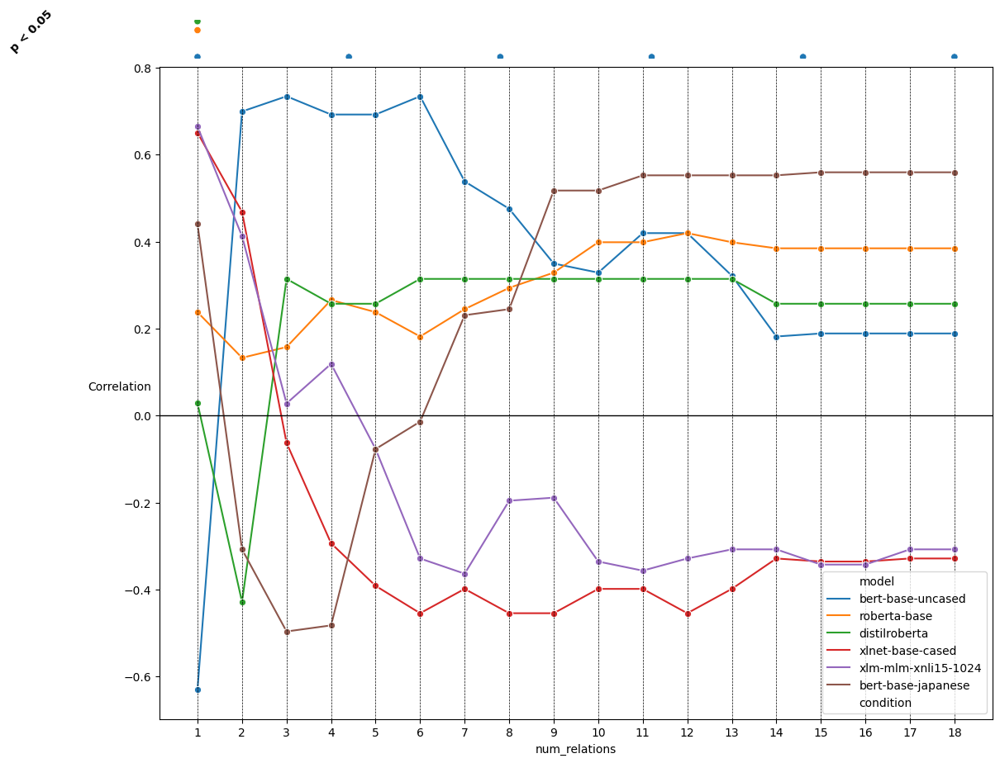

In [466]:
for rep in ['compound', 'head', 'modifier']:
    rows = []
    for (cond, num_relations), rsa_df in finegrained_results_df[(finegrained_results_df.representation == rep)].groupby(['condition', 'num_top_relations_considered']):
        c = lambda model, x: spearmanr(x, rsa_df.sort_values(['model', 'layer'])[rsa_df.sort_values(['model', 'layer']).model==model].relation_vector_corr.tolist())
        rows += [{'model': m, 'condition': cond, 'num_relations': num_relations, 'correlation': c(m, df.percentage_increase)[0], 'p': c(m, df.percentage_increase)[1]} for m, df in flat_res.groupby('model')]
    full_df = pd.DataFrame(rows)
    
    full_df = sort_df_by_model_order(full_df)
    full_df['model_order'] = [order_dict[x.model] for x in full_df.iloc]
    
    fig = plt.figure(figsize=(13, 11))
    grid = fig.add_gridspec(15, 1)

    corr_dots_ax = fig.add_subplot(grid[0, 0])
    corr_dots_ax.axis('off')

    line_plot_ax = fig.add_subplot(grid[1:, 0])
    g = sns.lineplot(data=full_df[full_df.condition=='_consider_magnitude'], hue='model', y='correlation', x='num_relations', style='condition', markers=True, ax=line_plot_ax)
    line_plot_ax.axhline(0, c='black', lw=1)
    [line_plot_ax.axvline(x, c='black', linestyle='--', lw=0.5) for x in full_df.num_relations.unique()];
    line_plot_ax.set_xticks(full_df.num_relations.unique());

    sns.scatterplot(y='model_order', x='num_relations', hue='model', data=full_df[(full_df.condition=='_consider_magnitude') & (full_df.p < 0.05)], ax=corr_dots_ax)
    corr_dots_ax.get_legend().remove()
    corr_dots_ax.text(-0.25, 0.6, 'p < 0.05', rotation=45, weight='bold')
    
    line_plot_ax.set_ylabel('Correlation between compositional test\n percentage increase and RSA\n correlation (mean-pooled {}\n vectors)'.format(rep), rotation=0, ha='right')
    line_plot_ax.set_ylabel('Correlation')

## Error Analysis

NOTE: Need to normalise by amount of relations

In [ ]:
relation_names

In [467]:
relation_vectors .sum(axis=0).shape

(18,)

In [468]:
relation_vectors.sum(axis=0)[np.argsort(relation_vectors.sum(axis=0))[::-1]]

array([337, 299, 293, 291, 285, 269, 257, 191, 189, 168, 166, 120, 115,
        90,  74,  71,  44,  37])

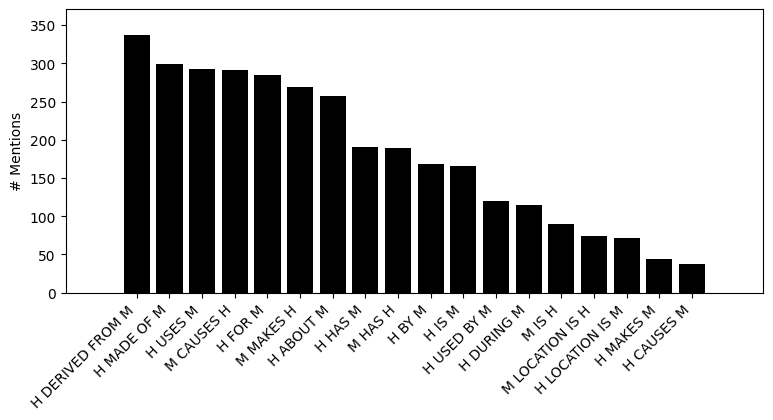

In [469]:
# distribution plot
fig, ax = plt.subplots(figsize=(9, 4.5))

chart = sns.barplot(y=relation_vectors.sum(axis=0)[np.argsort(relation_vectors.sum(axis=0))[::-1]], x=relation_names, ax=ax, color='black', saturation=0)

plt.xticks(range(len(relation_names)), np.array(relation_names)[np.argsort(relation_vectors.sum(axis=0))[::-1]], rotation=45, ha='right');
plt.margins(0.1)
plt.ylabel('# Mentions')
plt.subplots_adjust(bottom=0.25)

# plt.savefig('figures/relation_vector_distribution.png', bbox_inches='tight')
# plt.savefig('figures/relation_vector_distribution.eps', format='eps', bbox_inches='tight')

In [ ]:
np.where(compounds=='propane stove')[0][0]

In [ ]:
np.where(compounds=='gas lamp')[0][0]

In [ ]:
relation_vectors[28]

same_relation_group_rdm_corr_within_compound_sentences


C:\Users\40455223\AppData\Local\Temp\ipykernel_416\820703934.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
C:\Users\40455223\AppData\Local\Temp\ipykernel_416\820703934.py:41: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


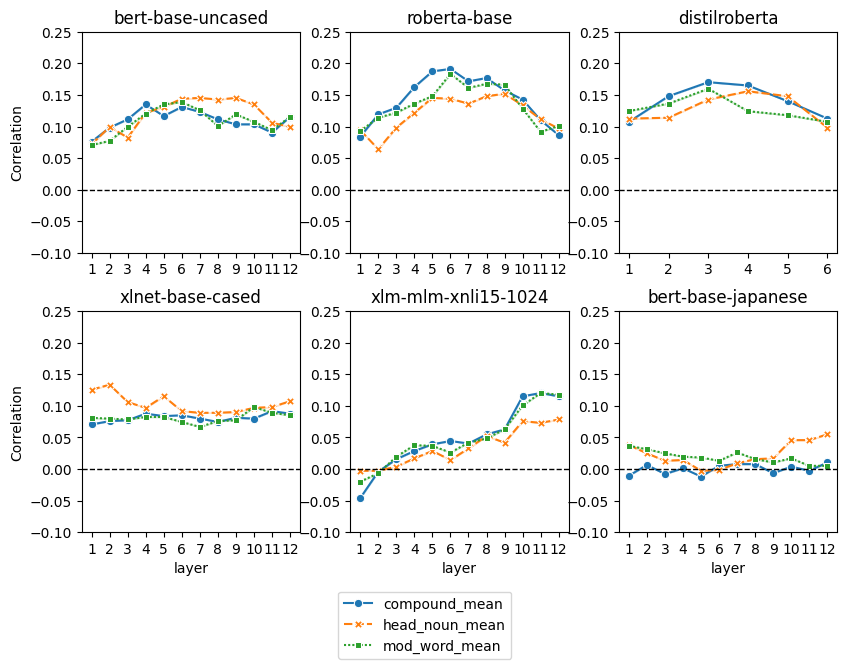

In [470]:
for y, ylim in zip(['same_relation_group_rdm_corr_within_compound_sentences'], [(-0.1, 0.25)]):
    fig_shape = (2, 3)
    fig_df = relation_results_within_compound_groups_per_word_df
    fig_df = sort_df_by_model_order(fig_df)
    
    print(y)
    single_fig_size = 4
    fig = plt.figure(figsize=(fig_shape[1] * 3.25, fig_shape[0] * 3.25, ))

    grid_height = fig_shape[0] * single_fig_size
    grid_width = fig_shape[1] * single_fig_size
    grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

    for (i, model_df), (fig_y, fig_x) in zip(fig_df.groupby('model_order'), product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
        model = model_df.iloc[0].model
        line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
        g = sns.lineplot(data=model_df, hue='representation', y=y, x='layer', style='representation', markers=True, ax=line_plot_ax);
        line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
        g.set(ylim=ylim);

        if fig_x == 0:
            g.set_ylabel('Correlation');
        else:
            g.set_ylabel('');
            
        if fig_y == 0:
            g.set_xlabel('');

        if fig_x == 0 and fig_y == 0:
            g.legend(loc='best', bbox_to_anchor=(1.5, -2, 0.5, 0.5), ncol=1);
        else:
            g.legend().remove();
            
        g.axhline(0, color='black', linestyle='--', linewidth=1)

        g.set_title(model);
    plt.tight_layout()
    fig.show()

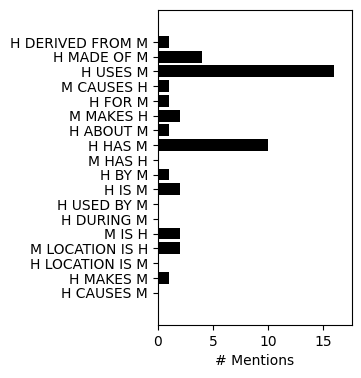

In [472]:
# distribution plot (new)

fig, ax = plt.subplots(figsize=(2.5, 5))
# grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

chart = sns.barplot(x=relation_vectors[28][np.argsort(relation_vectors.sum(axis=0))[::-1]], y=relation_names, ax=ax, color='black', saturation=0)

plt.yticks(range(len(relation_names)), np.array(relation_names)[np.argsort(relation_vectors.sum(axis=0))[::-1]], rotation=0, ha='right');
plt.margins(0.1)
plt.xlabel('# Mentions')
plt.subplots_adjust(bottom=0.25)

# plt.savefig('figures/relation_vector_distribution_propane_stove.png', bbox_inches='tight')
# plt.savefig('figures/relation_vector_distribution_propane_stove.eps', format='eps', bbox_inches='tight')

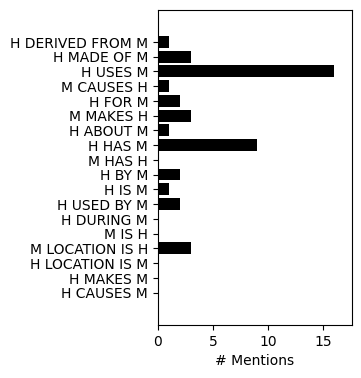

In [473]:
# distribution plot (new)

fig, ax = plt.subplots(figsize=(2.5, 5))
# grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

chart = sns.barplot(x=relation_vectors[27][np.argsort(relation_vectors.sum(axis=0))[::-1]], y=relation_names, ax=ax, color='black', saturation=0)

plt.yticks(range(len(relation_names)), np.array(relation_names)[np.argsort(relation_vectors.sum(axis=0))[::-1]], rotation=0, ha='right');
plt.margins(0.1)
plt.xlabel('# Mentions')
plt.subplots_adjust(bottom=0.25)

# plt.savefig('figures/relation_vector_distribution_gas_lamp.png', bbox_inches='tight')
# plt.savefig('figures/relation_vector_distribution_gas_lamp.eps', format='eps', bbox_inches='tight')

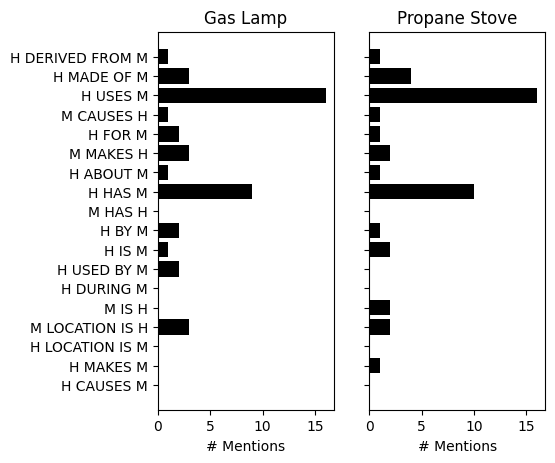

In [475]:
compound_sort = False

fig, axes2d = plt.subplots(nrows=1, ncols=2,
                           sharex=True, sharey=True,
                           figsize=(5,6))

first_axsubplot = axes2d[0]
second_axsubplot = axes2d[1]

if not compound_sort:
    sort_inds = np.argsort(relation_vectors.sum(axis=0))[::-1]
else:
    sort_inds = np.argsort(relation_vectors[27])[::-1]
    
chart = sns.barplot(x=relation_vectors[27][sort_inds], y=relation_names, ax=first_axsubplot, color='black', saturation=0)
chart = sns.barplot(x=relation_vectors[28][sort_inds], y=relation_names, ax=second_axsubplot, color='black', saturation=0)

plt.yticks(range(len(relation_names)), np.array(relation_names)[sort_inds], rotation=0, ha='right');
plt.margins(0.1)
first_axsubplot.set_xlabel('# Mentions')
second_axsubplot.set_xlabel('# Mentions')

first_axsubplot.set_title('Gas Lamp')
second_axsubplot.set_title('Propane Stove')

plt.subplots_adjust(bottom=0.25)

sort_type = 'compound_sort' if compound_sort else 'normal_sort'
# plt.savefig('figures/relation_vector_distribution_specific_examples_{}.png', bbox_inches='tight')
# plt.savefig('figures/relation_vector_distribution_specific_examples_{}.eps', format='eps', bbox_inches='tight')

In [476]:
np.argsort([np.square(x - relation_vectors[27]).sum() + np.square(x - relation_vectors[28]).sum() for x in relation_vectors])

array([28, 27, 29, 58, 59, 55, 24, 25, 57, 54, 48, 51, 22,  0,  1, 20, 49,
       23, 11, 31,  4, 10, 52, 21, 18,  9, 19, 37, 26, 34,  8, 33, 50, 43,
       39,  5, 14,  6,  7, 35, 56, 53, 38, 42, 45, 16, 13, 44, 40, 17, 32,
       41, 30, 46,  3, 12, 36, 47,  2, 15], dtype=int64)

In [477]:
[(y, compounds[y]) for y in np.argsort([np.square(x - relation_vectors[27]).sum() + np.square(x - relation_vectors[28]).sum() for x in relation_vectors])]

[(28, 'propane stove'),
 (27, 'gas lamp'),
 (29, 'wood stove'),
 (58, 'steam turbine'),
 (59, 'thermal wheel'),
 (55, 'hydrogen wheel'),
 (24, 'cable pulley'),
 (25, 'coil lock'),
 (57, 'oil treatment'),
 (54, 'electric brake'),
 (48, 'floral perfume'),
 (51, 'glass light'),
 (22, 'floral wreath'),
 (0, 'murder film'),
 (1, 'song magazine'),
 (20, 'vegetable appetizer'),
 (49, 'pumpkin sauce'),
 (23, 'olive paste'),
 (11, 'wood chisel'),
 (31, 'plastic shortage'),
 (4, 'mountain magazine'),
 (10, 'paper staples'),
 (52, 'steel equipment'),
 (21, 'chocolate shavings'),
 (18, 'grass shavings'),
 (9, 'cream churn'),
 (19, 'rain drops'),
 (37, 'gestation season'),
 (26, 'thermal torture'),
 (34, 'grain law'),
 (8, 'horse stables'),
 (33, 'economic comedy'),
 (50, 'vapor drops'),
 (43, 'tax wealth'),
 (39, 'financial remedy'),
 (5, 'sewing magazine'),
 (14, 'nose sound'),
 (6, 'breakfast sugar'),
 (7, 'Christmas wreath'),
 (35, 'plastic report'),
 (56, 'wood freshener'),
 (53, 'vapor cloud'

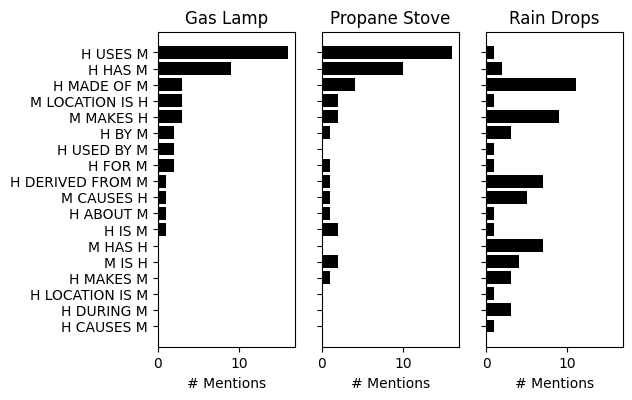

In [478]:
compound_sort = True

fig, axes2d = plt.subplots(nrows=1, ncols=3,
                           sharex=True, sharey=True,
                           figsize=(6,5))

first_axsubplot = axes2d[0]
second_axsubplot = axes2d[1]
third_axsubplot = axes2d[2]

if not compound_sort:
    sort_inds = np.argsort(relation_vectors.sum(axis=0))[::-1]
else:
    sort_inds = np.argsort(relation_vectors[27])[::-1]
    
chart = sns.barplot(x=relation_vectors[27][sort_inds], y=relation_names, ax=first_axsubplot, color='black', saturation=0)
chart = sns.barplot(x=relation_vectors[28][sort_inds], y=relation_names, ax=second_axsubplot, color='black', saturation=0)
chart = sns.barplot(x=relation_vectors[19][sort_inds], y=relation_names, ax=third_axsubplot, color='black', saturation=0)

plt.yticks(range(len(relation_names)), np.array(relation_names)[sort_inds], rotation=0, ha='right');
plt.margins(0.1)
first_axsubplot.set_xlabel('# Mentions')
second_axsubplot.set_xlabel('# Mentions')
third_axsubplot.set_xlabel('# Mentions')

first_axsubplot.set_title('Gas Lamp')
second_axsubplot.set_title('Propane Stove')
third_axsubplot.set_title('Rain Drops')

plt.subplots_adjust(bottom=0.25)

sort_type = 'compound_sort' if compound_sort else 'normal_sort'
# plt.savefig('figures/relation_vector_distribution_specific_examples_three_compounds_{}.png'.format(sort_type), bbox_inches='tight')
# plt.savefig('figures/relation_vector_distribution_specific_examples_three_compounds{}.eps'.format(sort_type), format='eps', bbox_inches='tight')

In [ ]:
# Sample relation vectors for three compounds given in the \cite{devereux_investigating_2005} dataset. \textit{"Gas Lamp"} and \textit{"Propane Stove"} are close in this 18-dimensional space, while both compounds share little overlap with \textit{"Rain Drops"}.

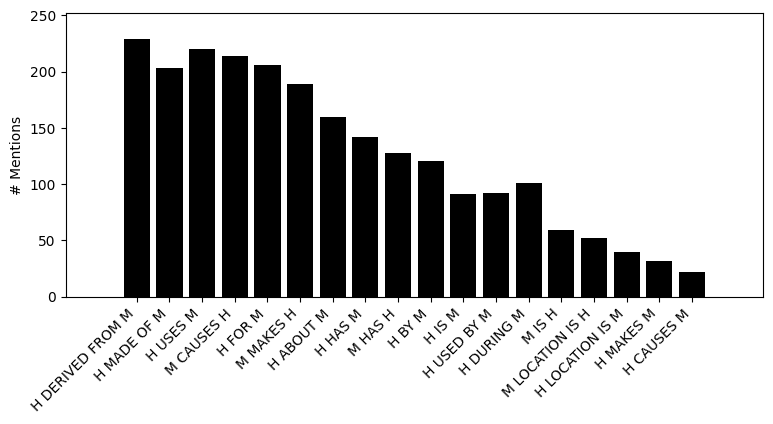

In [479]:
# distribution plot
fig, ax = plt.subplots(figsize=(9, 4.5))

# chart = sns.barplot(y=relation_vectors.sum(axis=0)[np.argsort(relation_vectors.sum(axis=0))[::-1]], x=relation_names, ax=ax, color='black', saturation=0)
chart = sns.barplot(y=reordered_relation_vectors[reordered_words_to_keep].sum(axis=0)[np.argsort(relation_vectors.sum(axis=0))[::-1]], x=relation_names, ax=ax, color='black', saturation=0)

plt.xticks(range(len(relation_names)), np.array(relation_names)[np.argsort(relation_vectors.sum(axis=0))[::-1]], rotation=45, ha='right');
plt.margins(0.1)
plt.ylabel('# Mentions')
plt.subplots_adjust(bottom=0.25)

# plt.savefig('figures/relation_vector_distribution.png', bbox_inches='tight')
# plt.savefig('figures/relation_vector_distribution.eps', format='eps', bbox_inches='tight')

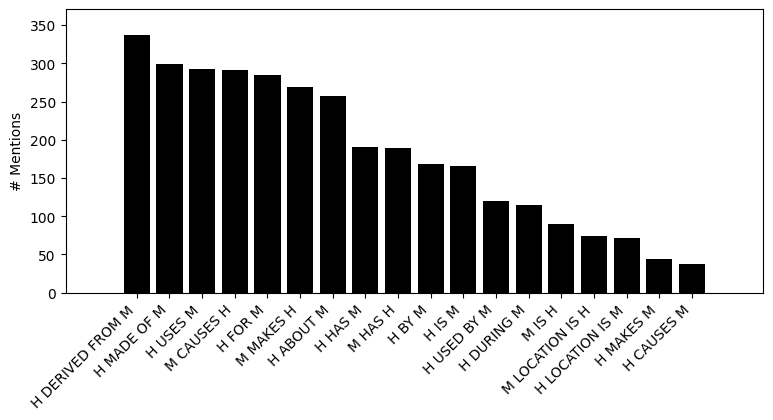

In [480]:
# distribution plot
fig, ax = plt.subplots(figsize=(9, 4.5))

chart = sns.barplot(y=relation_vectors.sum(axis=0)[np.argsort(relation_vectors.sum(axis=0))[::-1]], x=relation_names, ax=ax, color='black', saturation=0)

plt.xticks(range(len(relation_names)), np.array(relation_names)[np.argsort(relation_vectors.sum(axis=0))[::-1]], rotation=45, ha='right');
plt.margins(0.1)
plt.ylabel('# Mentions')
plt.subplots_adjust(bottom=0.25)

# plt.savefig('figures/relation_vector_distribution.png', bbox_inches='tight')
# plt.savefig('figures/relation_vector_distribution.eps', format='eps', bbox_inches='tight')

In [481]:
reordered_relation_vectors = reordered_relation_vectors_dict['18_consider_magnitude']

In [482]:
reordered_relation_vectors.shape, reordered_relation_vectors.sum(axis=0), reordered_relation_vectors.sum(axis=0).shape

((60, 18),
 array([ 37, 291, 191, 189, 299,  44, 285, 166, 293,  71,  74, 257, 115,
        120, 337, 168, 269,  90]),
 (18,))

# HERE

Prediction dict is empty

In [487]:
prediction_dict

{}

In [494]:
rows = []

for model in model_names:
    for layer in range(1, 13):
        if 'distil' in model and layer > 6:
            continue
        predictions = prediction_dict['{}_{}'.format(model, layer)]
        squared_errors_per_relation = ((predictions - reordered_relation_vectors)**2).sum(axis=0) / reordered_relation_vectors.sum(axis=0)
        
        for relation_name, error in zip(relation_names, squared_errors_per_relation):
            rows.append({'model': model, 'layer': layer, 'relation': relation_name, 'error': error})
            
error_df = pd.DataFrame(rows)

KeyError: 'roberta-base_1'

In [ ]:
error_df['scaled_error'] = error_df.error / error_df.error.max()
error_df

In [ ]:
spearmanr(error_df.layer.tolist(), error_df.scaled_error.tolist())

In [ ]:
g = sns.catplot(kind='bar', x='relation', y='scaled_error', hue='layer', data=error_df, height=8, aspect=2.35)
g.axes[0][0].set_xticklabels(g.axes[0][0].get_xticklabels(), rotation=45, horizontalalignment='right');
g.axes[0][0].set_ylabel('Scaled sum of squared error')

In [ ]:
g.axes[0]

In [ ]:
g = sns.catplot(kind='bar', x='relation', y='scaled_error', ci=None, hue='layer', data=error_df, height=8, aspect=2.35)
g.axes[0][0].set_xticklabels(g.axes[0][0].get_xticklabels(), rotation=45, horizontalalignment='right');
g.axes[0][0].set_ylabel('Scaled sum of squared error')

In [ ]:
# Paper Error Table
rows = []

for model in model_names:
    for layer in range(1, 13):
        if 'distil' in model and layer > 6:
            continue
        predictions = prediction_dict['{}_{}'.format(model, layer)]
        squared_errors_per_relation = ((predictions - reordered_relation_vectors)**2).sum(axis=0) / reordered_relation_vectors.sum(axis=0)
        
        for relation_name, error in zip(relation_names, squared_errors_per_relation):
            rows.append({'model': model, 'layer': layer, 'relation': relation_name, 'error': error})
            
new_error_df = pd.DataFrame(rows)

In [ ]:
rows = []
for (relation, model), df in new_error_df.groupby(['relation', 'model']):
    res = spearmanr(df.layer, df.error)
    rows.append({'model': model, 'relation': relation, 'correlation': res[0], 'p': res[1]})

df = pd.DataFrame(rows)
df['corr_format'] = ['{0:.2} (p={1:.2})'.format(x.correlation, x.p) if x.p < 0.05 else '{0:.2}'.format(x.correlation) for x in df.iloc]
# df['corr_format'] = ['{0:.2} (p={1:.2})'.format(x.correlation, x.p) for x in df.iloc]
df.pivot('model', 'relation', 'corr_format')

In [ ]:
rows = []
for model_1, df_1 in df.groupby('model'):
    for model_2, df_2 in df.groupby('model'):
        agreement = pearsonr(df_1.correlation, df_2.correlation)[0]
        rows.append({'m1': model_1, 'm2': model_2, 'agreement': agreement})

In [ ]:
pearsonr(df_1.correlation, df_2.correlation)[0]

In [ ]:
(df_1.correlation >= 0).to_numpy()
[1 if x else 0 for x in (df_2.correlation >= 0).to_numpy()]

In [ ]:
df[df.model.str.contains('xlm')]

In [ ]:
df[df.model.str.contains('xlm')]

In [ ]:
pd.DataFrame(rows).pivot_table(index='m1', columns='m2', values='agreement')

In [ ]:
(df_2.correlation >= 0).to_numpy()

In [ ]:
(df_1.correlation >= 0).to_numpy()

In [ ]:
sum((df_1.correlation >= 0).to_numpy() == (df_2.correlation >= 0).to_numpy()) / 18

In [ ]:
df[(df.correlation > 0)].groupby('model').count().correlation

In [ ]:
df[df.p < 0.05].groupby('relation').correlation.sum().sort_values()

In [ ]:
fig, ax = plt.subplots(figsize=(12, 12))
barplot_df = data=df[df.p < 0.05].groupby('relation').correlation.mean().sort_values().reset_index()
g = sns.barplot(data=barplot_df, x='relation', y='correlation')
[x.set_rotation(45) for x in g.axes.get_xticklabels()];

In [ ]:
df

In [ ]:
df

In [ ]:
# Error analysis plot

fig, ax = plt.subplots(figsize=(12, 12))
# barplot_df = data=df[df.p < 0.05].groupby(['model', 'relation']).correlation.mean().sort_values().reset_index()
barplot_df = data=df.groupby(['model', 'relation']).correlation.mean().sort_values().reset_index()
g = sns.barplot(data=barplot_df, x='relation', hue='model', y='correlation')
[x.set_rotation(45) for x in g.axes.get_xticklabels()];

In [ ]:
pivot = barplot_df.pivot('model', 'relation')
pivot.columns = [x[-1] for x in pivot.columns]

In [ ]:
rows = []
for model_a, rows_a in barplot_df.groupby('model'):
    correlations_a = rows_a.correlation.to_list()
    for model_b, rows_b in barplot_df.groupby('model'):
        correlations_b = rows_b.correlation.to_list()
        rows.append({'model_a': model_a, 'model_b': model_b, 'correlation': spearmanr(correlations_a, correlations_b)[0]})
        
rows_df = pd.DataFrame(rows)
rows_df

In [ ]:
rows_df.pivot('model_a', 'model_b')

In [ ]:
pearsonr(correlations_a, correlations_b)[0]

In [ ]:
pivot.reset_index()

In [ ]:
fig_shape = (3, 6)

fig_df = barplot_df.copy()
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * single_fig_size, fig_shape[0] * single_fig_size, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=1.5)

for (model, model_df), (fig_y, fig_x) in zip(fig_df.groupby('relation'), 
                                             product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    
    g = sns.barplot(data=model_df, hue='model', y='correlation', x='model', ax=line_plot_ax);
#     line_plot_ax.set_xticks(model_df.relation.unique());
#         g.set(ylim=)
    g.set(ylim=(1, -1));

    if fig_x == 0:
        g.set_ylabel('Correlation');
    else:
        g.set_ylabel('');

    if fig_y != 2:
        plt.tick_params(
            axis='x',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            bottom=False,      # ticks along the bottom edge are off
            top=False,         # ticks along the top edge are off
            labelbottom=False)

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(7.25, -.5, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
    g.axhline(0, color='black')

    g.set_title(model);
    
    plt.xticks(rotation=90
              )
    
fig.show()

# plt.savefig('figures/error_plot_analysis.png')
# plt.savefig('figures/error_plot_analysis.eps', format='eps')

In [ ]:
# fig, ax = plt.subplots(figsize=(10, 6))
# g = sns.barplot(x='relation', y='scaled_error', data=error_df)
# g.axes.set_xticklabels(g.axes.get_xticklabels(), rotation=45, horizontalalignment='right');


In [ ]:
indices_by_decodability = np.argsort(np.array([cosine_similarity(x[0].reshape(1, -1), x[1].reshape(1, -1)) for x in zip(predictions, reordered_relation_vectors)]).squeeze())[::-1]

In [ ]:
reorder_indices = reordered_compound_indices['{}{}'.format(num_top_relations, condition)]
reordered_sentences = finegrained_nn_sentences[reorder_indices]
reordered_compounds  = compounds[reorder_indices]

In [ ]:
# From lowest to highest cosine sim
sentences_by_decodability = reordered_sentences[indices_by_decodability]
sentences_by_decodability

In [ ]:
data_count_df = pd.DataFrame([{'relation': x[0], 'count':x[1]} for x in zip(relation_names, reordered_relation_vectors.sum(axis=0))])

fig, ax = plt.subplots(figsize=(12, 7))
g = sns.barplot(x='relation', y='count', data=data_count_df, ax=ax)
g.axes.set_xticklabels(g.axes.get_xticklabels(), rotation=45, horizontalalignment='right');


In [ ]:
[(x,i) for i,x in enumerate(relation_names) if 'LOCATION' in x]

In [ ]:
reordered_sentences[reordered_relation_vectors[:, 9].argsort()[-1]]

In [ ]:
reordered_sentences[reordered_relation_vectors[:, 10].argsort()[-3]]

In [ ]:
# fig, ax = plt.subplots(figsize=(10, 6))
# g = sns.barplot(x='relation', y='scaled_error', data=error_df)
# g.axes.set_xticklabels(g.axes.get_xticklabels(), rotation=45, horizontalalignment='right');

# ax2 = g.axes.twinx()
# g2 = sns.scatterplot(x='relation', y='count', data=data_count_df, ax=ax2, color='red')
# ax.xaxis.grid(True) # Show the vertical gridlines

In [485]:
all_preds = np.zeros_like(reordered_relation_vectors, dtype=np.float64)
for key in prediction_dict.keys():
    all_preds += prediction_dict[key]
    
all_preds /= len(prediction_dict.keys())

C:\Users\40455223\AppData\Local\Temp\ipykernel_416\2197640951.py:5: RuntimeWarning: invalid value encountered in divide
  all_preds /= len(prediction_dict.keys())


In [ ]:
pred_diff = reordered_relation_vectors - all_preds

In [ ]:
np.argwhere(np.array(relation_names) == 'H CAUSES M')

In [ ]:
pred_diff[:, 0].mean() # H CAUSES M: over prediction


In [ ]:
list(zip(relation_names, (reordered_relation_vectors - all_preds).mean(axis=0)))

In [ ]:
reordered_relation_vectors / (reordered_relation_vectors - all_preds).mean()

In [ ]:
# error_df.groupby(['relation']).scaled_error.mean()

In [ ]:
rows = []
for (model, layer), df in error_df.groupby(['model', 'layer']):
    res = spearmanr(data_count_df['count'].tolist(), df.scaled_error.tolist())
    rows.append({'model': model, 'layer': layer, 'error_count_corr': res[0], 'error_count_corr_p_val': res[-1]})
    
error_corr_df = pd.DataFrame(rows)

## Qualitative Analysis of Errors

In [ ]:
finegrained_nn_sentences

In [ ]:
reordered_relation_vectors

In [ ]:
rep_names = []

for model in model_names:
    for layer in range(1, 13):
        if 'distil' in model and layer > 6:
            continue
        rep_names.append('{}_{}'.format(model, layer))

rep_names = np.array(rep_names)

In [ ]:
prediction_tensor = np.zeros((60, 66, 18))

for rep_i, rep_name in enumerate(rep_names):
    reordered_predictions = prediction_dict[rep_name]
    for i, vec in enumerate(reordered_predictions):
        prediction_tensor[i, rep_i] = vec

In [ ]:
prediction_tensor.shape

In [ ]:
from sklearn.cluster import dbscan

In [ ]:
eps_range = list(np.arange(0.06, 0.1, 0.001)); eps_range

In [ ]:
reordered_compounds[reordered_words_to_keep]

In [ ]:
prediction_tensor.shape

In [ ]:
res[-1]

In [ ]:
sorted(reordered_compounds[reordered_words_to_keep])

In [ ]:
9 in [reordered_words_to_keep]

In [ ]:
rows = []
for eps in eps_range:
    for i in [x for x in range(60) if x in reordered_words_to_keep]:
        
        cluster_res = dbscan(prediction_tensor[i], eps=eps, metric='cosine')
        num_noisey = (cluster_res[-1] == -1).sum()
        num_clusters = len(set(cluster_res[-1]))

        rows.append({'eps': eps, 'i': i, 'num_noisey': num_noisey, 'num_clusters': num_clusters})
cluster_df = pd.DataFrame(rows)

In [ ]:
list(zip(cluster_df.eps.unique(), cluster_df.groupby('eps').num_noisey.mean(), cluster_df.groupby('eps').num_clusters.mean()))

In [ ]:
clusters_per_sent = np.zeros((60, 66))

for i in range(60):
    clusters_per_sent[i] = dbscan(prediction_tensor[i], eps=0.049, metric='cosine')[-1]



In [ ]:
np.array([10, 20, 15])[np.array([10, 20, 15]).argsort()]

In [ ]:
clusters_per_sent

In [ ]:
sum([np.all(x==0) for x in prediction_tensor[:, 0, :]])

In [ ]:
cluster_analysis_rows = []

for sent_i in range(60):
    
    if np.all(prediction_tensor[sent_i, 0, :] == 0):
        continue
    
    # Initial setup
    num_clusters = len([x for x in np.unique(clusters_per_sent[sent_i]) if x != -1])
    average_pred_per_cluster = np.zeros((num_clusters, 18))
    dist_per_cluster = np.zeros((num_clusters))
    rep_inds_per_cluster = []
    
    print(sent_i)
    # Clustering
    for cluster_id in np.unique(clusters_per_sent[sent_i].astype(int)):
        if cluster_id == -1:
            continue
        cluster_inds = np.where(clusters_per_sent[sent_i] == cluster_id)
        cluster_predictions = prediction_tensor[sent_i, cluster_inds, :]
        average_pred_per_cluster[cluster_id] = cluster_predictions.mean(axis=1)
        dist_per_cluster[cluster_id] = np.sqrt(np.sum(np.square(average_pred_per_cluster[cluster_id].reshape(1, -1) - reordered_relation_vectors[sent_i].reshape(1, -1))))
        rep_inds_per_cluster.append(cluster_inds)

    # Ground truth details
    relation_sort_inds = reordered_relation_vectors[sent_i].argsort()[::-1]

    compound = compounds[reorder_indices][sent_i]
    ground_truth_top_relations = list(zip(np.array(relation_names)[relation_sort_inds], reordered_relation_vectors[sent_i][relation_sort_inds]))[:3]

    # Worst/best cluster pred details
    cluster_inds_best_to_worst = dist_per_cluster.argsort()
    
    if len(cluster_inds_best_to_worst) > 0:
        worst_cluster_ind = cluster_inds_best_to_worst[-1]
        worst_cluster_cosine_sim = dist_per_cluster[worst_cluster_ind]
        worst_preds = average_pred_per_cluster[worst_cluster_ind]
        worst_relation_sort_inds = average_pred_per_cluster[worst_cluster_ind].argsort()[::-1]
        worst_cluster_predictions = list(zip(np.array(relation_names)[worst_relation_sort_inds], np.around(average_pred_per_cluster[worst_cluster_ind][worst_relation_sort_inds], 1)))[:3]
        worst_cluster_models = rep_names[rep_inds_per_cluster[worst_cluster_ind]]

        best_cluster_ind = cluster_inds_best_to_worst[0]
        best_cluster_cosine_sim = dist_per_cluster[best_cluster_ind]
        best_preds = average_pred_per_cluster[best_cluster_ind]
        best_relation_sort_inds = average_pred_per_cluster[best_cluster_ind].argsort()[::-1]
        best_cluster_predictions = list(zip(np.array(relation_names)[best_relation_sort_inds], np.around(average_pred_per_cluster[best_cluster_ind][best_relation_sort_inds], 1)))[:3]
        best_cluster_models = rep_names[rep_inds_per_cluster[best_cluster_ind]]

        cluster_analysis_rows.append({'sent_i': sent_i, 'compound': compound, 'ground_truth_top_relations': ground_truth_top_relations, 'num_clusters': num_clusters,
                                  'worst_cluster_id': worst_cluster_ind, 'worst_cluster_dist': worst_cluster_cosine_sim,
                                  'worst_cluster_predictions': worst_cluster_predictions, 'worst_cluster_models': worst_cluster_models,
                                  'best_cluster_id': best_cluster_ind, 'best_cluster_dist': best_cluster_cosine_sim, 
                                  'best_cluster_predictions': best_cluster_predictions, 'best_cluster_models': best_cluster_models})

cluster_analysis_df = pd.DataFrame(cluster_analysis_rows)
cluster_analysis_df.to_csv('../data/results/cluster_analysis_results.csv')

In [ ]:
import re

In [ ]:
shorthand_models = [''.join([y[0] for y in re.split('-|_', x)[:-1]]) + '_' + x.split('_')[-1] for x in ['bert-base-uncased']]


In [ ]:
import re
from itertools import groupby
from more_itertools import consecutive_groups

def format_model_string(model_str):
    shorthand_models = [''.join([y[0] for y in re.split('-|_', x)[:-1]]) + '_' + x.split('_')[-1] for x in model_str]
    
    formatted_strings = []

    for model, model_layers in groupby(sorted(shorthand_models), lambda x: x.split('_')[0]):
        model_layers = sorted([int(y.split('_')[-1]) for y in model_layers])
        model_layer_groups = [list(group) for group in consecutive_groups(model_layers)]

        layer_ranges = []
        for group in model_layer_groups:
            if len(group) == 1:
                layer_ranges.append(group[0])
            else:
                layer_ranges.append("{}-{}".format(group[0], group[-1]))

        formatted_strings.append('{}{}'.format(model, layer_ranges).upper().replace('"', ''))
        
    return formatted_strings

In [ ]:
def format_top_relations(relation_str_list):
    raw_list = [re.split('\(|\)', str(x))[1:-1] for x in relation_str_list]
    return str(["{} ({})".format(x[0].replace("'", '').split(', ')[0], x[0].replace("'", '').split(', ')[-1]) for x in raw_list]).replace("'", '').upper().replace('[', '').replace(']', '').replace(',', ';\n')

In [ ]:
model_names

In [ ]:
print(cluster_analysis_df.worst_cluster_dist.min())
print(cluster_analysis_df.worst_cluster_dist.max())
print(cluster_analysis_df.worst_cluster_dist.mean())

In [ ]:
print(cluster_analysis_df.best_cluster_dist.min())
print(cluster_analysis_df.best_cluster_dist.max())
print(cluster_analysis_df.best_cluster_dist.mean())

In [ ]:
cluster_analysis_df.num_clusters.mean()

In [ ]:
cluster_analysis_df[cluster_analysis_df.compound=='cream churn']

In [ ]:
prediction_dict['roberta-base_1'].shape

In [ ]:
sort_col = 'best_cluster_dist'
sort_worst_to_best = True
show_other_cols = False

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

res_df = cluster_analysis_df.copy()

res_df['worst_cluster_models'] = [str(format_model_string(x)).replace(',', ';')[1:-1].replace("'", '') for x in res_df.worst_cluster_models]
res_df['best_cluster_models'] = [str(format_model_string(x)).replace(',', ';')[1:-1].replace('"', '').replace("'", '') for x in res_df.best_cluster_models]
res_df['ground_truth_top_relations'] = [format_top_relations(x) for x in res_df.ground_truth_top_relations]
res_df['worst_cluster_predictions'] = [format_top_relations(x) for x in res_df.worst_cluster_predictions]
res_df['best_cluster_predictions'] = [format_top_relations(x) for x in res_df.best_cluster_predictions]

del res_df['worst_cluster_id']
del res_df['best_cluster_id']
del res_df['sent_i']
del res_df['num_clusters']

# res_df = res_df[res_df.num_clusters > 1].sort_values(sort_col, ascending= not sort_worst_to_best)
res_df = res_df.sort_values(sort_col, ascending= not sort_worst_to_best)

if not show_other_cols:
    to_delete = [x for x in res_df.columns if 'worst' in x] if 'best' in sort_col else [x for x in res_df.columns if 'best' in x]
    for col in to_delete:
        del res_df[col]

res_df.iloc[:10].style.hide_index()

In [ ]:
compounds[words_to_skip]

In [ ]:
res_df

In [ ]:
""

In [ ]:
print(res_df.iloc[:5].round(2).to_latex(index=False))

In [ ]:
# res_df = cluster_analysis_df
# del res_df['worst_cluster_id']
# del res_df['best_cluster_id']
# res_df = res_df[res_df.num_clusters > 1].sort_values('best_cluster_cosine_sim', ascending=True)
# res_df.iloc[:5]

In [ ]:
cluster_analysis_df.to_csv('../data/noun_noun_compounds/cluster_analysis.csv', sep='\t')

In [ ]:
# del cluster_analysis_df['worst_cluster_id']
# del cluster_analysis_df['best_cluster_id']

In [ ]:
for row in cluster_analysis_df.iloc:
    print(row.compound)

In [ ]:
compounds[reorder_indices] 

In [ ]:
reordered_relation_vectors[sent_i]

In [ ]:
relation_sort_inds = reordered_relation_vectors[sent_i].argsort()[::-1]
list(zip(np.array(relation_names)[relation_sort_inds], reordered_relation_vectors[sent_i][relation_sort_inds]))[:3]

In [ ]:
# cosine_sim_per_cluster

## Correlation between how often a relation is mentioned and a model's error on that relation category

In [ ]:
sns.barplot(data=error_corr_df, y='error_count_corr', x='layer', hue='model')

In [ ]:
fig, ax = plt.subplots(figsize=(12, 8))
g = sns.lineplot(hue='model', y='error_count_corr', x='layer',data=error_corr_df, ax=ax)
g.axhline(0, color='black')

# Head vs. Modifier

In [ ]:
open('../data/noun_noun_compounds/composition/probe_words_and_sentences.txt').read().split('\n')[:5]

In [ ]:
reordered_reps.shape

In [ ]:
reps.shape

In [ ]:

# if representation == 'whole_sentence':
#     rdm = rsa_utils.get_rdm(reps[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])
# elif representation == 'compound':
#     rdm = rsa_utils.get_rdm(reps.mean(axis=1)[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])
# elif representation == 'head':
#     rdm = rsa_utils.get_rdm(reps[:, 1, :][reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])
# elif representation == 'modifier':
#     rdm = rsa_utils.get_rdm(reps[:, 0, :][reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)] , :])

In [ ]:
reps.shape

In [ ]:
reps.mean(axis=1).shape

In [ ]:

#                 word_reps = reps.mean(axis=1)

#             reordered_reps = word_reps[reordered_compound_indices['{}{}'.format(num_top_relations, condition)]]

#             reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]


reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

binom_p_val, num_success, predictions = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=True)

In [ ]:
# back down here

In [ ]:
sentences[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]]

In [ ]:
sentences[reordered_compound_indices['{}{}'.format(num_top_relations, condition)]]

In [ ]:
len(reordered_words_to_keep)

In [ ]:
# Experiment 4: data
# Figure 7 data

load = False

if load:
    finegrained_head_mod_binom_results_lin_reg_df_with_context = pd.read_csv('../data/results/finegrained_head_mod_binom_results_lin_reg_with_context.csv')
    finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf = pd.read_csv('../data/results/finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf.csv')
else:
    rows = []
    rows_without_lexical_confound = []

    num_top_relations = 18
    condition = '_consider_magnitude'

    prediction_dict_head_mod = {}

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 13)):
            for representation in ['head', 'modifier', 'compound']:
                if layer > 6 and 'distil' in model_name:
                    continue
                    
                reps = np.load('../data/representations/{}/layer_{}/noun_noun_compounds/{}_layer_{}_noun_noun_compounds.npy'.format(model_name.split('-')[0], layer, model_name, layer))

                if representation == 'head':
                    word_reps = reps[:, 1, :]
                elif representation == 'modifier':
                    word_reps = reps[:,  0, :]
                elif representation == 'compound':
                    word_reps = reps.mean(axis=1)
                
                reordered_reps = word_reps[reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]]

                reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

                binom_p_val, num_success = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=False)

#                 prediction_dict_head_mod['{}_{}_{}'.format(model_name, layer, representation)] = predictions

                rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success, 'representation': representation})

                binom_p_val, num_success = two_vs_two_lin_reg_test_filter(reordered_reps, reordered_relation_vectors, inds_to_keep=reordered_words_to_keep, 
                                                                               save_predictions=False)
                rows_without_lexical_confound.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success, 'representation': representation})
    

    finegrained_head_mod_binom_results_lin_reg_df_with_context = pd.DataFrame(rows)
    finegrained_head_mod_binom_results_lin_reg_df_with_context.to_csv('../data/results/finegrained_head_mod_binom_results_lin_reg_with_context.csv')

    finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf = pd.DataFrame(rows_without_lexical_confound)
    finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf.to_csv('../data/results/finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf.csv')

In [ ]:
finegrained_head_mod_binom_results_lin_reg_df_with_context

In [ ]:
reps.shape
word_reps = reps[np.where(np.arange(reps.shape[0]) % 2 == 0)]                                   
word_reps.shape

In [ ]:
            reps = np.load('../data/representations/{}/layer_{}/compositional_analysis/{}_layer_{}_compositional_analysis.npy'.format(model_name.split('-')[0], layer, model_name, layer))
reps.shape

In [ ]:
mod_reps = reps[np.where(np.arange(reps.shape[0]) % 2 == 1)]                                   
head_reps = reps[np.where(np.arange(reps.shape[0]) % 2 == 1)] 

In [ ]:
np.dstack((mod_reps, head_reps)).mean(axis=-1).shape

In [ ]:
word_reps.shape

In [ ]:
reordered_reps.shape

In [ ]:
reps.shape

In [ ]:
reps.shape

In [ ]:
word_reps.shape

In [ ]:
reps.shape

In [ ]:
reps.shape

In [ ]:
reps.shape

In [ ]:
np.dstack((head_reps, mod_reps)).mean(axis=-1).shape

In [ ]:
reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]

In [ ]:
# reps = np.load('../data/representations/{}/layer_{}/compositional_analysis/{}_layer_{}_compositional_analysis.npy'.format(model_name.split('-')[0], layer, model_name, layer))
# reps = np.mean(np.dstack([reps[np.where(np.arange(reps.shape[0]) % 2 == 0)], reps[np.where(np.arange(reps.shape[0]) % 2 == 1)]]), axis=-1)                                             
# reordered_reps = reps[reordered_compound_indices['{}{}'.format(num_top_relations, condition)]]

# reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

# binom_p_val, num_success, predictions = two_vs_two_lin_reg_test_filter(reordered_reps, reordered_relation_vectors, inds_to_keep=reordered_words_to_keep, 
#                                                                        save_predictions=True)

# prediction_dict['{}_{}'.format(model_name, layer)] = predictions

# rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success})


In [ ]:
load = False

if load:
    finegrained_head_mod_binom_results_lin_reg_df = pd.read_csv('../data/results/finegrained_head_mod_binom_results_lin_reg.csv')
    finegrained_head_mod_binom_results_lin_reg_without_lex_conf = pd.read_csv('../data/results/finegrained_head_mod_binom_results_lin_reg_without_lex_conf.csv')
else:
    rows = []
    rows_without_lexical_confound = []

    num_top_relations = 18
    condition = '_consider_magnitude'

    prediction_dict_head_mod = {}

    for model_name in model_names:
        print(model_name)
        for layer in tqdm.tqdm(range(1, 13)):
            if layer > 6 and 'distil' in model_name:
                continue
            reps = np.load('../data/composition_300/representations/{}/layer_{}/compositional_analysis/{}_layer_{}_compositional_analysis.npy'.format(model_name.split('-')[0], layer, model_name, layer))
            
            order = reordered_orig_indices_per_top_relations['{}{}'.format(num_top_relations, condition)]
            head_reps = reps[[x for x in range(600) if x % 2 == 0], :][order]
            mod_reps = reps[[x for x in range(600) if x % 2 == 1], :][order]
            compound_reps = np.dstack((head_reps, mod_reps)).mean(axis=-1)
            
            reordered_relation_vectors = reordered_relation_vectors_dict['{}{}'.format(num_top_relations, condition)]

#             binom_p_val, num_success, predictions = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=True)
            # mod is where i == 0, head where i == 1
            for rep in ['modifier', 'head', 'compound']:
                if rep == 'modifier':
                    reordered_reps = mod_reps                             
                if rep == 'head':
                    reordered_reps = head_reps                             
                if rep == 'compound':                           
                    reordered_reps = compound_reps
                    
                binom_p_val, num_success, predictions = two_vs_two_lin_reg_test(reordered_reps, reordered_relation_vectors, save_predictions=True)

#                 prediction_dict_head_mod['{}_{}_{}'.format(model_name, layer, rep)] = predictions

                rows.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success, 'representation': rep})

                binom_p_val, num_success = two_vs_two_lin_reg_test_filter(reordered_reps, reordered_relation_vectors, inds_to_keep=reordered_words_to_keep, 
                                                                               save_predictions=False)
                rows_without_lexical_confound.append({'model': model_name, 'layer': layer, 'binom_p_val': binom_p_val, 'num_success': num_success, 'representation': rep})
    finegrained_head_mod_binom_results_lin_reg_df = pd.DataFrame(rows)
    finegrained_head_mod_binom_results_lin_reg_df.to_csv('../data/results/finegrained_head_mod_binom_results_lin_reg.csv')
    
    finegrained_head_mod_binom_results_lin_reg_without_lex_conf = pd.DataFrame(rows_without_lexical_confound)
    finegrained_head_mod_binom_results_lin_reg_without_lex_conf.to_csv('../data/results/finegrained_head_mod_binom_results_lin_reg_without_lex_conf.csv')    

In [ ]:
finegrained_head_mod_binom_results_lin_reg_df

In [ ]:
finegrained_head_mod_binom_results_lin_reg_df['model_order'] = [order_dict[x.model] for x in finegrained_head_mod_binom_results_lin_reg_df.iloc]
finegrained_head_mod_binom_results_lin_reg_df_with_context['model_order'] = [order_dict[x.model] for x in finegrained_head_mod_binom_results_lin_reg_df_with_context.iloc]

finegrained_head_mod_binom_results_lin_reg_without_lex_conf['model_order'] = [order_dict[x.model] for x in finegrained_head_mod_binom_results_lin_reg_without_lex_conf.iloc]
finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf['model_order'] = [order_dict[x.model] for x in finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf.iloc]

In [ ]:
fig, ax = plt.subplots(figsize=(12, 9))
sns.lineplot(ax=ax, x='layer', markers=True, y='num_success', style='representation', hue='model', data=finegrained_head_mod_binom_results_lin_reg_df.sort_values(['model_order', 'representation']))
leg = plt.legend(facecolor='white', framealpha=1)

In [ ]:
fig, ax = plt.subplots(figsize=(12, 9))
sns.lineplot(ax=ax, x='layer', markers=True, y='num_success', style='representation', hue='model', data=finegrained_head_mod_binom_results_lin_reg_df.sort_values(['model_order', 'representation']))
leg = plt.legend(facecolor='white', framealpha=1)

In [ ]:
model_df

In [ ]:
fig_df

In [ ]:
finegrained_head_mod_binom_results_lin_reg_df

In [ ]:
# EXPERIMENT 4
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

fig_df = finegrained_head_mod_binom_results_lin_reg_df.copy()
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * single_fig_size, fig_shape[0] * single_fig_size, ))

grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=1.5)

for (model, model_df), (fig_y, fig_x) in zip(fig_df.groupby('model'), 
                                             product(range(fig_shape[0]), range(fig_shape[1]))):
    model_df = sort_df_by_model_order(model_df)
    model_name = model_df['model_name']
#         print(model, fig_coords)
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    
    g = sns.lineplot(data=model_df, hue='representation', y='num_success', x='layer', style='representation', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
    g.set(ylim=(0, 2000));

    if fig_x == 0:
        g.set_ylabel('Correlation');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(3.6, -.5, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
    g.axhline(0, color='black')

    g.set_title(model_name);
fig.show()

plt.savefig('figures/fine_grained_rsa_results.png')
plt.savefig('figures/fine_grained_rsa_results.eps', format='eps')

In [ ]:
fig_df

In [ ]:
# EXPERIMENT 4
# Figure 9
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)

fig_df = finegrained_head_mod_binom_results_lin_reg_df_with_context.copy()
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * 3.5, fig_shape[0] * 3.5, ))

fig_df = sort_df_by_model_order(fig_df)

fig_df['percentage_success'] = fig_df['num_success'] / 1770 
fig_df['Representation'] = fig_df['representation_name'] 
grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=1.5)

for (model, model_df), (fig_y, fig_x) in zip(fig_df.groupby('model_order'), 
                                             product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    model = model_df.iloc[0].model_name
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    
    g = sns.lineplot(data=model_df, hue='Representation', y='percentage_success', x='layer', style='Representation', markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
    g.set(ylim=(0.5, 1));


    line_plot_ax.axhline(0, c='black', lw=0.75, linestyle='-')
    line_plot_ax.axhline(0.5, c='black', lw=0.75, linestyle='--')

    if fig_x == 0:
        g.set_ylabel('% Successful Tests');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');

    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(1.5, -2, 0.5, 0.5), ncol=1);
    else:
        g.legend().remove();
    g.axhline(0, color='black')

    g.set_title(model);
fig.show()

plt.savefig('figures/decoding_head_and_modifier.png', bbox_inches='tight')
plt.savefig('figures/decoding_head_and_modifier.eps', format='eps',  bbox_inches='tight')

In [ ]:

finegrained_head_mod_binom_results_lin_reg_without_lex_conf['model_order'] = [order_dict[x.model] for x in finegrained_head_mod_binom_results_lin_reg_without_lex_conf.iloc]
finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf

In [ ]:
finegrained_head_mod_binom_results_lin_reg_df_with_context['Processed together?'] = True
finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf['Processed together?'] = True

finegrained_head_mod_binom_results_lin_reg_df['Processed together?'] = False
finegrained_head_mod_binom_results_lin_reg_without_lex_conf['Processed together?'] = False

pd.concat([finegrained_head_mod_binom_results_lin_reg_df_with_context, finegrained_head_mod_binom_results_lin_reg_df]);


In [ ]:
without_lexical_confound = True

In [ ]:

if without_lexical_confound:
    fig_df = pd.concat([finegrained_head_mod_binom_results_lin_reg_with_context_without_lex_conf, finegrained_head_mod_binom_results_lin_reg_without_lex_conf]).copy()
else:
    fig_df = pd.concat([finegrained_head_mod_binom_results_lin_reg_df_with_context, finegrained_head_mod_binom_results_lin_reg_df]).copy()

fig_df

In [ ]:
# EXPERIMENT 4
# Figure 9
# for y, ylim in zip(['same_relation_group_rdm_corr', 'same_relation_group_rdm_corr_within_compound_sentences', 'same_head_rdm_corr', 'same_head_rdm_corr_within_compound_sentences',
#          'same_modifier_rdm_corr', 'same_modifier_rdm_corr_within_compound_sentences'], [(0, 0.7), (0.2, 0.45), (0, 0.7), (0, 0.7), (0, 0.7), (0, 0.7)]):

fig_shape = (2, 3)


# fig_df = pd.concat([finegrained_head_mod_binom_results_lin_reg_df_with_context[~(finegrained_head_mod_binom_results_lin_reg_df_with_context.representation=='compound')], finegrained_head_mod_binom_results_lin_reg_df]).copy()
# fig_df = pd.concat([finegrained_head_mod_binom_results_lin_reg_df_with_context, finegrained_head_mod_binom_results_lin_reg_df]).copy()

fig_df = sort_df_by_model_order(fig_df)
single_fig_size = 4
fig = plt.figure(figsize=(fig_shape[1] * 3.25, fig_shape[0] * 3.25, ))

if without_lexical_confound:
    fig_df['percentage_success'] = fig_df['num_success'] / 820
else:
    fig_df['percentage_success'] = fig_df['num_success'] / 1770 
    
fig_df['Representation'] = fig_df['representation_name'] 


grid_height = fig_shape[0] * single_fig_size
grid_width = fig_shape[1] * single_fig_size
grid = fig.add_gridspec(grid_height, grid_width, hspace=5, wspace=3)

for (i, model_df), (fig_y, fig_x) in zip(fig_df.groupby('model_order'), 
                                             product(range(fig_shape[0]), range(fig_shape[1]))):
#         model_df = sort_df_by_model_order(model_df)
#         print(model, fig_coords)
    model = model_df.iloc[0].model_name
    line_plot_ax = fig.add_subplot(grid[fig_y*single_fig_size:fig_y*single_fig_size+single_fig_size, fig_x*single_fig_size:fig_x*single_fig_size+single_fig_size]);
    
    g = sns.lineplot(data=model_df, hue='Representation', y='percentage_success', x='layer', style='Processed together?', style_order=[True, False], markers=True, ax=line_plot_ax);
    line_plot_ax.set_xticks(model_df.layer.unique());
#         g.set(ylim=)
    g.set(ylim=(0.3, 1));


    line_plot_ax.axhline(0, c='black', lw=0.75, linestyle='-')
    line_plot_ax.axhline(0.5, c='black', lw=0.75, linestyle='--')
    if fig_x == 0:
        g.set_ylabel('% Successful Tests');
    else:
        g.set_ylabel('');

    if fig_y == 0:
        g.set_xlabel('');
 
    if fig_x == 0 and fig_y == 0:
        g.legend(loc='best', bbox_to_anchor=(2, -2, 0.5, 0.5), ncol=2);
    else:
        g.legend().remove();
    g.axhline(0, color='black')

    g.set_title(model);
fig.show()

plt.savefig('figures/decoding_head_and_modifier.png', bbox_inches='tight')
plt.savefig('figures/decoding_head_and_modifier.eps', format='eps', bbox_inches='tight')

In [ ]:
res_1 = spearmanr(finegrained_head_mod_binom_results_lin_reg_df_with_context[finegrained_head_mod_binom_results_lin_reg_df.representation=='head'].num_success.tolist(), df_two[df_two['Word representations processed . . .'] == 'As a compound'].num_success.tolist())
res_1

In [ ]:
res_2 = spearmanr(finegrained_head_mod_binom_results_lin_reg_df_with_context[finegrained_head_mod_binom_results_lin_reg_df.representation=='head'].num_success.tolist(), df_two[df_two['Word representations processed . . .'] == 'In separate sentences'].num_success.tolist())
res_2

In [ ]:
res_3 = spearmanr(finegrained_head_mod_binom_results_lin_reg_df_with_context[finegrained_head_mod_binom_results_lin_reg_df.representation=='modifier'].num_success.tolist(), df_two[df_two['Word representations processed . . .'] == 'As a compound'].num_success.tolist())
res_3

In [ ]:
res_4 = spearmanr(finegrained_head_mod_binom_results_lin_reg_df_with_context[finegrained_head_mod_binom_results_lin_reg_df.representation=='modifier'].num_success.tolist(), df_two[df_two['Word representations processed . . .'] == 'In separate sentences'].num_success.tolist())
res_4

In [ ]:
spearmanr(finegrained_head_mod_binom_results_lin_reg_df_with_context[finegrained_head_mod_binom_results_lin_reg_df.representation=='head'].num_success.tolist(), finegrained_head_mod_binom_results_lin_reg_df[finegrained_head_mod_binom_results_lin_reg_df.representation=='modifier'].num_success.tolist())

## Modifier (but not head) decodability predicts compound decodability

In [ ]:
table = pd.DataFrame(np.array(['{c:.2f} (p={p:.3f})'.format(c=x[0], p=x[1]) for x in [res_1, res_2, res_3, res_4]]).reshape(2, 2), columns=['Processed as a compound', 'Processed Separately'])
table.index = ['Head', 'Modifier']
table

In [ ]:
table = pd.DataFrame(np.array(['{c:.2f} (p={p:.3f})'.format(c=x[0], p=x[1]) for x in [res_1, res_2, res_3, res_4]]).reshape(2, 2), columns=['Processed as a compound', 'Processed Separately'])
table.index = ['Head', 'Modifier']
table

In [ ]:
compound_conditions = ['As a compound', 'In separate sentences']
rep_choices = ['head', 'modifier']
compound_decode_df = df_two
word_decode_df = finegrained_head_mod_binom_results_lin_reg_df

decode_df_rows = []

for rep_choice in rep_choices:
    for compound_condition in compound_conditions:
        for (layer, layer_word_decode_df), (layer, layer_compound_decode_df) in zip(word_decode_df.groupby('layer'), compound_decode_df.groupby('layer')):
            corr, pval = spearmanr(layer_word_decode_df[layer_word_decode_df.representation == rep_choice].num_success.tolist(), layer_compound_decode_df[layer_compound_decode_df['Word representations processed . . .'] == compound_condition].num_success.tolist(),)
            
            decode_df_rows.append({'layer': layer, 'representation': rep_choice, 'compound processing condition': compound_condition, 'corr': corr, 'pval': pval})

decode_df = pd.DataFrame(decode_df_rows)

In [ ]:
compound_conditions = ['As a compound', 'In separate sentences']
rep_choices = ['head', 'modifier']
compound_decode_df = df_two
word_decode_df = finegrained_head_mod_binom_results_lin_reg_df

decode_df_rows = []

for rep_choice in rep_choices:
    for compound_condition in compound_conditions:
        for (model, model_word_decode_df), (model, model_compound_decode_df) in zip(word_decode_df.groupby('model'), compound_decode_df.groupby('model')):
            corr, pval = spearmanr(model_word_decode_df[model_word_decode_df.representation == rep_choice].num_success.tolist(), model_compound_decode_df[model_compound_decode_df['Word representations processed . . .'] == compound_condition].num_success.tolist(),)
            
            decode_df_rows.append({'model': model, 'representation': rep_choice, 'compound processing condition': compound_condition, 'corr': corr, 'pval': pval})

decode_df = pd.DataFrame(decode_df_rows)

In [ ]:
# g = sns.catplot(x='layer', y='corr', hue='representation', col='compound processing condition', kind='bar', data=decode_df)
# g.set_xticklabels(rotation=45)

In [ ]:
g = sns.catplot(x='model', y='corr', hue='representation', col='compound processing condition', kind='bar', data=decode_df)
g.set_xticklabels(rotation=45)

In [ ]:
g = sns.catplot(x='representation', y='corr', hue='layer', col='compound processing condition', kind='bar', data=decode_df)
g.set_xticklabels(rotation=45)

In [ ]:
from scipy import stats

In [ ]:
# Average distance between head and modifier per model
average_percent_diff_per_model = [np.mean([(y[-1].iloc[1].num_success - y[-1].iloc[0].num_success) / y[-1].iloc[1].num_success for y in x[-1].groupby('layer')]) for x in finegrained_head_mod_binom_results_lin_reg_df.groupby('model')]
print(average_percent_diff_per_model)
print(np.mean(average_percent_diff_per_model))

In [ ]:
stats.ttest_ind(finegrained_head_mod_binom_results_lin_reg_df[finegrained_head_mod_binom_results_lin_reg_df.representation=='head'].num_success.tolist(), finegrained_head_mod_binom_results_lin_reg_df[finegrained_head_mod_binom_results_lin_reg_df.representation=='modifier'].num_success.tolist())

- Overall, head nouns representations are best for decoding semantic relation vectors (on average, they are 6% better)
- This difference is highly significant (p<0.0001)
- Modifier word decodability better predicts success on compound level tasks

## Colour points by error

In [ ]:
rows = []

for model in model_names:
    for layer in range(1, 13):
        if 'distil' in model and layer > 6:
            continue
        predictions = prediction_dict['{}_{}'.format(model, layer)]
        squared_errors_per_relation = ((predictions - reordered_relation_vectors)**2).sum(axis=0) / reordered_relation_vectors.sum(axis=0)
        
        for relation_name, error in zip(relation_names, squared_errors_per_relation):
            rows.append({'model': model, 'layer': layer, 'relation': relation_name, 'error': error})
            
error_df = pd.DataFrame(rows)

In [ ]:
model_names

### Save data

In [ ]:
os.mkdir('../data/noun_noun_compounds/finegrained_predictions_per_model_without_lexical_confound')

In [ ]:
np.savetxt('../data/noun_noun_compounds/finegrained_predictions_per_model_without_lexical_confound/reordered_words_to_keep.csv', reordered_words_to_keep)

In [ ]:
reordered_compounds[reordered_words_to_keep]

In [ ]:
pd.DataFrame({'reordered_compounds': reordered_compounds, 'reordered_sentences': reordered_sentences}).to_csv('../data/noun_noun_compounds/reordered_compounds.csv')

np.savetxt('../data/noun_noun_compounds/reordered_relation_vectors.csv', reordered_relation_vectors)

for key in prediction_dict.keys():
    preds = prediction_dict[key]
    np.savetxt('../data/noun_noun_compounds/finegrained_predictions_per_model_without_lexical_confound/{}.csv'.format(key), preds)